In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

48


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])*(t- coeffs[3]) )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [21]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [22]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [23]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [24]:
df.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,1126572,North America,North America,NaN,2893.0,300.0,NaN,17296.0,NaN,1635060,99933.0,408555.0,NaN,NaN
1,NaN,840807,Europe,Europe,NaN,92.0,9.0,NaN,12195.0,NaN,1741221,160491.0,739923.0,NaN,NaN
2,NaN,242166,South America,South America,NaN,2273.0,157.0,NaN,10271.0,NaN,403345,21460.0,139719.0,NaN,NaN
3,NaN,303159,Asia,Asia,NaN,1980.0,33.0,NaN,4934.0,NaN,759904,23996.0,432749.0,NaN,NaN
4,NaN,47067,Africa,Africa,NaN,151.0,1.0,NaN,288.0,NaN,79931,2640.0,30224.0,NaN,NaN


In [25]:
df.tail()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,303159,Asia,Total:,NaN,1980.0,33.0,NaN,4934.0,NaN,759904,23996.0,432749.0,NaN,NaN
226,NaN,47067,Africa,Total:,NaN,151.0,1.0,NaN,288.0,NaN,79931,2640.0,30224.0,NaN,NaN
227,NaN,639,Australia/Oceania,Total:,NaN,18.0,NaN,NaN,19.0,NaN,8639,119.0,7881.0,NaN,NaN
228,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,346991,Europe,European Union,270.60272,92.0,9.0,NaN,7626.0,33800.34728,1132763,120486.0,627248.0,15049622.0,2544.102622


In [26]:
dfAll.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,1126572,North America,North America,NaN,2893.0,300.0,NaN,17296.0,NaN,1635060,99933.0,408555.0,NaN,NaN
1,NaN,840807,Europe,Europe,NaN,92.0,9.0,NaN,12195.0,NaN,1741221,160491.0,739923.0,NaN,NaN
2,NaN,242166,South America,South America,NaN,2273.0,157.0,NaN,10271.0,NaN,403345,21460.0,139719.0,NaN,NaN
3,NaN,303159,Asia,Asia,NaN,1980.0,33.0,NaN,4934.0,NaN,759904,23996.0,432749.0,NaN,NaN
4,NaN,47067,Africa,Africa,NaN,151.0,1.0,NaN,288.0,NaN,79931,2640.0,30224.0,NaN,NaN


In [27]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
91,85.0,504,Europe,Lithuania,20.0,0.0,0.0,"2,726,669",17.0,79308.0,1523,54.0,965.0,216247.0,559.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


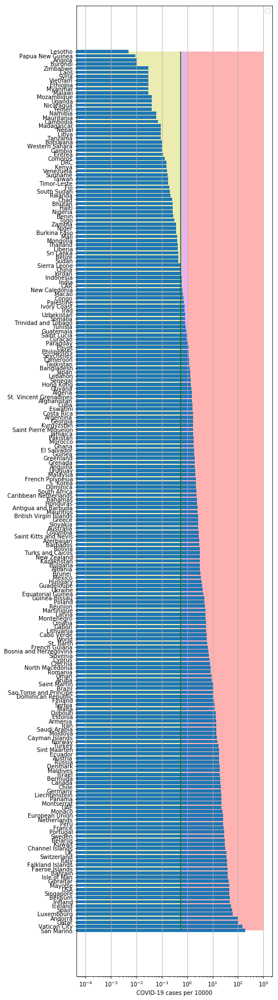

In [28]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


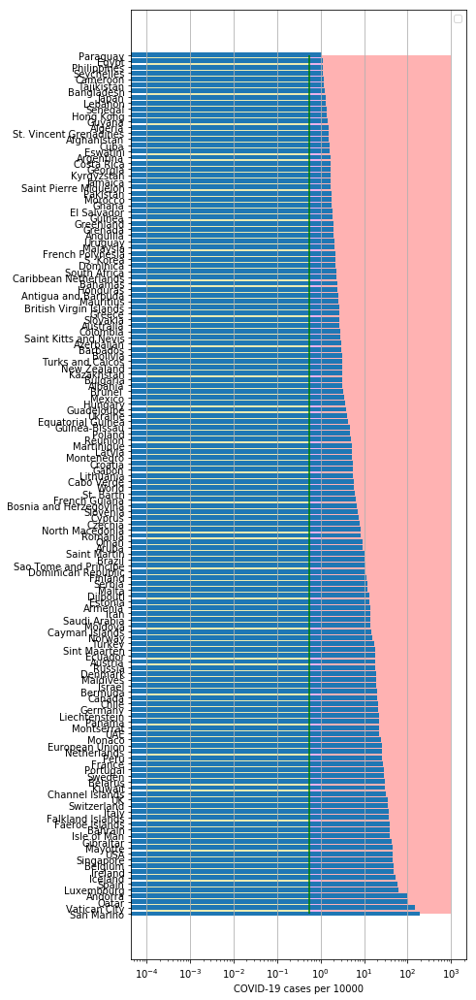

In [29]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

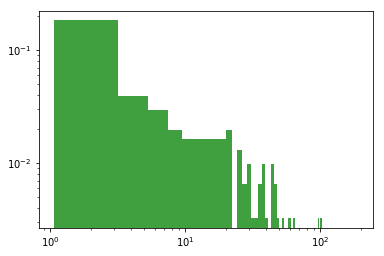

In [30]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [31]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
          date   cases  active    death
76 2020-05-11  268143   63553  26744.0
77 2020-05-12  269520   62130  26920.0
78 2020-05-13  271095   60764  27104.0
79 2020-05-14  272646   58845  27321.0
80 2020-05-15  274367   57941  27459.0
GB
          date   cases  active    death
75 2020-05-11  223060  190651  32065.0
76 2020-05-12  226463  193427  32692.0
77 2020-05-13  229705  196175  33186.0
78 2020-05-14  233151       0  33614.0
79 2020-05-15  236711       0  33998.0
IT
          date   cases  active    death
78 2020-05-11  219814   82488  30739.0
79 2020-05-12  221216   81266  30911.0
80 2020-05-13  222104   78457  31106.0
81 2020-05-14  223096   76440  31368.0
82 2020-05-15  223885   72070  31610.0
LT
          date   cases  active  death     tests
63 2020-05-11  1491.0     591   50.0  192386.0
64 2020-05-12  1505.0     543   54.0  200264.0
65 2020-05-13  1511.0     523   54.0  208253.0
66 2020-05-14  1523.0     504   54.0  216247.0
67 2020-05-15  1523.0     504   54.0       NaN


IE
          date  cases   active   death
63 2020-05-11  14265  10393.0   991.0
64 2020-05-12  14749  10679.0  1007.0
65 2020-05-13  15438  11123.0  1028.0
66 2020-05-14  16006  11445.0  1043.0
67 2020-05-15  16496  11617.0  1076.0
MX
          date  cases  active   death
64 2020-05-11  36327  9654.0  3573.0
65 2020-05-12  38324  8463.0  3926.0
66 2020-05-13  40186  8976.0  4220.0
67 2020-05-14  42595  9643.0  4477.0
68 2020-05-15  45032  9814.0  4767.0
PM
          date  cases  active  death
62 2020-05-11   8616  3680.0  249.0
63 2020-05-12   8783  2510.0  252.0
64 2020-05-13   8944  2621.0  256.0
65 2020-05-14   9118  2778.0  260.0
66 2020-05-15   9268  2922.0  266.0
PU
          date  cases   active   death
65 2020-05-11  68822  44455.0  1961.0
66 2020-05-12  72059  46678.0  2057.0
67 2020-05-13  76306  49813.0  2169.0
68 2020-05-14  80604  53186.0  2267.0
69 2020-05-15  84495  54956.0  2392.0
SB
          date  cases  active  death
62 2020-05-11  10176  6668.0  218.0
63 2020-05-12 

In [32]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [33]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.7490309527967918
intercept: -2.3878299234093503
slope: [0.10560514]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


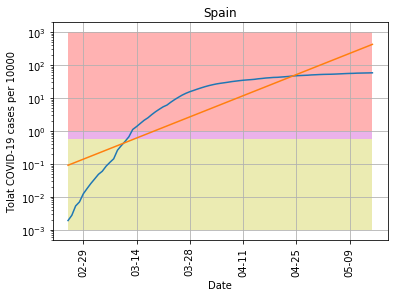

In [34]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-05-15', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [35]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.8675389234802958
intercept: -3.990452097185664
slope: [0.11845023]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


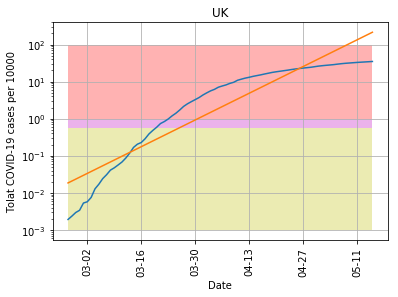

In [36]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-05-15', "pictures/coronaGB.png", model1, 'UK',100)

In [37]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0718751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9892260923335005
intercept: 1.862966558486614
slope: [-0.04874493]


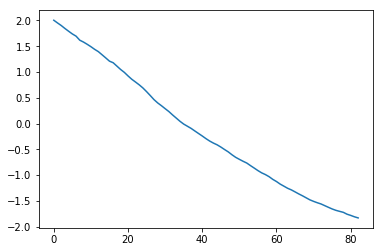

In [38]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


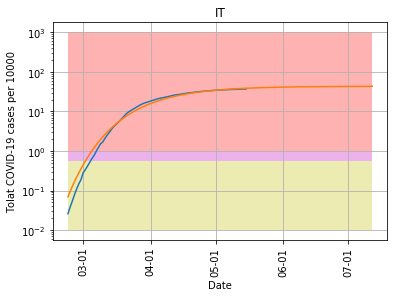

In [39]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [40]:
cs=y_pred11[-1]/10000.*populationIT

In [41]:
cs

260942.09944740994

In [42]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.6610264338257361
intercept: -2.126513896200793
slope: [0.07754111]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


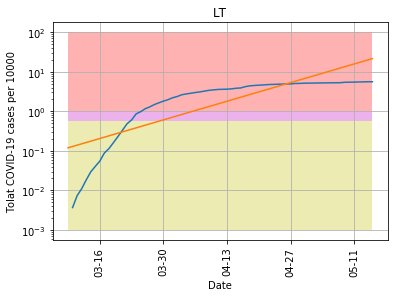

In [43]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-05-15', "pictures/coronaLT.png", model1, 'LT',100)

In [44]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9892260923335005
intercept: -5.811627379555898
slope: [0.13301506]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


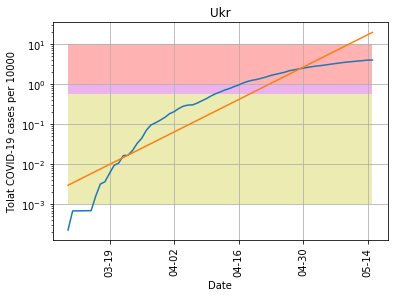

In [45]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-05-15', "pictures/coronaUkr.png", model11, 'Ukr',10)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


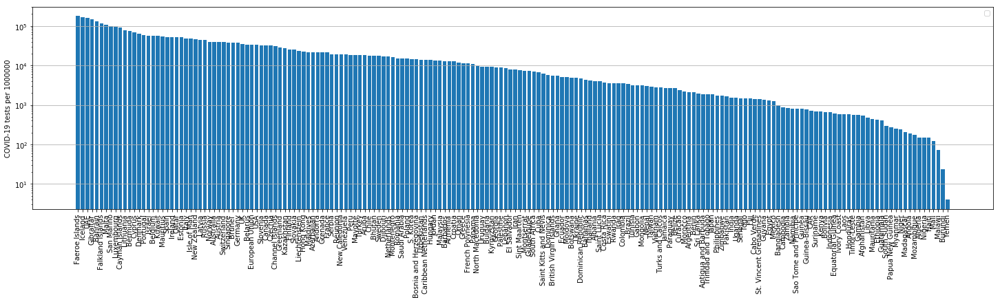

In [46]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [47]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9892260923335005
intercept: -3.515110859988443
slope: [0.12303739]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


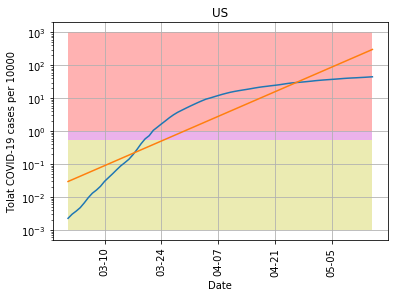

In [48]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-05-15', "pictures/coronaUS.png", model11, 'US',1000)

In [49]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.106365


(0, 0.15)

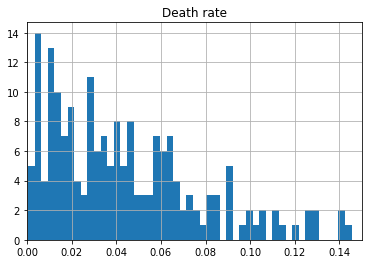

In [50]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

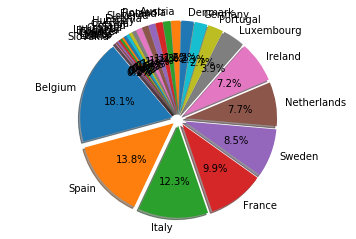

In [51]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [52]:
dfTTh.head()

,Country,Deathsper1Mpop
20,Belgium,773.0
8,Spain,587.0
11,Italy,523.0
13,France,422.0
29,Sweden,361.0


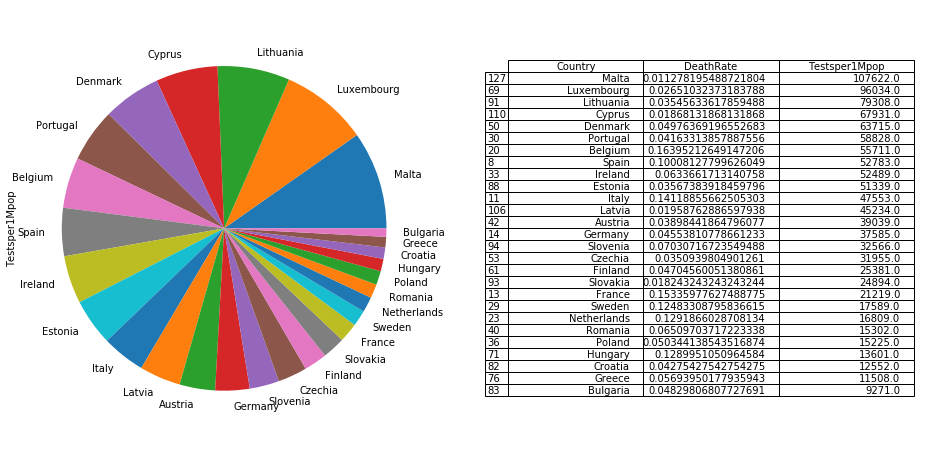

In [53]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

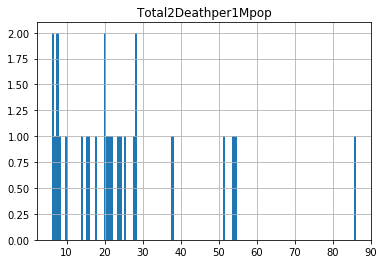

In [54]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [55]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
8,Spain,5868.0,587.0
11,Italy,3702.0,523.0
13,France,2751.0,422.0
14,Germany,2098.0,96.0
20,Belgium,4717.0,773.0


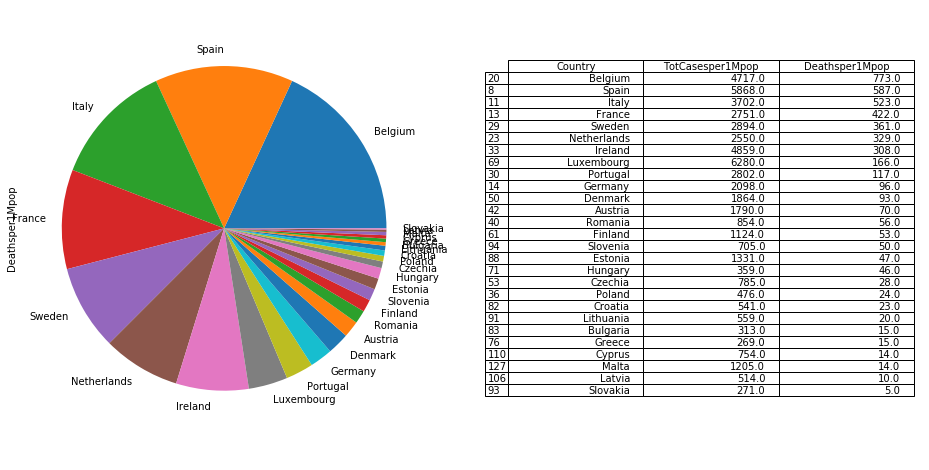

In [56]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [57]:
dfAll.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,1126572,North America,North America,0.0,2893.0,300.0,0,17296.0,0.0,1635060,99933.0,408555.0,0.0,0.0
1,0.0,840807,Europe,Europe,0.0,92.0,9.0,0,12195.0,0.0,1741221,160491.0,739923.0,0.0,0.0
2,0.0,242166,South America,South America,0.0,2273.0,157.0,0,10271.0,0.0,403345,21460.0,139719.0,0.0,0.0
3,0.0,303159,Asia,Asia,0.0,1980.0,33.0,0,4934.0,0.0,759904,23996.0,432749.0,0.0,0.0
4,0.0,47067,Africa,Africa,0.0,151.0,1.0,0,288.0,0.0,79931,2640.0,30224.0,0.0,0.0


In [58]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
8,Spain,0.111172
11,Italy,0.077850
13,France,0.129648
14,Germany,0.055820
20,Belgium,0.084669


In [59]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.164535
 Netherlands             0.151704
      France             0.129648
       Spain             0.111172
     Ireland             0.092572
     Belgium             0.084669
       Italy             0.077850
  Luxembourg             0.065394
     Germany             0.055820
     Romania             0.055810
    Portugal             0.047630
     Austria             0.045852
     Finland             0.044285
     Croatia             0.043101
    Bulgaria             0.033761
      Poland             0.031264
     Denmark             0.029255
     Hungary             0.026395
     Estonia             0.025926
     Czechia             0.024566
      Greece             0.023375
    Slovenia             0.021648
      Latvia             0.011363
       Malta             0.011197
      Cyprus             0.011099
    Slovakia             0.010886
   Lithuania             0.007048


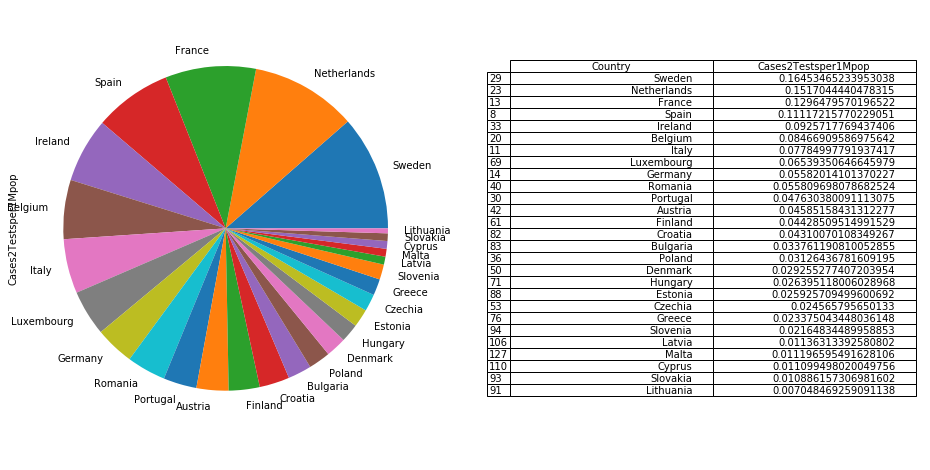

In [60]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [61]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
28,Qatar,0.000476,51545.00000
32,Singapore,0.000781,38371.00000
60,Bahrain,0.001823,131434.00000
95,Djibouti,0.003056,17115.00000
109,Guinea-Bissau,0.003286,765.00000
103,Hong Kong,0.003799,22471.00000
105,Maldives,0.003880,21834.00000
77,Uzbekistan,0.004088,13770.00000
67,Oman,0.004324,11987.00000
65,Ghana,0.004966,5412.00000


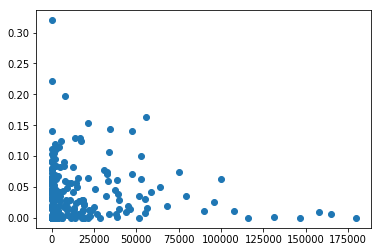

In [62]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


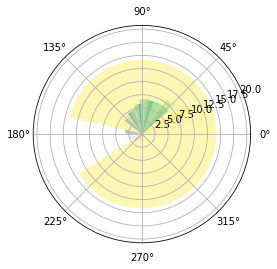

In [63]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

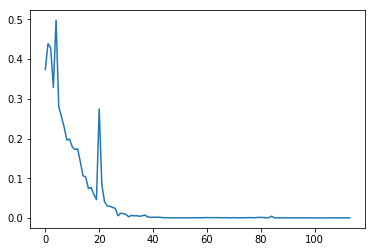

In [64]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [65]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


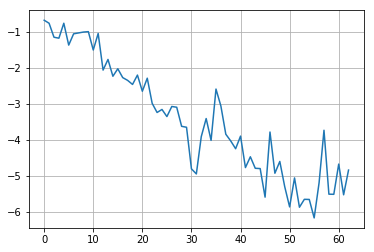

In [66]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

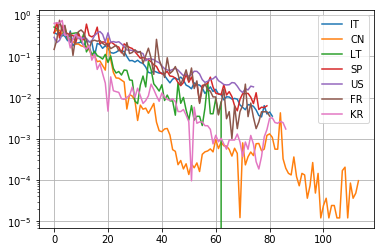

In [67]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

75 75
coefficient of determination: 0.9113740986253095
intercept: -8.064030681189648
slope: [-0.16561203]


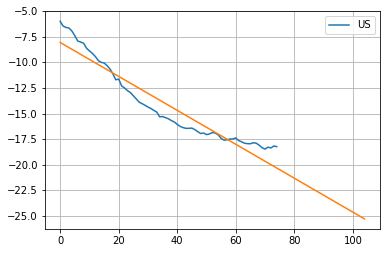

In [68]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

82 82
coefficient of determination: 0.9176486138009483
intercept: -9.151627318716674
slope: [-0.12347008]


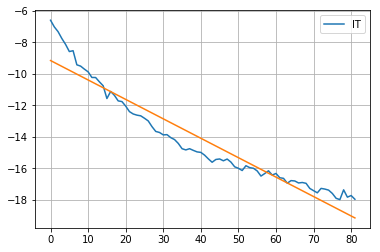

In [69]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [70]:
#model11.coef_

In [71]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

64 64
coefficient of determination: 0.9570905401207617
intercept: -14.618997484148856
slope: [-0.08370002]


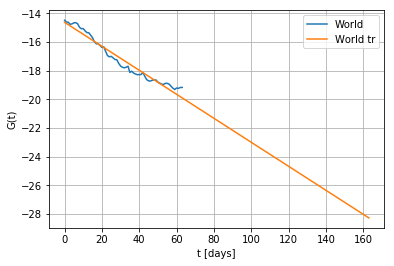

In [72]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

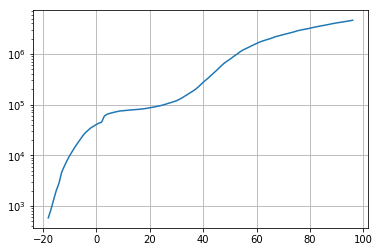

In [73]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [74]:
dfW['cases'].values

array([    580,     845,    1317,    2015,    2800,    4581,    6058,
          7813,    9823,   11950,   14553,   17391,   20630,   24545,
         28266,   31439,   34876,   37552,   40553,   43099,   45134,
         59287,   64438,   67100,   69197,   71329,   73332,   75184,
         75700,   76677,   77673,   78651,   79205,   80087,   80828,
         81820,   83112,   84615,   86604,   88585,   90443,   93016,
         95314,   98425,  102050,  106099,  109991,  114381,  118948,
        126214,  134576,  145483,  156653,  169593,  182490,  198238,
        218822,  244933,  275597,  305036,  337489,  378860,  422629,
        471035,  531864,  596366,  663079,  723279,  784738,  858355,
        936237, 1016330, 1117928, 1203058, 1274578, 1347566, 1432869,
       1519195, 1605277, 1700004, 1780713, 1853505, 1925330, 2000065,
       2084633, 2183942, 2252370, 2332650, 2407467, 2482272, 2557917,
       2638909, 2725972, 2833697, 2921571, 2995209, 3065871, 3139009,
       3221029, 3308

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 6.36028224e+06  2.95419477e+00 -4.03151911e+01  1.32329683e-02]


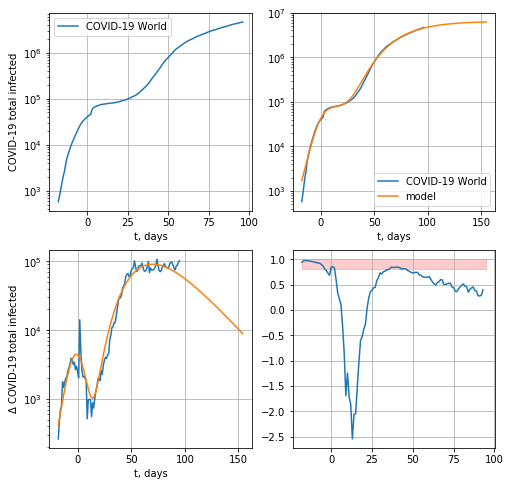

41704.41769344256


In [75]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

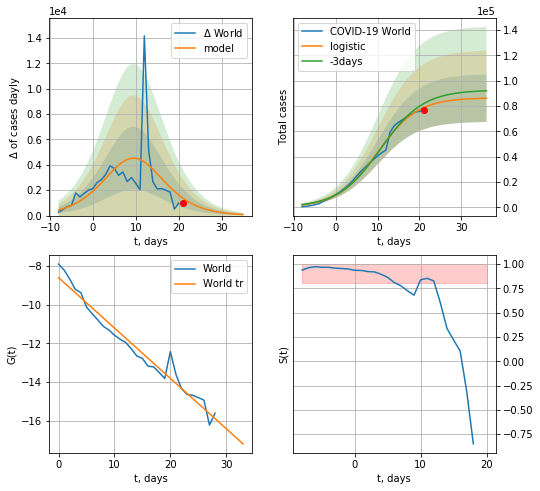

World data at: 2020-05-15
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +15 days
	 deltaDaycases:  85
	 total cases:  86104 ± 18754
	 total death:  5741 ± 3751
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


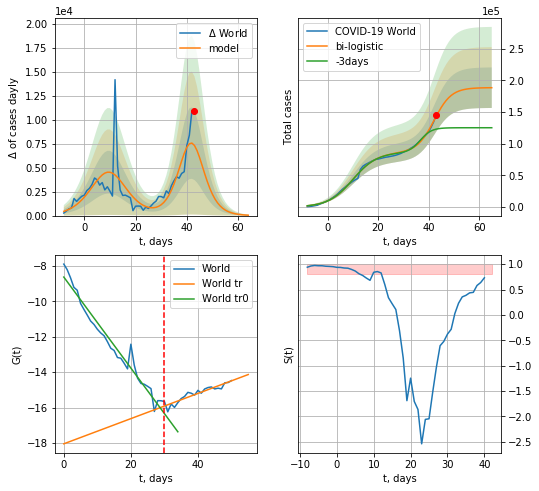

World data at: 2020-05-15
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +22 days
	 deltaDaycases:  42
	 total cases:  188578 ± 32044
	 total death:  12574 ± 6410
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


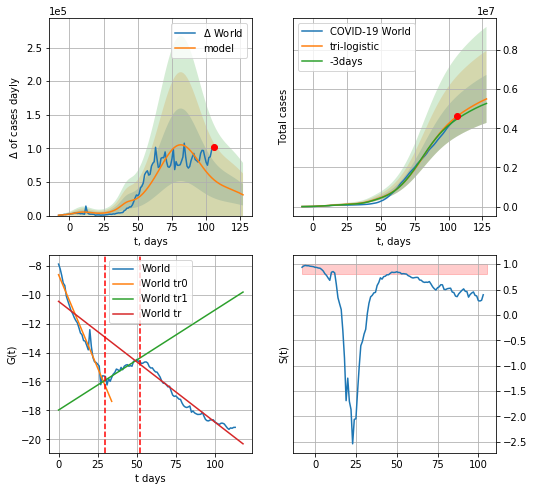

World data at: 2020-05-15
+3 day model MAPE: 0.03155473259188105
model: tri-logistic
coeffs:  [4.64953794e+06 8.82398697e-02 8.12997158e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.22285171435069054
forecast at the end of period: +22 days
	 deltaDaycases:  30891
	 total cases:  5496732 ± 1224956
	 total death:  366527 ± 245043
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.952807
 intercept: -10.469957
 slope: -0.083311


In [76]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

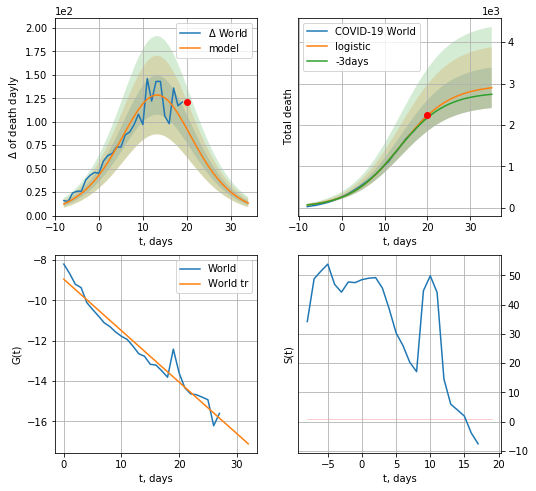

World data at: 2020-05-15
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +15 days
	 total death:  2897 ± 490
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


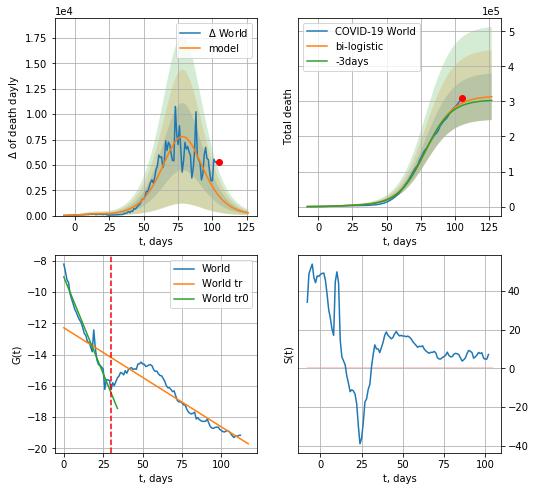

World data at: 2020-05-15
+3 day model MAPE: 0.025002660066467744
model: bi-logistic
coeffs:  [3.12933562e+05 9.96828139e-02 7.86796998e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.2118786262106236
forecast at the end of period: +22 days
	 deltaDaydeath:  261
	 total death:  313390 ± 66400
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.855214
 intercept: -12.282044
 slope: -0.063478


In [77]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [78]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


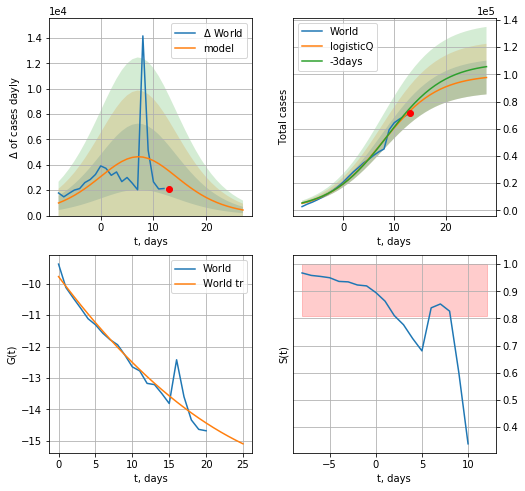

World data at: 2020-05-15
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +15 days
	 deltaDaycases: 439
	 total cases: 97661 ± 12398
	 total death: 6512 ± 2480
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


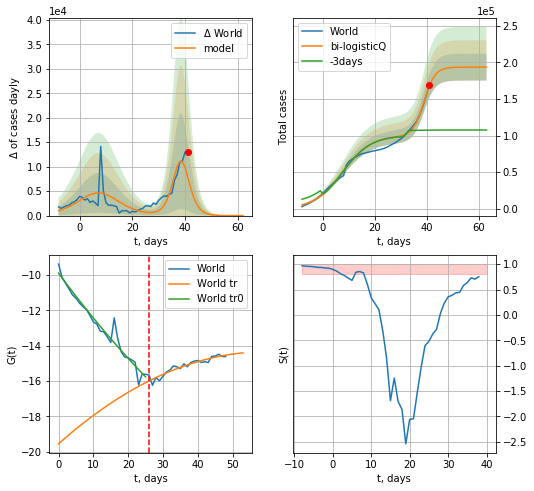

World data at: 2020-05-15
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +22 days
	 deltaDaycases: 1
	 total cases: 193618 ± 18335
	 total death: 12910 ± 3667
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


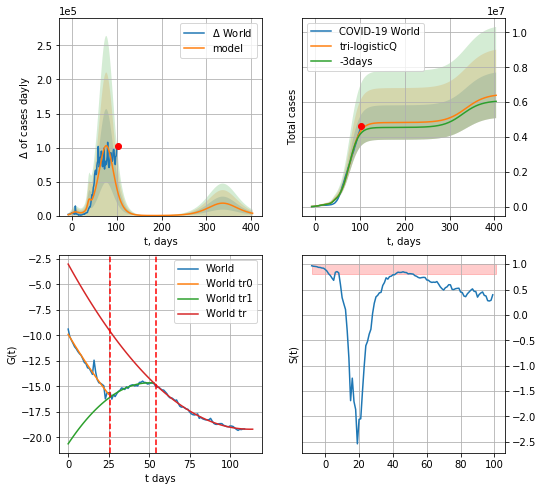

World data at: 2020-05-15
+3 day model MAPE: 0.037623
model: tri-logisticQ
coeffs: [ 4.63260315e+06  1.02278588e-06  7.72610689e+01 -8.66984724e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.204755
forecast at the end of period: +302 days
	 deltaDaycases: 3372
	 total cases: 6389218 ± 1308222
	 total death: 426038 ± 261699
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.993171
 intercept_: -3.004573081794698
 coeffs_: [ 0.         -0.28773141  0.00127866]


In [79]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*50-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


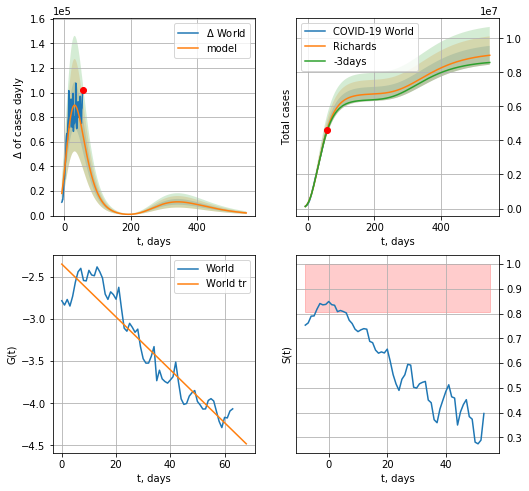

World data at: 2020-05-15
+3 day model MAPE: 0.015331
model: Richards
coeffs: [ 6.73580054e+06  2.24663824e+00 -8.17888249e+01  1.62497712e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.061716
forecast at the end of period: +492 days
	 deltaDaycases: 2148
	 total cases: 8998956 ± 555376
	 total death: 600058 ± 111098
trend coefficient of determination: 0.897807
 intercept: -2.349345
 slope: -0.031339


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


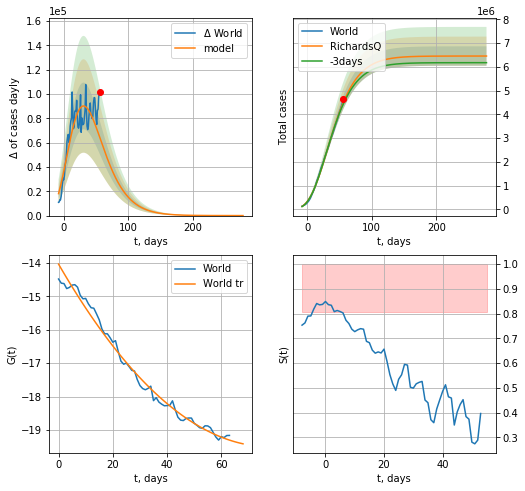

World data at: 2020-05-15
+3 day model MAPE: 0.015577
model: RichardsQ
coeffs: [ 6.45781011e+06  7.58927131e-03 -1.37747049e+02 -8.77086963e+02
  4.65728094e-03]
rational stdev: 0.063357
forecast at the end of period: +222 days
	 deltaDaycases: 3
	 total cases: 6457751 ± 409142
	 total death: 430608 ± 81845
trend coefficient of determination: 0.987586
 intercept_: -14.031291768089401
 coeffs_: [ 0.         -0.14058795  0.00090309]


In [80]:
x = forecastRR("World",dfW[50:],d1,60*9-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

In [81]:
#x = forecastR("World",dfW[:30],d1,7*9-dT,1.0)
#xx = forecast2R("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


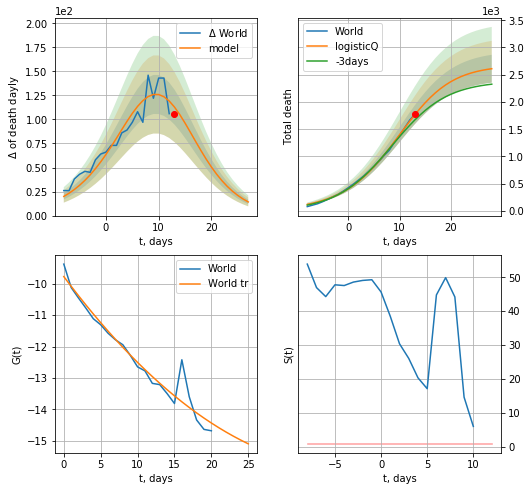

World data at: 2020-05-15
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +15 days
	 total death: 2610 ± 255
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


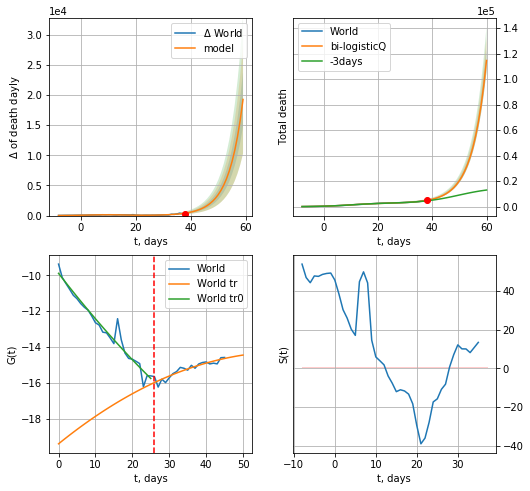

World data at: 2020-05-15
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +22 days
	 total death: 114535 ± 8772
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


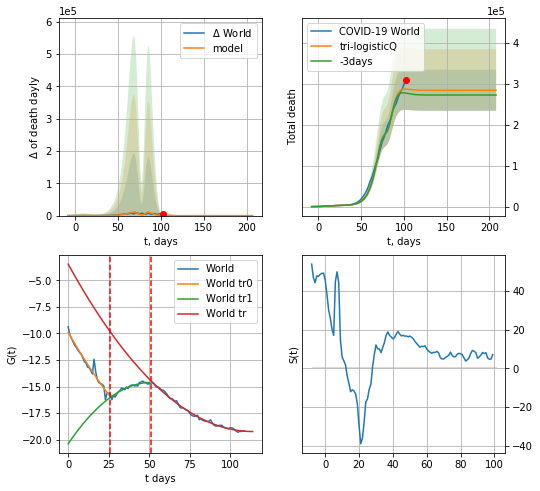

World data at: 2020-05-15
+3 day model MAPE: 0.036152
model: tri-logisticQ
coeffs: [-6.14035130e+06  1.02358996e-04  7.96725901e+01 -2.14872321e+03]
rational stdev: 0.176367
forecast at the end of period: +106 days
	 total death: 284360 ± 50151
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.993823
 intercept_: -3.4836435157239265
 coeffs_: [ 0.         -0.2763301   0.00121266]


In [82]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*9-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*10-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


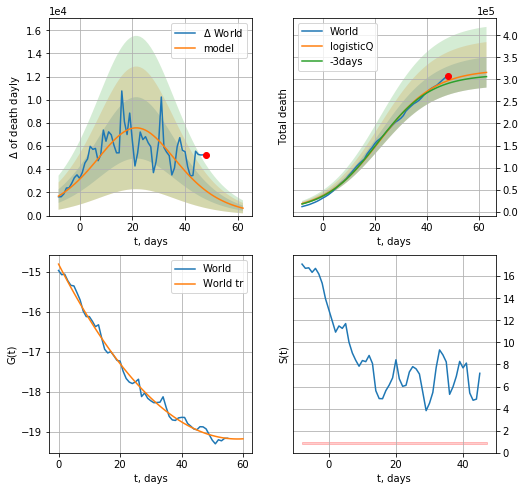

World data at: 2020-05-15
+3 day model MAPE: 0.022566
model: logisticQ
coeffs: [ 3.22407088e+05  2.50489502e-06  2.19575847e+01 -3.75173085e+04]
rational stdev: 0.109039
forecast at the end of period: +15 days
	 total death: 315777 ± 34432
trend coefficient of determination: 0.993179
 intercept_: -14.80696772819384
 coeffs_: [ 0.         -0.15034067  0.00129131]


In [83]:
x = forecastRRR("World",dfW[58:],d1,7*9-dT,1.0,False,cases='death')

In [84]:
#trend(dfSP,'SP',10)

In [85]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

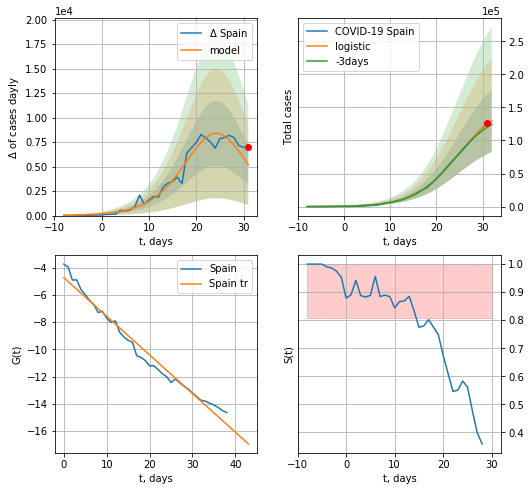

Spain data at: 2020-05-15
+3 day model MAPE: 0.04561458006812168
model: logistic
coeffs:  [1.57435111e+05 2.13808172e-01 2.47400247e+01]
rational stdev:  0.36377402189294417
forecast at the end of period: +1 days
	 deltaDaycases:  5196
	 total cases:  129921 ± 47262
	 total death:  13002 ± 14189
trend coefficient of determination: 0.976000
 intercept: -4.738498
 slope: -0.283731


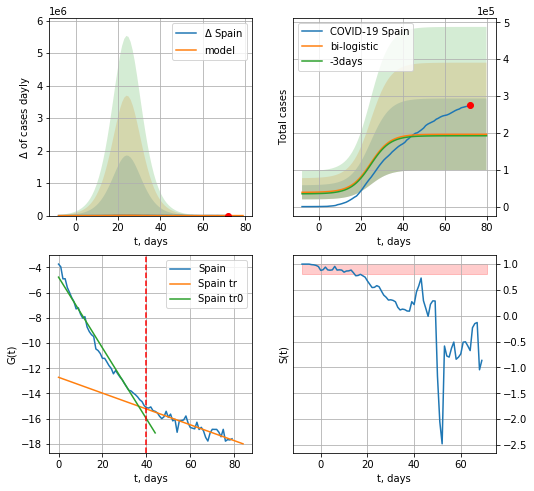

Spain data at: 2020-05-15
+3 day model MAPE: 0.02110569293190266
model: bi-logistic
coeffs:  [ 3.09564678e+04 -3.22831102e+00  9.09802333e+01] [1.57435111e+05 2.13808172e-01 2.47400247e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.49492828901083846
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  196129 ± 97070
	 total death:  19628 ± 29143
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.975802
 intercept: -4.777276
 slope: -0.280670
trend coefficient of determination: 0.841322
 intercept: -12.718468
 slope: -0.062778


In [91]:
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*7-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*8-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

SP
          date   cases  active    death
76 2020-05-11  268143   63553  26744.0
77 2020-05-12  269520   62130  26920.0
78 2020-05-13  271095   60764  27104.0
79 2020-05-14  272646   58845  27321.0
80 2020-05-15  274367   57941  27459.0


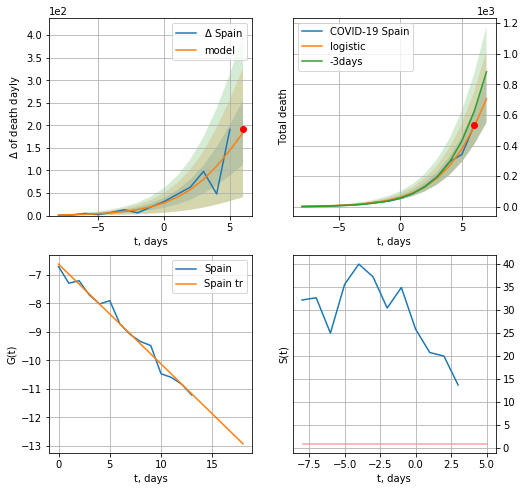

Spain data at: 2020-05-15
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +1 days
	 total death:  706 ± 156
trend coefficient of determination: 0.979903
 intercept: -6.627261
 slope: -0.349838


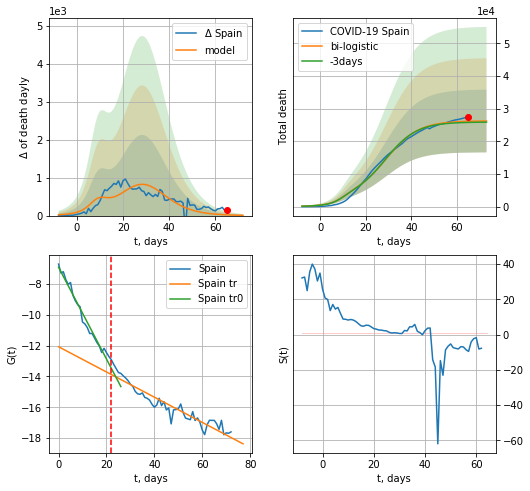

Spain data at: 2020-05-15
+3 day model MAPE: 0.013177004976409735
model: bi-logistic
coeffs:  [2.35091352e+04 1.39984209e-01 2.87872133e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.3664036219989099
forecast at the end of period: +8 days
	 deltaDaydeath:  7
	 total death:  26206 ± 9602
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976983
 intercept: -6.916118
 slope: -0.297677
trend coefficient of determination: 0.896030
 intercept: -12.074573
 slope: -0.081740


In [94]:
vL = 22#len(dfSP[:])-7-dT
dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*8-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


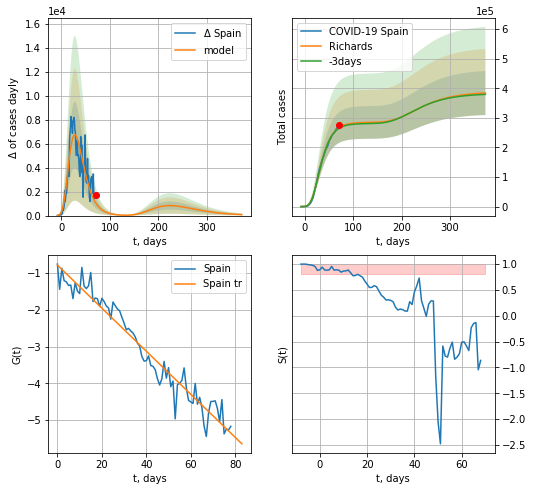

Spain data at: 2020-05-15
+3 day model MAPE: 0.009395
model: Richards
coeffs: [ 2.84821979e+05  8.17760448e+00 -4.65538127e+01  7.91190407e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.193768
forecast at the end of period: +302 days
	 deltaDaycases: 83
	 total cases: 384259 ± 74457
	 total death: 38457 ± 22355
trend coefficient of determination: 0.946556
 intercept: -0.786594
 slope: -0.058550


In [95]:
x = forecastRR('Spain',dfSP[1:],d1,7*50-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide


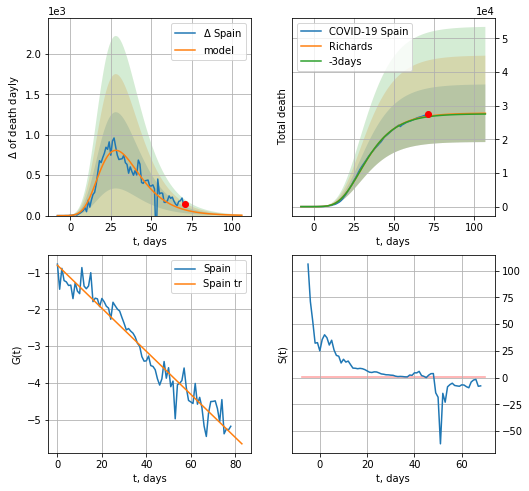

Spain data at: 2020-05-15
+3 day model MAPE: 0.006321
model: Richards
coeffs: [ 2.78118515e+04  8.79144373e+00 -3.07049031e+01  9.03148149e-03]
rational stdev: 0.308502
forecast at the end of period: +36 days
	 total death: 27756 ± 8563
trend coefficient of determination: 0.946808
 intercept: -0.794045
 slope: -0.058660


In [96]:
x = forecastRR('Spain',dfSP[1:],d1,7*12-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


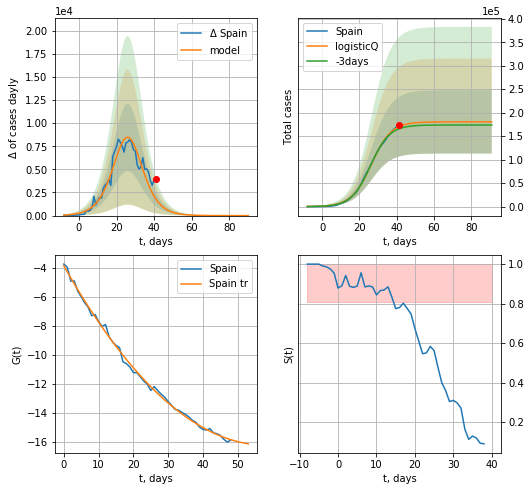

Spain data at: 2020-05-15
+3 day model MAPE: 0.028157
model: logisticQ
coeffs: [ 1.80489569e+05  4.90633148e-06  2.63952659e+01 -3.83458431e+04]
rational stdev: 0.373397
forecast at the end of period: +50 days
	 deltaDaycases: 0
	 total cases: 180488 ± 67393
	 total death: 18063 ± 20234
trend coefficient of determination: 0.997432
 intercept_: -3.859009253100683
 coeffs_: [ 0.         -0.42385579  0.00363487]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


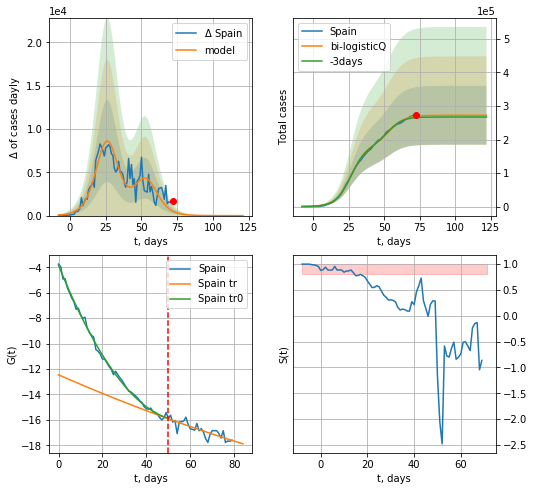

Spain data at: 2020-05-15
+3 day model MAPE: 0.015523
model: bi-logisticQ
coeffs: [ 9.18964369e+04  1.31848426e-06  5.33970614e+01 -1.36030461e+05]
rational stdev: 0.322465
forecast at the end of period: +50 days
	 deltaDaycases: 0
	 total cases: 272385 ± 87834
	 total death: 27260 ± 26371
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997202
 intercept_: -3.834231460165485
 coeffs_: [ 0.         -0.42809872  0.00374483]
trend coefficient of determination: 0.689037
 intercept_: -12.454052786656957
 coeffs_: [ 0.         -0.07586754  0.00013387]


In [97]:
x = forecastRRR('Spain',dfSP[:50],d1,7*14-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*14-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


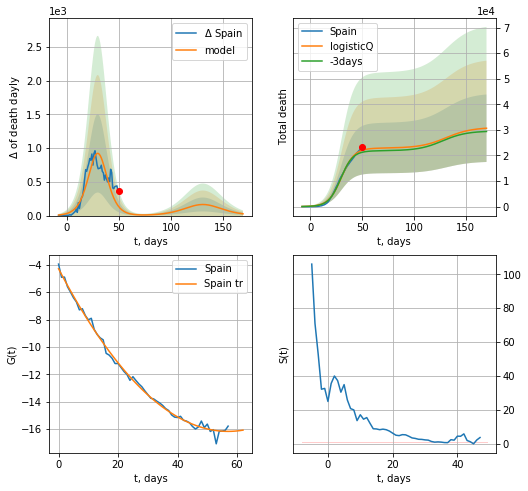

Spain data at: 2020-05-15
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +120 days
	 total death: 30656 ± 13207
trend coefficient of determination: 0.995966
 intercept_: -4.289708231519192
 coeffs_: [ 0.         -0.41662978  0.00365293]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide


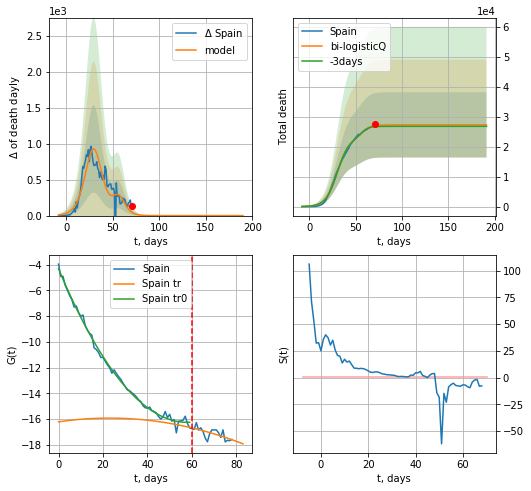

Spain data at: 2020-05-15
+3 day model MAPE: 0.014826
model: bi-logisticQ
coeffs: [ 4.46174650e+03  1.47045765e-06  5.70946410e+01 -1.48551823e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.399234
forecast at the end of period: +120 days
	 total death: 27344 ± 10916
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995823
 intercept_: -4.3202000903722375
 coeffs_: [ 0.         -0.41230978  0.00355978]
trend coefficient of determination: 0.431520
 intercept_: -16.222840802559087
 coeffs_: [ 0.          0.02538932 -0.00055372]


In [98]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


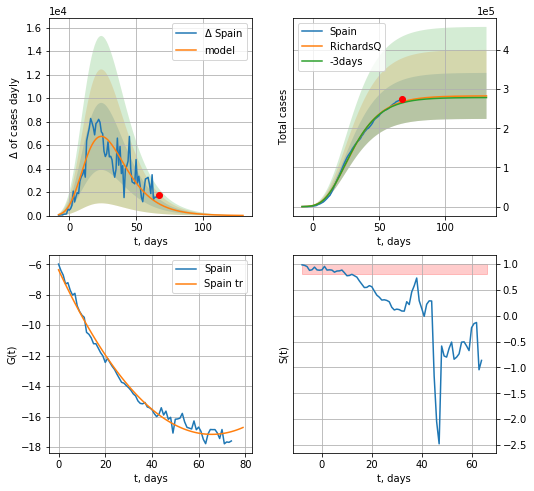

Spain data at: 2020-05-15
+3 day model MAPE: 0.009907
model: RichardsQ
coeffs: [ 2.82981619e+05  3.00951286e-02 -8.54097041e+01 -1.49496196e+03
  1.32350686e-03]
rational stdev: 0.207820
forecast at the end of period: +64 days
	 deltaDaycases: 13
	 total cases: 282806 ± 58772
	 total death: 28303 ± 17645
trend coefficient of determination: 0.988143
 intercept_: -6.3673001147841495
 coeffs_: [ 0.         -0.32910834  0.00250879]


In [99]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

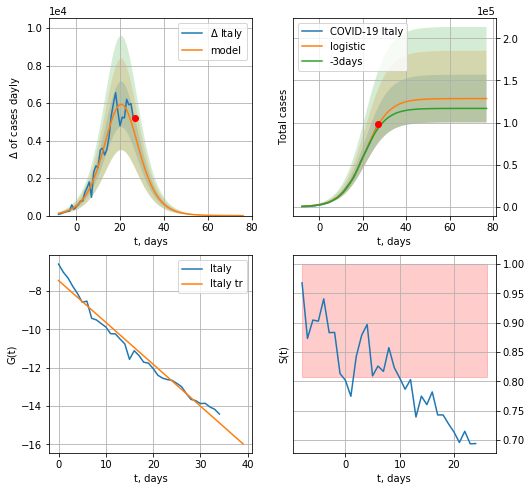

Italy data at: 2020-05-15
+3 day model MAPE: 0.04536229058229775
model: logistic
coeffs:  [1.28444604e+05 1.85121746e-01 2.10190970e+01]
rational stdev:  0.22074329651570546
forecast at the end of period: +50 days
	 deltaDaycases:  0
	 total cases:  128440 ± 28352
	 total death:  18134 ± 12008
trend coefficient of determination: 0.974900
 intercept: -7.448538
 slope: -0.218710


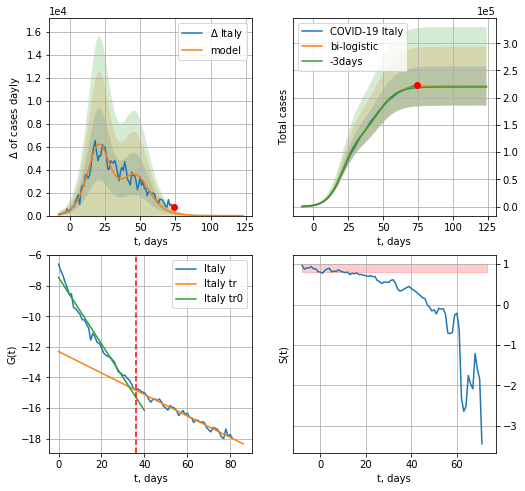

Italy data at: 2020-05-15
+3 day model MAPE: 0.007686904766197914
model: bi-logistic
coeffs:  [9.31903062e+04 1.47530679e-01 4.70236773e+01] [1.28444604e+05 1.85121746e-01 2.10190970e+01]
rational stdev:  0.16301030045102854
forecast at the end of period: +50 days
	 deltaDaycases:  0
	 total cases:  221633 ± 36128
	 total death:  31292 ± 15302
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975991
 intercept: -7.466382
 slope: -0.217136
trend coefficient of determination: 0.972872
 intercept: -12.304288
 slope: -0.070195


In [103]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,14*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,14*7-dT,x,1.0,vL=vL)

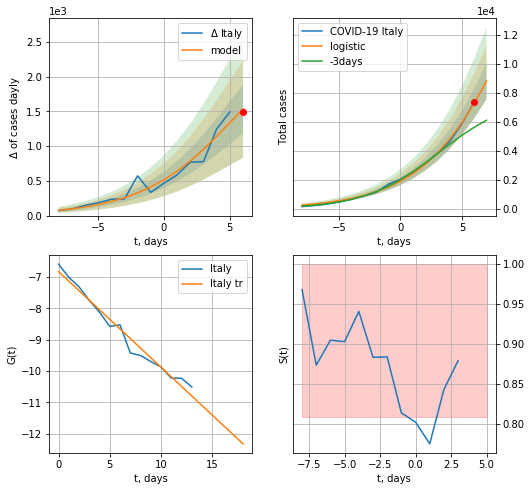

Italy data at: 2020-05-15
+3 day model MAPE: 0.4420796150765939
model: logistic
coeffs:  [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.1413171221665118
forecast at the end of period: +1 days
	 deltaDaycases:  1534
	 total cases:  8819 ± 1246
	 total death:  1245 ± 527
trend coefficient of determination: 0.972659
 intercept: -6.827339
 slope: -0.305199


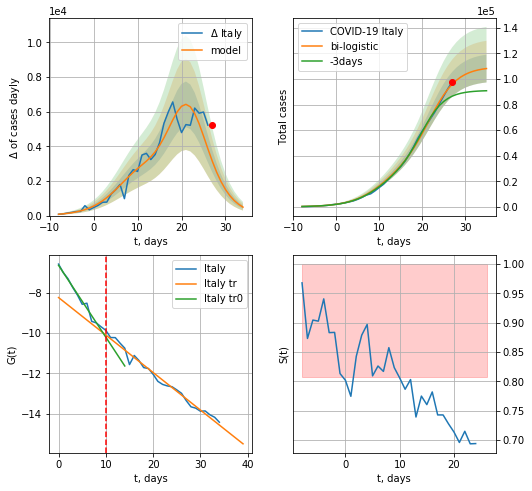

Italy data at: 2020-05-15
+3 day model MAPE: 0.12719416413980916
model: bi-logistic
coeffs:  [7.80633996e+04 3.07326084e-01 2.18190350e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01]
rational stdev:  0.10039113205484494
forecast at the end of period: +8 days
	 deltaDaycases:  487
	 total cases:  108176 ± 10859
	 total death:  15273 ± 4599
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


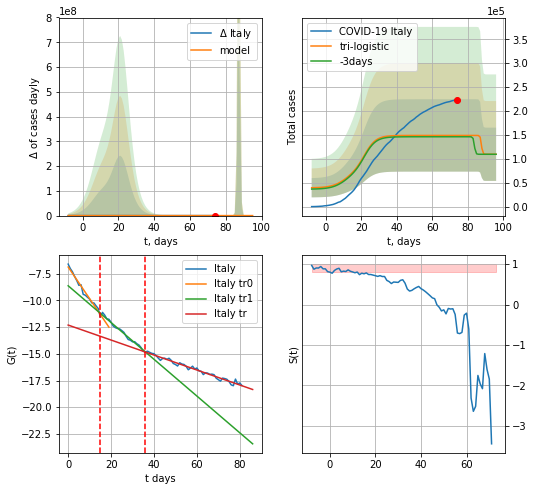

Italy data at: 2020-05-15
+3 day model MAPE: 0.019009923100597355
model: tri-logistic
coeffs:  [ 3.93626602e+04 -3.13163471e+00  8.77405989e+01] [3.15102860e+04 2.56561304e-01 1.06831560e+01 7.80633996e+04
 3.07326084e-01 2.18190350e+01]
forecast rational stdev:  0.507765232469707
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  109573 ± 55637
	 total death:  15470 ± 23565
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544
trend1 coefficient of determination: 0.980760
 intercept: -8.621359
 slope: -0.172242
trend coefficient of determination: 0.972872
 intercept: -12.304288
 slope: -0.070195


In [107]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*7-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

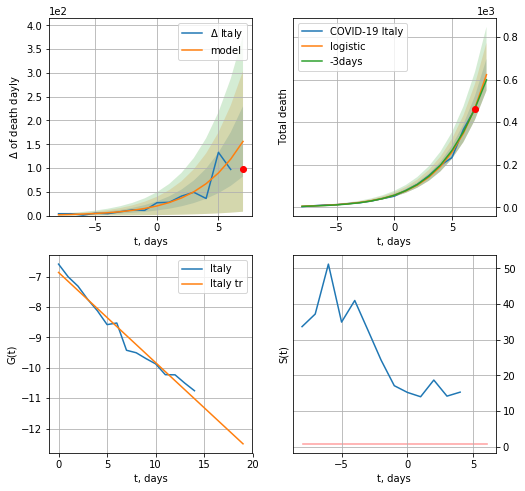

Italy data at: 2020-05-15
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +1 days
	 total death:  622 ± 74
trend coefficient of determination: 0.972874
 intercept: -6.864841
 slope: -0.296544


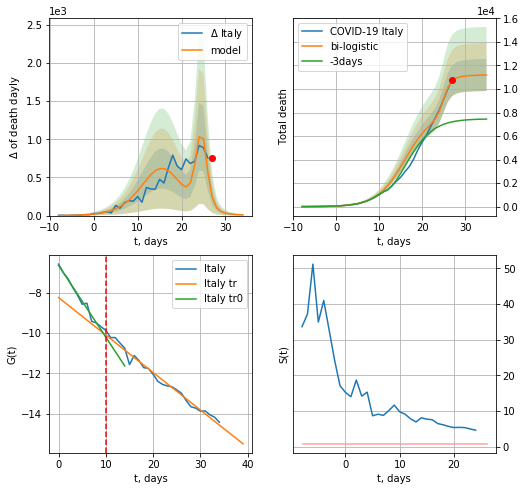

Italy data at: 2020-05-15
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +8 days
	 deltaDaydeath:  8
	 total death:  11189 ± 1362
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980956
 intercept: -6.650523
 slope: -0.355965
trend coefficient of determination: 0.983136
 intercept: -8.246485
 slope: -0.185719


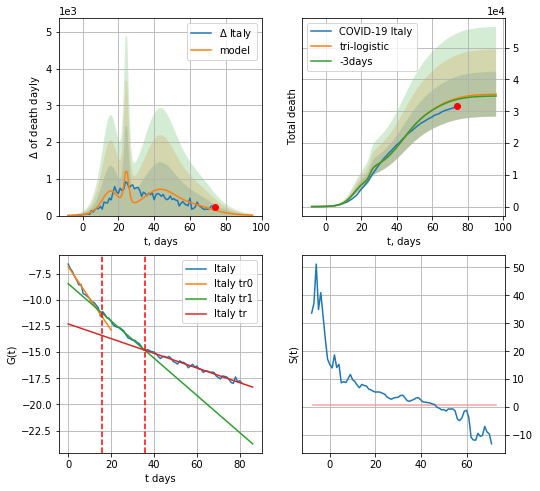

Italy data at: 2020-05-15
+3 day model MAPE: 0.011619599194883944
model: tri-logistic
coeffs:  [1.93825366e+04 1.42029184e-01 4.35162182e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.1995052310859367
forecast at the end of period: +22 days
	 deltaDaydeath:  10
	 total death:  35367 ± 7056
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976838
 intercept: -6.838821
 slope: -0.302120
trend1 coefficient of determination: 0.986419
 intercept: -8.458056
 slope: -0.177939
trend coefficient of determination: 0.972872
 intercept: -12.304288
 slope: -0.070195


In [108]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*8-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*10-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


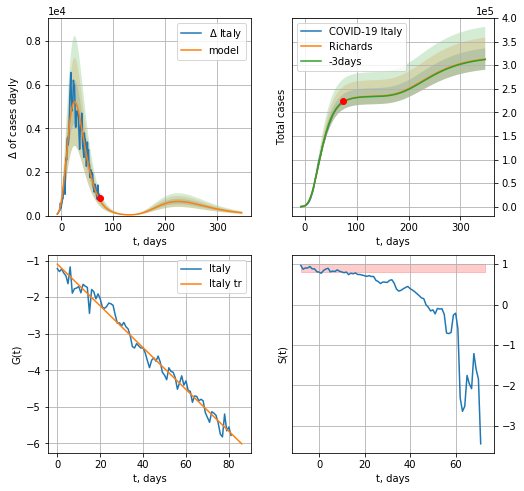

Italy data at: 2020-05-15
+3 day model MAPE: 0.002090
model: Richards
coeffs: [ 2.34518677e+05  5.49490987e+00 -4.83575213e+01  1.10510055e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.072531
forecast at the end of period: +274 days
	 deltaDaycases: 128
	 total cases: 313118 ± 22710
	 total death: 44208 ± 9619
trend coefficient of determination: 0.982239
 intercept: -1.093577
 slope: -0.057210


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


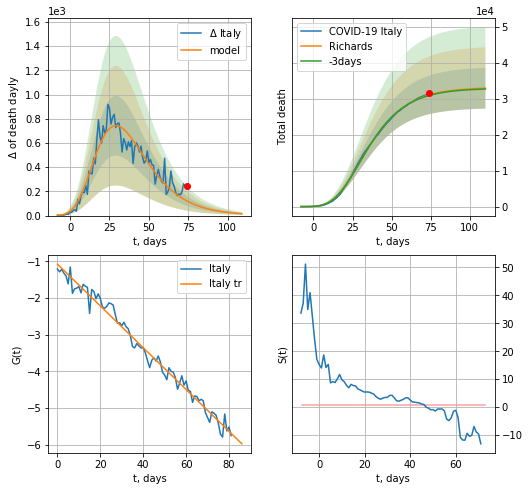

Italy data at: 2020-05-15
+3 day model MAPE: 0.005063
model: Richards
coeffs: [ 3.32087753e+04  7.34310778e+00 -4.87613009e+01  8.32275204e-03]
rational stdev: 0.172414
forecast at the end of period: +36 days
	 total death: 32965 ± 5683
trend coefficient of determination: 0.982024
 intercept: -1.071347
 slope: -0.057027


In [109]:
x = forecastRR('Italy',dfIT[:],d1,46*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('Italy',dfIT[:],d1,12*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


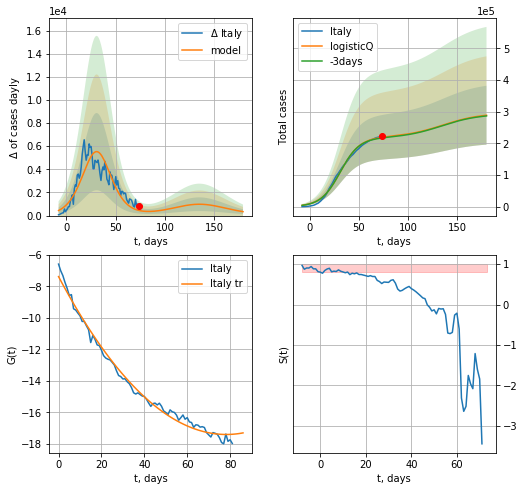

Italy data at: 2020-05-15
+3 day model MAPE: 0.008928
model: logisticQ
coeffs: [ 2.18803814e+05  5.62335731e-07  3.10290067e+01 -1.79223773e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321854
forecast at the end of period: +106 days
	 deltaDaycases: 340
	 total cases: 289038 ± 93028
	 total death: 40808 ± 39402
trend coefficient of determination: 0.990088
 intercept_: -7.3828522392812195
 coeffs_: [ 0.         -0.25613957  0.00163796]


In [110]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


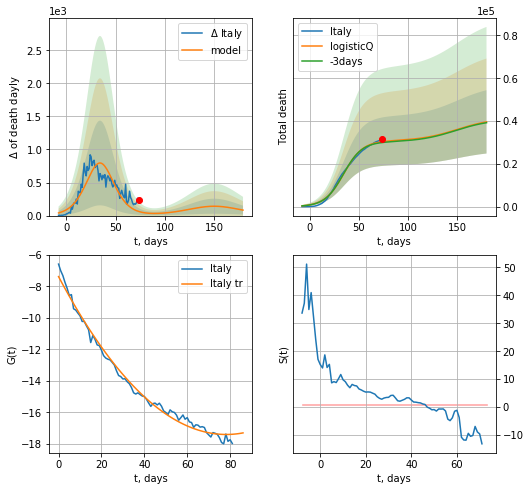

Italy data at: 2020-05-15
+3 day model MAPE: 0.012963
model: logisticQ
coeffs: [ 3.06591314e+04  6.12840538e-07  3.44779637e+01 -1.69107792e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373501
forecast at the end of period: +106 days
	 total death: 39616 ± 14796
trend coefficient of determination: 0.990088
 intercept_: -7.3828522392812195
 coeffs_: [ 0.         -0.25613957  0.00163796]


In [111]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [112]:
dT

48

FR
          date     cases  active    death
86 2020-05-11  176462.0   94056  26643.0
87 2020-05-12  177259.0   93449  26991.0
88 2020-05-13  178060.0   92313  27074.0
89 2020-05-14  178870.0   91840  27425.0
90 2020-05-15  179506.0   91529  27529.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


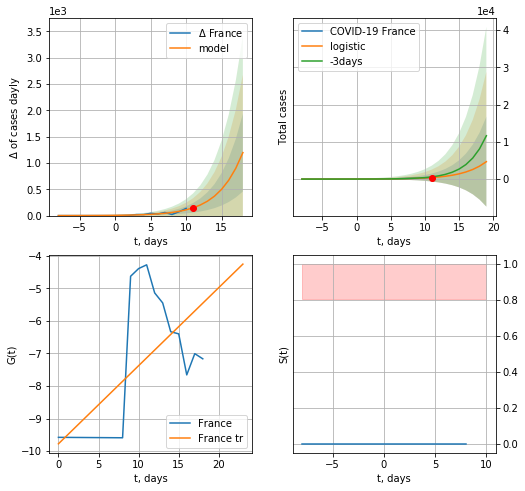

France data at: 2020-05-15
+3 day model MAPE: 0.35377772281552833
model: logistic
coeffs:  [9.42155263e+04 3.09254736e-01 2.85489635e+01]
rational stdev:  2.580494002455425
forecast at the end of period: +8 days
	 deltaDaycases:  1197
	 total cases:  4672 ± 12056
	 total death:  716 ± 5542
trend coefficient of determination: 0.411250
 intercept: -9.775485
 slope: 0.239902


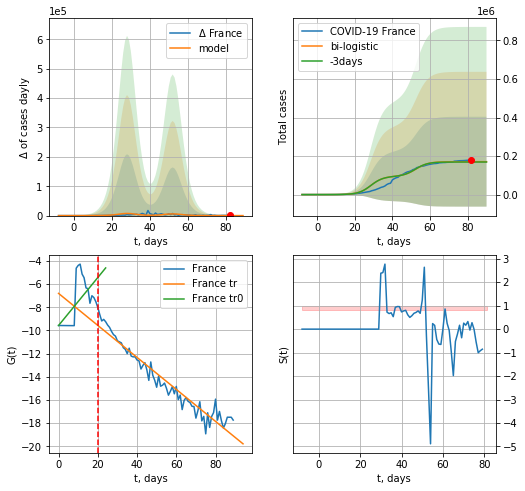

France data at: 2020-05-15
+3 day model MAPE: 0.01036376542263679
model: bi-logistic
coeffs:  [7.64871453e+04 2.98954401e-01 5.25160429e+01] [9.42155263e+04 3.09254736e-01 2.85489635e+01]
rational stdev:  1.3660294908220307
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  170701 ± 233183
	 total death:  26178 ± 107279
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.357185
 intercept: -9.578095
 slope: 0.207004
trend coefficient of determination: 0.935067
 intercept: -6.805724
 slope: -0.138100


In [113]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,8*7-dT,1.0)
xx = forecast2('France',dfFR,d1,8*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [114]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

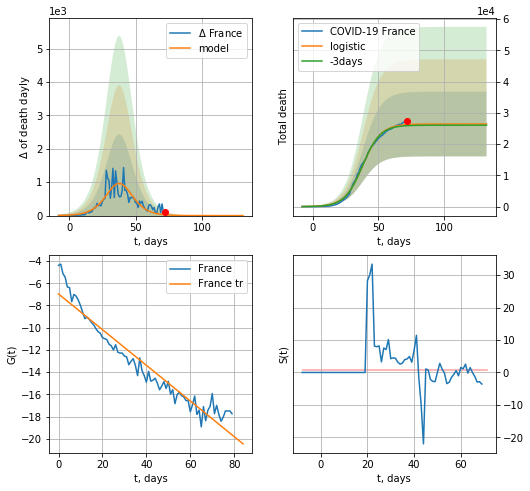

France data at: 2020-05-15
+3 day model MAPE: 0.013413596786267279
model: logistic
coeffs:  [2.64248910e+04 1.45905267e-01 3.81533107e+01]
rational stdev:  0.3918005807277957
forecast at the end of period: +60 days
	 total death:  26424 ± 10353
trend coefficient of determination: 0.927657
 intercept: -6.967045
 slope: -0.160518


In [116]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*16-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


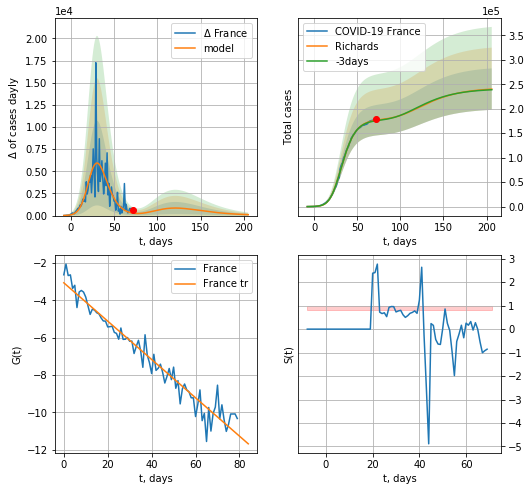

France data at: 2020-05-15
+3 day model MAPE: 0.005449
model: Richards
coeffs: [1.78247843e+05 2.77672865e-01 2.20525121e+01 3.87751717e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.176526
forecast at the end of period: +134 days
	 deltaDaycases: 102
	 total cases: 240037 ± 42372
	 total death: 36812 ± 19494
trend coefficient of determination: 0.949527
 intercept: -3.054872
 slope: -0.102813


In [117]:
x = forecastRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


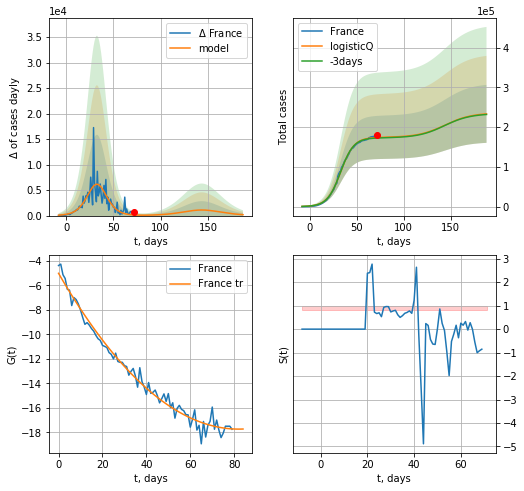

France data at: 2020-05-15
+3 day model MAPE: 0.007407
model: logisticQ
coeffs: [ 1.74086653e+05  1.27944488e-06  3.30074852e+01 -1.10458788e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312556
forecast at the end of period: +116 days
	 deltaDaycases: 180
	 total cases: 233181 ± 72882
	 total death: 35760 ± 33530
trend coefficient of determination: 0.982354
 intercept_: -5.030159958479219
 coeffs_: [ 0.         -0.30952442  0.00188624]


In [118]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


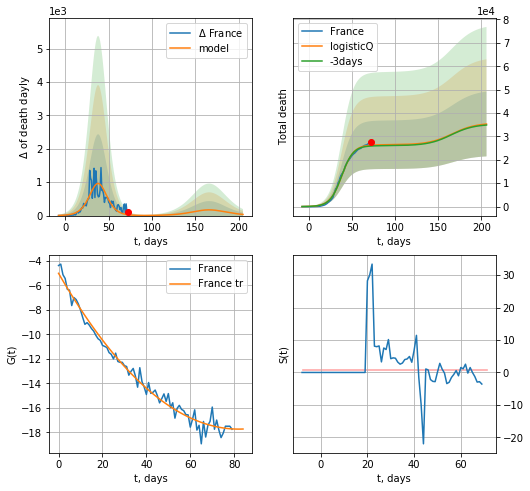

France data at: 2020-05-15
+3 day model MAPE: 0.013457
model: logisticQ
coeffs: [ 2.64240705e+04  1.30333889e-06  3.81533954e+01 -1.11884002e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.391925
forecast at the end of period: +134 days
	 total death: 35300 ± 13835
trend coefficient of determination: 0.982354
 intercept_: -5.030159958479219
 coeffs_: [ 0.         -0.30952442  0.00188624]


In [119]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [128]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [129]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


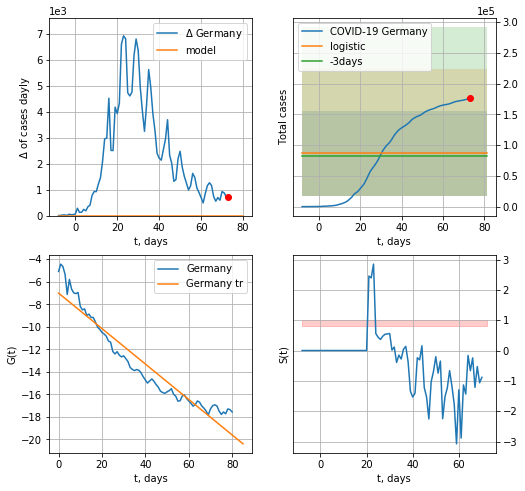

Germany data at: 2020-05-15
+3 day model MAPE: 0.040474470885246666
model: logistic
coeffs:  [ 8.64092317e+04 -3.79498695e+00  1.19814600e+02]
rational stdev:  0.7932210957130259
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  86409 ± 68541
	 total death:  3934 ± 9361
trend coefficient of determination: 0.916532
 intercept: -7.012479
 slope: -0.157520


In [120]:
x = forecast('Germany',dfGR[:],d1,7*8-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


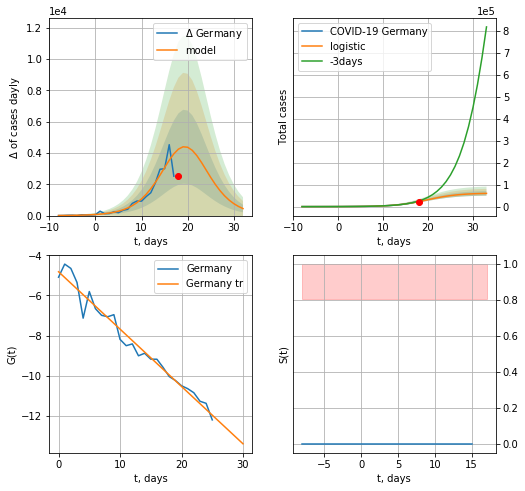

Germany data at: 2020-05-15
+3 day model MAPE: 0.18319320379671997
model: logistic
coeffs:  [6.16394025e+04 2.86275294e-01 1.98444846e+01]
rational stdev:  0.17054836328949527
forecast at the end of period: +15 days
	 deltaDaycases:  448
	 total cases:  60245 ± 10274
	 total death:  2743 ± 1403
trend coefficient of determination: 0.966826
 intercept: -4.817840
 slope: -0.285777


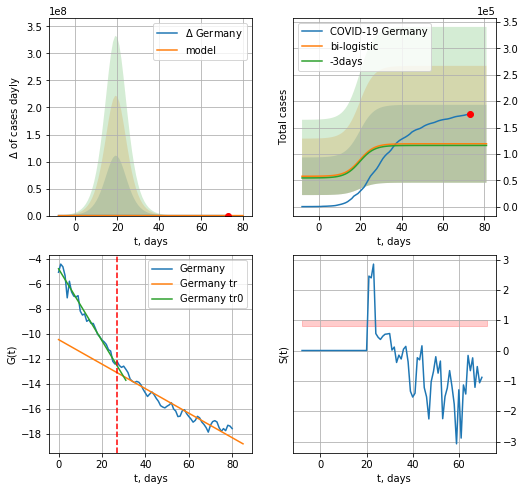

Germany data at: 2020-05-15
+3 day model MAPE: 0.027491145803352834
model: bi-logistic
coeffs:  [ 4.60771612e+04 -7.11122798e+00  1.06859829e+02] [6.16394025e+04 2.86275294e-01 1.98444846e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.6198431589274833
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  119235 ± 73907
	 total death:  5429 ± 10095
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970373
 intercept: -4.806769
 slope: -0.287106
trend coefficient of determination: 0.920867
 intercept: -10.462763
 slope: -0.097899


In [121]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,9*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*8-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
          date   cases  active   death
77 2020-05-11  172576   19298  7661.0
78 2020-05-12  173171   18233  7738.0
79 2020-05-13  174098   17537  7861.0
80 2020-05-14  174975   16747  7928.0
81 2020-05-15  175699   15998  8001.0


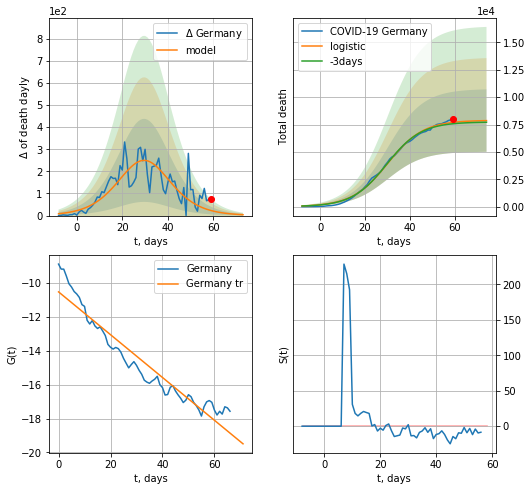

Germany data at: 2020-05-15
+3 day model MAPE: 0.01661557301574421
model: logistic
coeffs:  [7.88860131e+03 1.26784739e-01 3.00482513e+01]
rational stdev:  0.3630986072477962
forecast at the end of period: +15 days
	 total death:  7858 ± 2853
trend coefficient of determination: 0.916357
 intercept: -10.519007
 slope: -0.126358


In [122]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,9*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


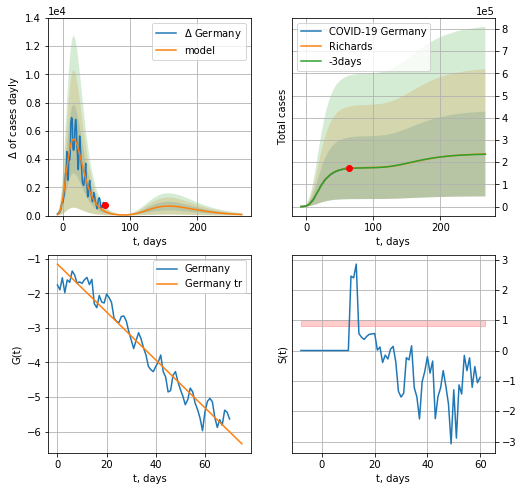

Germany data at: 2020-05-15
+3 day model MAPE: 0.004697
model: Richards
coeffs: [ 1.75780172e+05  7.11125802e+00 -3.58852043e+01  1.18671768e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.805545
forecast at the end of period: +204 days
	 deltaDaycases: 76
	 total cases: 236829 ± 190776
	 total death: 10784 ± 26060
trend coefficient of determination: 0.952748
 intercept: -1.154133
 slope: -0.069313


In [123]:
x = forecastRR('Germany',dfGR[10:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


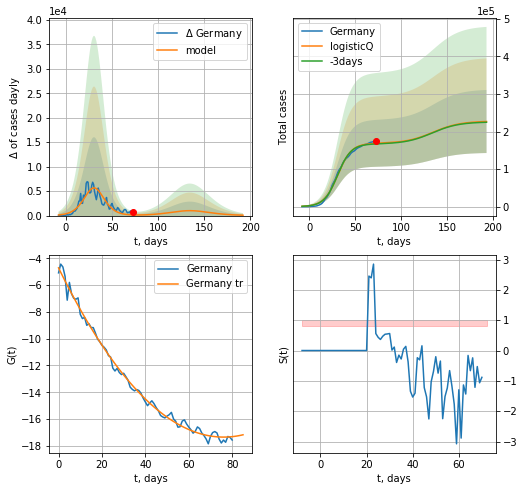

Germany data at: 2020-05-15
+3 day model MAPE: 0.009435
model: logisticQ
coeffs: [ 1.68222937e+05  7.01353649e-07  3.09180630e+01 -1.91761716e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.370421
forecast at the end of period: +120 days
	 deltaDaycases: 77
	 total cases: 226667 ± 83962
	 total death: 10321 ± 11469
trend coefficient of determination: 0.993444
 intercept_: -4.715336500947034
 coeffs_: [ 0.         -0.33200178  0.00218112]


In [124]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


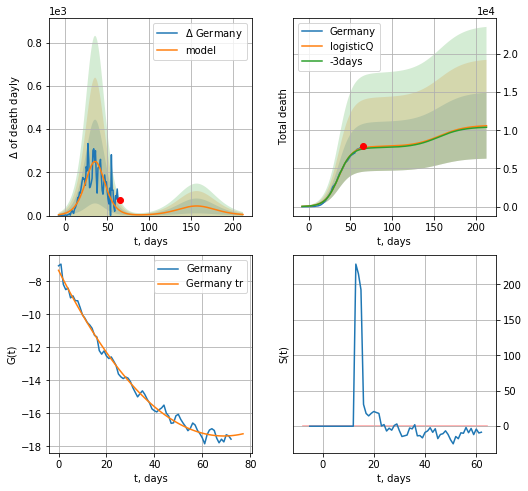

Germany data at: 2020-05-15
+3 day model MAPE: 0.016842
model: logisticQ
coeffs: [ 7.88447407e+03  4.88266481e-06  3.60403803e+01 -2.59517415e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.407538
forecast at the end of period: +148 days
	 total death: 10600 ± 4319
trend coefficient of determination: 0.992549
 intercept_: -7.331733868484341
 coeffs_: [ 0.         -0.2910097   0.00210769]


In [125]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

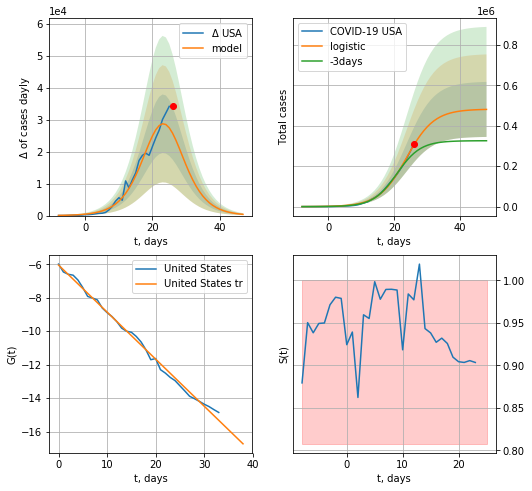

USA data at: 2020-05-15
+3 day model MAPE: 0.19535827238289116
model: logistic
coeffs:  [4.82026100e+05 2.38779089e-01 2.37021772e+01]
rational stdev:  0.2829911701138887
forecast at the end of period: +22 days
	 deltaDaycases:  390
	 total cases:  480573 ± 135998
	 total death:  28656 ± 24328
trend coefficient of determination: 0.994973
 intercept: -6.048067
 slope: -0.281243


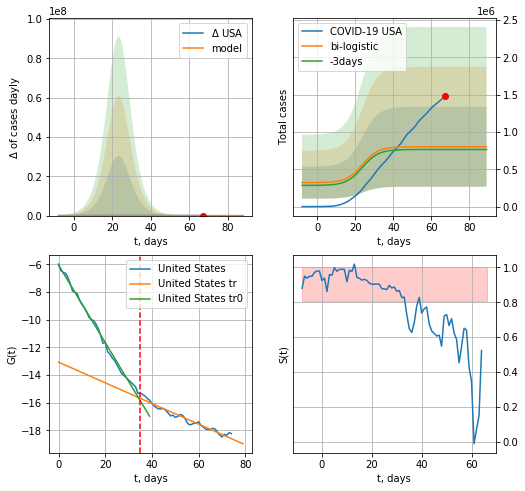

USA data at: 2020-05-15
+3 day model MAPE: 0.0482091116012855
model: bi-logistic
coeffs:  [ 2.56638382e+05 -3.97753996e+00  1.08008911e+02] [4.82026100e+05 2.38779089e-01 2.37021772e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.6672300305574477
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  802823 ± 535668
	 total death:  47871 ± 95822
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995079
 intercept: -6.063262
 slope: -0.279862
trend coefficient of determination: 0.952887
 intercept: -13.071150
 slope: -0.074678


In [127]:
vL=35
x = forecast('USA',dfUS[:vL],d1,10*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,10*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

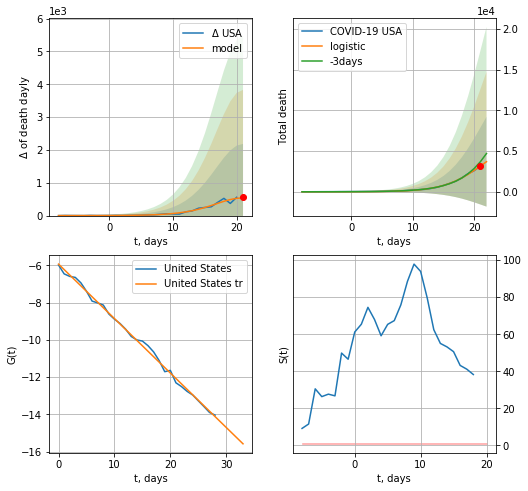

USA data at: 2020-05-15
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +1 days
	 total death:  3693 ± 5513
trend coefficient of determination: 0.996563
 intercept: -5.939898
 slope: -0.291951


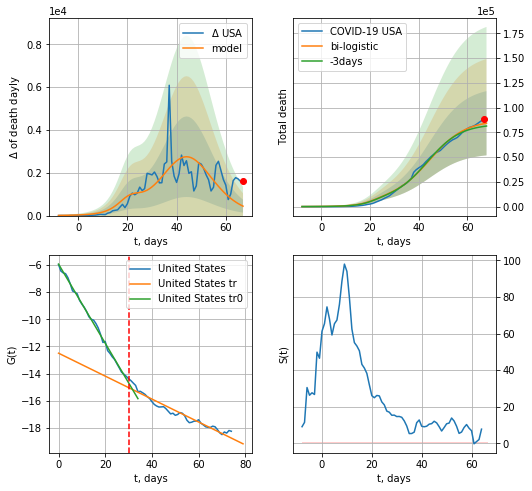

USA data at: 2020-05-15
+3 day model MAPE: 0.035064128577455736
model: bi-logistic
coeffs:  [8.05693461e+04 1.36494049e-01 4.45420052e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.385059737829633
forecast at the end of period: +1 days
	 deltaDaydeath:  440
	 total death:  84253 ± 32442
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996662
 intercept: -5.952610
 slope: -0.290589
trend coefficient of determination: 0.942488
 intercept: -12.494410
 slope: -0.084249


In [128]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*7-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*7-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


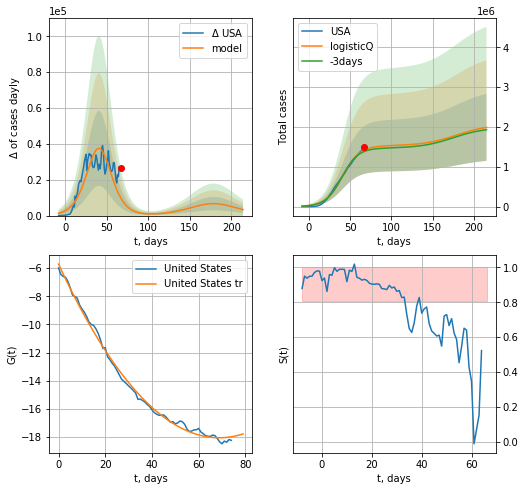

USA data at: 2020-05-15
+3 day model MAPE: 0.026751
model: logisticQ
coeffs: [ 1.52562109e+06  8.54104008e-07  4.10509185e+01 -1.15065705e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.422776
forecast at the end of period: +148 days
	 deltaDaycases: 3348
	 total cases: 1988244 ± 840581
	 total death: 118557 ± 150369
trend coefficient of determination: 0.995961
 intercept_: -5.7196341860427555
 coeffs_: [ 0.         -0.35832296  0.00260434]


In [129]:
x = forecastRRR('USA',dfUS[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


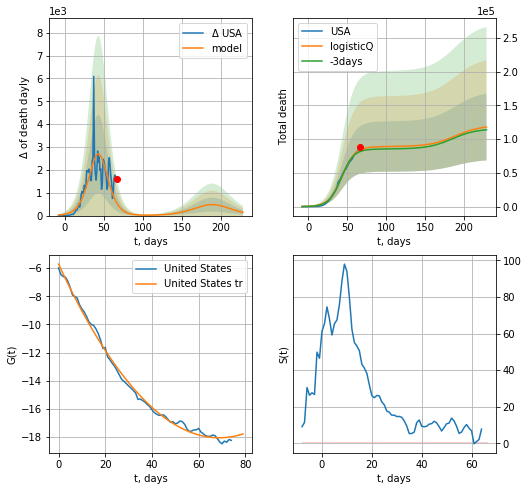

USA data at: 2020-05-15
+3 day model MAPE: 0.030604
model: logisticQ
coeffs: [ 8.89121451e+04  1.36844542e-06  4.33335183e+01 -8.86058344e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.419477
forecast at the end of period: +162 days
	 total death: 117896 ± 49454
trend coefficient of determination: 0.995961
 intercept_: -5.7196341860427555
 coeffs_: [ 0.         -0.35832296  0.00260434]


In [130]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


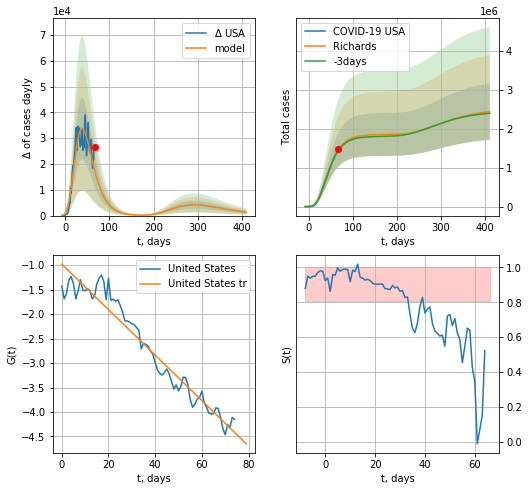

USA data at: 2020-05-15
+3 day model MAPE: 0.010375
model: Richards
coeffs: [ 1.85666353e+06  5.30051337e+00 -5.57399278e+01  9.35394505e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.296898
forecast at the end of period: +344 days
	 deltaDaycases: 1338
	 total cases: 2445561 ± 726081
	 total death: 145827 ± 129887
trend coefficient of determination: 0.945081
 intercept: -0.978395
 slope: -0.046483


In [131]:
x = forecastRR('USA',dfUS[:],d1,7*56-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


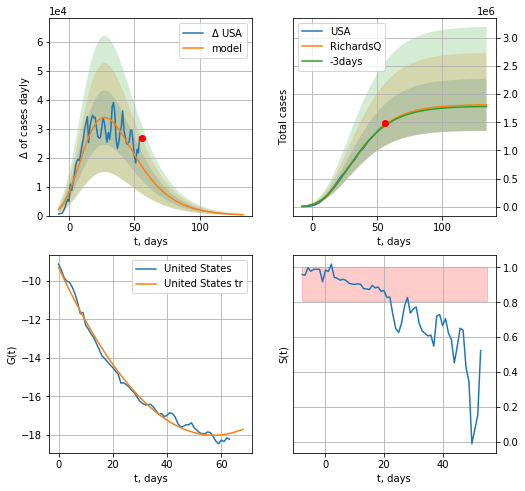

USA data at: 2020-05-15
+3 day model MAPE: 0.009804
model: RichardsQ
coeffs: [ 1.81381347e+06  1.54253678e-02 -1.03188644e+02 -9.90998379e+02
  2.86458357e-03]
rational stdev: 0.254938
forecast at the end of period: +78 days
	 deltaDaycases: 296
	 total cases: 1809024 ± 461189
	 total death: 107870 ± 82500
trend coefficient of determination: 0.991708
 intercept_: -9.292736525969508
 coeffs_: [ 0.         -0.3056472   0.00267361]


In [136]:
x = forecastQR('USA',dfUS[11:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
          date   cases  active    death
75 2020-05-11  223060  190651  32065.0
76 2020-05-12  226463  193427  32692.0
77 2020-05-13  229705  196175  33186.0
78 2020-05-14  233151       0  33614.0
79 2020-05-15  236711       0  33998.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


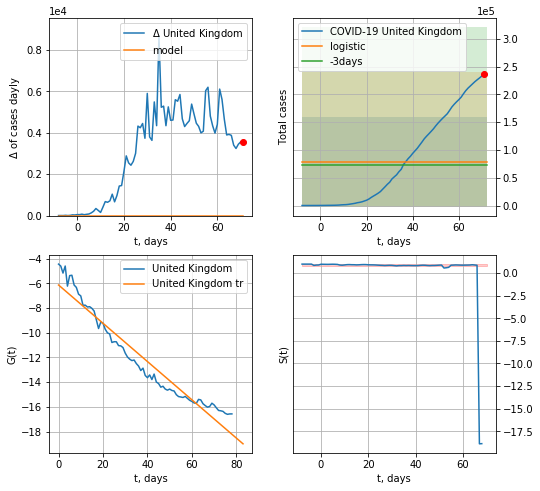

United Kingdom data at: 2020-05-15
+3 day model MAPE: 0.08247661503792046
model: logistic
coeffs:  [ 7.88971377e+04 -5.27920229e+00  1.45971258e+02]
rational stdev:  1.0251040819437853
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  78897 ± 80877
	 total death:  11331 ± 34846
trend coefficient of determination: 0.938058
 intercept: -6.137219
 slope: -0.154892


In [137]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*7-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


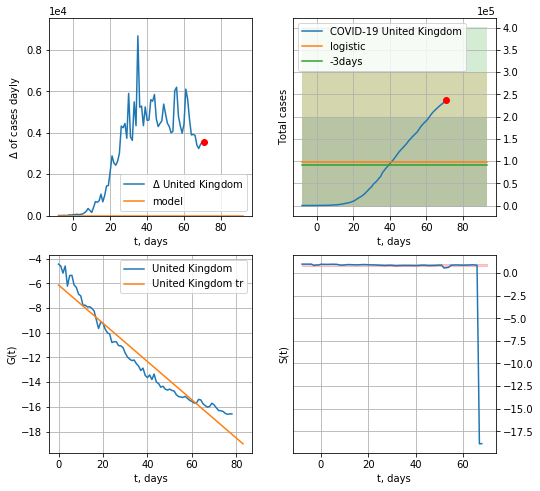

United Kingdom data at: 2020-05-15
+3 day model MAPE: 0.08247661503792045
model: logistic
coeffs:  [ 7.88971377e+04 -5.27920229e+00  1.45971258e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0251040819437853
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  98621 ± 101097
	 total death:  14164 ± 43558
trend coefficient of determination: 0.938058
 intercept: -6.137219
 slope: -0.154892


In [138]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


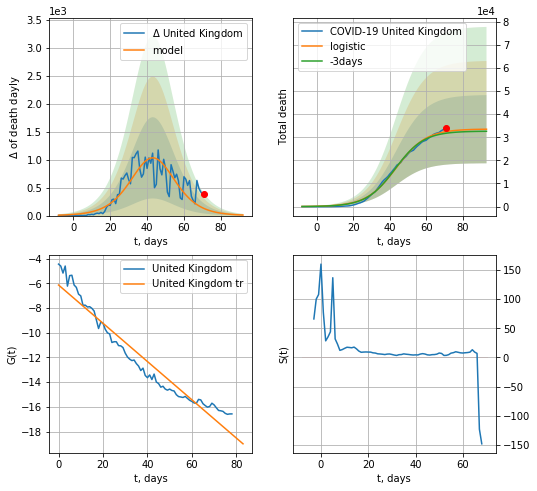

United Kingdom data at: 2020-05-15
+3 day model MAPE: 0.022416335655990466
model: logistic
coeffs:  [3.35726869e+04 1.22938558e-01 4.35737055e+01]
rational stdev:  0.4405555705387263
forecast at the end of period: +22 days
	 total death:  33495 ± 14756
trend coefficient of determination: 0.938058
 intercept: -6.137219
 slope: -0.154892


In [139]:
x = forecast('United Kingdom',dfGB[:],d1,10*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


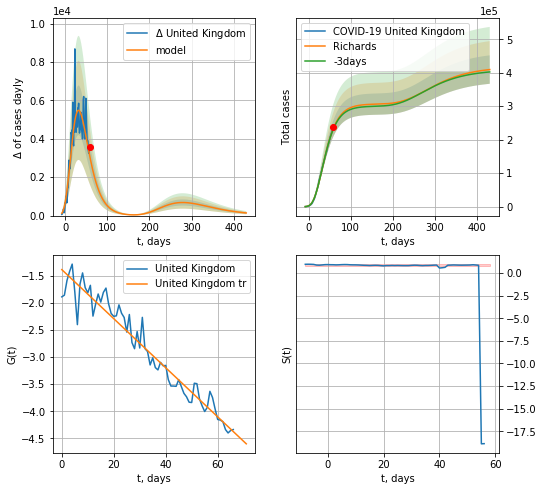

United Kingdom data at: 2020-05-15
+3 day model MAPE: 0.007736
model: Richards
coeffs: [ 3.06761233e+05  4.31463954e+00 -5.94511832e+01  1.13262920e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.103685
forecast at the end of period: +372 days
	 deltaDaycases: 137
	 total cases: 409420 ± 42450
	 total death: 58803 ± 18290
trend coefficient of determination: 0.941296
 intercept: -1.385191
 slope: -0.045290


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


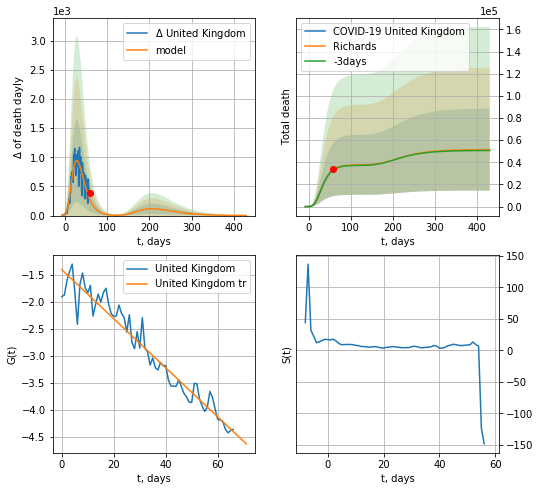

United Kingdom data at: 2020-05-15
+3 day model MAPE: 0.008196
model: Richards
coeffs: [ 3.78297472e+04  5.17336016e+00 -3.53736251e+01  1.31715870e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.718122
forecast at the end of period: +372 days
	 total death: 51464 ± 36958
trend coefficient of determination: 0.941852
 intercept: -1.399313
 slope: -0.045452


In [140]:
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


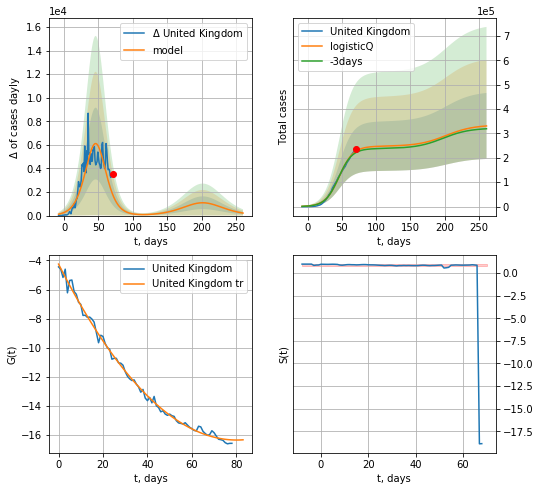

United Kingdom data at: 2020-05-15
+3 day model MAPE: 0.025948
model: logisticQ
coeffs: [ 2.47419515e+05  9.31336956e-07  4.63126832e+01 -1.06000345e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.409278
forecast at the end of period: +190 days
	 deltaDaycases: 212
	 total cases: 330639 ± 135323
	 total death: 47488 ± 58307
trend coefficient of determination: 0.995633
 intercept_: -4.255130271861962
 coeffs_: [ 0.         -0.30156349  0.00188049]


In [141]:
x = forecastRRR('United Kingdom',dfGB[:],d1,34*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


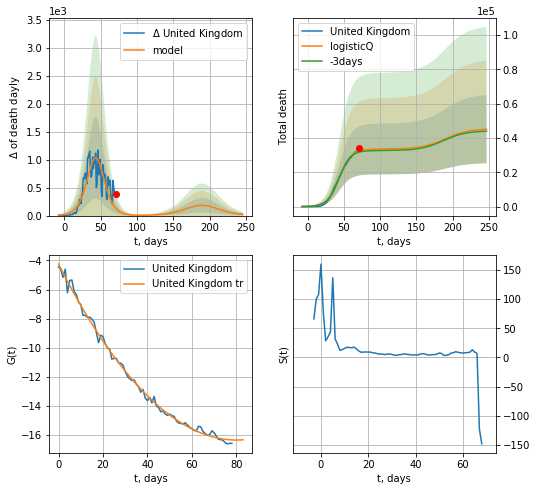

United Kingdom data at: 2020-05-15
+3 day model MAPE: 0.022457
model: logisticQ
coeffs: [ 3.35697796e+04  1.21081692e-06  4.35726974e+01 -1.01476606e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.440588
forecast at the end of period: +176 days
	 total death: 45120 ± 19879
trend coefficient of determination: 0.995633
 intercept_: -4.255130271861962
 coeffs_: [ 0.         -0.30156349  0.00188049]


In [142]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [134]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [135]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [136]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [137]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [138]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [143]:
dT

48

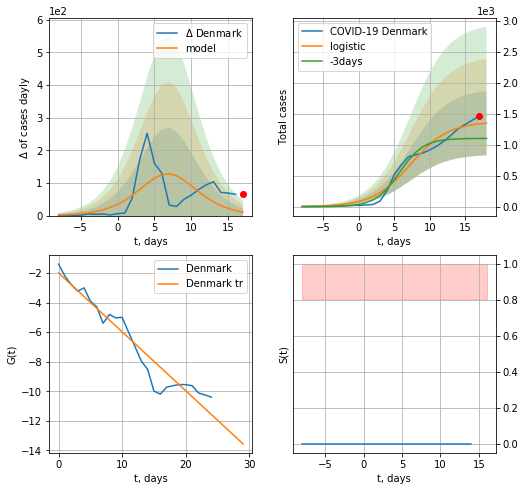

Denmark data at: 2020-05-15
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +1 days
	 deltaDaycases:  10
	 total cases:  1345 ± 517
	 total death:  66 ± 76
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


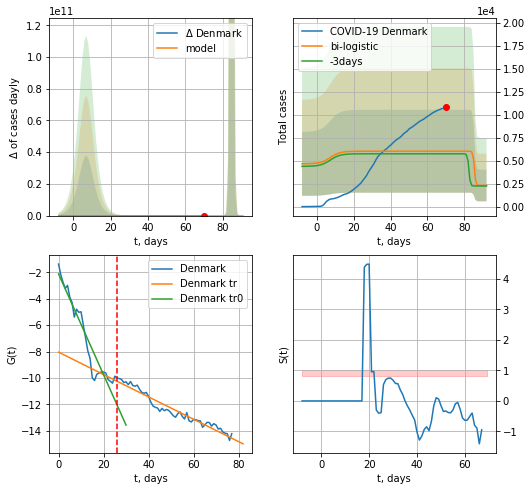

Denmark data at: 2020-05-15
+3 day model MAPE: 0.048353885396829666
model: bi-logistic
coeffs:  [ 3.72322556e+03 -2.80782765e+00  8.54258727e+01] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7483311134915954
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  2300 ± 1721
	 total death:  114 ± 255
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.942753
 intercept: -8.050109
 slope: -0.084570


In [144]:
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*7-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,10*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


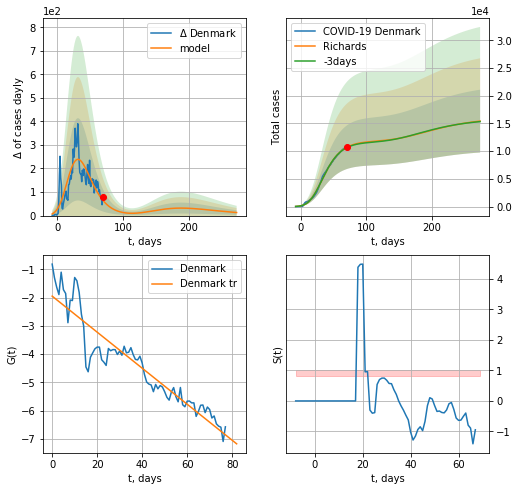

Denmark data at: 2020-05-15
+3 day model MAPE: 0.006412
model: Richards
coeffs: [1.18340562e+04 3.37071285e-01 2.78722553e+00 1.77089787e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.367119
forecast at the end of period: +204 days
	 deltaDaycases: 13
	 total cases: 15429 ± 5664
	 total death: 767 ± 844
trend coefficient of determination: 0.878382
 intercept: -1.949519
 slope: -0.063743


In [145]:
x = forecastRR('Denmark',dfDK[:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


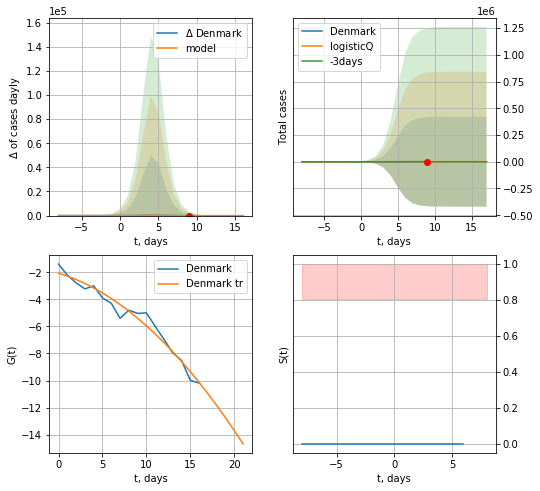

Denmark data at: 2020-05-15
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +8 days
	 deltaDaycases: 0
	 total cases: 862 ± 420259
	 total death: 42 ± 61395
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


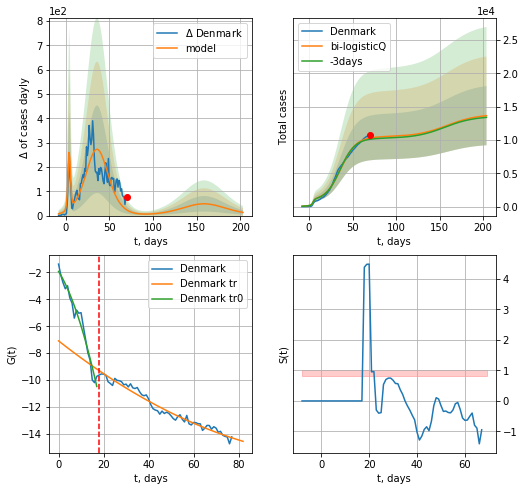

Denmark data at: 2020-05-15
+3 day model MAPE: 0.018986
model: bi-logisticQ
coeffs: [ 9.63172170e+03  5.81594129e-07  3.64291059e+01 -1.94687848e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.325307
forecast at the end of period: +134 days
	 deltaDaycases: 13
	 total cases: 13664 ± 4445
	 total death: 679 ± 662
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.967161
 intercept_: -7.083983141373849
 coeffs_: [ 0.         -0.13153293  0.00049452]


In [146]:
x = forecastRRR('Denmark',dfDK[:18],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
          date  cases  active  death
75 2020-05-11   8132    7876  224.0
76 2020-05-12   8157    7897  228.0
77 2020-05-13   8175    7914  229.0
78 2020-05-14   8196    7932  232.0
79 2020-05-15   8219    7955  232.0


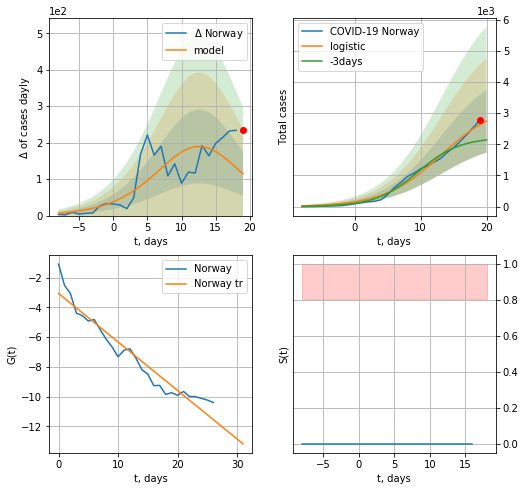

Norway data at: 2020-05-15
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +1 days
	 deltaDaycases:  114
	 total cases:  2743 ± 1007
	 total death:  77 ± 84
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


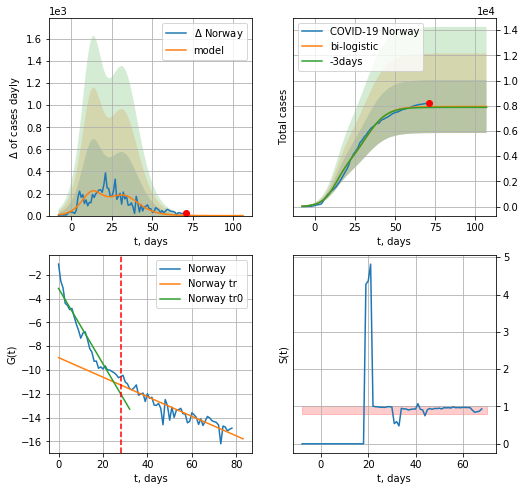

Norway data at: 2020-05-15
+3 day model MAPE: 0.008114046331318318
model: bi-logistic
coeffs:  [4.64409636e+03 1.53043697e-01 3.25383760e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.2649989813605
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  7942 ± 2104
	 total death:  224 ± 178
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.854152
 intercept: -8.961142
 slope: -0.082272


In [147]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,12*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

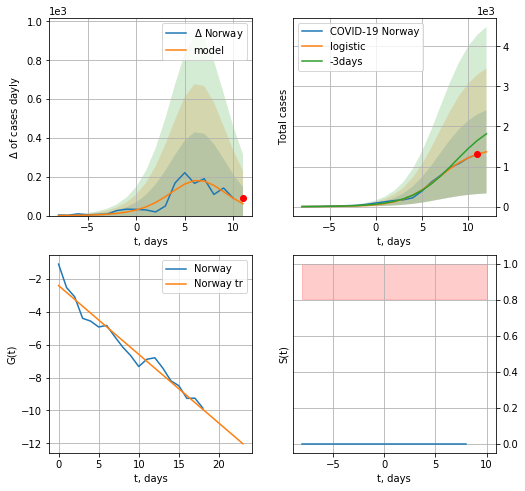

Norway data at: 2020-05-15
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +1 days
	 deltaDaycases:  61
	 total cases:  1367 ± 1038
	 total death:  38 ± 86
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


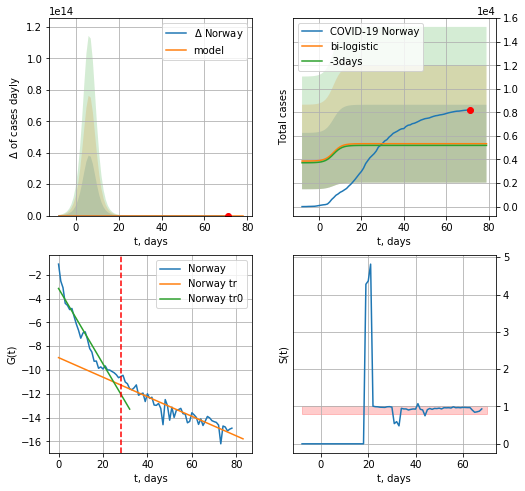

Norway data at: 2020-05-15
+3 day model MAPE: 0.027737977542312137
model: bi-logistic
coeffs:  [ 3.43455712e+03 -2.63985081e+00  1.42633533e+02] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.6189661528796325
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  5338 ± 3304
	 total death:  150 ± 278
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.854152
 intercept: -8.961142
 slope: -0.082272


In [148]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*7-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,8*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


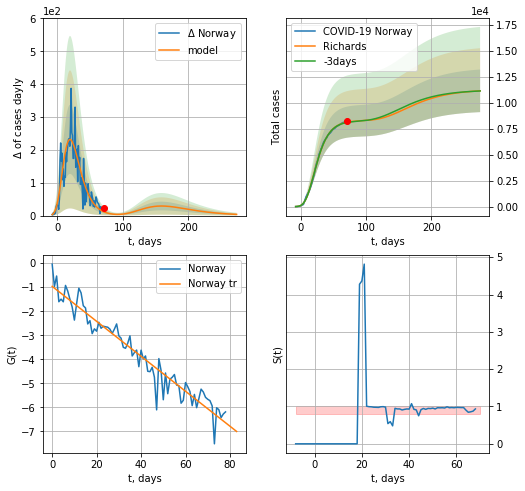

Norway data at: 2020-05-15
+3 day model MAPE: 0.003493
model: Richards
coeffs: [ 8.27669749e+03  2.22907807e+00 -2.35833076e+01  3.47518420e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.183973
forecast at the end of period: +204 days
	 deltaDaycases: 3
	 total cases: 11137 ± 2049
	 total death: 314 ± 173
trend coefficient of determination: 0.933396
 intercept: -0.964561
 slope: -0.072802


In [149]:
x = forecastRR('Norway',dfNG[:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


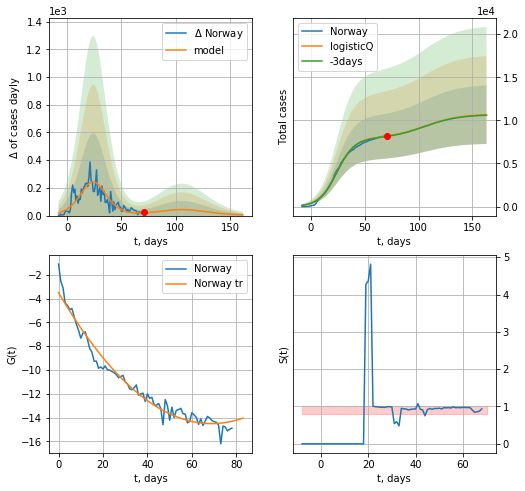

Norway data at: 2020-05-15
+3 day model MAPE: 0.006334
model: logisticQ
coeffs: [ 7.93136068e+03  7.71635044e-07  2.43386381e+01 -1.58795599e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.318195
forecast at the end of period: +92 days
	 deltaDaycases: 5
	 total cases: 10658 ± 3391
	 total death: 300 ± 286
trend coefficient of determination: 0.965355
 intercept_: -3.496974732135145
 coeffs_: [ 0.         -0.31995984  0.002324  ]


In [150]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

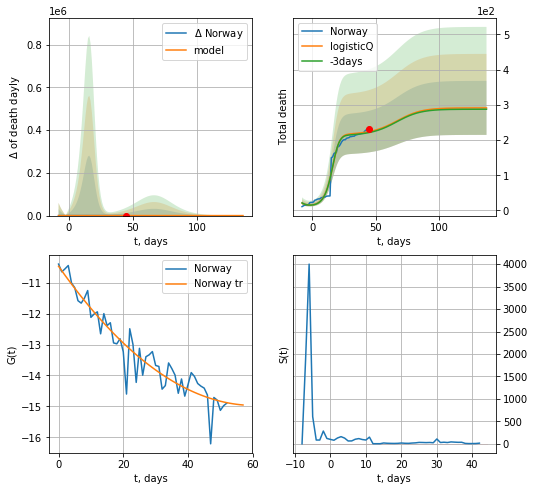

Norway data at: 2020-05-15
+3 day model MAPE: 0.012397
model: logisticQ
coeffs: [ 2.15176410e+02  8.90378787e-03  1.51453054e+01 -1.88739145e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.263206
forecast at the end of period: +92 days
	 total death: 291 ± 76
trend coefficient of determination: 0.903255
 intercept_: -10.469427849451588
 coeffs_: [ 0.         -0.14855026  0.001226  ]


In [151]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

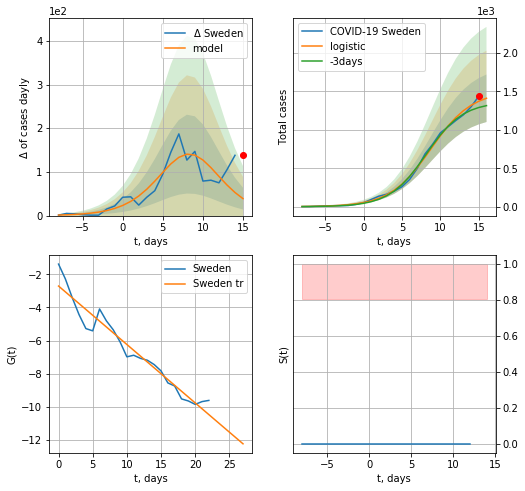

Sweden data at: 2020-05-15
+3 day model MAPE: 0.0730548600677782
model: logistic
coeffs:  [1.50473584e+03 3.76040161e-01 8.77120622e+00]
rational stdev:  0.21926973222081286
forecast at the end of period: +1 days
	 deltaDaycases:  38
	 total cases:  1411 ± 309
	 total death:  176 ± 115
trend coefficient of determination: 0.941971
 intercept: -2.710792
 slope: -0.352814


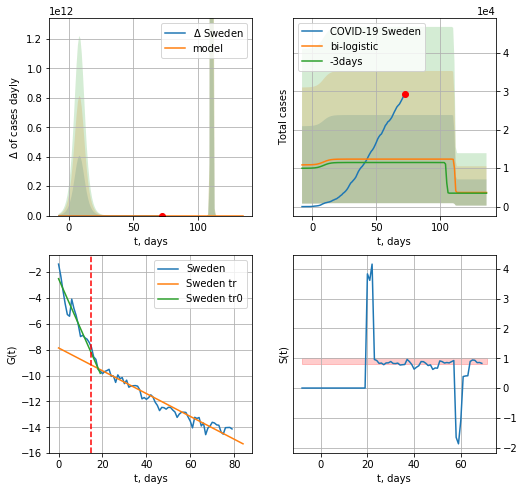

Sweden data at: 2020-05-15
+3 day model MAPE: 0.07689832808273632
model: bi-logistic
coeffs:  [ 8.69090135e+03 -3.95673878e+00  1.11245308e+02] [1.50473584e+03 3.76040161e-01 8.77120622e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9277242429027782
forecast at the end of period: +64 days
	 deltaDaycases:  0
	 total cases:  3677 ± 3411
	 total death:  459 ± 1277
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.870123
 intercept: -2.515075
 slope: -0.384868
trend coefficient of determination: 0.944407
 intercept: -7.864641
 slope: -0.088212


In [152]:
vL = 15#len(dfSW)-12-dT
x = forecast('Sweden',dfSW[:-9-dT],d1,7*7-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
          date  cases  active   death
76 2020-05-11  26670   18443  3256.0
77 2020-05-12  27272   18988  3313.0
78 2020-05-13  27909   19478  3460.0
79 2020-05-14  28582   20082  3529.0
80 2020-05-15  29207   20590  3646.0


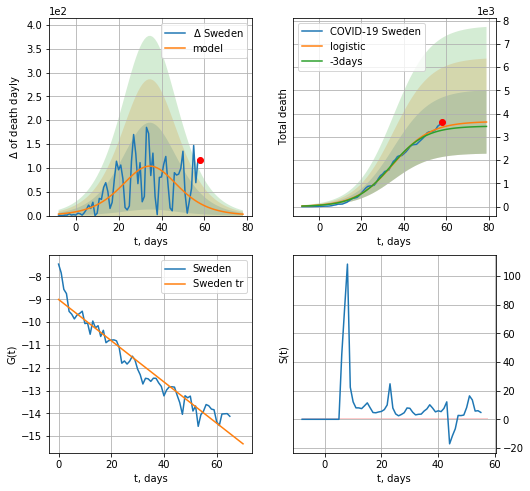

Sweden data at: 2020-05-15
+3 day model MAPE: 0.03971086325885885
model: logistic
coeffs:  [3.66418945e+03 1.13339407e-01 3.50315539e+01]
rational stdev:  0.37481723197567507
forecast at the end of period: +21 days
	 total death:  3639 ± 1364
trend coefficient of determination: 0.937637
 intercept: -9.002021
 slope: -0.090447


In [153]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


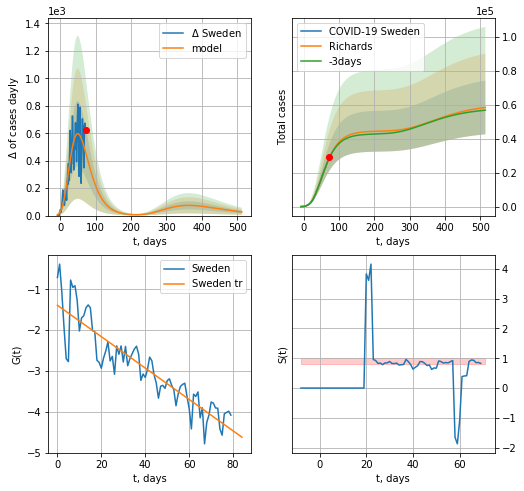

Sweden data at: 2020-05-15
+3 day model MAPE: 0.009213
model: Richards
coeffs: [ 4.46052326e+04  1.59568365e+00 -5.26644512e+01  2.30603094e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.270867
forecast at the end of period: +442 days
	 deltaDaycases: 26
	 total cases: 58517 ± 15850
	 total death: 7304 ± 5935
trend coefficient of determination: 0.816115
 intercept: -1.389876
 slope: -0.038467


In [154]:
x = forecastRR('Sweden',dfSW[:],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


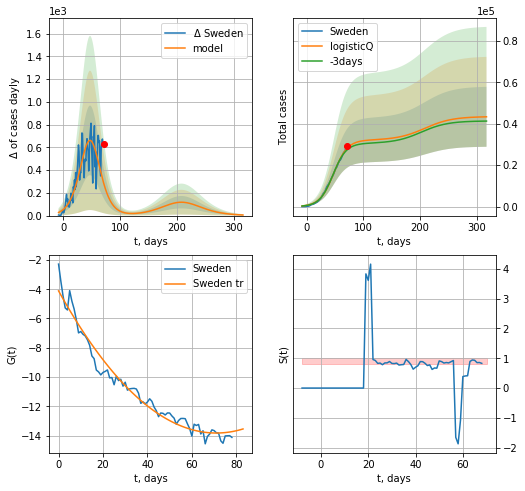

Sweden data at: 2020-05-15
+3 day model MAPE: 0.027805
model: logisticQ
coeffs: [ 3.20927880e+04  1.12675129e-06  4.77736965e+01 -7.30146245e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333742
forecast at the end of period: +246 days
	 deltaDaycases: 5
	 total cases: 43334 ± 14462
	 total death: 5409 ± 5415
trend coefficient of determination: 0.968122
 intercept_: -4.112471297519458
 coeffs_: [ 0.         -0.27376753  0.00192833]


In [155]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


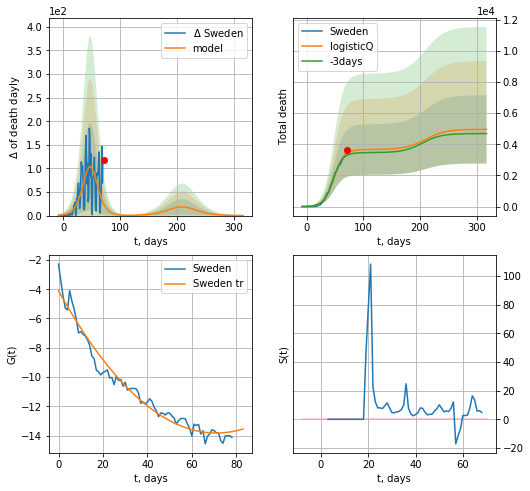

Sweden data at: 2020-05-15
+3 day model MAPE: 0.039742
model: logisticQ
coeffs: [ 3.66109347e+03  1.42909576e-06  4.80131424e+01 -7.93837067e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.442073
forecast at the end of period: +246 days
	 total death: 4954 ± 2190
trend coefficient of determination: 0.968122
 intercept_: -4.112471297519458
 coeffs_: [ 0.         -0.27376753  0.00192833]


In [156]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

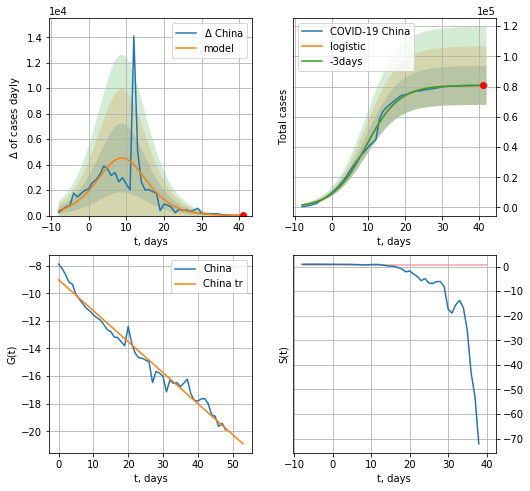

China data at: 2020-05-15
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +1 days
	 deltaDaycases:  13
	 total cases:  80757 ± 12898
	 total death:  4511 ± 2161
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


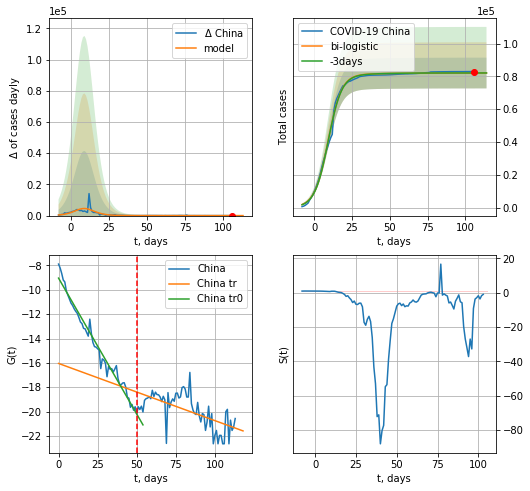

China data at: 2020-05-15
+3 day model MAPE: 0.00050437927712088
model: bi-logistic
coeffs:  [1.26300548e+03 4.70794769e-02 2.45620686e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.11426442012987825
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  82054 ± 9375
	 total death:  4583 ± 1571
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.384381
 intercept: -16.046947
 slope: -0.046979


In [157]:
x = forecast('China',dfCN[:50],d1,7*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
xx = forecast2('China',dfCN[:],d1,8*7-dT,x,1.0,vL=50)

In [158]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

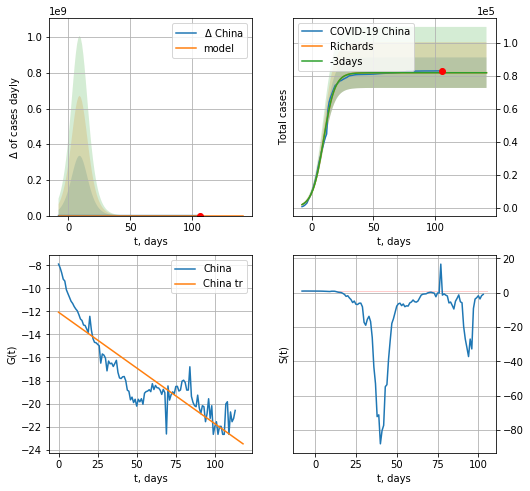

China data at: 2020-05-15
+3 day model MAPE: 0.000560
model: Richards
coeffs: [8.18518129e+04 2.17728062e-01 9.47912960e+00 1.00205082e+00]
rational stdev: 0.113133
forecast at the end of period: +36 days
	 deltaDaycases: 0
	 total cases: 81851 ± 9260
	 total death: 4572 ± 1551
trend coefficient of determination: 0.786743
 intercept: -12.076829
 slope: -0.096757


In [159]:
x = forecastRR('China',dfCN[:],d1,12*7-dT,1.0)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

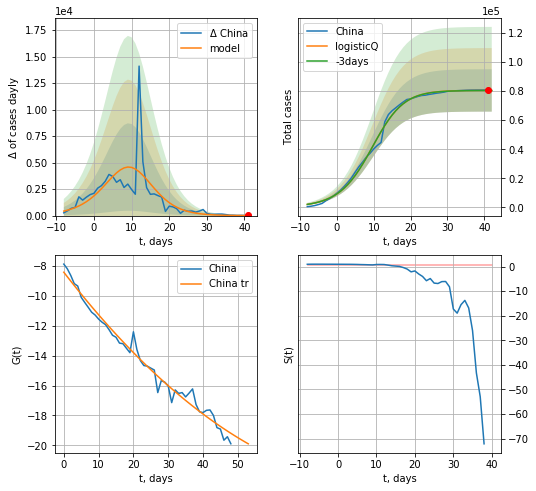

China data at: 2020-05-15
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +1 days
	 deltaDaycases: 5
	 total cases: 80402 ± 14554
	 total death: 4491 ± 2438
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


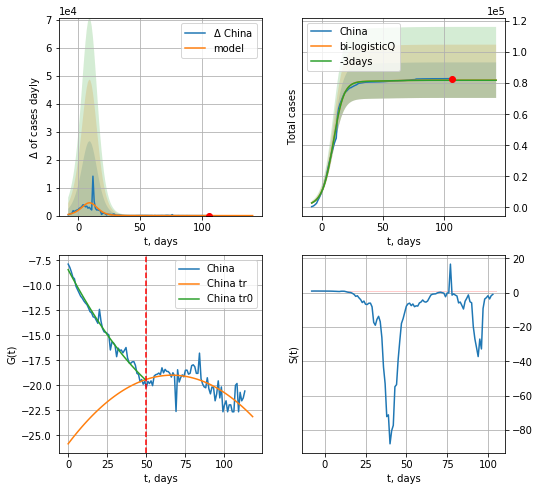

China data at: 2020-05-15
+3 day model MAPE: 0.000661
model: bi-logisticQ
coeffs: [ 1.55015502e+03  6.88874829e-04  2.48664822e+01 -1.62059532e-02]
rational stdev: 0.139406
forecast at the end of period: +36 days
	 deltaDaycases: 0
	 total cases: 81967 ± 11426
	 total death: 4578 ± 1914
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.500254
 intercept_: -25.850822863151958
 coeffs_: [ 0.          0.20664667 -0.00155605]


In [160]:
x = forecastRRR('China',dfCN[:50],d1,7*7-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,12*7-dT,x,1.0,vL=50)

In [161]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
          date  cases  active  death
86 2020-05-11  10936  1008.0  258.0
87 2020-05-12  10962  1008.0  259.0
88 2020-05-13  10991   969.0  260.0
89 2020-05-14  11018   937.0  260.0
90 2020-05-15  11037   924.0  262.0


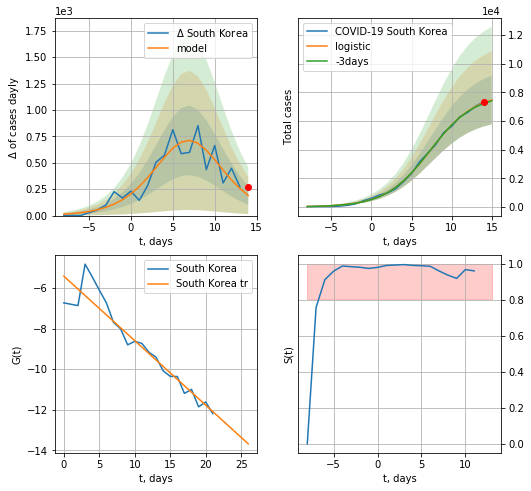

South Korea data at: 2020-05-15
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +1 days
	 deltaDaycases:  190
	 total cases:  7461 ± 1698
	 total death:  177 ± 120
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


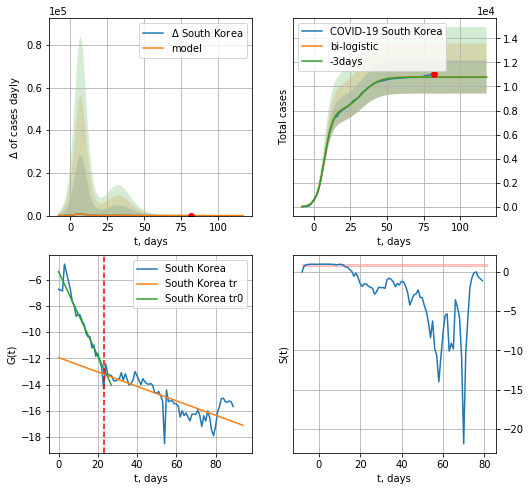

South Korea data at: 2020-05-15
+3 day model MAPE: 0.0024834846905499265
model: bi-logistic
coeffs:  [2.85508217e+03 1.70831714e-01 3.28175376e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.12806909360937863
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  10796 ± 1382
	 total death:  256 ± 98
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.609799
 intercept: -11.940745
 slope: -0.054885


In [162]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*7-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,12*7-dT,x,1.0,vL=23)

In [163]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

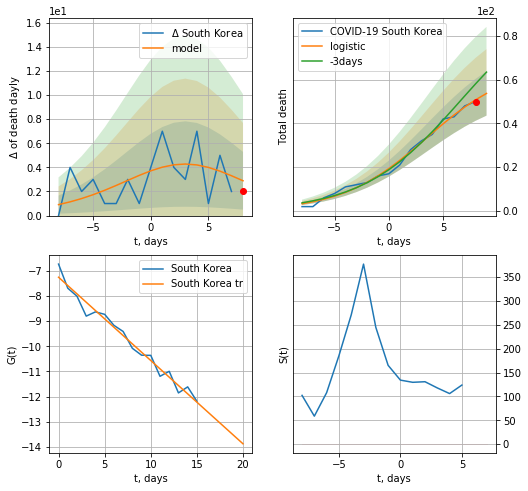

South Korea data at: 2020-05-15
model: logistic
coeffs:  [66.59757424  0.25734808  3.46382915]
rational stdev:  0.18867115045959354
forecast at the end of period: +1 days
	 total death:  53 ± 10
trend coefficient of determination: 0.972428
 intercept: -7.252219
 slope: -0.331355


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


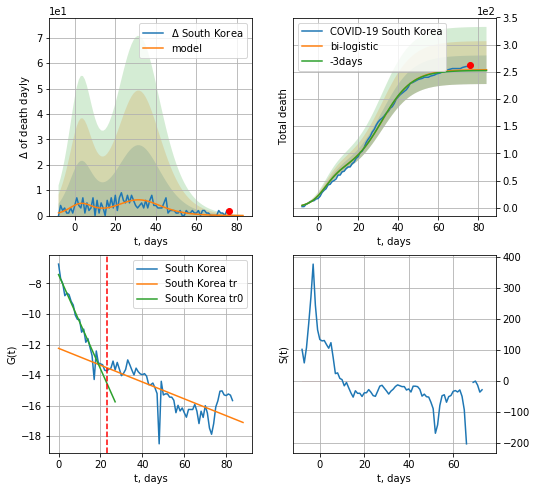

South Korea data at: 2020-05-15
+3 day model MAPE: 0.005485485165731512
model: bi-logistic
coeffs:  [1.87408771e+02 1.32429001e-01 3.19611922e+01] [66.59757424  0.25734808  3.46382915]
rational stdev:  0.10353680439206056
forecast at the end of period: +8 days
	 deltaDaydeath:  0
	 total death:  253 ± 26
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.950305
 intercept: -7.416817
 slope: -0.308862
trend coefficient of determination: 0.554422
 intercept: -12.249829
 slope: -0.055219


In [164]:
x = forecast('South Korea',dfKR[6:23],d1,7*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[6:],d1,8*7-dT,x,1.0,vL=23,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


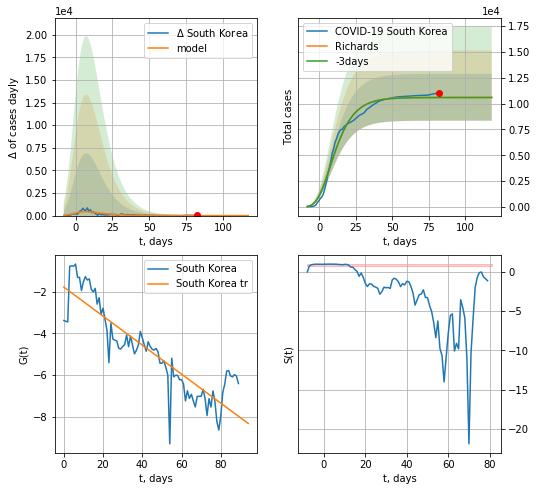

South Korea data at: 2020-05-15
+3 day model MAPE: 0.003335
model: Richards
coeffs: [ 1.06183368e+04  3.01569075e+01 -4.35245181e+01  3.64005516e-03]
rational stdev: 0.213735
forecast at the end of period: +36 days
	 deltaDaycases: 0
	 total cases: 10618 ± 2269
	 total death: 252 ± 161
trend coefficient of determination: 0.775704
 intercept: -1.776567
 slope: -0.069535


In [165]:
x = forecastRR('South Korea',dfKR[:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


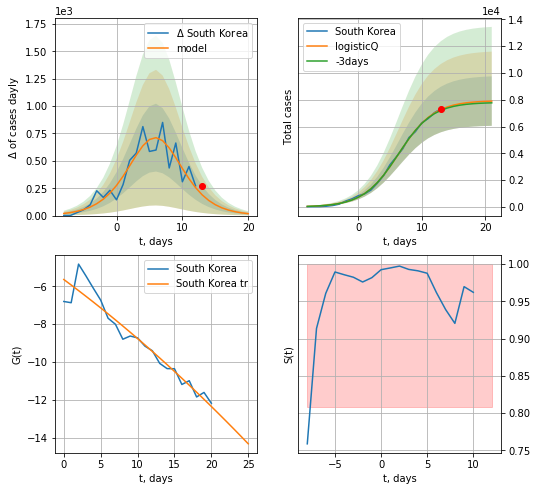

South Korea data at: 2020-05-15
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +8 days
	 deltaDaycases: 17
	 total cases: 7896 ± 1843
	 total death: 187 ± 131
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


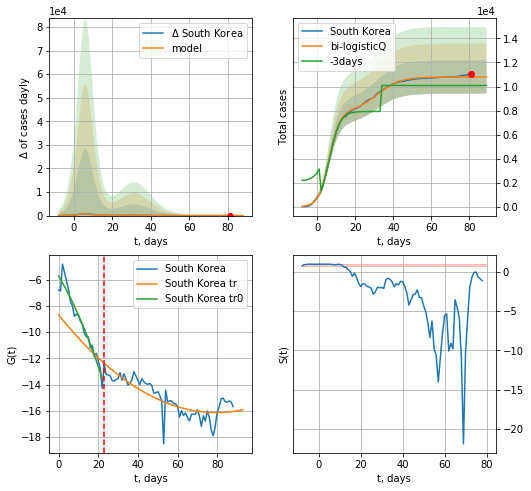

South Korea data at: 2020-05-15
+3 day model MAPE: 0.069936
model: bi-logisticQ
coeffs: [ 2.85992166e+03  1.07173147e-06  3.17958673e+01 -1.59077102e+05]
rational stdev: 0.128446
forecast at the end of period: +8 days
	 deltaDaycases: 0
	 total cases: 10796 ± 1386
	 total death: 256 ± 98
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.697387
 intercept_: -8.686201632926473
 coeffs_: [ 0.         -0.18747418  0.00118083]


In [166]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,8*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,8*7-dT,x,1.0,vL=vL)

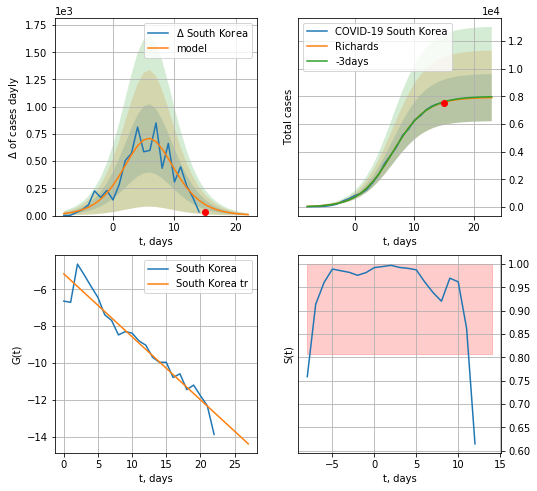

South Korea data at: 2020-05-15
+3 day model MAPE: 0.005302
model: Richards
coeffs: [7.93327913e+03 3.71274932e-01 6.16788537e+00 9.53222659e-01]
rational stdev: 0.215580
forecast at the end of period: +8 days
	 deltaDaycases: 9
	 total cases: 7911 ± 1705
	 total death: 187 ± 120
trend coefficient of determination: 0.927975
 intercept: -5.164068
 slope: -0.341524


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


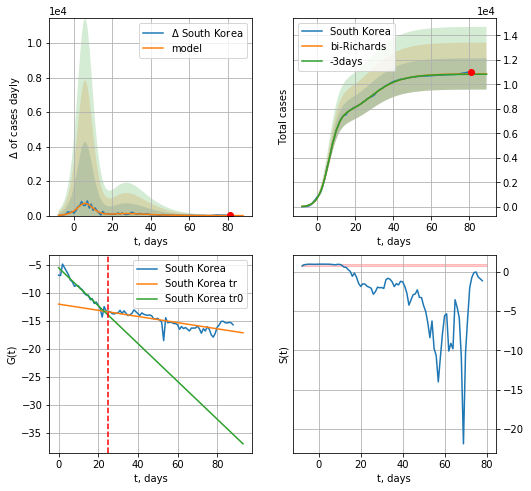

South Korea data at: 2020-05-15
+3 day model MAPE: 0.002563
model: bi-Richards
coeffs: [ 2.93201732e+03  7.01960891e+00 -9.87621331e+00  1.55962117e-02]
rational stdev: 0.117668
forecast at the end of period: +8 days
	 deltaDaycases: 0
	 total cases: 10861 ± 1278
	 total death: 257 ± 90
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936460
 intercept: -5.478818
 slope: -0.338423
trend coefficient of determination: 0.588889
 intercept: -11.977401
 slope: -0.055167


In [167]:
vL=25
x = forecastRR('South Korea',dfKR[1:vL],d1,8*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[1:],d1,8*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


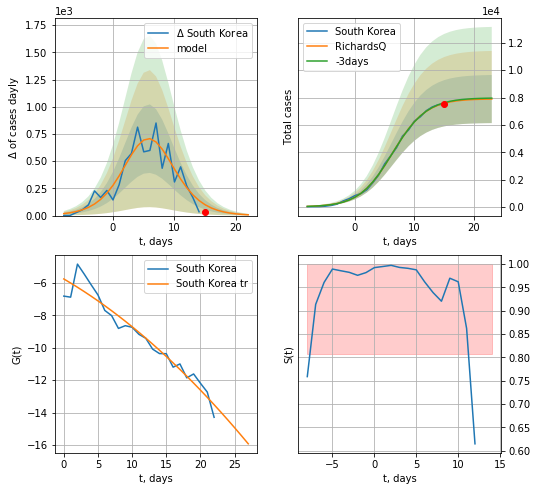

South Korea data at: 2020-05-15
+3 day model MAPE: 0.006079
model: RichardsQ
coeffs: [ 7.90607495e+03  3.14377481e-03 -1.32150046e+02  5.22462480e+00
  7.59593205e-01]
rational stdev: 0.222738
forecast at the end of period: +8 days
	 deltaDaycases: 7
	 total cases: 7891 ± 1757
	 total death: 187 ± 124
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:296: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:296: RuntimeWarning: overflow encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


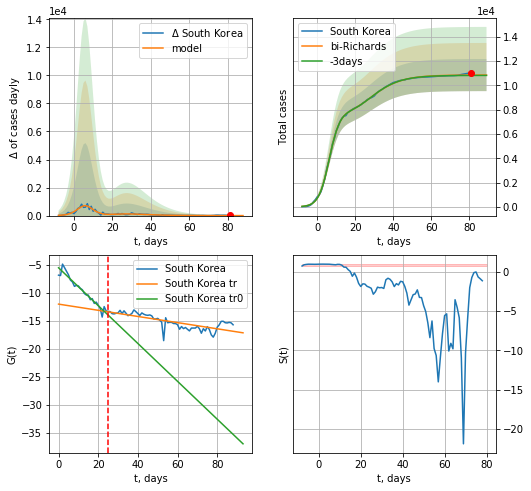

South Korea data at: 2020-05-15
+3 day model MAPE: 0.002722
model: bi-Richards
coeffs: [ 2.95012457e+03  1.77998561e-01 -4.48063372e+01 -5.79116050e+02
  8.93100566e-04]
rational stdev: 0.121693
forecast at the end of period: +8 days
	 deltaDaycases: 0
	 total cases: 10853 ± 1320
	 total death: 257 ± 93
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.936460
 intercept: -5.478818
 slope: -0.338423
trend coefficient of determination: 0.588889
 intercept: -11.977401
 slope: -0.055167


In [168]:
vL=25
x = forecastQR('South Korea',dfKR[1:vL],d1,8*7-dT,1.0)
xx=forecast2QR('South Korea',dfKR[1:],d1,8*7-dT,x,1.0,vL=vL)

In [169]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


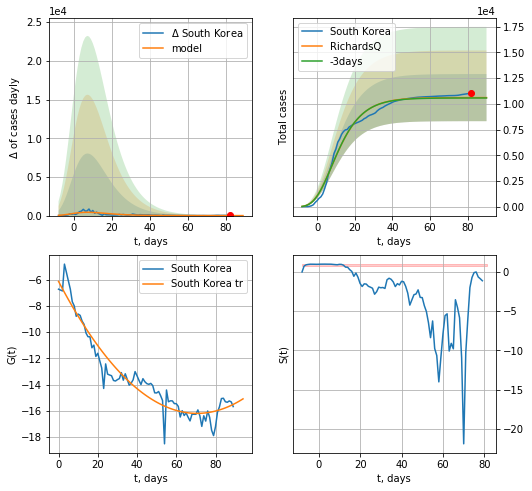

South Korea data at: 2020-05-15
+3 day model MAPE: 0.003362
model: RichardsQ
coeffs: [ 1.06114903e+04  1.43498382e-01 -6.79788733e+01 -2.17295157e+03
  3.37811901e-04]
rational stdev: 0.215630
forecast at the end of period: +8 days
	 deltaDaycases: 0
	 total cases: 10610 ± 2287
	 total death: 251 ± 162
trend coefficient of determination: 0.923955
 intercept_: -6.143896981392902
 coeffs_: [ 0.         -0.28472201  0.00201701]


In [170]:
x = forecastQR('South Korea',dfKR[:],d1,8*7-dT,1.0)

SG
           date  cases  active  death
109 2020-05-11  23822   20576   21.0
110 2020-05-12  24671   20799   21.0
111 2020-05-13  25346   20516   21.0
112 2020-05-14  26098   20104   21.0
113 2020-05-15  26891   19622   21.0


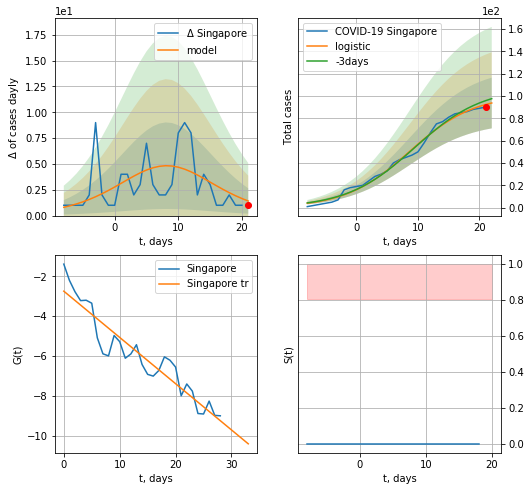

Singapore data at: 2020-05-15
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +1 days
	 deltaDaycases:  1
	 total cases:  93 ± 22
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


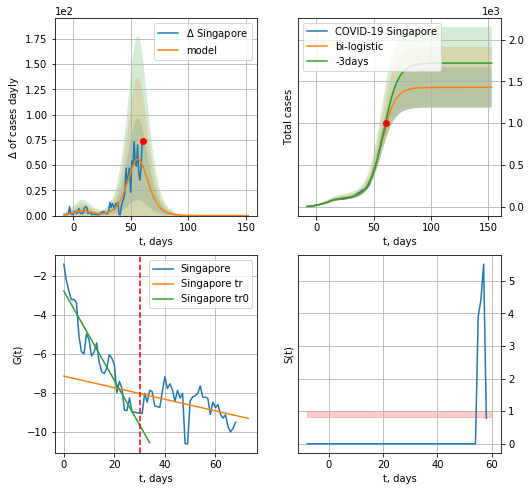

Singapore data at: 2020-05-15
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +92 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  1 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


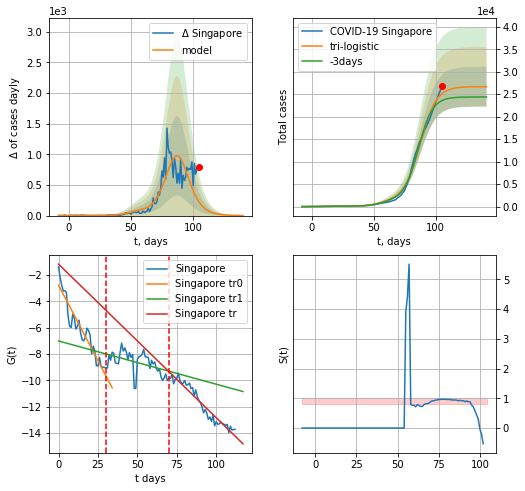

Singapore data at: 2020-05-15
+3 day model MAPE: 0.06817205463709257
model: tri-logistic
coeffs:  [2.52555408e+04 1.54504849e-01 8.75027062e+01] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.16600788659164326
forecast at the end of period: +36 days
	 deltaDaycases:  1
	 total cases:  26677 ± 4428
	 total death:  20 ± 9
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.936575
 intercept: -1.182151
 slope: -0.116495


In [171]:
vL = 30
vL1 = 70
dfSG = read_df(pd.DataFrame(),"SG")
x = forecast('Singapore',dfSG[:vL],d1,7*7-dT,1.0)
xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Singapore",dfSG,d1,12*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


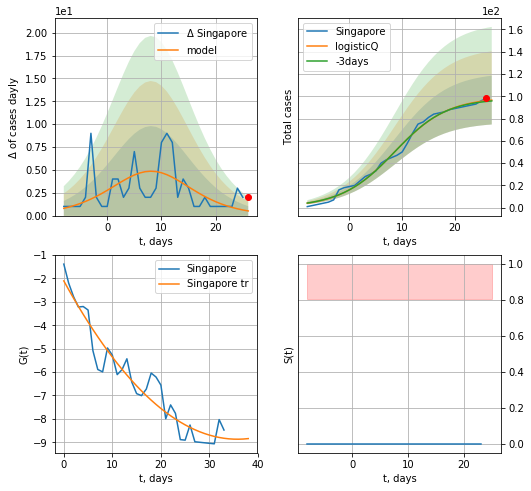

Singapore data at: 2020-05-15
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +1 days
	 deltaDaycases: 0
	 total cases: 96 ± 21
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


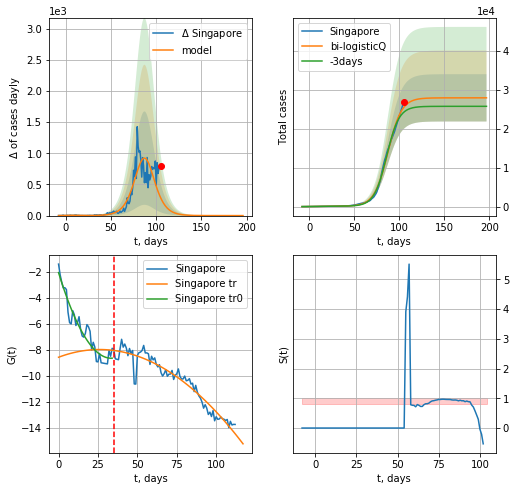

Singapore data at: 2020-05-15
+3 day model MAPE: 0.054419
model: bi-logisticQ
coeffs: [ 2.78181663e+04  2.62213959e-06  8.74597254e+01 -5.05404113e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.217362
forecast at the end of period: +92 days
	 deltaDaycases: 0
	 total cases: 27917 ± 6068
	 total death: 21 ± 13
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.922572
 intercept_: -8.553260644359758
 coeffs_: [ 0.          0.0456556  -0.00087678]


In [172]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*7-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [173]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


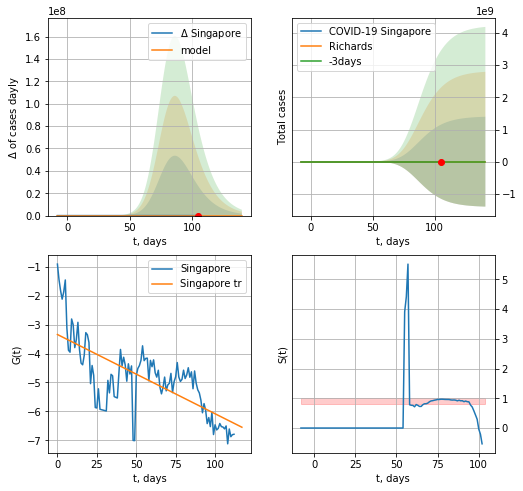

Singapore data at: 2020-05-15
+3 day model MAPE: 0.053049
model: Richards
coeffs: [3.18831595e+04 2.64905249e-01 7.32240865e+01 3.19868194e-01]
rational stdev: 44241.971331
forecast at the end of period: +36 days
	 deltaDaycases: 27
	 total cases: 31565 ± 1396532240
	 total death: 24 ± 3185421
trend coefficient of determination: 0.504709
 intercept: -3.344046
 slope: -0.027346


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:56: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


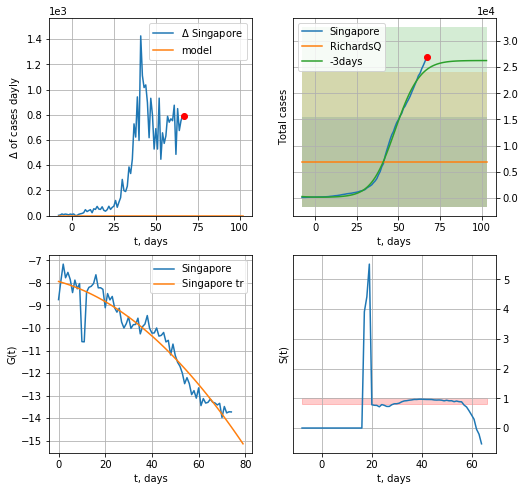

Singapore data at: 2020-05-15
+3 day model MAPE: 0.719874
model: RichardsQ
coeffs: [ 6.93356579e+03  1.65326793e+01 -2.45624074e+03  2.12793621e+03
 -5.65069040e+00]
rational stdev: 1.237895
forecast at the end of period: +36 days
	 deltaDaycases: 0
	 total cases: 6933 ± 8583
	 total death: 5 ± 18
trend coefficient of determination: 0.922766
 intercept_: -7.940710494053963
 coeffs_: [ 0.         -0.0288729  -0.00078749]


In [174]:
x = forecastRR('Singapore',dfSG[:],d1,12*7-dT,1.0)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
x = forecastQR('Singapore',dfSG[38:],d1,12*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


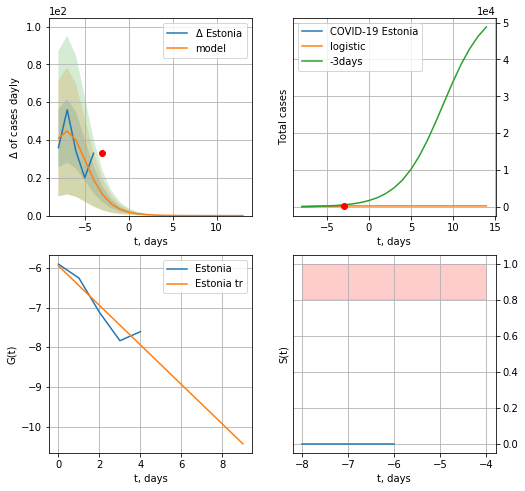

Estonia data at: 2020-05-15
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


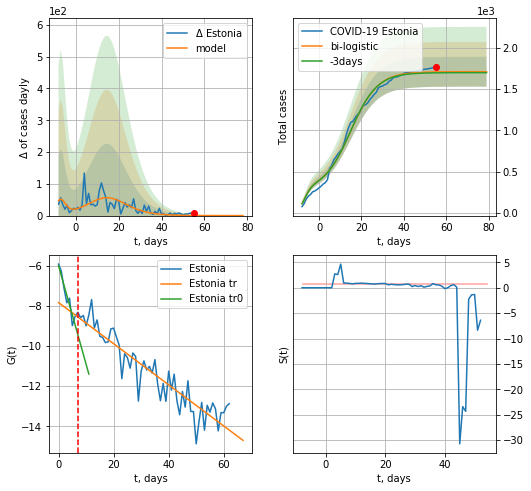

Estonia data at: 2020-05-15
+3 day model MAPE: 0.006513915520013847
model: bi-logistic
coeffs:  [1.43019541e+03 1.57386525e-01 1.50000230e+01] [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.10562921114207093
forecast at the end of period: +24 days
	 deltaDaycases:  0
	 total cases:  1707 ± 180
	 total death:  60 ± 19
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.848737
 intercept: -7.825544
 slope: -0.102675


In [175]:
shift = 1.0
x = forecast('Estonia',dfES[1:7],d1,17,1.)
xx = forecast2('Estonia',dfES[1:],d1,12*6-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


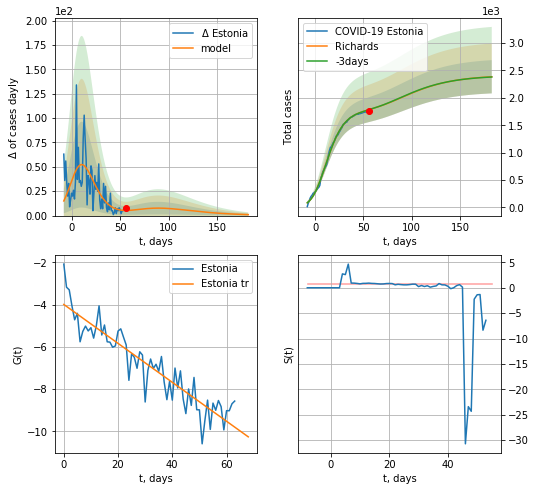

Estonia data at: 2020-05-15
+3 day model MAPE: 0.000122
model: Richards
coeffs: [1.77180003e+03 2.28049508e-01 2.01146321e+00 4.24447086e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.127100
forecast at the end of period: +127 days
	 deltaDaycases: 0
	 total cases: 2384 ± 303
	 total death: 85 ± 32
trend coefficient of determination: 0.848710
 intercept: -3.991835
 slope: -0.092253


In [176]:
x = forecastRR('Estonia',dfES[:],d1,7*25-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
#xx = forecast2R('Estonia',dfES[:],d1,7*5-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


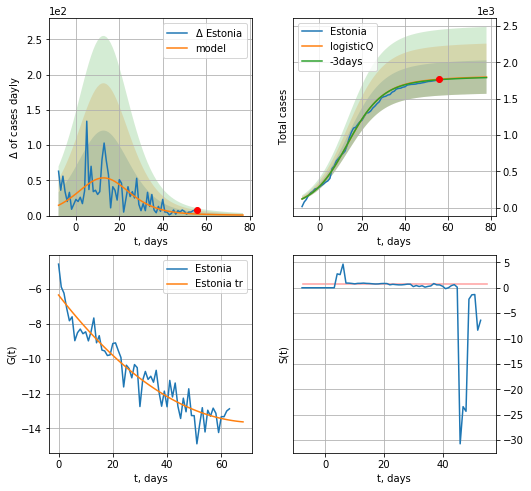

Estonia data at: 2020-05-15
+3 day model MAPE: 0.003775
model: logisticQ
coeffs: [ 1.73686325e+03  1.58718140e-06  1.31491635e+01 -7.72044582e+04]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.128025
forecast at the end of period: +22 days
	 deltaDaycases: 0
	 total cases: 1799 ± 230
	 total death: 64 ± 24
trend coefficient of determination: 0.905366
 intercept_: -6.363021478012096
 coeffs_: [ 0.         -0.20003485  0.00137191]


In [177]:
x = forecastRRR('Estonia',dfES[:],d1,7*10-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
          date  cases  active  death
65 2020-05-11  950.0     305   18.5
66 2020-05-12  951.0     305   19.0
67 2020-05-13  962.0     316   19.0
68 2020-05-14  970.0     324   19.0
69 2020-05-15  970.0     289   19.0


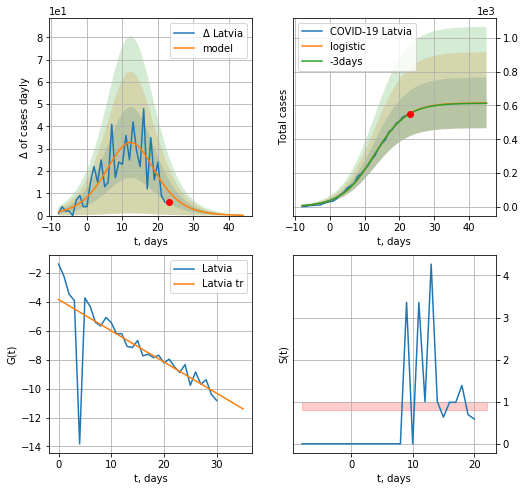

Latvia data at: 2020-05-15
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  615 ± 150
	 total death:  12 ± 8
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

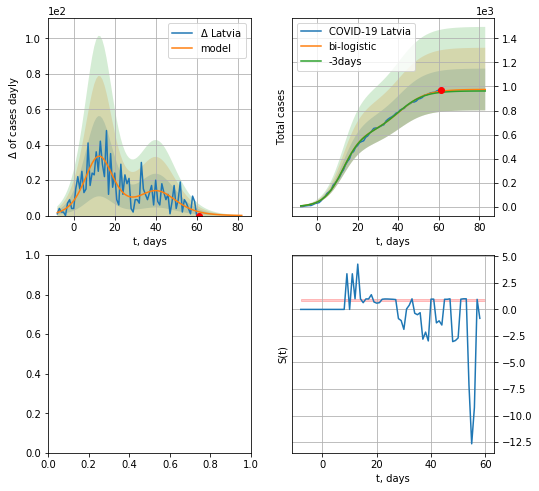

In [178]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
x = forecast('Latvia',dfLV[:vL],d1,10*7-dT,1.)
xx=forecast2('Latvia',dfLV[:],d1,10*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


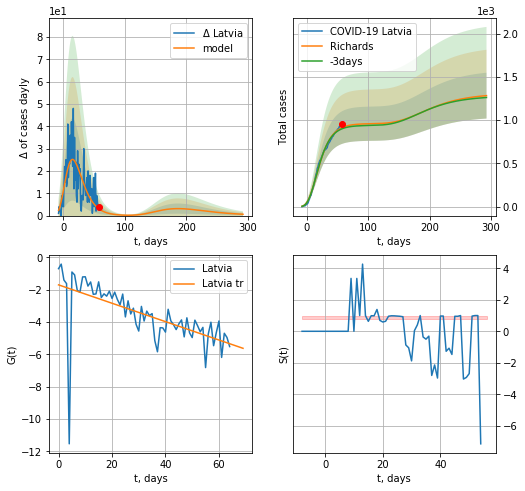

Latvia data at: 2020-05-11
+3 day model MAPE: 0.015304
model: Richards
coeffs: [ 9.60435908e+02  1.08472527e+01 -5.51374176e+01  6.58646329e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.206241
forecast at the end of period: +236 days
	 deltaDaycases: 0
	 total cases: 1283 ± 264
	 total death: 24 ± 14
trend coefficient of determination: 0.372134
 intercept: -1.700164
 slope: -0.056846


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


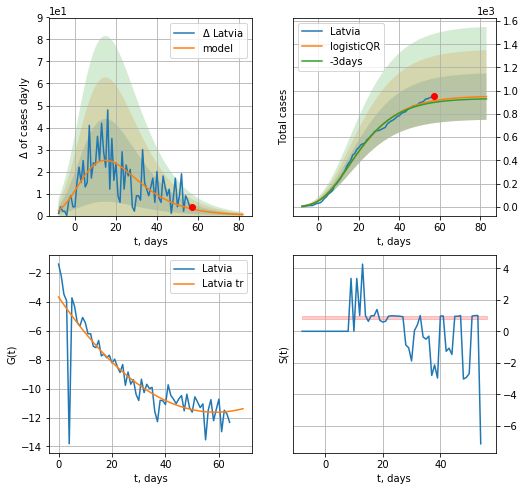

Latvia data at: 2020-05-11
+3 day model MAPE: 0.015858172030633118
model: logisticQR
coeffs:  [ 9.54803618e+02  4.17920166e-02 -8.64934387e+01 -1.39723201e+03
  1.13156242e-03]
rational stdev:  0.21087818737211703
forecast at the end of period: +26 days
	 deltaDaycases:  0
	 total cases:  948 ± 200
	 total death:  18 ± 11
trend coefficient of determination: 0.764651
 intercept_: -3.6635848771771613
 coeffs_: [ 0.         -0.27126693  0.00230945]


In [354]:
x = forecastRR('Latvia',dfLV[:],d1,7*40-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*10-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


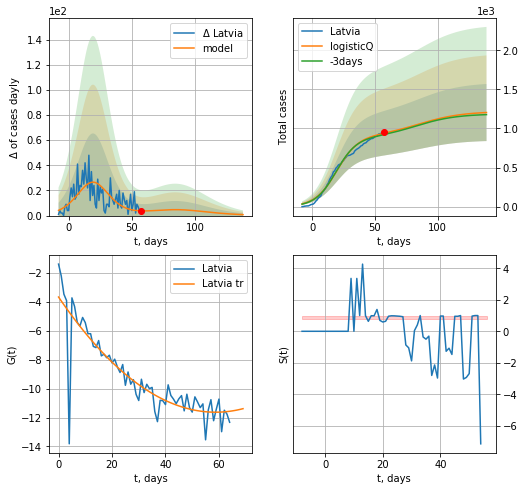

Latvia data at: 2020-05-11
+3 day model MAPE: 0.018371
model: logisticQ
coeffs: [ 8.98654904e+02  5.21873630e-07  1.96218793e+01 -2.23675916e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.303078
forecast at the end of period: +82 days
	 deltaDaycases: 0
	 total cases: 1203 ± 364
	 total death: 22 ± 20
trend coefficient of determination: 0.764651
 intercept_: -3.6635848771771613
 coeffs_: [ 0.         -0.27126693  0.00230945]


In [355]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


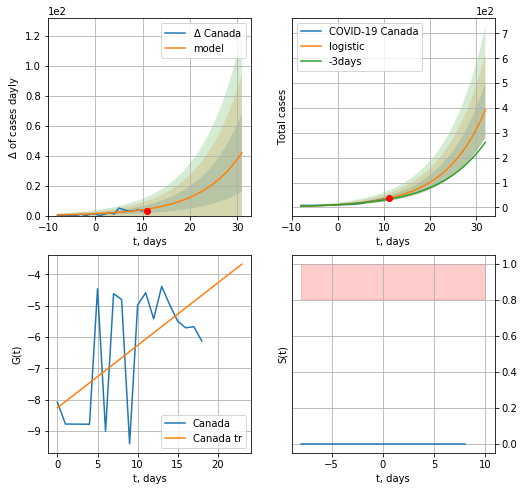

Canada data at: 2020-05-15
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  29 ± 24
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


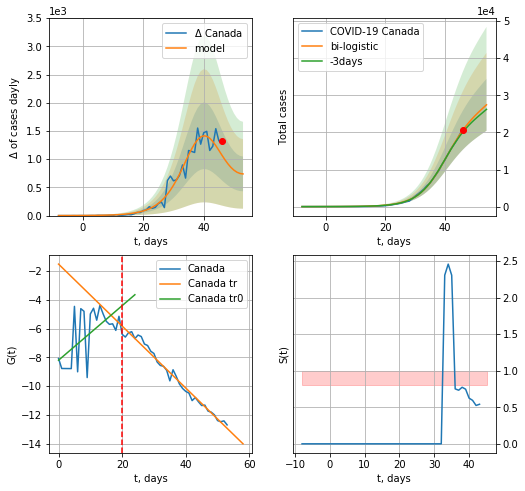

Canada data at: 2020-05-15
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +8 days
	 deltaDaycases:  738
	 total cases:  27433 ± 6993
	 total death:  2045 ± 1563
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


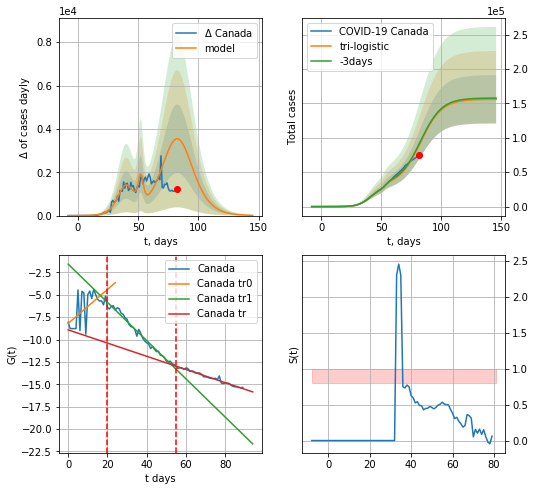

Canada data at: 2020-05-15
+3 day model MAPE: 0.019074727694147094
model: tri-logistic
coeffs:  [6.70961171e+03 7.17478489e-01 5.26471278e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  0.22487968711440584
forecast at the end of period: +64 days
	 deltaDaycases:  11
	 total cases:  155966 ± 35073
	 total death:  11626 ± 7843
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.969648
 intercept: -8.919381
 slope: -0.073665


In [179]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,8*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
          date    cases  active   death
86 2020-05-11  69981.0   31994  4993.0
87 2020-05-12  71157.0   31946  5169.0
88 2020-05-13  72278.0   31812  5302.0
89 2020-05-14  73401.0   31838  5472.0
90 2020-05-15  74613.0   32156  5562.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


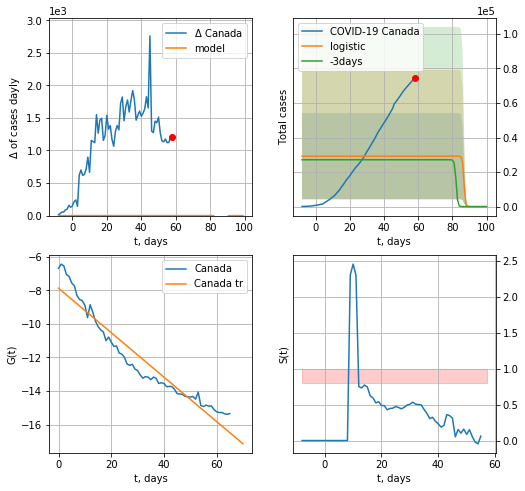

Canada data at: 2020-05-15
+3 day model MAPE: 0.07645405374693232
model: logistic
coeffs:  [ 2.91950150e+04 -2.42955984e+00  8.67990707e+01]
rational stdev:  0.8544129965557992
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.925029
 intercept: -7.881350
 slope: -0.132274


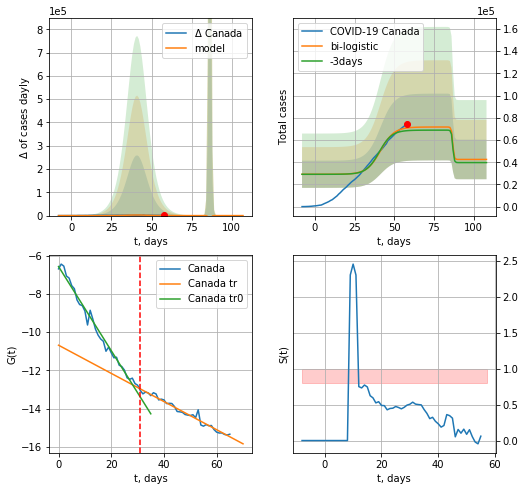

Canada data at: 2020-05-15
+3 day model MAPE: 0.03661832914280509
model: bi-logistic
coeffs:  [4.25568192e+04 2.32786391e-01 4.13601783e+01] [ 2.91950150e+04 -2.42955984e+00  8.67990707e+01]
rational stdev:  0.41866906604930104
forecast at the end of period: +50 days
	 deltaDaycases:  0
	 total cases:  42556 ± 17817
	 total death:  3172 ± 3984
bi-logistic approximation splitting point: 31
trend0 coefficient of determination: 0.983688
 intercept: -6.573152
 slope: -0.220036
trend coefficient of determination: 0.969648
 intercept: -10.687333
 slope: -0.073665


In [180]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,14*7-dT,x,1.,vL=31,cases='cases')

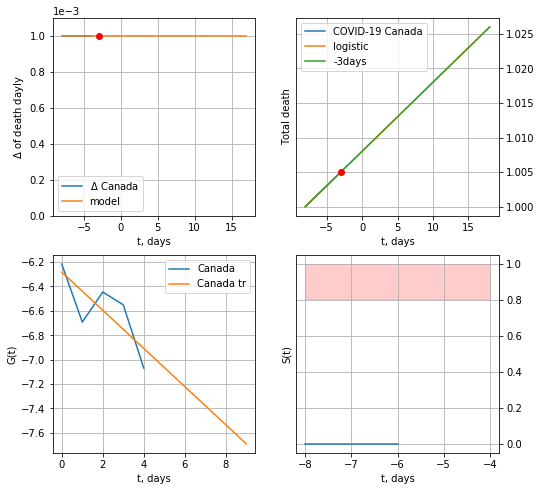

Canada data at: 2020-05-15
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


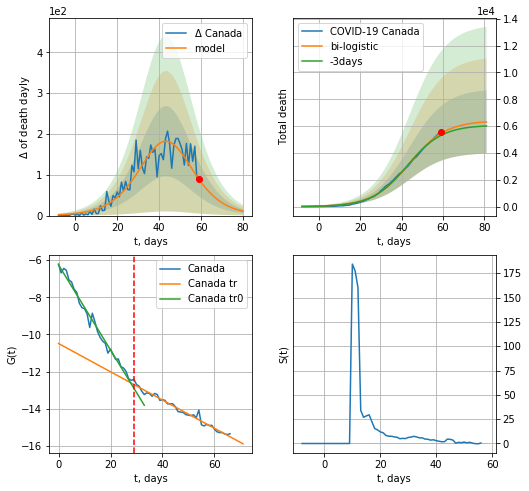

Canada data at: 2020-05-15
+3 day model MAPE: 0.02898152351424849
model: bi-logistic
coeffs:  [6.40087443e+03 1.13959684e-01 4.37333887e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.3736622148399022
forecast at the end of period: +22 days
	 deltaDaydeath:  10
	 total death:  6311 ± 2358
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.973428
 intercept: -10.488367
 slope: -0.075975


In [181]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,10*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


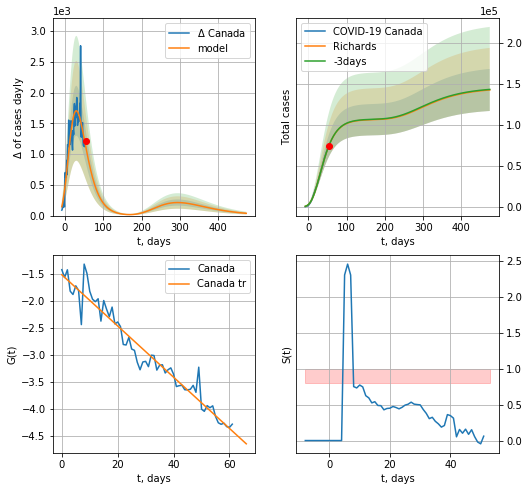

Canada data at: 2020-05-15
+3 day model MAPE: 0.001543
model: Richards
coeffs: [ 1.06268062e+05  3.00845295e+00 -6.60491832e+01  1.45896977e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.179853
forecast at the end of period: +420 days
	 deltaDaycases: 36
	 total cases: 142256 ± 25585
	 total death: 10604 ± 5721
trend coefficient of determination: 0.948504
 intercept: -1.522363
 slope: -0.047341


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


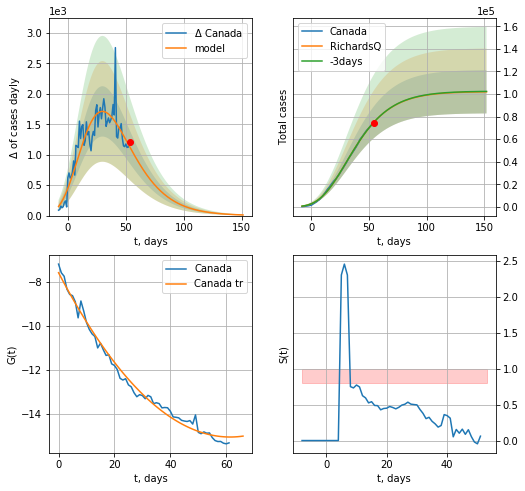

Canada data at: 2020-05-15
+3 day model MAPE: 0.000785
model: RichardsQ
coeffs: [ 1.02147178e+05  1.01417001e-02 -1.07793596e+02 -7.60471694e+02
  4.85329414e-03]
rational stdev: 0.187937
forecast at the end of period: +98 days
	 deltaDaycases: 10
	 total cases: 101967 ± 19163
	 total death: 7601 ± 4285
trend coefficient of determination: 0.988548
 intercept_: -7.568456404703073
 coeffs_: [ 0.         -0.24440136  0.00198978]


In [182]:
x = forecastRR('Canada',dfCA[28:],d1,60*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Canada',dfCA[28:],d1,14*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


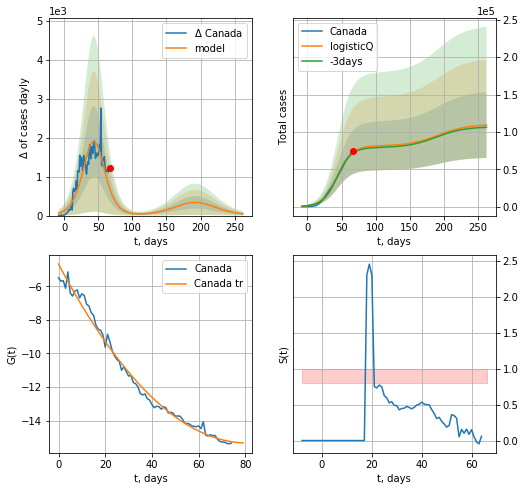

Canada data at: 2020-05-15
+3 day model MAPE: 0.017134
model: logisticQ
coeffs: [ 8.11691386e+04  1.15480245e-06  4.40566582e+01 -8.12197435e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.402380
forecast at the end of period: +196 days
	 deltaDaycases: 45
	 total cases: 108942 ± 43836
	 total death: 8121 ± 9803
trend coefficient of determination: 0.988505
 intercept_: -4.681588460829252
 coeffs_: [ 0.         -0.26329585  0.00162702]


In [183]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
          date  cases  active   death
70 2020-05-11  27679   23986  1144.0
71 2020-05-12  27913   23737  1163.0
72 2020-05-13  28132   23775  1175.0
73 2020-05-14  28319   23937  1184.0
74 2020-05-15  28583   24065  1190.0


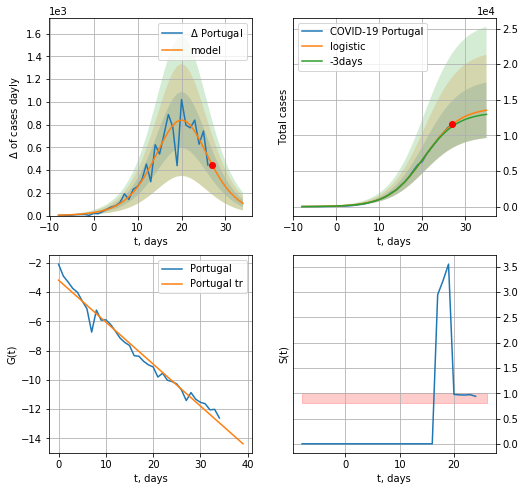

Portugal data at: 2020-05-15
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +8 days
	 deltaDaycases:  107
	 total cases:  13534 ± 3898
	 total death:  563 ± 486
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


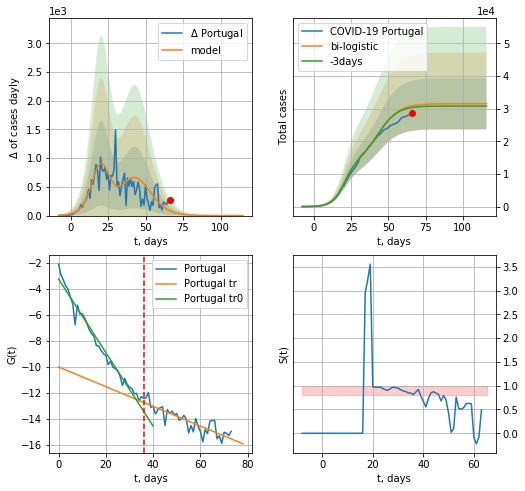

Portugal data at: 2020-05-15
+3 day model MAPE: 0.017795764793016026
model: bi-logistic
coeffs:  [1.40651823e+04 1.57765264e-01 4.23906113e+01] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.24900709771551405
forecast at the end of period: +50 days
	 deltaDaycases:  0
	 total cases:  31524 ± 7849
	 total death:  1312 ± 980
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.740699
 intercept: -9.993471
 slope: -0.075796


In [184]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,8*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


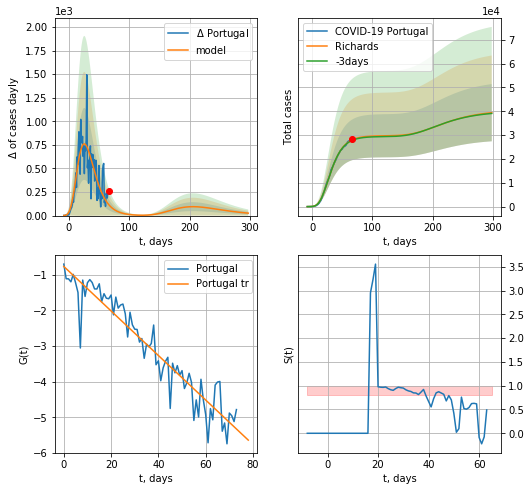

Portugal data at: 2020-05-15
+3 day model MAPE: 0.007812
model: Richards
coeffs: [ 2.97713906e+04  7.65109948e+00 -4.09679141e+01  9.12052423e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.304479
forecast at the end of period: +232 days
	 deltaDaycases: 25
	 total cases: 39421 ± 12002
	 total death: 1641 ± 1498
trend coefficient of determination: 0.896402
 intercept: -0.770908
 slope: -0.062334


In [185]:
x = forecastRR('Portugal',dfPT[:],d1,40*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


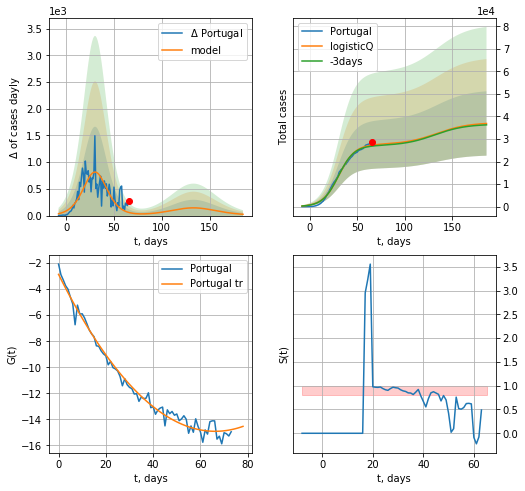

Portugal data at: 2020-05-15
+3 day model MAPE: 0.016534
model: logisticQ
coeffs: [ 2.75324204e+04  7.14246514e-07  3.06518593e+01 -1.65454609e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.387232
forecast at the end of period: +120 days
	 deltaDaycases: 24
	 total cases: 36869 ± 14277
	 total death: 1534 ± 1782
trend coefficient of determination: 0.985225
 intercept_: -2.8678243411740993
 coeffs_: [ 0.         -0.36362636  0.0027446 ]


In [186]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

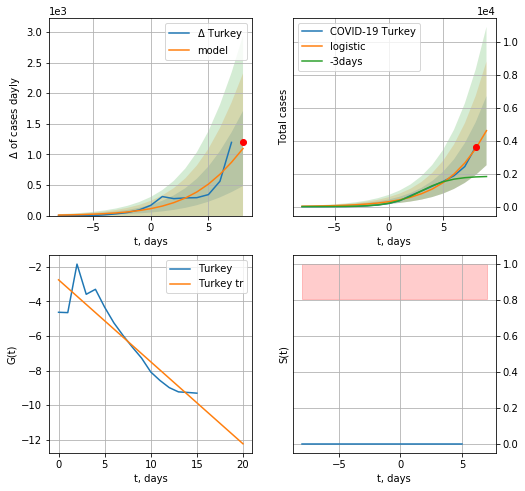

Turkey data at: 2020-05-15
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +1 days
	 deltaDaycases:  1095
	 total cases:  4611 ± 2098
	 total death:  127 ± 173
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


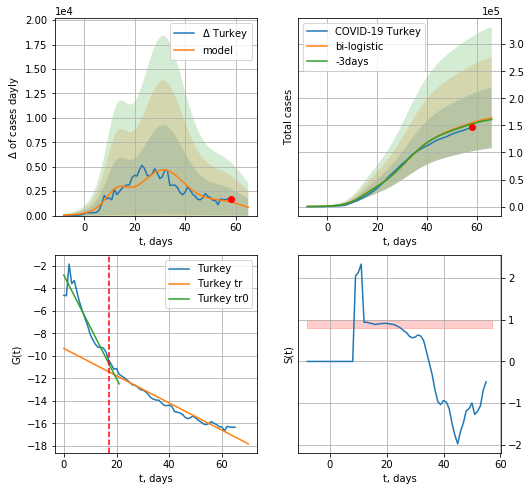

Turkey data at: 2020-05-15
+3 day model MAPE: 0.014785399141437637
model: bi-logistic
coeffs:  [1.16737170e+05 1.57296106e-01 3.17345677e+01] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.34166749143268565
forecast at the end of period: +8 days
	 deltaDaycases:  854
	 total cases:  163868 ± 55988
	 total death:  4537 ± 4650
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.949449
 intercept: -9.348675
 slope: -0.121202


In [187]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*7-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,8*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


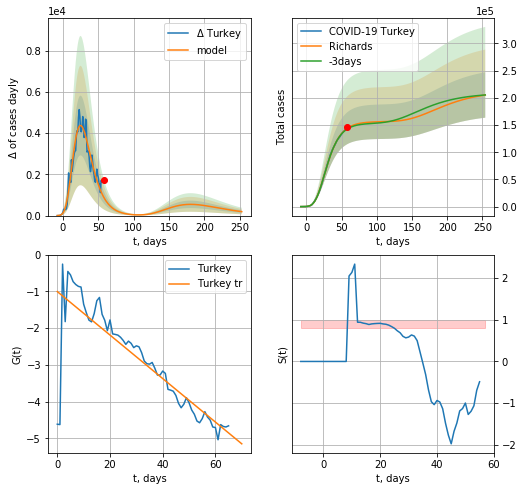

Turkey data at: 2020-05-15
+3 day model MAPE: 0.009609
model: Richards
coeffs: [ 1.56370869e+05  4.38525214e+00 -2.74703291e+01  1.74693910e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.203359
forecast at the end of period: +196 days
	 deltaDaycases: 191
	 total cases: 205239 ± 41737
	 total death: 5682 ± 3466
trend coefficient of determination: 0.717846
 intercept: -1.003845
 slope: -0.059221


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


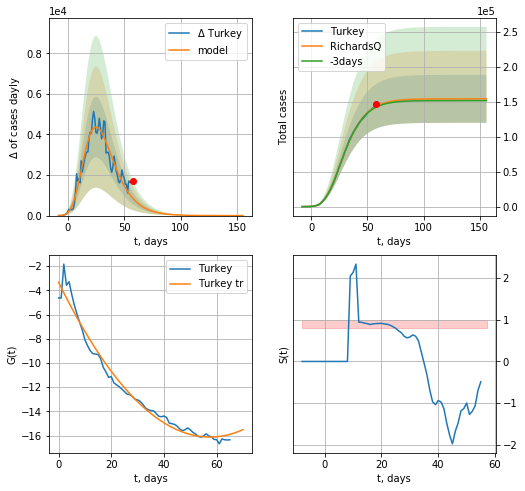

Turkey data at: 2020-05-15
+3 day model MAPE: 0.008780
model: RichardsQ
coeffs: [ 1.54453201e+05  2.80123987e-02 -5.67648580e+01 -6.65010890e+02
  3.56032397e-03]
rational stdev: 0.222488
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 154452 ± 34363
	 total death: 4276 ± 2854
trend coefficient of determination: 0.977545
 intercept_: -3.333167417615943
 coeffs_: [ 0.         -0.44541169  0.00387836]


In [188]:
x = forecastRR('Turkey',dfTR[:],d1,28*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Turkey',dfTR[:],d1,14*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


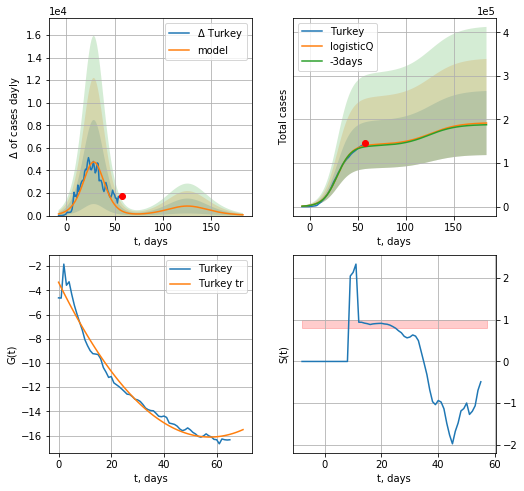

Turkey data at: 2020-05-15
+3 day model MAPE: 0.018920
model: logisticQ
coeffs: [ 1.42389985e+05  1.21829872e-06  2.88868484e+01 -1.09476039e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.383418
forecast at the end of period: +126 days
	 deltaDaycases: 68
	 total cases: 191818 ± 73546
	 total death: 5310 ± 6107
trend coefficient of determination: 0.977545
 intercept_: -3.333167417615943
 coeffs_: [ 0.         -0.44541169  0.00387836]


In [189]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [190]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.01958762886597938

In [191]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

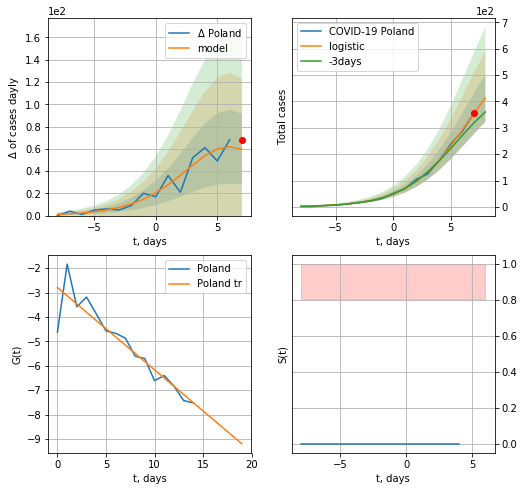

Poland data at: 2020-05-15
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +1 days
	 deltaDaycases:  59
	 total cases:  413 ± 89
	 total death:  20 ± 13
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


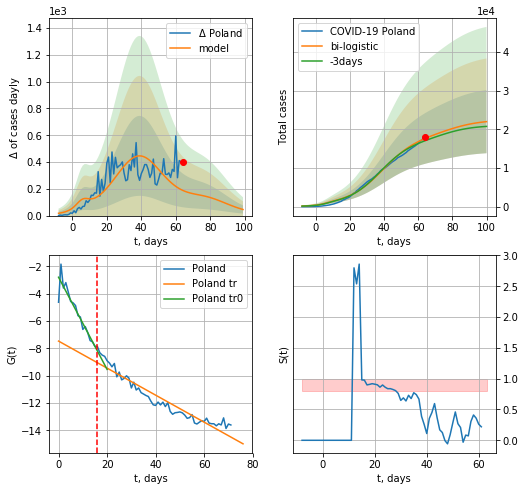

Poland data at: 2020-05-15
+3 day model MAPE: 0.034614122902083204
model: bi-logistic
coeffs:  [1.74570221e+04 1.00282992e-01 3.91056898e+01] [6.41107567e+02 3.87606719e-01 6.46563498e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37171676188634567
forecast at the end of period: +36 days
	 deltaDaycases:  45
	 total cases:  21982 ± 8171
	 total death:  1106 ± 1233
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.912722
 intercept: -7.466342
 slope: -0.098884


In [192]:
vL=16
vL1=38
x =  forecast('Poland',dfPL[:vL],d1,7*7-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,12*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


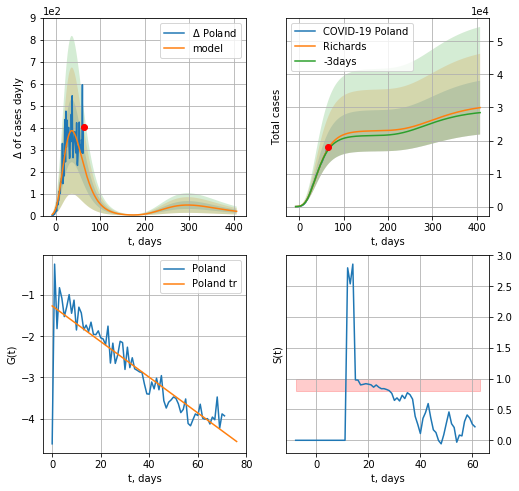

Poland data at: 2020-05-15
+3 day model MAPE: 0.024456
model: Richards
coeffs: [ 2.29692872e+04  3.46937430e+00 -5.73296821e+01  1.32640551e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.271717
forecast at the end of period: +344 days
	 deltaDaycases: 19
	 total cases: 29951 ± 8138
	 total death: 1507 ± 1228
trend coefficient of determination: 0.766753
 intercept: -1.263411
 slope: -0.043359


In [193]:
x =  forecastRR('Poland',dfPL[:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


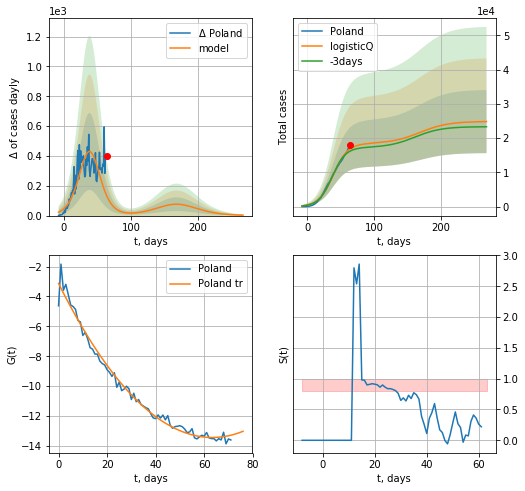

Poland data at: 2020-05-15
+3 day model MAPE: 0.042195
model: logisticQ
coeffs: [ 1.83836195e+04  8.56159146e-07  3.85741511e+01 -1.09076093e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.371135
forecast at the end of period: +204 days
	 deltaDaycases: 2
	 total cases: 24835 ± 9217
	 total death: 1250 ± 1391
trend coefficient of determination: 0.985077
 intercept_: -3.129279048864915
 coeffs_: [ 0.         -0.32551805  0.00257028]


In [194]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
          date    cases  active  death
79 2020-05-11  16506.0    4405  258.0
80 2020-05-12  16529.0    4186  260.0
81 2020-05-13  16548.0    4052  264.0
82 2020-05-14  16579.0    3793  265.0
83 2020-05-15  16589.0    3736  266.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


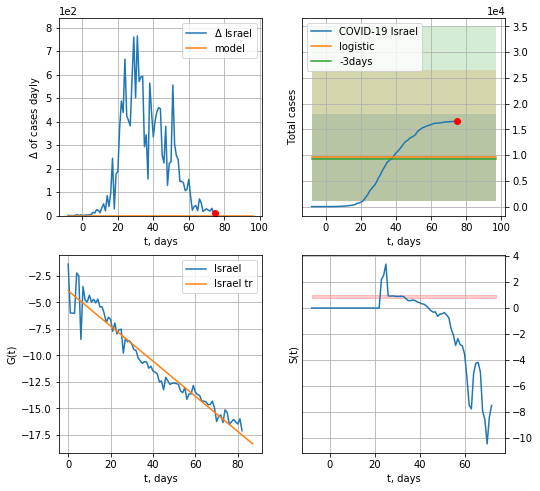

Israel data at: 2020-05-15
+3 day model MAPE: 0.04502666461188373
model: logistic
coeffs:  [ 7.66038178e+03 -3.77179210e+00  1.09583993e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8821539067394836
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  9575 ± 8447
	 total death:  153 ± 404
trend coefficient of determination: 0.940092
 intercept: -3.912604
 slope: -0.166032


In [195]:
dfIS = read_df(pd.DataFrame(),"IS")
x = forecast('Israel',dfIS[:],d1,10*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


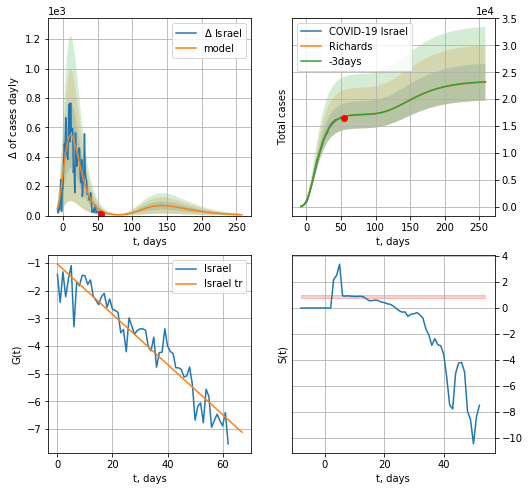

Israel data at: 2020-05-15
+3 day model MAPE: 0.002662
model: Richards
coeffs: [ 1.71394101e+04  6.99053166e+00 -3.83824571e+01  1.25172722e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.147723
forecast at the end of period: +204 days
	 deltaDaycases: 5
	 total cases: 23159 ± 3421
	 total death: 371 ± 164
trend coefficient of determination: 0.907204
 intercept: -1.045871
 slope: -0.090598


In [196]:
x = forecastRR('Israel',dfIS[20:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Israel',dfIS[:],d1,7*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


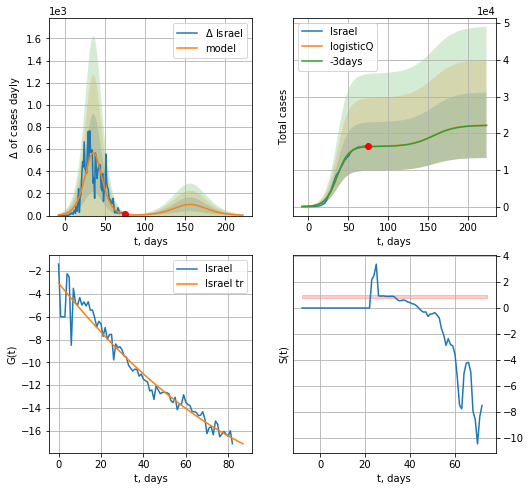

Israel data at: 2020-05-15
+3 day model MAPE: 0.003444
model: logisticQ
coeffs: [ 1.64197840e+04  8.93087401e-07  3.58647424e+01 -1.54712476e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.402669
forecast at the end of period: +148 days
	 deltaDaycases: 3
	 total cases: 22179 ± 8930
	 total death: 355 ± 428
trend coefficient of determination: 0.949818
 intercept_: -3.041171786783141
 coeffs_: [ 0.         -0.23059223  0.00078738]


In [197]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


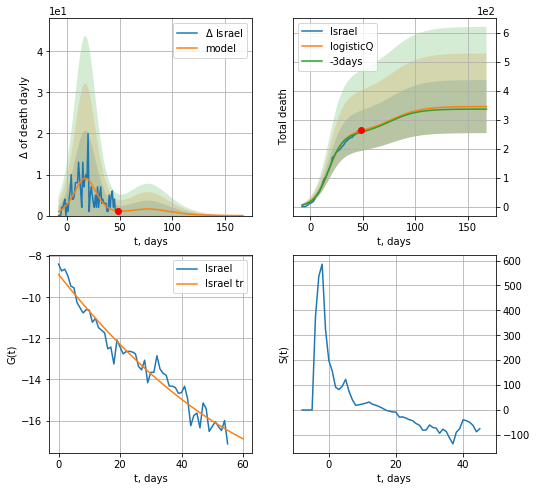

Israel data at: 2020-05-15
+3 day model MAPE: 0.020009
model: logisticQ
coeffs: [ 2.55377212e+02  1.56275456e-06  1.77561151e+01 -9.03867796e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.264767
forecast at the end of period: +120 days
	 total death: 345 ± 91
trend coefficient of determination: 0.959746
 intercept_: -8.88575932976171
 coeffs_: [ 0.         -0.18885668  0.00092518]


In [198]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


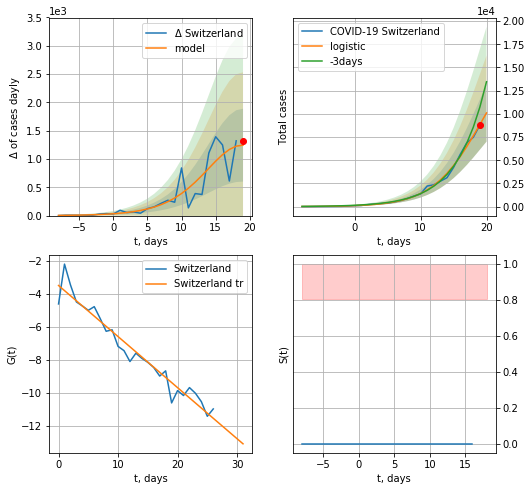

Switzerland data at: 2020-05-15
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +1 days
	 deltaDaycases:  1244
	 total cases:  10100 ± 3091
	 total death:  621 ± 570
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


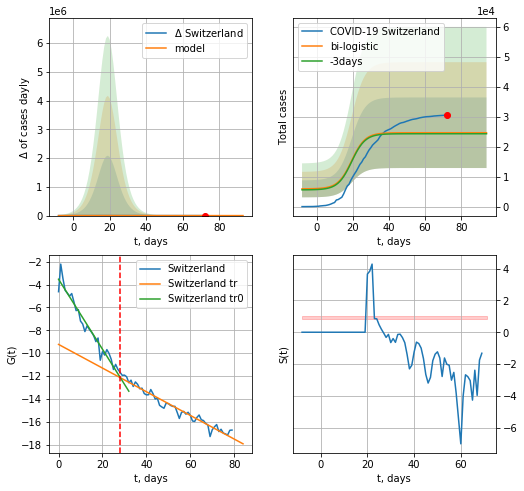

Switzerland data at: 2020-05-15
+3 day model MAPE: 0.013902190760331456
model: bi-logistic
coeffs:  [ 4.73441541e+03 -2.72337261e+00  1.27503118e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.47763636731769943
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  24624 ± 11761
	 total death:  1515 ± 2170
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.956738
 intercept: -9.232647
 slope: -0.103432


In [199]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*7-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*10-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


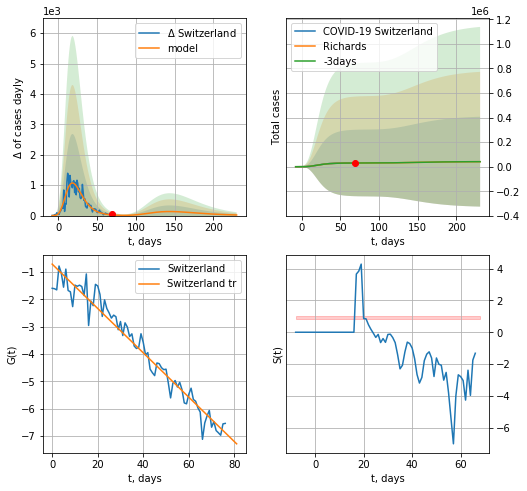

Switzerland data at: 2020-05-15
+3 day model MAPE: 0.000967
model: Richards
coeffs: [ 3.05897492e+04  6.96924356e+00 -2.59639850e+01  1.37795859e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 8.912341
forecast at the end of period: +162 days
	 deltaDaycases: 20
	 total cases: 41052 ± 365869
	 total death: 2526 ± 67537
trend coefficient of determination: 0.954315
 intercept: -0.714574
 slope: -0.081088


In [200]:
x = forecastRR('Switzerland',dfSZ[3:],d1,7*30-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


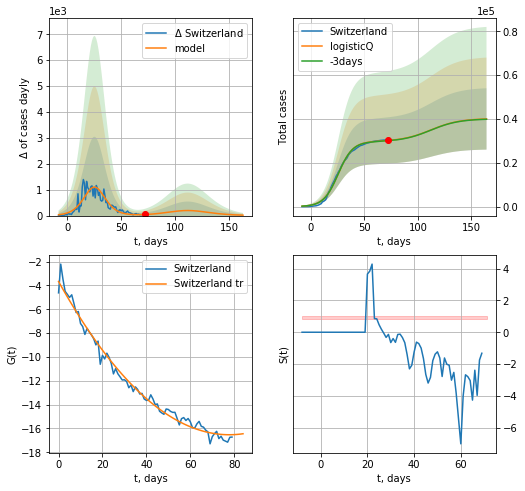

Switzerland data at: 2020-05-15
+3 day model MAPE: 0.004101
model: logisticQ
coeffs: [ 2.97172372e+04  7.84355723e-07  2.57233117e+01 -1.88529227e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.349817
forecast at the end of period: +92 days
	 deltaDaycases: 16
	 total cases: 40025 ± 14001
	 total death: 2463 ± 2584
trend coefficient of determination: 0.985688
 intercept_: -3.6709395868506007
 coeffs_: [ 0.         -0.33069433  0.00212686]


In [201]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=True,xcoef=koreaCoeffs)

In [202]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
          date    cases  active  death
62 2020-05-11  16023.0   12225  425.0
63 2020-05-12  16425.0   12270  439.0
64 2020-05-13  16847.0   12248  456.0
65 2020-05-14  17330.0   12381  476.0
66 2020-05-15  17330.0   12381  476.0
Exaption


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


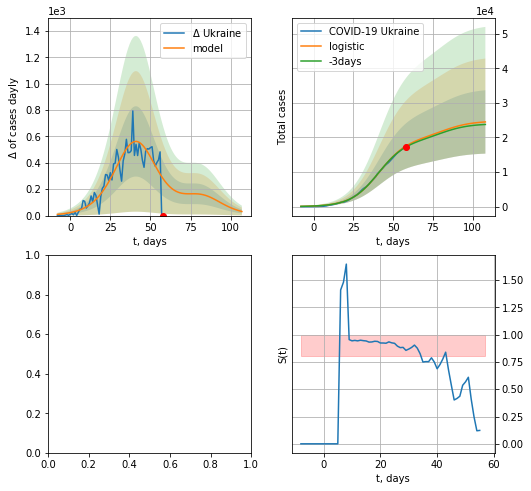

In [204]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,14*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


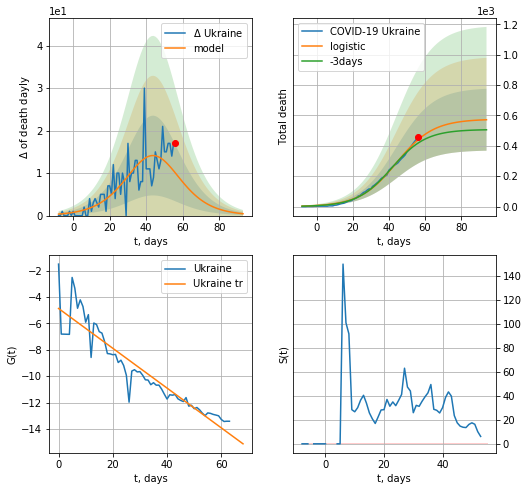

Ukraine data at: 2020-05-13
+3 day model MAPE: 0.056948578727846935
model: logistic
coeffs:  [5.75947607e+02 9.81985082e-02 4.41813614e+01]
rational stdev:  0.35628660280422064
forecast at the end of period: +38 days
	 total death:  571 ± 203
trend coefficient of determination: 0.871144
 intercept: -4.868460
 slope: -0.150897


In [53]:
x=forecast('Ukraine',dfUR[:],d1,12*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


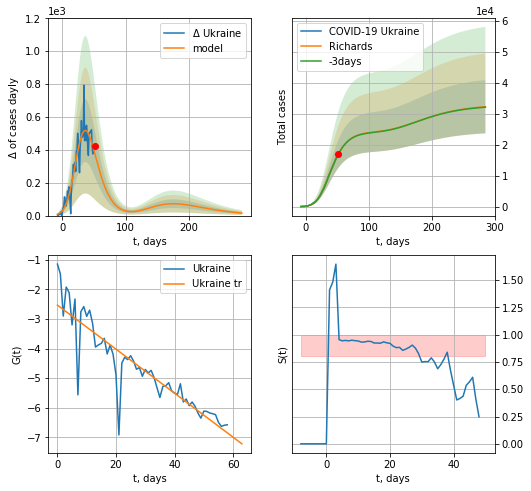

Ukraine data at: 2020-05-13
+3 day model MAPE: 0.001048
model: Richards
coeffs: [2.42092028e+04 2.24573030e-01 1.83824443e+01 2.96538983e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.266342
forecast at the end of period: +234 days
	 deltaDaycases: 15
	 total cases: 32276 ± 8596
	 total death: 862 ± 688
trend coefficient of determination: 0.804138
 intercept: -2.530544
 slope: -0.074362


In [54]:
x=forecastRR('Ukraine',dfUR[5:],d1,7*40-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


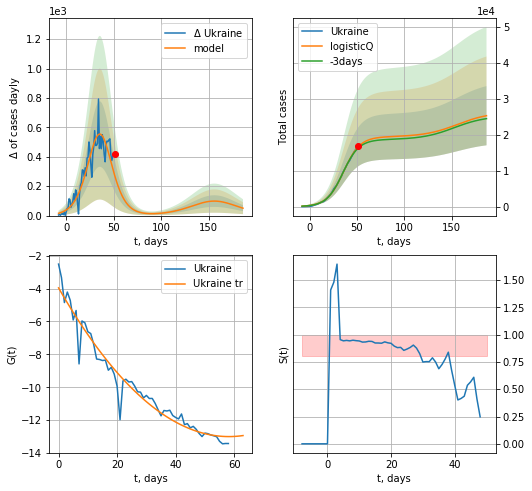

Ukraine data at: 2020-05-13
+3 day model MAPE: 0.021791
model: logisticQ
coeffs: [ 1.94411442e+04  3.46382900e-06  3.58499065e+01 -3.29040018e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.325571
forecast at the end of period: +136 days
	 deltaDaycases: 50
	 total cases: 25318 ± 8243
	 total death: 676 ± 660
trend coefficient of determination: 0.950107
 intercept_: -3.9595918516129895
 coeffs_: [ 0.         -0.31065353  0.00266952]


In [55]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*26-dT,addpred=True,xcoef=koreaCoeffs)

In [56]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

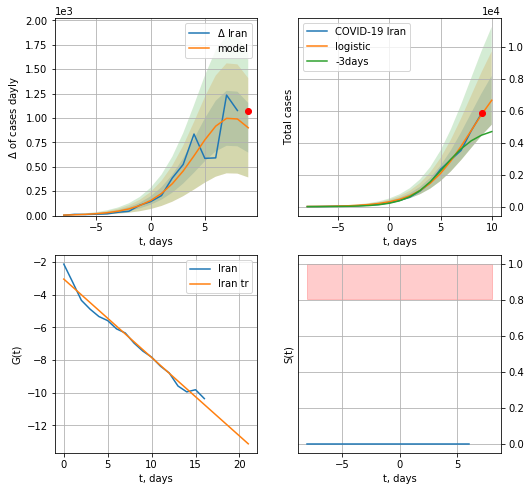

Iran data at: 2020-05-15
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +1 days
	 deltaDaycases:  899
	 total cases:  6652 ± 1528
	 total death:  393 ± 270
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


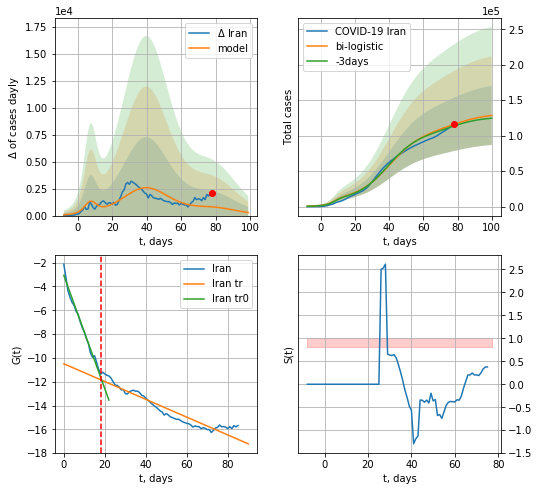

Iran data at: 2020-05-15
+3 day model MAPE: 0.020226706336301768
model: bi-logistic
coeffs:  [9.75896387e+04 1.04670141e-01 4.00636931e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.32383804462538185
forecast at the end of period: +22 days
	 deltaDaycases:  282
	 total cases:  128479 ± 41606
	 total death:  7602 ± 7385
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.906379
 intercept: -10.491444
 slope: -0.074713


In [205]:
x = forecast('Iran',dfIN[:18],d1,7*7-dT)
xx = forecast2('Iran',dfIN[:],d1,10*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


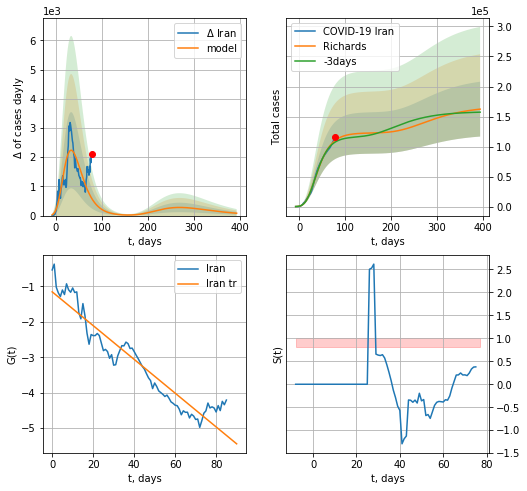

Iran data at: 2020-05-15
+3 day model MAPE: 0.025604
model: Richards
coeffs: [ 1.22833702e+05  3.03401975e+00 -4.85767838e+01  1.64526921e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.281228
forecast at the end of period: +316 days
	 deltaDaycases: 81
	 total cases: 162331 ± 45652
	 total death: 9606 ± 8104
trend coefficient of determination: 0.903850
 intercept: -1.155212
 slope: -0.047638


In [210]:
x = forecastRR('Iran',dfIN[:],d1,52*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


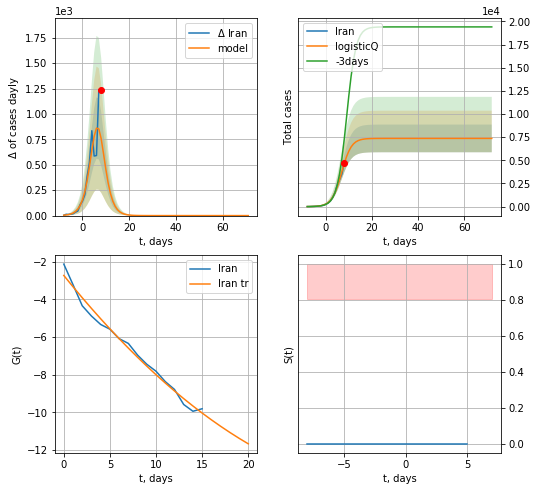

Iran data at: 2020-05-15
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +64 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 436 ± 265
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


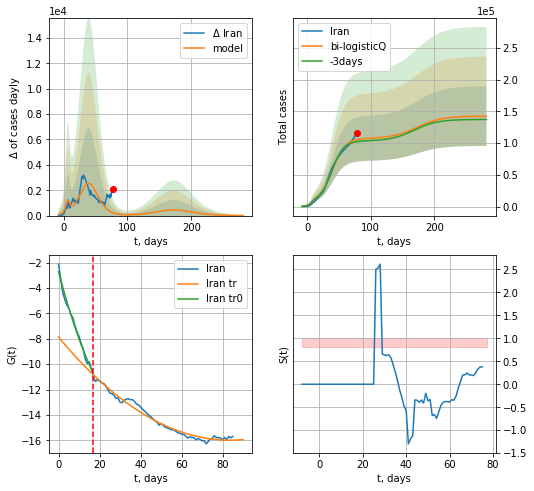

Iran data at: 2020-05-15
+3 day model MAPE: 0.031799
model: bi-logisticQ
coeffs: [ 9.99283663e+04  4.57886199e-07  3.96518958e+01 -2.22141013e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.329196
forecast at the end of period: +204 days
	 deltaDaycases: 6
	 total cases: 142556 ± 46929
	 total death: 8435 ± 8330
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.977466
 intercept_: -7.863854651371045
 coeffs_: [ 0.         -0.19443695  0.00116417]


In [214]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
          date     cases  active   death
72 2020-05-11  221344.0  179534  2009.0
73 2020-05-12  232243.0  186615  2116.0
74 2020-05-13  242271.0  192056  2212.0
75 2020-05-14  252245.0  196410  2305.0
76 2020-05-15  262843.0  202199  2418.0


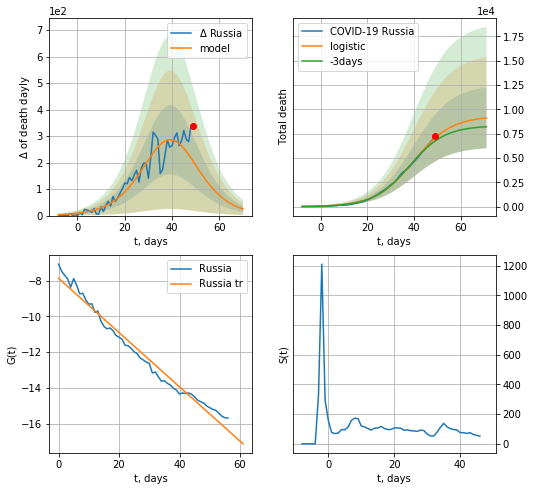

Russia data at: 2020-05-15
+3 day model MAPE: 0.05093419452036428
model: logistic
coeffs:  [9.30311136e+03 1.23179131e-01 3.97501632e+01]
rational stdev:  0.34220736025164583
forecast at the end of period: +22 days
	 total death:  9109 ± 3117
trend coefficient of determination: 0.977541
 intercept: -7.868775
 slope: -0.151753


In [215]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,10*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

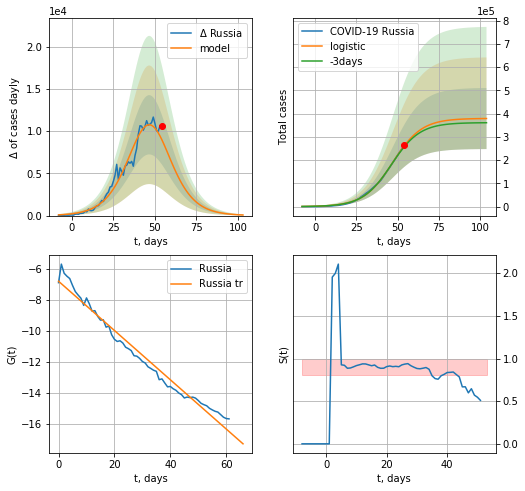

Russia data at: 2020-05-15
+3 day model MAPE: 0.017947417209108085
model: logistic
coeffs:  [3.79354747e+05 1.13375834e-01 4.70552025e+01]
rational stdev:  0.34665406140229377
forecast at the end of period: +50 days
	 deltaDaycases:  71
	 total cases:  378759 ± 131298
	 total death:  3484 ± 3623
trend coefficient of determination: 0.975137
 intercept: -6.809435
 slope: -0.158937


In [216]:
x = forecast('Russia',dfRS[14:],d1,14*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


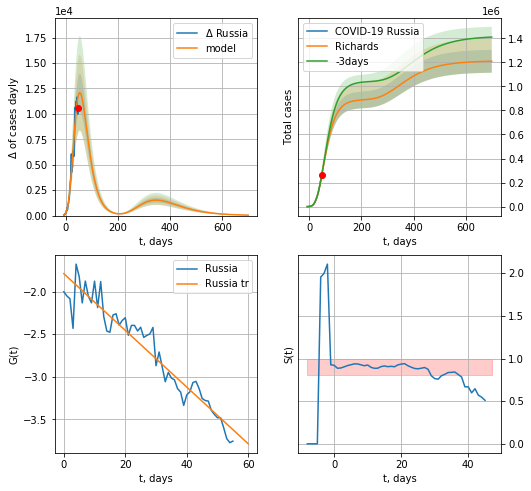

Russia data at: 2020-05-15
+3 day model MAPE: 0.015040
model: Richards
coeffs: [ 8.90167887e+05  8.65692439e-01 -2.93596708e+01  4.35475233e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.078710
forecast at the end of period: +652 days
	 deltaDaycases: 43
	 total cases: 1209425 ± 95193
	 total death: 11125 ± 2626
trend coefficient of determination: 0.917462
 intercept: -1.789933
 slope: -0.033264


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


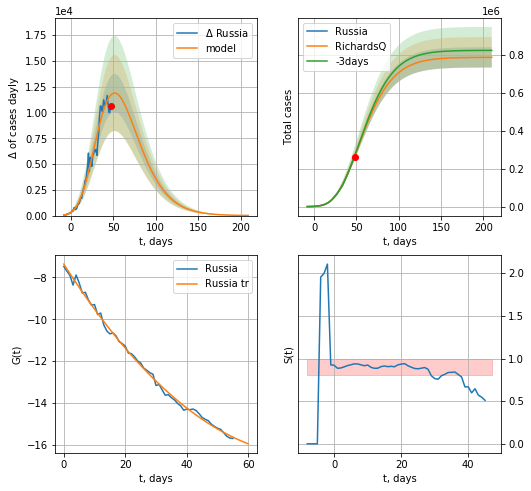

Russia data at: 2020-05-15
+3 day model MAPE: 0.012079
model: RichardsQ
coeffs: [ 7.86863803e+05  7.74948850e-03 -1.05688254e+02 -3.80973740e+02
  9.03750465e-03]
rational stdev: 0.067965
forecast at the end of period: +162 days
	 deltaDaycases: 12
	 total cases: 786679 ± 53466
	 total death: 7236 ± 1475
trend coefficient of determination: 0.996675
 intercept_: -7.364783629844024
 coeffs_: [ 0.         -0.22938233  0.00143975]


In [217]:
x = forecastRR('Russia',dfRS[20:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


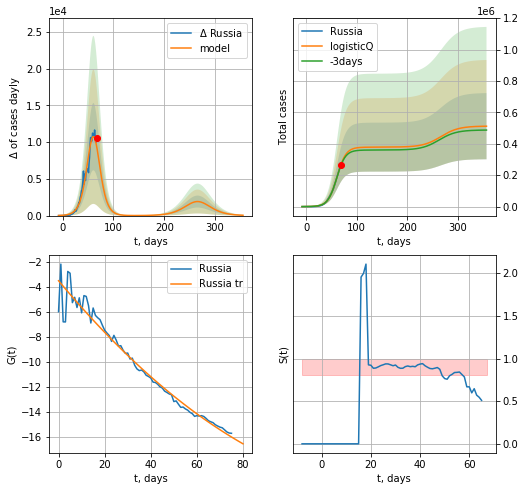

Russia data at: 2020-05-15
+3 day model MAPE: 0.018229
model: logisticQ
coeffs: [ 3.78623960e+05  4.52200455e-06  6.10193822e+01 -2.50513384e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.411610
forecast at the end of period: +288 days
	 deltaDaycases: 45
	 total cases: 511936 ± 210718
	 total death: 4709 ± 5814
trend coefficient of determination: 0.963499
 intercept_: -3.5323620824712325
 coeffs_: [ 0.         -0.21982082  0.00071705]


In [218]:
x = forecastRRR('Russia',dfRS[:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

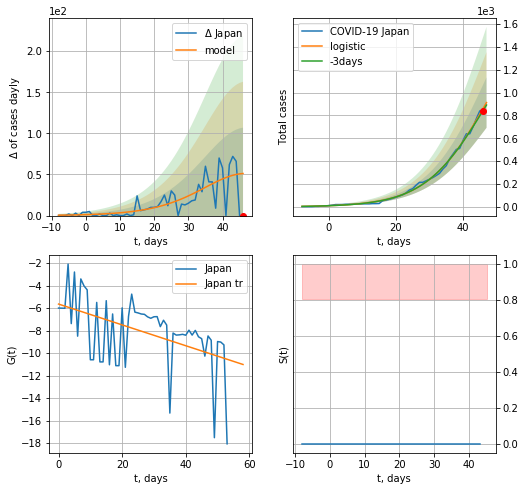

Japan data at: 2020-05-15
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +1 days
	 deltaDaycases:  51
	 total cases:  912 ± 220
	 total death:  40 ± 29
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


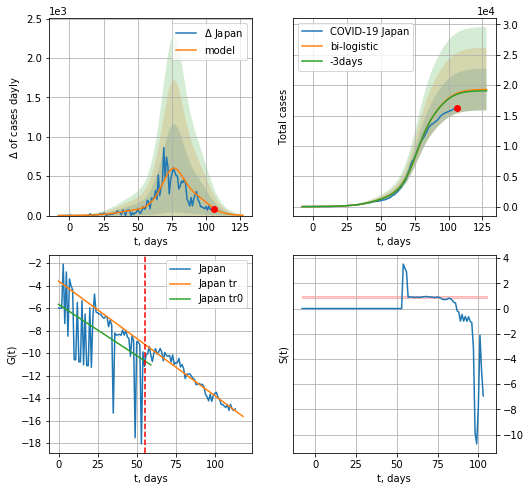

Japan data at: 2020-05-15
+3 day model MAPE: 0.008874386150595527
model: bi-logistic
coeffs:  [1.39565778e+04 1.63459938e-01 7.66115480e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
scenario coeffs:  [0.25, 1.0, 1.25]
rational stdev:  0.17806070962069076
forecast at the end of period: +22 days
	 deltaDaycases:  3
	 total cases:  19291 ± 3434
	 total death:  848 ± 452
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.925644
 intercept: -3.603590
 slope: -0.101971


In [219]:
x = forecast('Japan',dfJP[:55],d1,7*7-dT)
xx = forecast2('Japan',dfJP[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.25],vL=55)

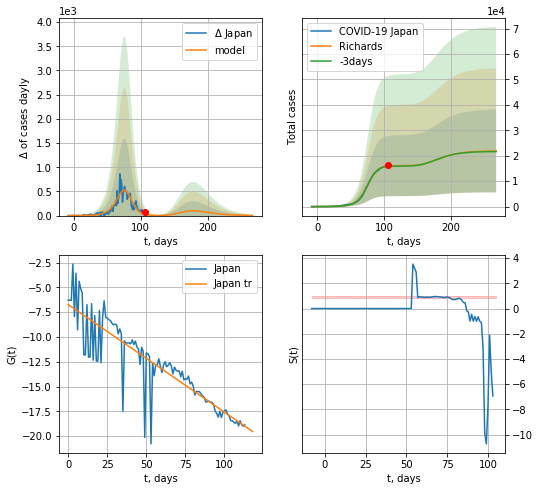

Japan data at: 2020-05-15
+3 day model MAPE: 0.009395
model: Richards
coeffs: [1.61043526e+04 1.05070375e-01 7.85362634e+01 1.40112813e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.743333
forecast at the end of period: +162 days
	 deltaDaycases: 3
	 total cases: 21876 ± 16261
	 total death: 962 ± 2145
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


In [220]:
x = forecastRR('Japan',dfJP[:],d1,30*7-dT,addpred=True,xcoef=RkoreaCoeffs)

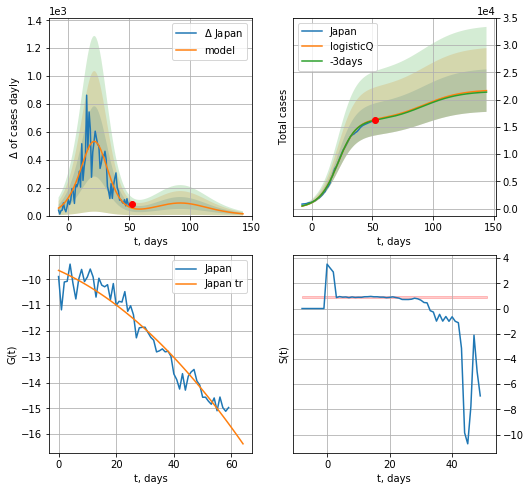

Japan data at: 2020-05-15
+3 day model MAPE: 0.008851
model: logisticQ
coeffs: [ 1.61374328e+04  3.18657340e-04  2.11112528e+01 -3.89089352e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.179878
forecast at the end of period: +92 days
	 deltaDaycases: 12
	 total cases: 21650 ± 3894
	 total death: 952 ± 513
trend coefficient of determination: 0.940957
 intercept_: -9.65363655138013
 coeffs_: [ 0.         -0.04972139 -0.00086382]


In [221]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


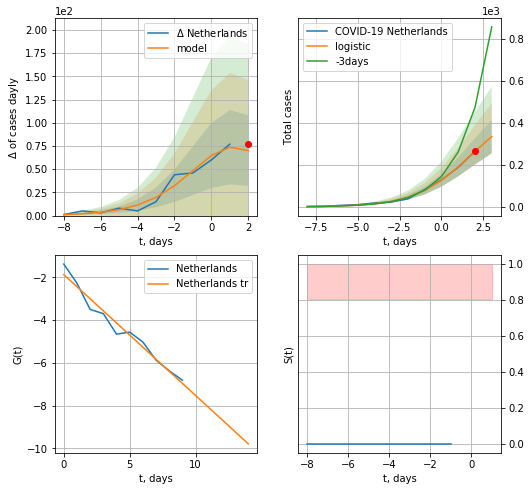

Netherlands data at: 2020-05-15
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +1 days
	 deltaDaycases:  70
	 total cases:  334 ± 79
	 total death:  43 ± 30
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


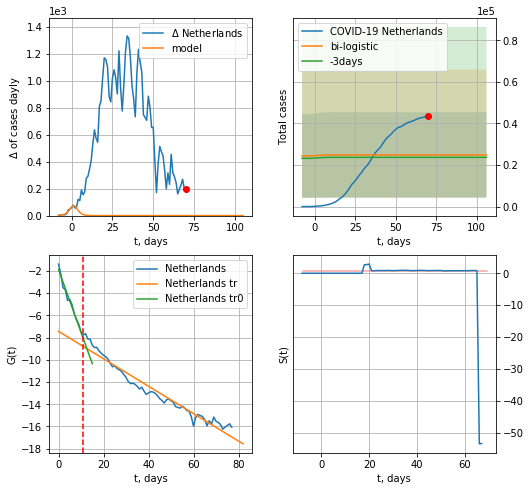

Netherlands data at: 2020-05-15
+3 day model MAPE: 0.048901040814564596
model: bi-logistic
coeffs:  [ 1.94899997e+04 -4.30269233e+00  1.34322510e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8259193368200375
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  24850 ± 20524
	 total death:  3210 ± 7953
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.952796
 intercept: -7.438724
 slope: -0.123477


In [222]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,7*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
          date  cases  active   death
74 2020-05-11  42788   37082  5456.0
75 2020-05-12  42984   37224  5510.0
76 2020-05-13  43211   37399  5562.0
77 2020-05-14  43481       0  5590.0
78 2020-05-15  43681       0  5643.0


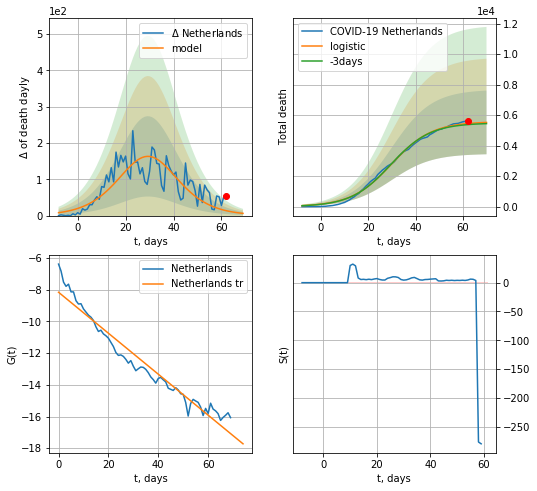

Netherlands data at: 2020-05-15
+3 day model MAPE: 0.013149204277269119
model: logistic
coeffs:  [5.56800982e+03 1.17365470e-01 2.98136274e+01]
rational stdev:  0.3781786796213897
forecast at the end of period: +8 days
	 total death:  5518 ± 2087
trend coefficient of determination: 0.948105
 intercept: -8.155196
 slope: -0.129297


In [223]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,8*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


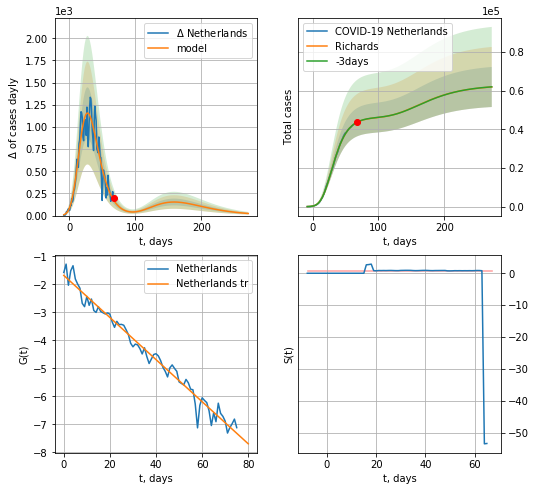

Netherlands data at: 2020-05-15
+3 day model MAPE: 0.001177
model: Richards
coeffs: [4.61505935e+04 4.54590691e-01 3.64993452e+00 1.61963360e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.167389
forecast at the end of period: +204 days
	 deltaDaycases: 23
	 total cases: 61920 ± 10364
	 total death: 7999 ± 4016
trend coefficient of determination: 0.976017
 intercept: -1.682568
 slope: -0.075140


In [224]:
x = forecastRR('Netherlands',dfNL[2:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


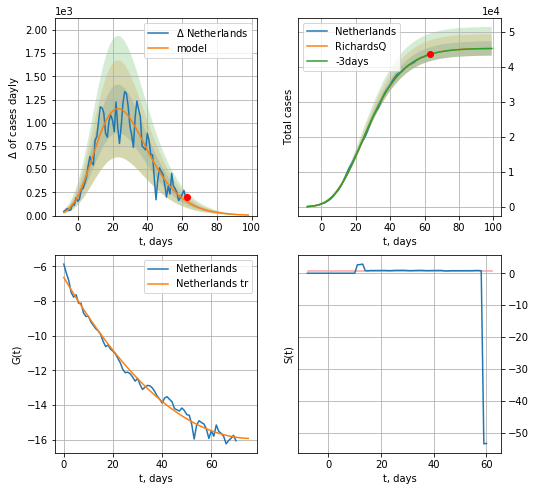

Netherlands data at: 2020-05-15
+3 day model MAPE: 0.000206
model: RichardsQ
coeffs: [ 4.53532139e+04  2.70301410e-02 -9.86402451e+01 -1.33516377e+02
  9.22572008e-03]
rational stdev: 0.045351
forecast at the end of period: +36 days
	 deltaDaycases: 5
	 total cases: 45301 ± 2054
	 total death: 5852 ± 796
trend coefficient of determination: 0.989669
 intercept_: -6.640765432359766
 coeffs_: [ 0.         -0.24196849  0.00157365]


In [225]:
x = forecastQR('Netherlands',dfNL[7:],d1,12*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


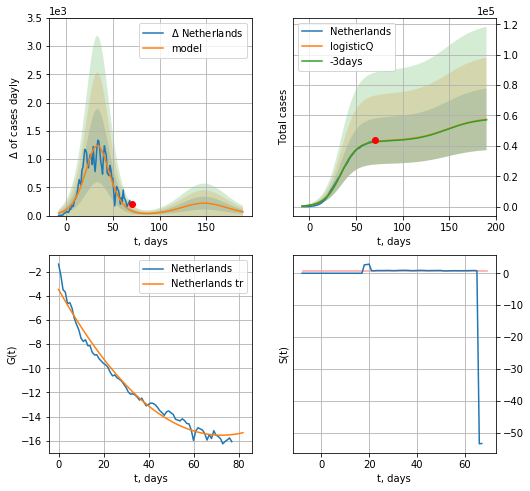

Netherlands data at: 2020-05-15
+3 day model MAPE: 0.006743
model: logisticQ
coeffs: [ 4.33575112e+04  1.09380222e-06  3.39164805e+01 -1.04230353e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.353116
forecast at the end of period: +120 days
	 deltaDaycases: 67
	 total cases: 57458 ± 20289
	 total death: 7422 ± 7862
trend coefficient of determination: 0.979989
 intercept_: -3.4778357443449064
 coeffs_: [ 0.         -0.3325946   0.00229401]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


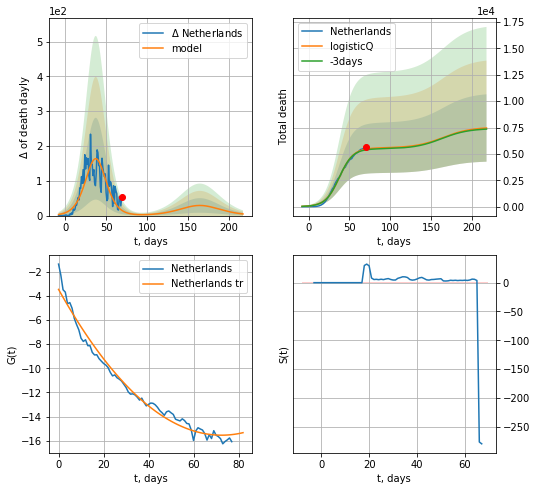

Netherlands data at: 2020-05-15
+3 day model MAPE: 0.013239
model: logisticQ
coeffs: [ 5.56481416e+03  1.01974854e-06  3.78019637e+01 -1.15266547e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.428680
forecast at the end of period: +148 days
	 total death: 7454 ± 3195
trend coefficient of determination: 0.979989
 intercept_: -3.4778357443449064
 coeffs_: [ 0.         -0.3325946   0.00229401]


In [226]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [227]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


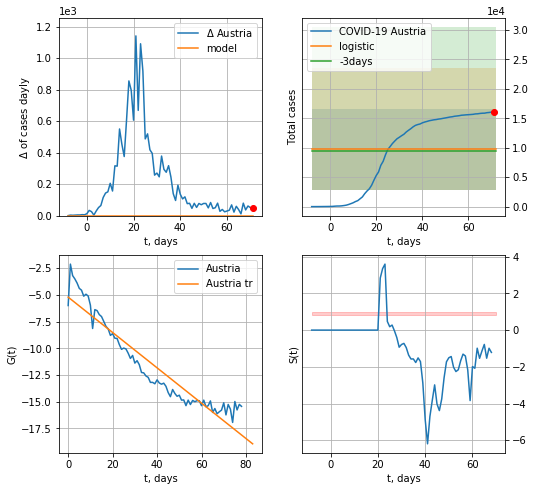

Austria data at: 2020-05-15
+3 day model MAPE: 0.03027522803160244
model: logistic
coeffs:  [ 9.15197513e+03 -3.05646478e+00  1.11455083e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.7135219052179866
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  9723 ± 6938
	 total death:  379 ± 811
trend coefficient of determination: 0.897902
 intercept: -5.216166
 slope: -0.165458


In [228]:
x = forecast('Austria',dfAT[:],d1,7*7-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


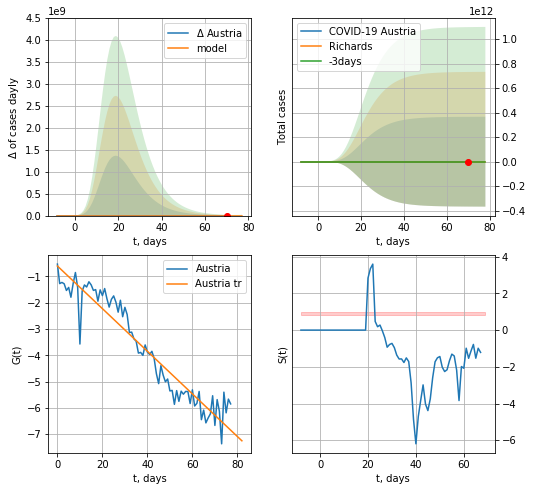

Austria data at: 2020-05-15
+3 day model MAPE: 0.004126
model: Richards
coeffs: [ 1.56625895e+04  1.29147625e+01 -1.69884009e+01  9.84557338e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 23384406.444778
forecast at the end of period: +8 days
	 deltaDaycases: 3
	 total cases: 15661 ± 366235748385
	 total death: 610 ± 42793463793
trend coefficient of determination: 0.909785
 intercept: -0.602373
 slope: -0.081132


In [229]:
x = forecastRR('Austria',dfAT[1:],d1,8*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


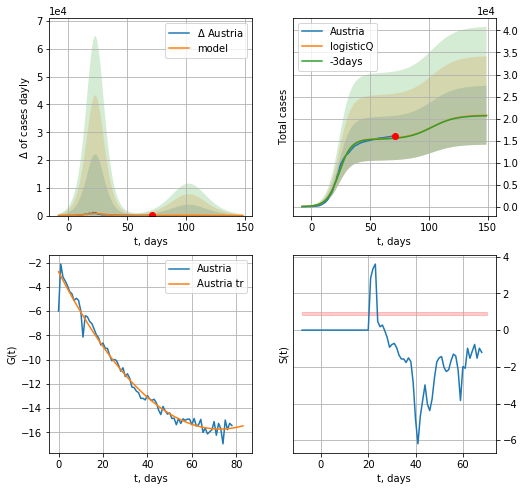

Austria data at: 2020-05-15
+3 day model MAPE: 0.005644
model: logisticQ
coeffs: [ 1.53613531e+04  9.97343988e-07  2.35229098e+01 -1.93530921e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322491
forecast at the end of period: +78 days
	 deltaDaycases: 5
	 total cases: 20742 ± 6689
	 total death: 808 ± 781
trend coefficient of determination: 0.980730
 intercept_: -2.751221291935444
 coeffs_: [ 0.         -0.35754903  0.00246282]


In [230]:
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


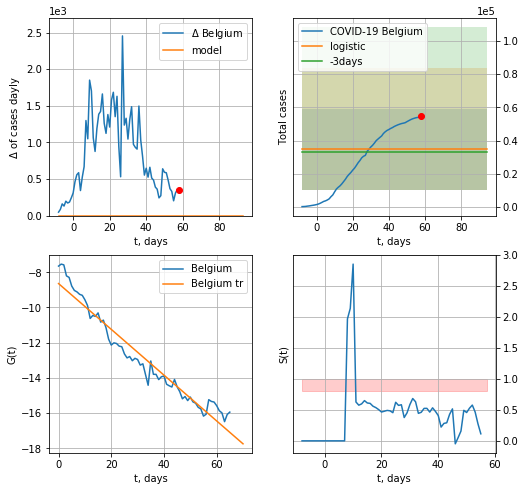

Belgium data at: 2020-05-15
+3 day model MAPE: 0.04685887045448347
model: logistic
coeffs:  [ 2.77784328e+04 -5.79696152e+00  2.07662430e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.7080396174212736
forecast at the end of period: +36 days
	 deltaDaycases:  0
	 total cases:  34723 ± 24585
	 total death:  5692 ± 12090
trend coefficient of determination: 0.945377
 intercept: -8.640515
 slope: -0.130050


In [231]:
vL=9
x = forecast('Belgium',dfBG[vL:],d1,12*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
          date  cases  active   death
71 2020-05-11  53449   31045  8707.0
72 2020-05-12  53779   31286  8761.0
73 2020-05-13  53981   31201  8843.0
74 2020-05-14  54288   31274  8903.0
75 2020-05-15  54644   31384  8959.0


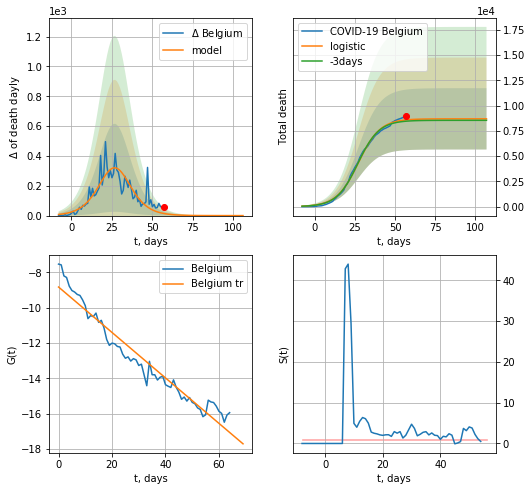

Belgium data at: 2020-05-15
+3 day model MAPE: 0.015463862643283985
model: logistic
coeffs:  [8.69537309e+03 1.47597778e-01 2.71291634e+01]
rational stdev:  0.3490052192835655
forecast at the end of period: +50 days
	 total death:  8695 ± 3034
trend coefficient of determination: 0.944218
 intercept: -8.831604
 slope: -0.128619


In [232]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,14*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


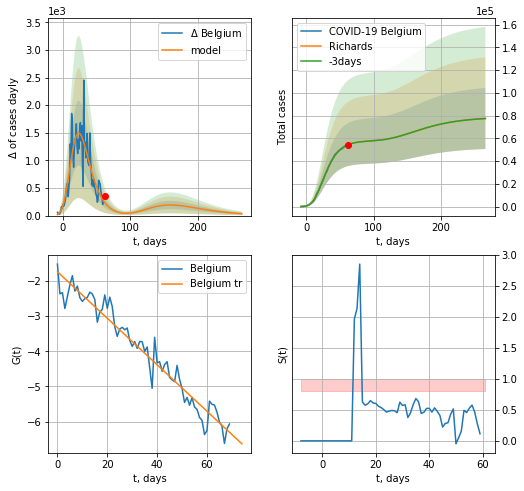

Belgium data at: 2020-05-15
+3 day model MAPE: 0.000765
model: Richards
coeffs: [ 5.79414958e+04  7.74385455e-01 -8.19565255e+00  9.46907506e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.346276
forecast at the end of period: +204 days
	 deltaDaycases: 34
	 total cases: 77531 ± 26847
	 total death: 12711 ± 13204
trend coefficient of determination: 0.944663
 intercept: -1.738013
 slope: -0.066101


In [233]:
x = forecastRR('Belgium',dfBG[5:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


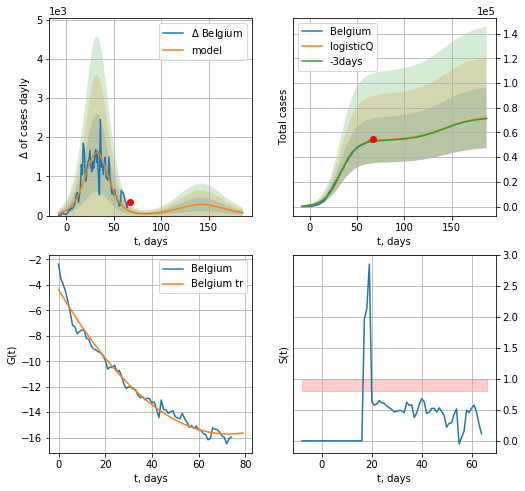

Belgium data at: 2020-05-15
+3 day model MAPE: 0.009197
model: logisticQ
coeffs: [ 5.39442045e+04  1.09392664e-06  3.26972407e+01 -1.08465562e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.342023
forecast at the end of period: +120 days
	 deltaDaycases: 71
	 total cases: 71795 ± 24555
	 total death: 11771 ± 12077
trend coefficient of determination: 0.980035
 intercept_: -4.363617074921987
 coeffs_: [ 0.         -0.31187294  0.00214286]


In [234]:
x = forecastRRR('Belgium',dfBG[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

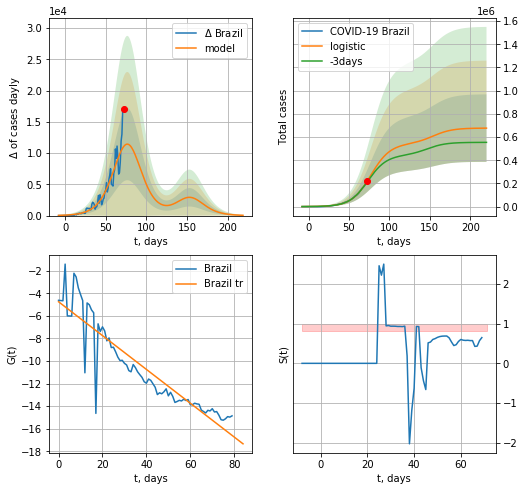

Brazil data at: 2020-05-15
+3 day model MAPE: 0.03356848642531508
model: logistic
coeffs:  [5.42016619e+05 8.42471298e-02 7.70462836e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.429927435627204
forecast at the end of period: +148 days
	 deltaDaycases:  46
	 total cases:  676994 ± 291058
	 total death:  45980 ± 59304
trend coefficient of determination: 0.841318
 intercept: -4.751099
 slope: -0.149803


In [235]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


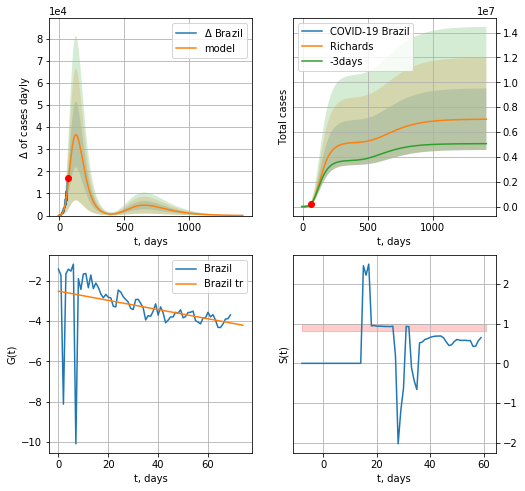

Brazil data at: 2020-05-15
+3 day model MAPE: 0.011054
model: Richards
coeffs: [5.16655192e+06 2.16225868e-01 9.21340628e+00 9.32767433e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.352165
forecast at the end of period: +1352 days
	 deltaDaycases: 68
	 total cases: 7029051 ± 2475387
	 total death: 477407 ± 504378
trend coefficient of determination: 0.126331
 intercept: -2.522316
 slope: -0.022820


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


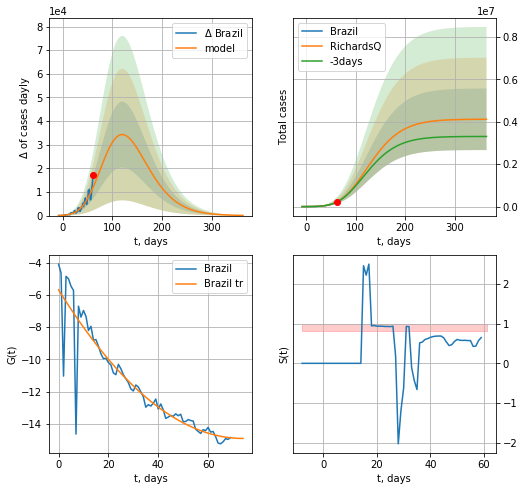

Brazil data at: 2020-05-15
+3 day model MAPE: 0.010224
model: RichardsQ
coeffs: [ 4.11891249e+06  1.80789502e-03 -2.42186034e+02 -2.42281422e+02
  1.75424551e-02]
rational stdev: 0.352410
forecast at the end of period: +302 days
	 deltaDaycases: 79
	 total cases: 4116877 ± 1450827
	 total death: 279615 ± 295617
trend coefficient of determination: 0.845335
 intercept_: -5.689720354383478
 coeffs_: [ 0.         -0.24928207  0.00168474]


In [236]:
x = forecastRR('Brazil',dfBZ[10:],d1,200*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


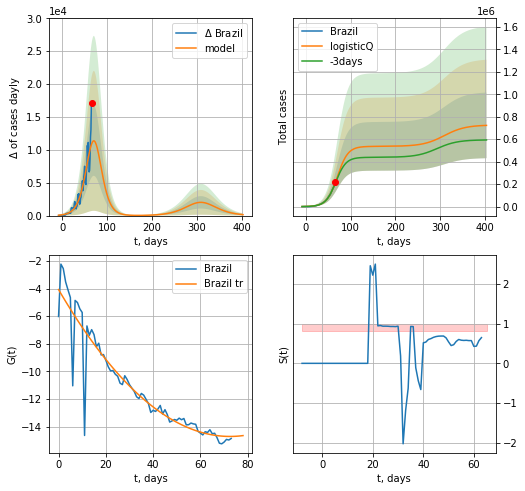

Brazil data at: 2020-05-15
+3 day model MAPE: 0.034103
model: logisticQ
coeffs: [ 5.36453632e+05  8.17068151e-06  7.08176227e+01 -1.03023528e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.404134
forecast at the end of period: +337 days
	 deltaDaycases: 144
	 total cases: 723043 ± 292206
	 total death: 49108 ± 59538
trend coefficient of determination: 0.870684
 intercept_: -4.070222895949671
 coeffs_: [ 0.         -0.29355475  0.00202485]


In [237]:
x = forecastRRR('Brazil',dfBZ[6:],d1,55*7-dT,addpred=True,xcoef=koreaCoeffs)

In [238]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

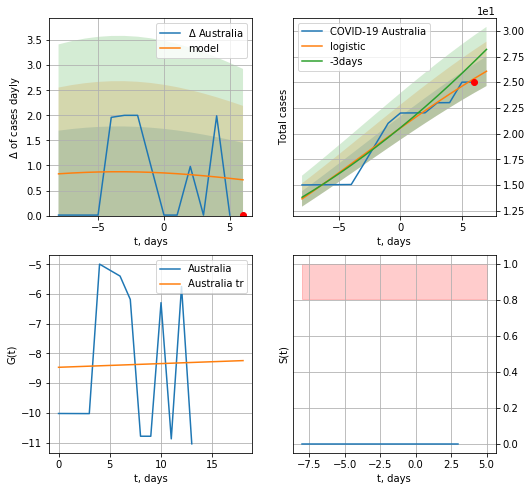

Australia data at: 2020-05-15
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  26 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


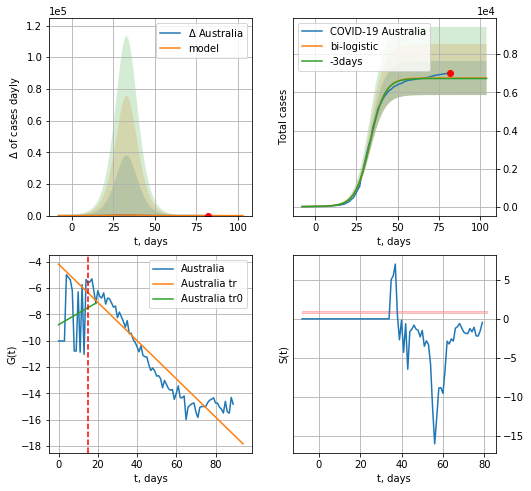

Australia data at: 2020-05-15
+3 day model MAPE: 0.004088953890918055
model: bi-logistic
coeffs:  [6.71655538e+03 2.23228294e-01 3.33859271e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.13222937336558677
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  6752 ± 892
	 total death:  94 ± 37
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.900243
 intercept: -4.187493
 slope: -0.145173


In [239]:
x = forecast('Australia',dfAS[:15],d1,7*7-dT,pMAPE=False)
xx = forecast2('Australia',dfAS[:],d1,10*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


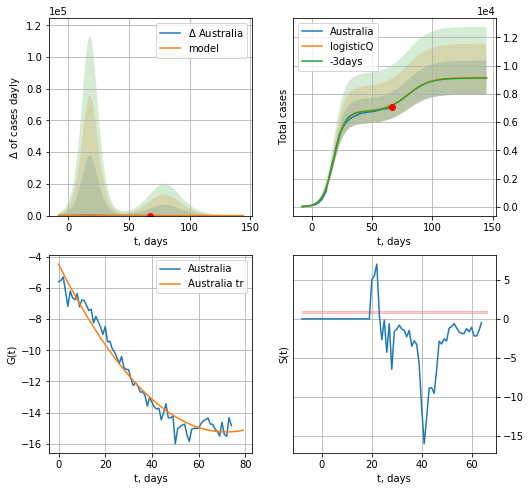

Australia data at: 2020-05-15
+3 day model MAPE: 0.003266
model: logisticQ
coeffs: [ 6.75556711e+03  1.86949189e-06  1.83304560e+01 -1.17966546e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.130746
forecast at the end of period: +78 days
	 deltaDaycases: 0
	 total cases: 9146 ± 1195
	 total death: 127 ± 49
trend coefficient of determination: 0.970505
 intercept_: -4.480634898995813
 coeffs_: [ 0.         -0.30007628  0.00209341]


In [240]:
x = forecastRRR('Australia',dfAS[15:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)

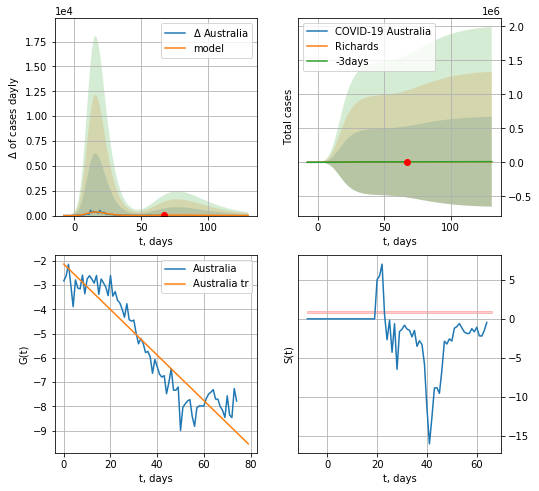

Australia data at: 2020-05-15
+3 day model MAPE: 0.010433
model: Richards
coeffs: [6.82755906e+03 7.85535215e-01 6.34368267e+00 2.04680639e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 72.069067
forecast at the end of period: +64 days
	 deltaDaycases: 6
	 total cases: 9175 ± 661263
	 total death: 127 ± 27458
trend coefficient of determination: 0.887556
 intercept: -2.136924
 slope: -0.093809


In [241]:
x = forecastRR('Australia',dfAS[15:],d1,16*7-dT,addpred=True,xcoef=RkoreaCoeffs)

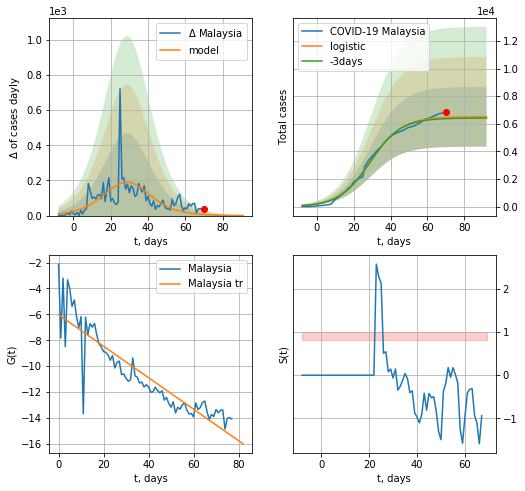

Malaysia data at: 2020-05-15
+3 day model MAPE: 0.014491082890483988
model: logistic
coeffs:  [6.51795649e+03 1.16892658e-01 2.91533977e+01]
rational stdev:  0.3329567312429099
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  6513 ± 2168
	 total death:  106 ± 105
trend coefficient of determination: 0.805788
 intercept: -6.027776
 slope: -0.121563


In [242]:
x = forecast('Malaysia',dfML[:],d1,10*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


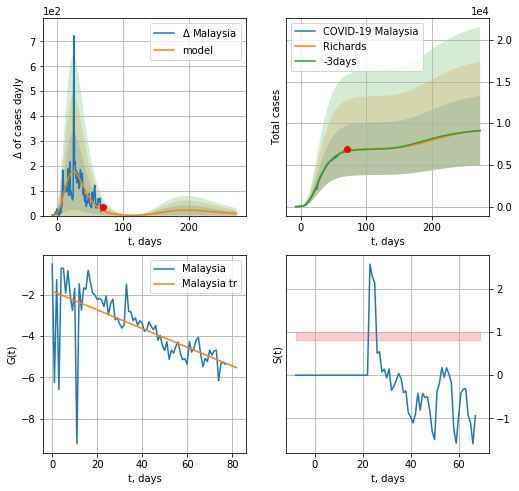

Malaysia data at: 2020-05-15
+3 day model MAPE: 0.008373
model: Richards
coeffs: [ 6.96180104e+03  5.19372138e+00 -3.69738223e+01  1.34648482e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.454301
forecast at the end of period: +204 days
	 deltaDaycases: 8
	 total cases: 9118 ± 4142
	 total death: 148 ± 201
trend coefficient of determination: 0.406540
 intercept: -1.835974
 slope: -0.045058


In [243]:
x = forecastRR('Malaysia',dfML[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


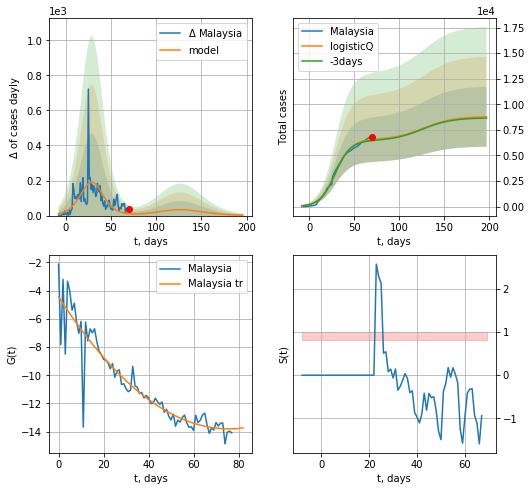

Malaysia data at: 2020-05-15
+3 day model MAPE: 0.014465
model: logisticQ
coeffs: [ 6.51777067e+03  7.56593411e-07  2.91535076e+01 -1.54430713e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333038
forecast at the end of period: +127 days
	 deltaDaycases: 2
	 total cases: 8788 ± 2927
	 total death: 143 ± 142
trend coefficient of determination: 0.864691
 intercept_: -4.436932848248265
 coeffs_: [ 0.         -0.2471689   0.00163132]


In [244]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
          date   cases  active  death
73 2020-05-11  1497.1      78   21.0
74 2020-05-12  1497.2      74   21.0
75 2020-05-13  1497.3      65   21.0
76 2020-05-14  1498.0      56   21.0
77 2020-05-15  1498.1      49   21.0


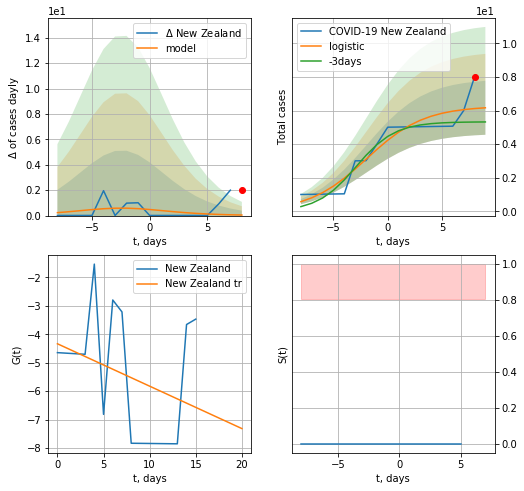

New Zealand data at: 2020-05-15
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


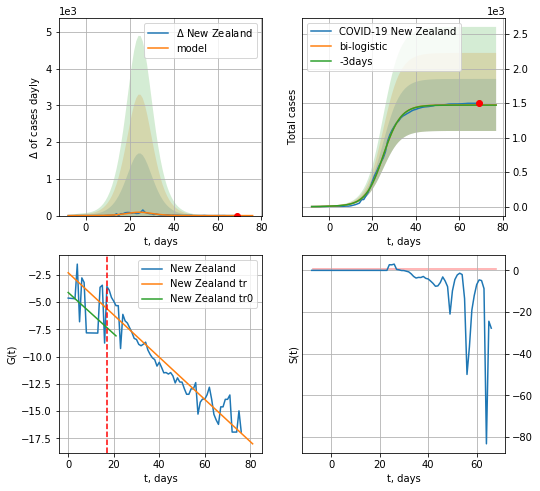

New Zealand data at: 2020-05-15
+3 day model MAPE: 0.0018756732549271256
model: bi-logistic
coeffs:  [1.46736985e+03 2.48375369e-01 2.49813983e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.2557192641633842
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  1473 ± 376
	 total death:  20 ± 15
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.917120
 intercept: -2.322514
 slope: -0.193552


In [246]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
x = forecast('New Zealand',dfZL[:vL],d1,7*7-dT,pMAPE=False)
xx = forecast2('New Zealand',dfZL[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#

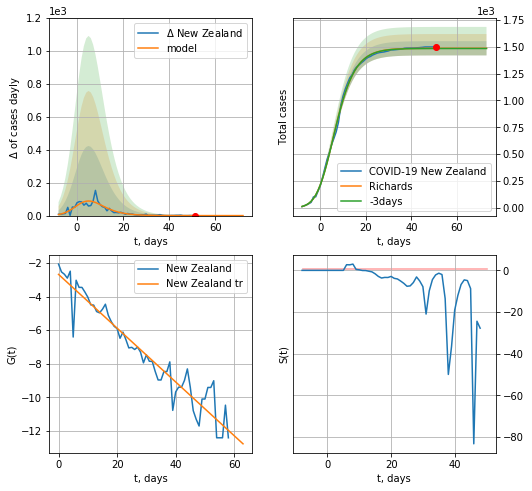

New Zealand data at: 2020-05-15
+3 day model MAPE: 0.001350
model: Richards
coeffs: [1.48512261e+03 5.02460026e-01 5.36421712e-01 3.83443106e-01]
rational stdev: 0.044605
forecast at the end of period: +22 days
	 deltaDaycases: 0
	 total cases: 1485 ± 66
	 total death: 20 ± 2
trend coefficient of determination: 0.917568
 intercept: -2.677829
 slope: -0.160303


In [247]:
x = forecastRR('New Zealand',dfZL[18:],d1,10*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


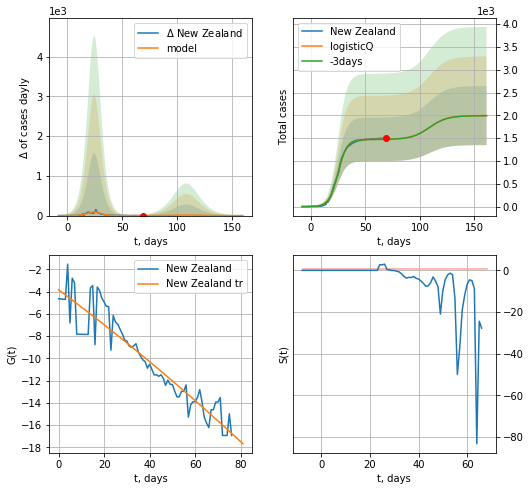

New Zealand data at: 2020-05-15
+3 day model MAPE: 0.001863
model: logisticQ
coeffs: [ 1.47415995e+03  3.25109478e-06  2.49370155e+01 -7.56175240e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324591
forecast at the end of period: +92 days
	 deltaDaycases: 0
	 total cases: 1995 ± 647
	 total death: 27 ± 26
trend coefficient of determination: 0.880218
 intercept_: -3.8380528827588343
 coeffs_: [ 0.         -0.15232822 -0.00022855]


In [248]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
          date    cases  active  death
73 2020-05-11  23906.0   17240  135.0
74 2020-05-12  24873.0   17757  142.0
75 2020-05-13  25825.0   17968  146.0
76 2020-05-14  26772.0   18453  151.0
77 2020-05-15  27730.0   18767  156.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


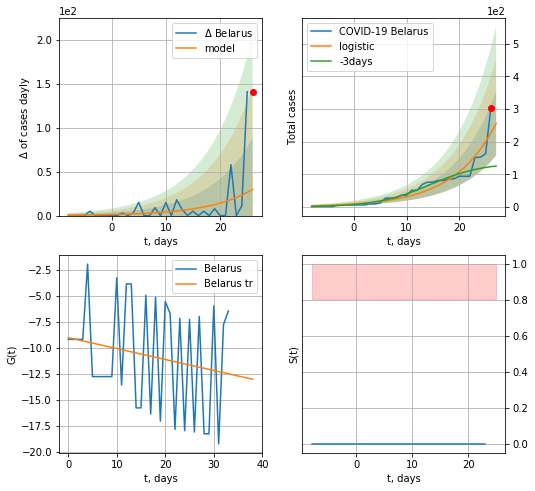

Belarus data at: 2020-05-15
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +1 days
	 deltaDaycases:  29
	 total cases:  255 ± 98
	 total death:  1 ± 1
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


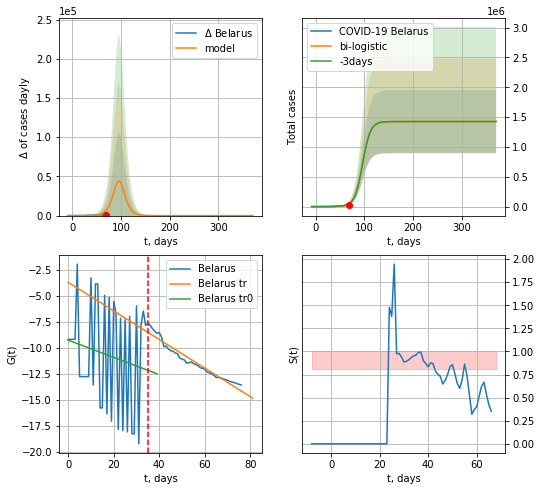

Belarus data at: 2020-05-15
+3 day model MAPE: 0.03209474610699628
model: bi-logistic
coeffs:  [2.05807498e+03 7.70479075e-01 3.30463603e+01] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.37154673560397045
forecast at the end of period: +302 days
	 deltaDaycases:  0
	 total cases:  1424037 ± 529096
	 total death:  8011 ± 8929
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.946605
 intercept: -3.723087
 slope: -0.137539


In [249]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*7-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
          date    cases  active  death
73 2020-05-11  23906.0   17240  135.0
74 2020-05-12  24873.0   17757  142.0
75 2020-05-13  25825.0   17968  146.0
76 2020-05-14  26772.0   18453  151.0
77 2020-05-15  27730.0   18767  156.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


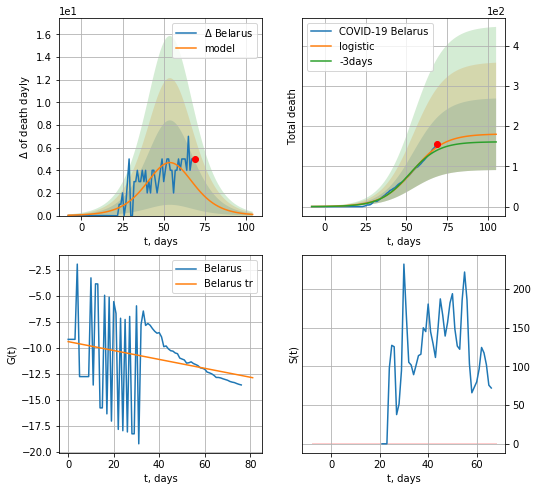

Belarus data at: 2020-05-15
+3 day model MAPE: 0.060836559010185316
model: logistic
coeffs:  [1.80799533e+02 1.03555044e-01 5.42540508e+01]
rational stdev:  0.49484716412016533
forecast at the end of period: +36 days
	 total death:  179 ± 89
trend coefficient of determination: 0.065343
 intercept: -9.428938
 slope: -0.042832


In [250]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,12*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


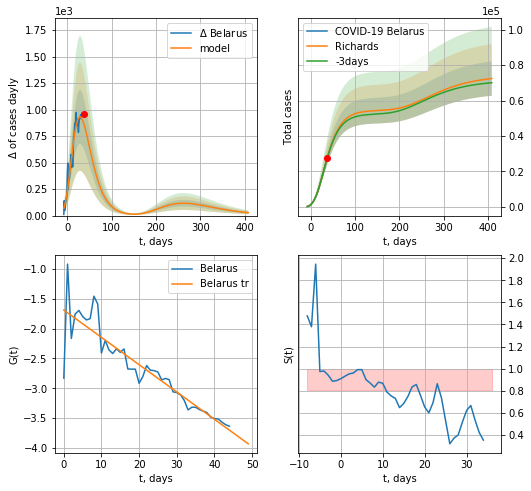

Belarus data at: 2020-05-15
+3 day model MAPE: 0.007007
model: Richards
coeffs: [ 5.45048091e+04  1.79132807e+00 -4.82648533e+01  2.62780579e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.134090
forecast at the end of period: +372 days
	 deltaDaycases: 27
	 total cases: 72467 ± 9717
	 total death: 407 ± 163
trend coefficient of determination: 0.830334
 intercept: -1.688871
 slope: -0.045743


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


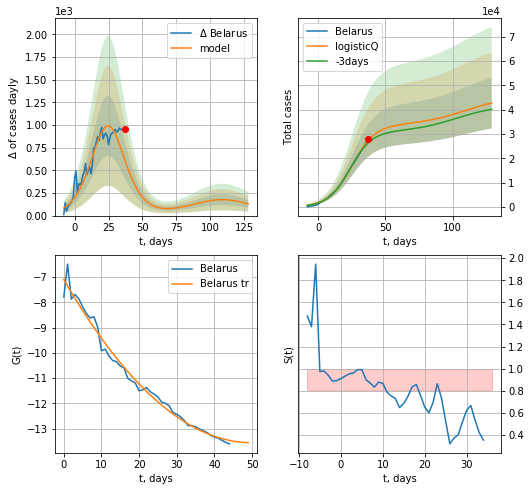

Belarus data at: 2020-05-15
+3 day model MAPE: 0.039454
model: logisticQ
coeffs: [ 3.36356408e+04  3.37699483e-06  2.50762326e+01 -3.47035675e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.244147
forecast at the end of period: +92 days
	 deltaDaycases: 129
	 total cases: 42709 ± 10427
	 total death: 240 ± 175
trend coefficient of determination: 0.984179
 intercept_: -7.090475517009991
 coeffs_: [ 0.         -0.25862584  0.00258735]


In [251]:
x = forecastRR('Belarus',dfBR[32:],d1,60*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


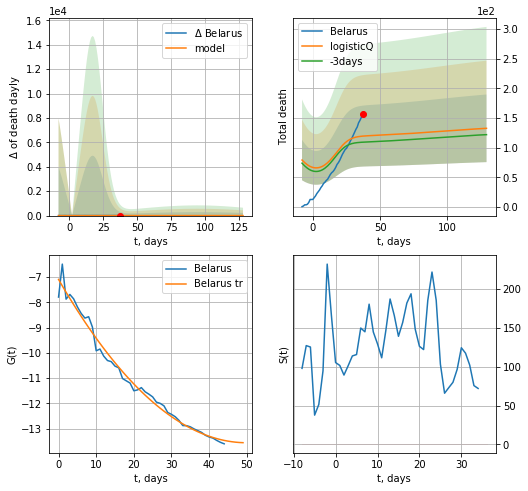

Belarus data at: 2020-05-15
+3 day model MAPE: 0.093818
model: logisticQ
coeffs: [ 1.01369980e+02  4.74897661e-03  6.26988799e+00 -1.27275674e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.428513
forecast at the end of period: +92 days
	 total death: 132 ± 56
trend coefficient of determination: 0.984179
 intercept_: -7.090475517009991
 coeffs_: [ 0.         -0.25862584  0.00258735]


In [252]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

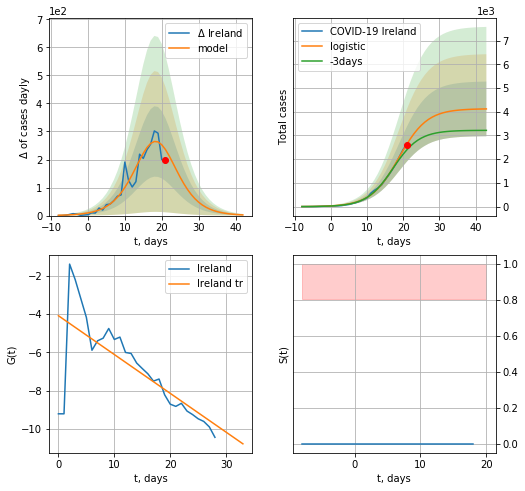

Ireland data at: 2020-05-15
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +22 days
	 deltaDaycases:  2
	 total cases:  4119 ± 1152
	 total death:  261 ± 219
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


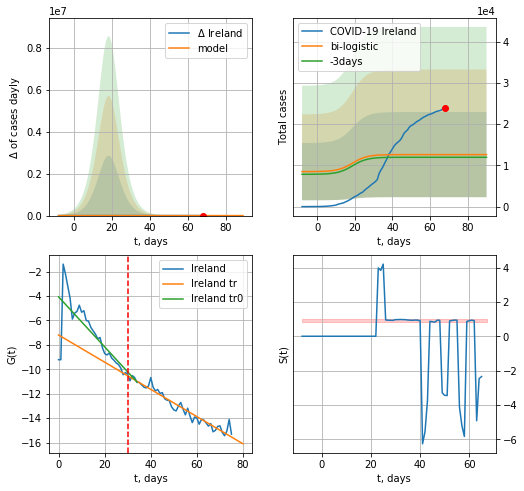

Ireland data at: 2020-05-15
+3 day model MAPE: 0.054343217215225025
model: bi-logistic
coeffs:  [6781.28429688   -7.01576579  182.54737146] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8184031132258516
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  12603 ± 10315
	 total death:  798 ± 1959
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.943439
 intercept: -7.186054
 slope: -0.111374


In [253]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,10*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


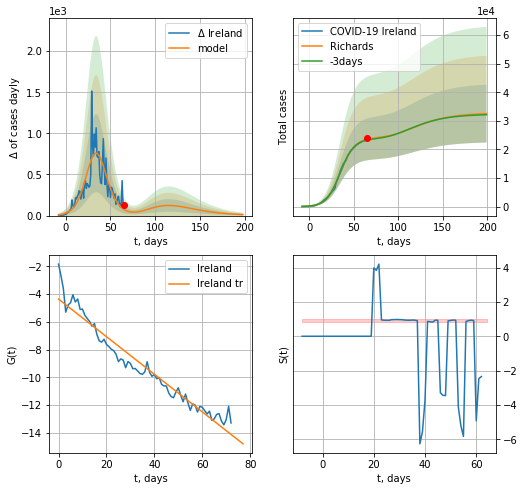

Ireland data at: 2020-05-15
+3 day model MAPE: 0.009874
model: Richards
coeffs: [2.41012092e+04 1.47873883e-01 3.25320337e+01 8.00038714e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.310768
forecast at the end of period: +134 days
	 deltaDaycases: 11
	 total cases: 32541 ± 10112
	 total death: 2062 ± 1922
trend coefficient of determination: 0.944913
 intercept: -4.358315
 slope: -0.135514


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


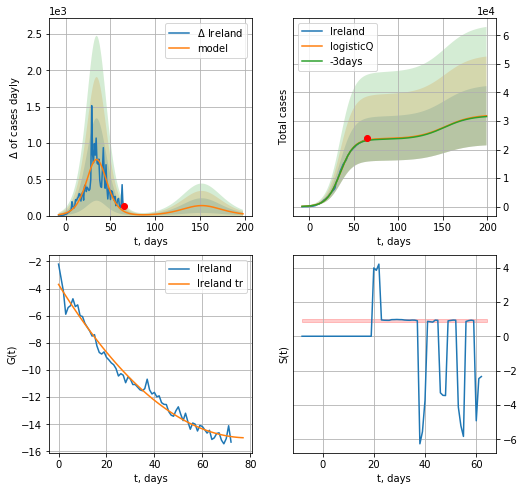

Ireland data at: 2020-05-15
+3 day model MAPE: 0.008547
model: logisticQ
coeffs: [ 2.37996817e+04  3.46308882e-06  3.49588219e+01 -3.75056493e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.325875
forecast at the end of period: +134 days
	 deltaDaycases: 24
	 total cases: 31846 ± 10378
	 total death: 2018 ± 1972
trend coefficient of determination: 0.981862
 intercept_: -3.692021097749718
 coeffs_: [ 0.         -0.28546782  0.00180248]


In [254]:
x = forecastRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

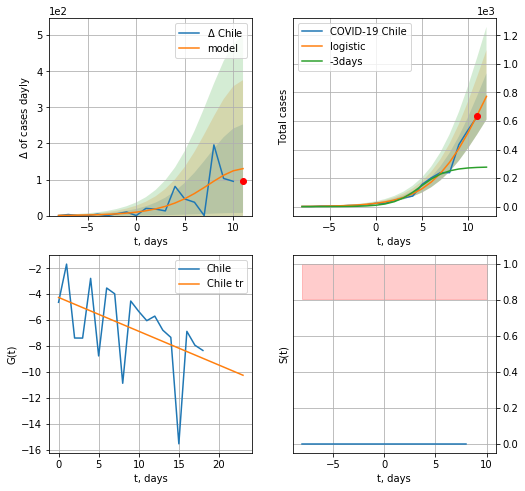

Chile data at: 2020-05-15
+3 day model MAPE: 1.7934705345739388
model: logistic
coeffs:  [1.48202088e+03 3.52936511e-01 1.17607351e+01]
rational stdev:  0.2100967778814968
forecast at the end of period: +1 days
	 deltaDaycases:  130
	 total cases:  772 ± 162
	 total death:  7 ± 4
trend coefficient of determination: 0.220917
 intercept: -4.249067
 slope: -0.261154


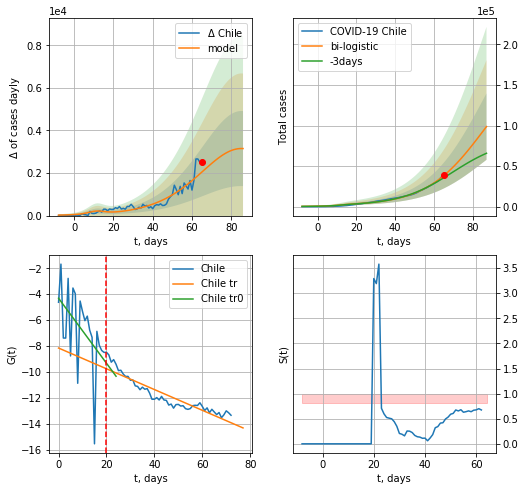

Chile data at: 2020-05-15
+3 day model MAPE: 0.0872922276627006
model: bi-logistic
coeffs:  [1.85208472e+05 6.78432363e-02 8.55881495e+01] [1.48202088e+03 3.52936511e-01 1.17607351e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.41522450534591
forecast at the end of period: +22 days
	 deltaDaycases:  3147
	 total cases:  98670 ± 40970
	 total death:  983 ± 1224
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.233377
 intercept: -4.310588
 slope: -0.250901
trend coefficient of determination: 0.857670
 intercept: -8.155651
 slope: -0.080099


In [255]:
vL=20
x = forecast('Chile',dfCL[:vL],d1,7*7-dT)
xx = forecast2('Chile',dfCL[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


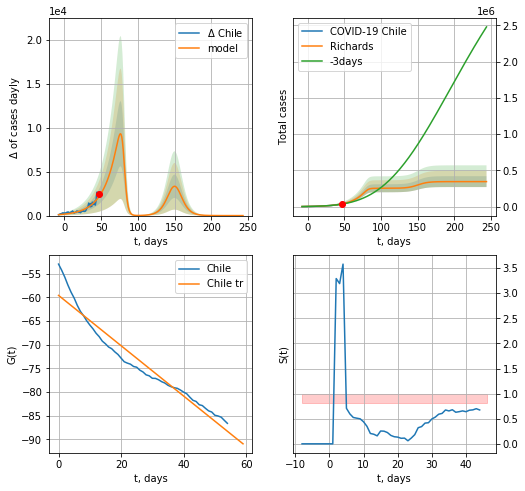

Chile data at: 2020-05-15
+3 day model MAPE: 0.076097
model: Richards
coeffs: [2.53319411e+05 5.47570334e-02 8.15169861e+01 7.92231843e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.217064
forecast at the end of period: +197 days
	 deltaDaycases: 0
	 total cases: 345127 ± 74914
	 total death: 3438 ± 2238
trend coefficient of determination: 0.940083
 intercept: -59.591702
 slope: -0.531411


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


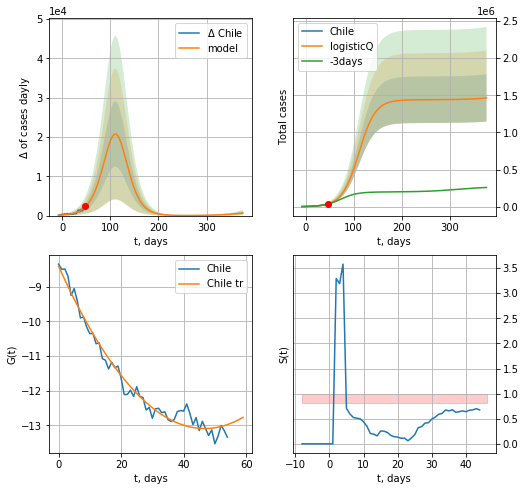

Chile data at: 2020-05-15
+3 day model MAPE: 0.058646
model: logisticQ
coeffs: [ 1.44000498e+06  1.41358328e-05  1.10402544e+02 -3.97127018e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.217588
forecast at the end of period: +330 days
	 deltaDaycases: 670
	 total cases: 1465190 ± 318807
	 total death: 14599 ± 9529
trend coefficient of determination: 0.975358
 intercept_: -8.4029642612111
 coeffs_: [ 0.         -0.20074348  0.00214806]


In [256]:
x = forecastRR('Chile',dfCL[18:],d1,35*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Chile',dfCL[18:],d1,54*7-dT,addpred=True,xcoef=koreaCoeffs)

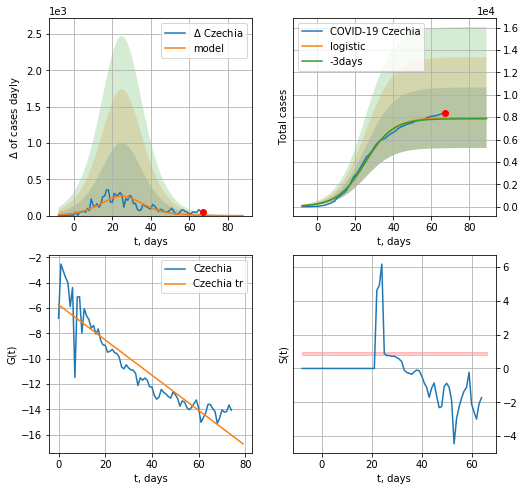

Czechia data at: 2020-05-15
+3 day model MAPE: 0.011647298736172568
model: logistic
coeffs:  [7.95637632e+03 1.34475604e-01 2.53953962e+01]
rational stdev:  0.3403736298905715
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  7954 ± 2707
	 total death:  279 ± 284
trend coefficient of determination: 0.852163
 intercept: -5.741829
 slope: -0.138965


In [257]:
x = forecast('Czechia',dfCH[:],d1,10*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


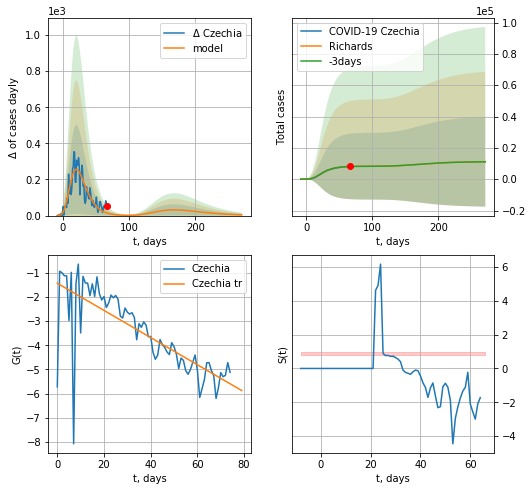

Czechia data at: 2020-05-15
+3 day model MAPE: 0.007087
model: Richards
coeffs: [ 8.32744089e+03  8.23282694e+00 -3.33834265e+01  1.02090756e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 2.561866
forecast at the end of period: +204 days
	 deltaDaycases: 4
	 total cases: 11191 ± 28670
	 total death: 392 ± 3012
trend coefficient of determination: 0.572951
 intercept: -1.436330
 slope: -0.056152


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


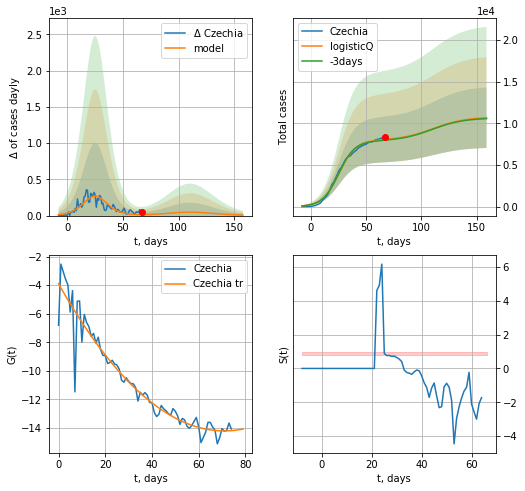

Czechia data at: 2020-05-15
+3 day model MAPE: 0.011504
model: logisticQ
coeffs: [ 7.95626951e+03  6.53969374e-07  2.53956716e+01 -2.05557215e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.340442
forecast at the end of period: +92 days
	 deltaDaycases: 6
	 total cases: 10670 ± 3632
	 total death: 374 ± 381
trend coefficient of determination: 0.921301
 intercept_: -3.9026465691531014
 coeffs_: [ 0.         -0.29014753  0.00204312]


In [258]:
x = forecastRR('Czechia',dfCH[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Czechia',dfCH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

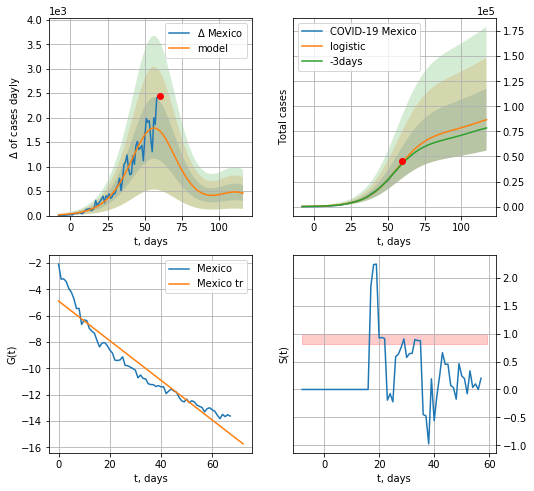

Mexico data at: 2020-05-15
+3 day model MAPE: 0.03405518417403304
model: logistic
coeffs:  [7.56874328e+04 9.40861821e-02 5.65160180e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.35609703939483706
forecast at the end of period: +57 days
	 deltaDaycases:  458
	 total cases:  86639 ± 30852
	 total death:  9171 ± 9797
trend coefficient of determination: 0.917967
 intercept: -4.886024
 slope: -0.150760


In [259]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


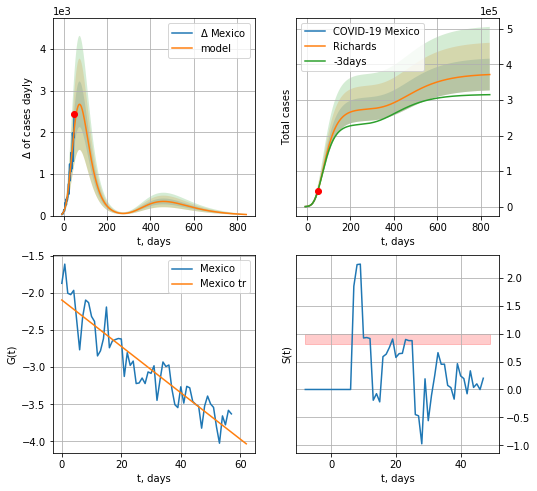

Mexico data at: 2020-05-15
+3 day model MAPE: 0.004809
model: Richards
coeffs: [ 2.74824857e+05  4.10331037e-01 -2.51773386e+01  6.65161703e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.120185
forecast at the end of period: +792 days
	 deltaDaycases: 25
	 total cases: 371620 ± 44662
	 total death: 39338 ± 14183
trend coefficient of determination: 0.860378
 intercept: -2.094248
 slope: -0.031267


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


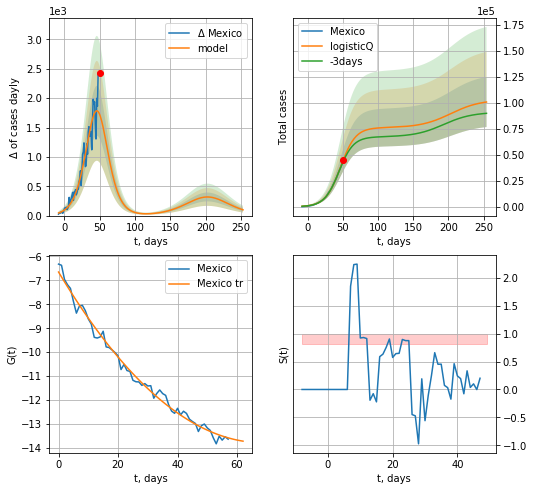

Mexico data at: 2020-05-15
+3 day model MAPE: 0.034036
model: logisticQ
coeffs: [ 7.59575236e+04  6.07761529e-06  4.65916619e+01 -1.54184336e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.239168
forecast at the end of period: +204 days
	 deltaDaycases: 98
	 total cases: 100628 ± 24066
	 total death: 10652 ± 7642
trend coefficient of determination: 0.989714
 intercept_: -6.6536325690213705
 coeffs_: [ 0.         -0.2076291   0.00151165]


In [260]:
x = forecastRR('Mexico',dfMX[10:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
          date   cases  active  death     tests
63 2020-05-11  1491.0     591   50.0  192386.0
64 2020-05-12  1505.0     543   54.0  200264.0
65 2020-05-13  1511.0     523   54.0  208253.0
66 2020-05-14  1523.0     504   54.0  216247.0
67 2020-05-15  1523.0     504   54.0       NaN
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


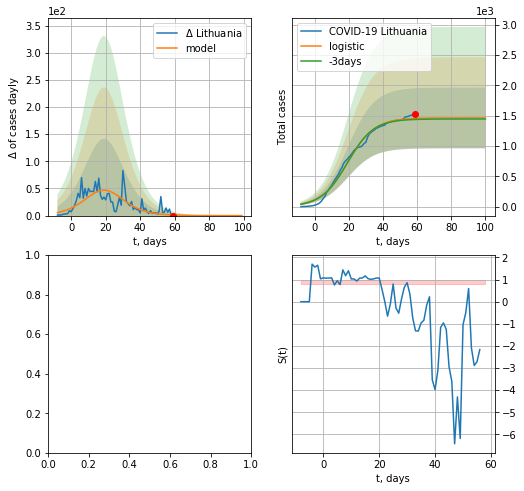

In [262]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

LT
          date   cases  active  death     tests
59 2020-05-07  1436.0     622   49.1  172191.0
60 2020-05-08  1444.0     563   49.2  180332.0
61 2020-05-09  1479.0     597   50.0  183913.0
62 2020-05-10  1485.0     598   50.0  186565.0
63 2020-05-11  1491.0     591   50.0  192386.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


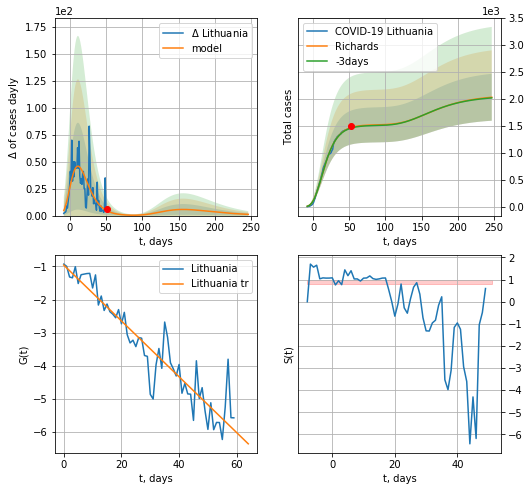

Lithuania data at: 2020-05-11
+3 day model MAPE: 0.006198
model: Richards
coeffs: [ 1.51994855e+03  1.02341185e+01 -4.66290893e+01  8.05085102e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.214109
forecast at the end of period: +195 days
	 deltaDaycases: 1
	 total cases: 2028 ± 434
	 total death: 68 ± 43
trend coefficient of determination: 0.884814
 intercept: -0.959143
 slope: -0.084382


In [361]:
dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)
x = forecastRR('Lithuania',dfLT[3:],d1,28*7-1,addpred=True,xcoef=RkoreaCoeffs)#
#plt.grid()#

In [56]:
#np.diff(dfLT["cases"])

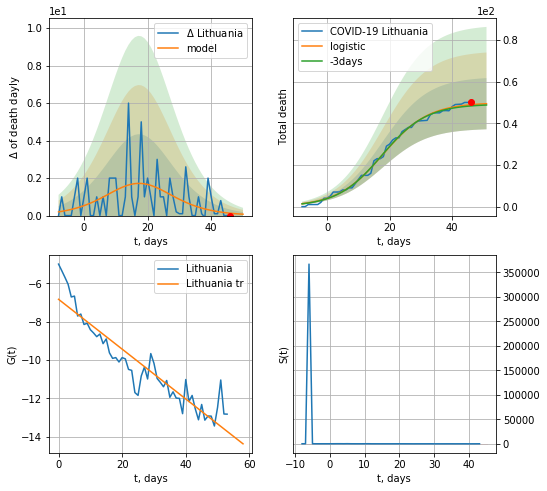

Lithuania data at: 2020-05-11
+3 day model MAPE: 0.012087236450157428
model: logistic
coeffs:  [49.90454496  0.13777732 17.80379754]
rational stdev:  0.24876136121856576
forecast at the end of period: +5 days
	 total death:  49 ± 12
trend coefficient of determination: 0.865550
 intercept: -6.837379
 slope: -0.129847


In [362]:
x = forecast('Lithuania',dfLT[9:],d1,7*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:153: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


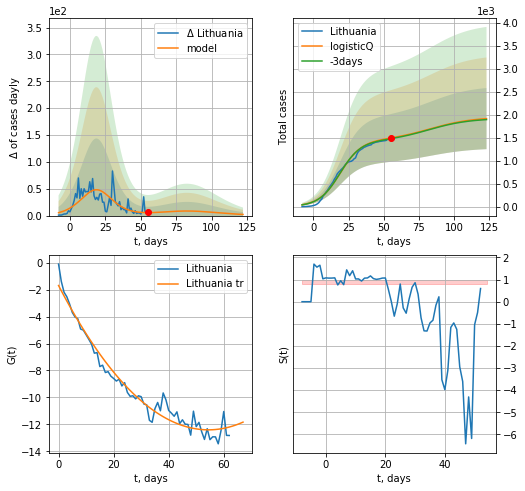

Lithuania data at: 2020-05-11
+3 day model MAPE: 0.010814
model: logisticQ
coeffs: [ 1.43975925e+03  7.56347340e-07  1.90894219e+01 -1.75143375e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347340
forecast at the end of period: +68 days
	 deltaDaycases: 2
	 total cases: 1916 ± 665
	 total death: 64 ± 66
trend coefficient of determination: 0.965359
 intercept_: -1.6941054683281394
 coeffs_: [ 0.         -0.39353907  0.00361534]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


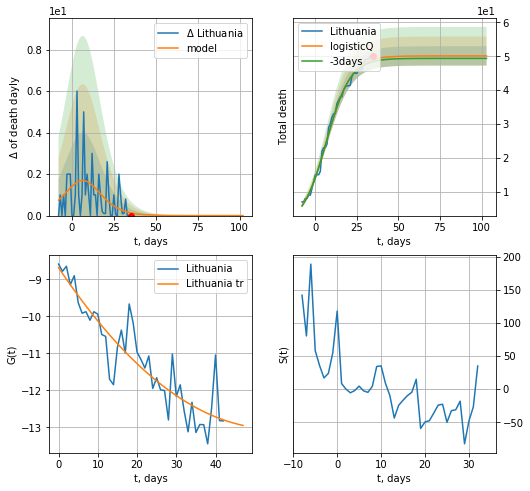

Lithuania data at: 2020-05-11
+3 day model MAPE: 0.012231
model: logisticQ
coeffs: [ 5.01178749e+01  4.95343299e-06  6.87417360e+00 -2.72743041e+04]
rational stdev: 0.056931
forecast at the end of period: +68 days
	 total death: 50 ± 2
trend coefficient of determination: 0.821824
 intercept_: -8.684562824690044
 coeffs_: [ 0.         -0.15842334  0.00144252]


In [363]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


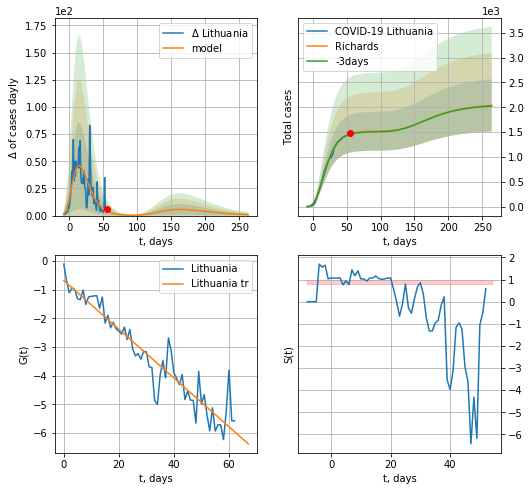

Lithuania data at: 2020-05-11
+3 day model MAPE: 0.006162
model: Richards
coeffs: [ 1.51987088e+03  1.07011367e+01 -4.41652005e+01  7.70029923e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.258266
forecast at the end of period: +209 days
	 deltaDaycases: 0
	 total cases: 2039 ± 526
	 total death: 68 ± 52
trend coefficient of determination: 0.898168
 intercept: -0.675781
 slope: -0.085054


In [364]:
x = forecastRR('Lithuania',dfLT[:],d1,30*7-1,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app


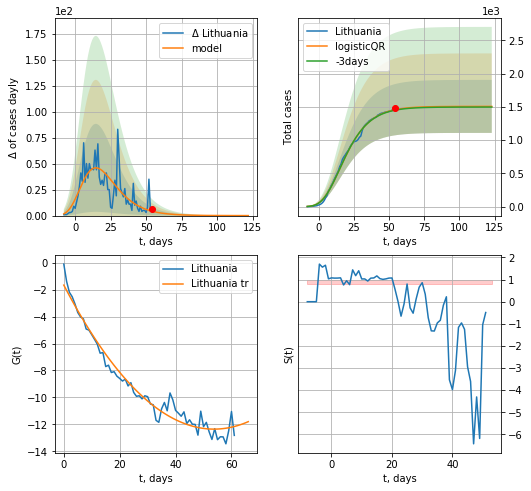

Lithuania data at: 2020-05-10
+3 day model MAPE: 0.004869687672363178
model: logisticQR
coeffs:  [ 1.50697400e+03  5.00163734e-02 -7.02965180e+01 -1.02163440e+03
  1.47780958e-03]
rational stdev:  0.2644397798656571
forecast at the end of period: +69 days
	 deltaDaycases:  0
	 total cases:  1506 ± 398
	 total death:  50 ± 39
trend coefficient of determination: 0.965360
 intercept_: -1.6638270222445106
 coeffs_: [ 0.         -0.39759438  0.00369812]


In [60]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
          date   cases  active  death
65 2020-05-11  3888.0     185  101.0
66 2020-05-12  3894.0     182  102.0
67 2020-05-13  3904.0     172  103.0
68 2020-05-14  3915.0     147  103.0
69 2020-05-15  3923.0     137  104.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


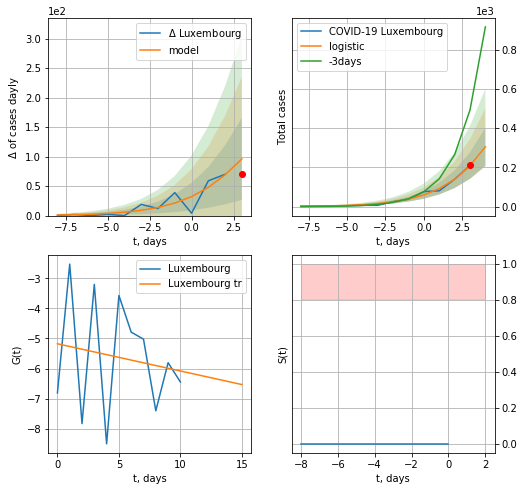

Luxembourg data at: 2020-05-15
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +1 days
	 deltaDaycases:  96
	 total cases:  305 ± 98
	 total death:  8 ± 7
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


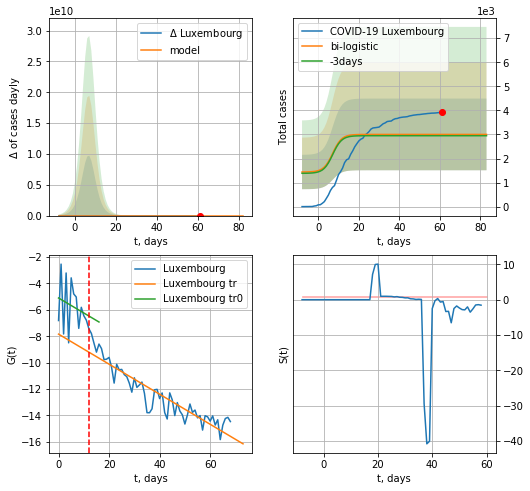

Luxembourg data at: 2020-05-15
+3 day model MAPE: 0.01831788948068171
model: bi-logistic
coeffs:  [1279.03248189   -5.52942675  219.37837307] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.4959333968923945
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  3001 ± 1488
	 total death:  79 ± 117
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.845400
 intercept: -7.839506
 slope: -0.113922


In [263]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,7*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,10*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


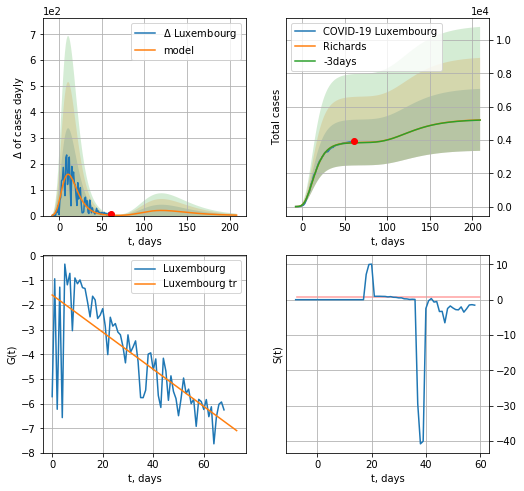

Luxembourg data at: 2020-05-15
+3 day model MAPE: 0.003236
model: Richards
coeffs: [ 3.85912524e+03  1.62833211e+01 -3.29301178e+01  6.92879813e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.357122
forecast at the end of period: +148 days
	 deltaDaycases: 1
	 total cases: 5212 ± 1861
	 total death: 138 ± 147
trend coefficient of determination: 0.610707
 intercept: -1.589487
 slope: -0.075395


In [264]:
x = forecastRR("Luxembourg",dfLX[:],d1,28*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


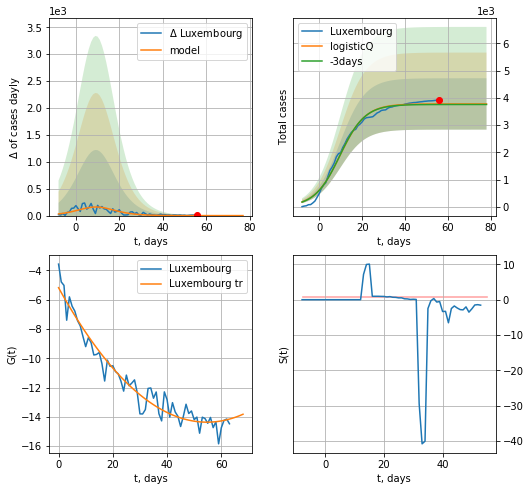

Luxembourg data at: 2020-05-15
+3 day model MAPE: 0.005397
model: logisticQ
coeffs: [ 3.77515226e+03  8.35879314e-07  9.71400731e+00 -2.02856142e+05]
rational stdev: 0.249627
forecast at the end of period: +22 days
	 deltaDaycases: 0
	 total cases: 3775 ± 942
	 total death: 100 ± 74
trend coefficient of determination: 0.945235
 intercept_: -5.181932435109511
 coeffs_: [ 0.         -0.33557088  0.00306686]


In [265]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,10*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
          date    cases   active   death
72 2020-05-11  29509.0  23931.0  2145.0
73 2020-05-12  30419.0  24659.0  2327.0
74 2020-05-13  30486.0  24719.0  2334.0
75 2020-05-14  30502.0  24731.0  2338.0
76 2020-05-15  31467.0  25440.0  2594.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


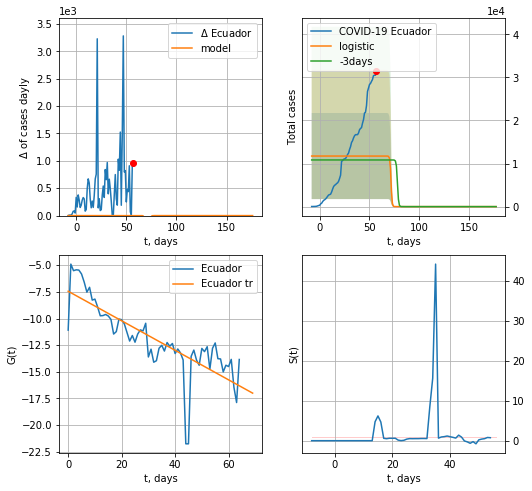

Ecuador data at: 2020-05-15
+3 day model MAPE: 0.08385199875073021
model: logistic
coeffs:  [ 1.17418342e+04 -1.98749093e+00  7.15823272e+01]
rational stdev:  0.8510953492085793
forecast at the end of period: +120 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.634595
 intercept: -7.443446
 slope: -0.138460


In [266]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


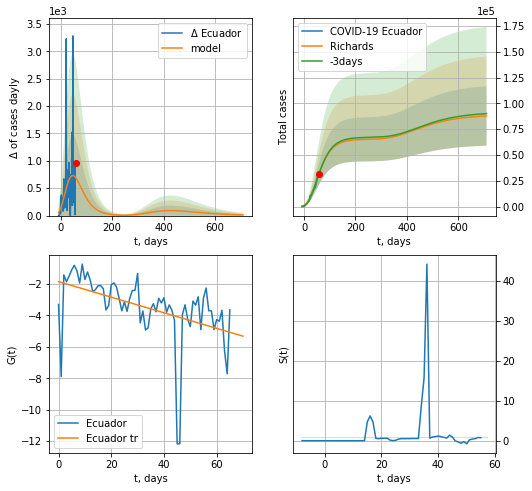

Ecuador data at: 2020-05-15
+3 day model MAPE: 0.004764
model: Richards
coeffs: [ 6.52737590e+04  2.03020740e+00 -8.88657144e+01  1.51207769e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.327706
forecast at the end of period: +652 days
	 deltaDaycases: 12
	 total cases: 87732 ± 28750
	 total death: 7232 ± 7109
trend coefficient of determination: 0.207164
 intercept: -1.841008
 slope: -0.049653


In [267]:
x = forecastRR("Ecuador",dfED[10:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


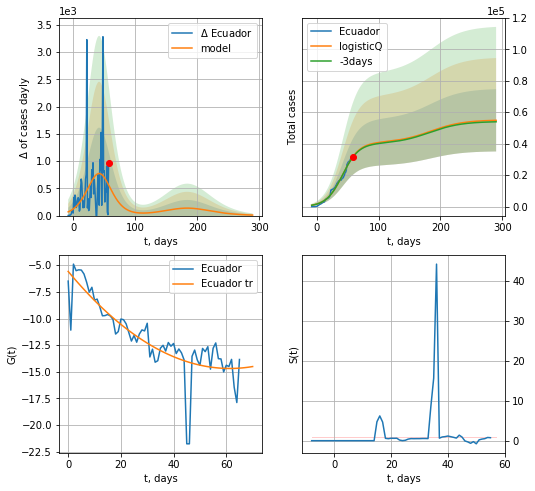

Ecuador data at: 2020-05-15
+3 day model MAPE: 0.007083
model: logisticQ
coeffs: [ 4.06857867e+04  8.81370481e-07  4.22433998e+01 -8.58567294e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.360601
forecast at the end of period: +232 days
	 deltaDaycases: 9
	 total cases: 54844 ± 19776
	 total death: 4521 ± 4890
trend coefficient of determination: 0.704747
 intercept_: -5.581505442297946
 coeffs_: [ 0.         -0.2966527   0.00241697]


In [268]:
x = forecastRRR("Ecuador",dfED[10:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
          date   cases  active  death
76 2020-05-11  5984.0    1713  271.0
77 2020-05-12  6003.0    1428  275.0
78 2020-05-13  6054.0    1470  284.0
79 2020-05-14  6145.0    1558  287.0
80 2020-05-15  6228.0     935  293.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


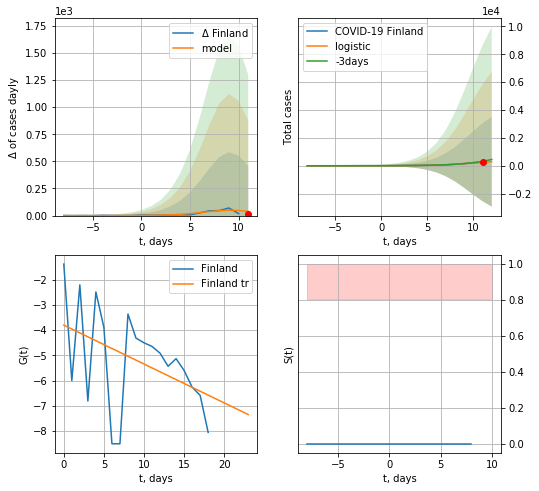

Finland data at: 2020-05-15
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +1 days
	 deltaDaycases:  38
	 total cases:  292 ± 3225
	 total death:  13 ± 430
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


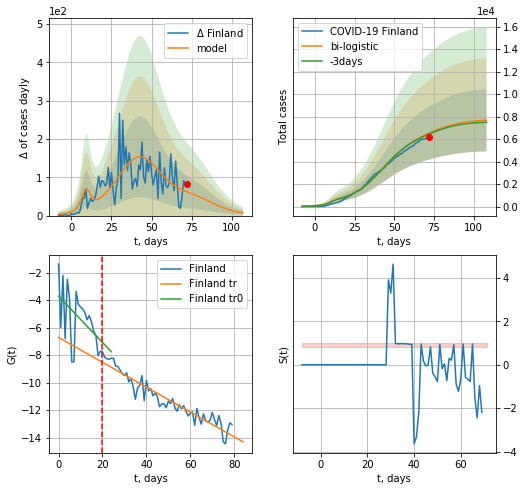

Finland data at: 2020-05-15
+3 day model MAPE: 0.012717605101222027
model: bi-logistic
coeffs:  [5.89810210e+03 1.00959110e-01 4.27285914e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.36009346315605084
forecast at the end of period: +36 days
	 deltaDaycases:  7
	 total cases:  7676 ± 2764
	 total death:  361 ± 389
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.904489
 intercept: -6.719600
 slope: -0.090399


In [269]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*7-dT)
xx = forecast2("Finland",dfFI[:],d1,12*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


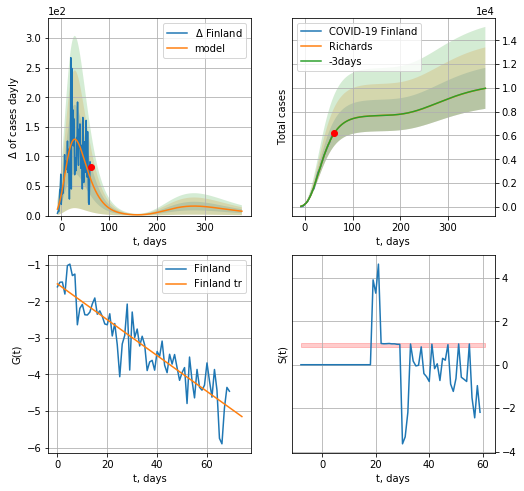

Finland data at: 2020-05-15
+3 day model MAPE: 0.000204
model: Richards
coeffs: [ 7.69359334e+03  2.79838578e+00 -6.06457273e+01  1.64410109e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.172960
forecast at the end of period: +316 days
	 deltaDaycases: 7
	 total cases: 9961 ± 1722
	 total death: 468 ± 242
trend coefficient of determination: 0.830107
 intercept: -1.524541
 slope: -0.049034


In [270]:
x = forecastRR("Finland",dfFI[10:],d1,52*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


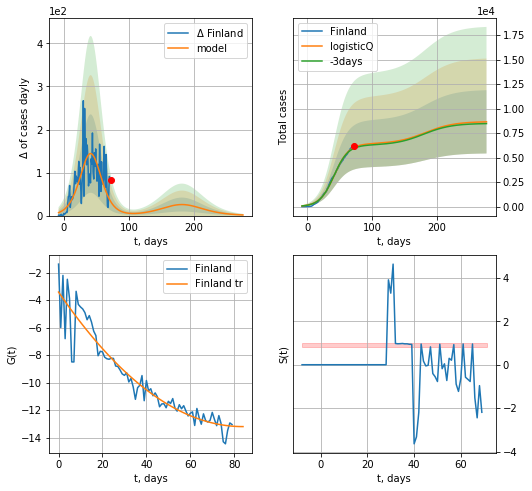

Finland data at: 2020-05-15
+3 day model MAPE: 0.015091
model: logisticQ
coeffs: [ 6.40878950e+03  8.42231342e-07  4.16856640e+01 -1.06706056e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373245
forecast at the end of period: +204 days
	 deltaDaycases: 1
	 total cases: 8647 ± 3227
	 total death: 406 ± 454
trend coefficient of determination: 0.900431
 intercept_: -3.419282840615864
 coeffs_: [ 0.         -0.23341533  0.00139219]


In [271]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

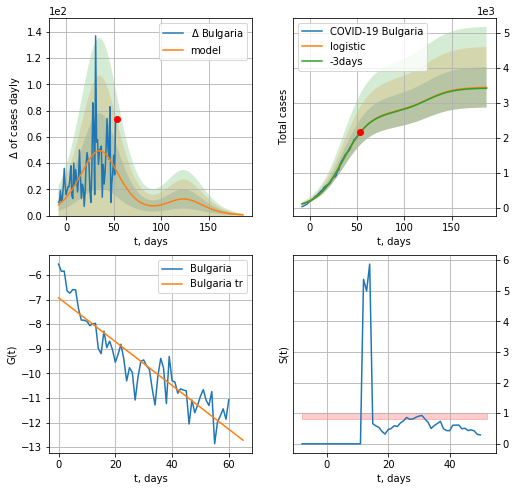

Bulgaria data at: 2020-05-15
+3 day model MAPE: 0.002817411528093183
model: logistic
coeffs:  [2.76460481e+03 7.14132149e-02 3.56033884e+01]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.16707996634626338
forecast at the end of period: +134 days
	 deltaDaycases:  0
	 total cases:  3447 ± 576
	 total death:  166 ± 83
trend coefficient of determination: 0.843060
 intercept: -6.929318
 slope: -0.089050


In [272]:
x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


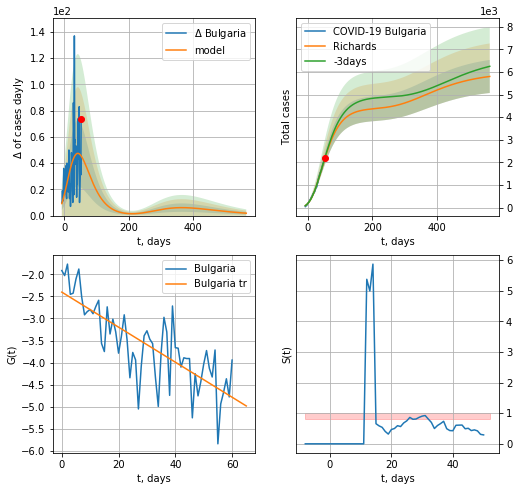

Bulgaria data at: 2020-05-15
+3 day model MAPE: 0.012656
model: Richards
coeffs: [ 4.39572787e+03  4.17141428e-01 -4.40366972e+01  7.28989867e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.126013
forecast at the end of period: +512 days
	 deltaDaycases: 1
	 total cases: 5801 ± 731
	 total death: 280 ± 105
trend coefficient of determination: 0.613009
 intercept: -2.403669
 slope: -0.039597


In [275]:
x = forecastRR('Bulgaria',dfBL[5:],d1,80*7-dT,shift=1.0,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


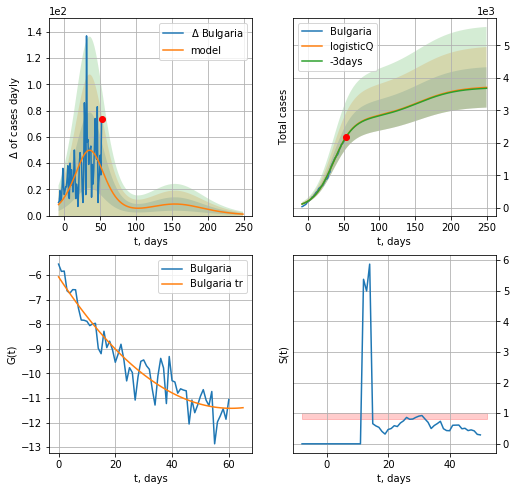

Bulgaria data at: 2020-05-15
+3 day model MAPE: 0.002824
model: logisticQ
coeffs: [ 2.75974600e+03  3.45759317e-06  3.55526469e+01 -2.06573624e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.167306
forecast at the end of period: +197 days
	 deltaDaycases: 1
	 total cases: 3706 ± 620
	 total death: 178 ± 89
trend coefficient of determination: 0.898151
 intercept_: -6.07772958626408
 coeffs_: [ 0.         -0.17567165  0.00144384]


In [276]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
          date   cases  active  death
74 2020-05-11  3017.0   163.0   56.0
75 2020-05-12  3017.1   163.0   56.0
76 2020-05-13  3017.2   117.0   56.0
77 2020-05-14  3018.0   112.0   56.0
78 2020-05-15  3025.0   114.0   56.0


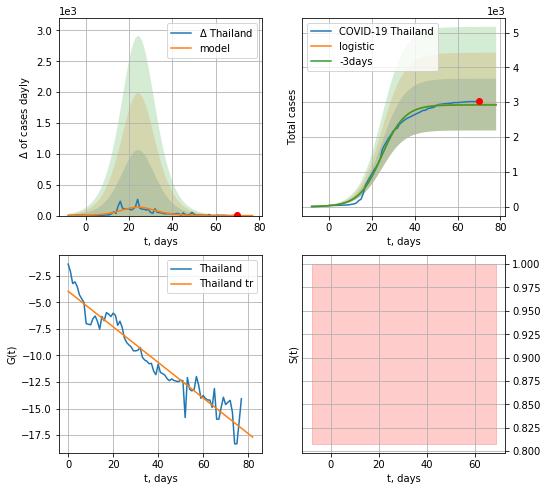

Thailand data at: 2020-05-15
+3 day model MAPE: 0.004146673652815704
model: logistic
coeffs:  [2.93282100e+03 1.86564510e-01 2.47485914e+01]
rational stdev:  0.2533984407238588
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  2932 ± 743
	 total death:  54 ± 41
trend coefficient of determination: 0.926576
 intercept: -3.946239
 slope: -0.167665


In [278]:
dfTH = read_df(pd.DataFrame(),"TH")
x = forecast("Thailand",dfTH[:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [297]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


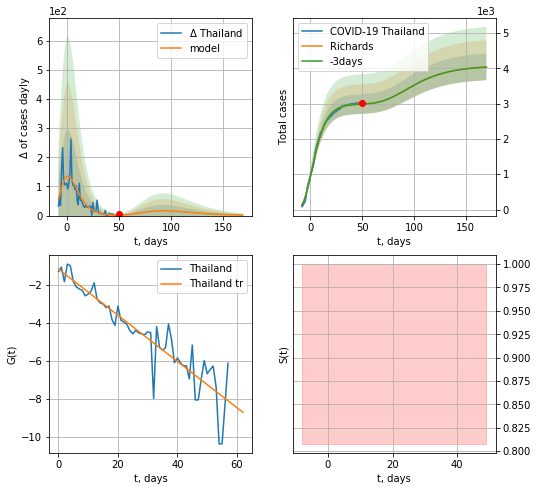

Thailand data at: 2020-05-15
+3 day model MAPE: 0.001847
model: Richards
coeffs: [ 2.99421096e+03  1.52547890e+01 -3.75832025e+01  8.08735798e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.093510
forecast at the end of period: +120 days
	 deltaDaycases: 1
	 total cases: 4038 ± 377
	 total death: 74 ± 20
trend coefficient of determination: 0.848098
 intercept: -1.169695
 slope: -0.121804


In [279]:
x = forecastRR("Thailand",dfTH[20:],d1,24*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


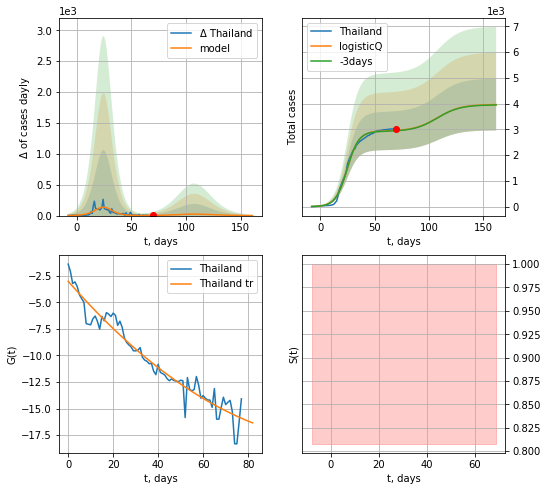

Thailand data at: 2020-05-15
+3 day model MAPE: 0.004219
model: logisticQ
coeffs: [ 2.93280580e+03  1.61023859e-06  2.47491468e+01 -1.15790503e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.253627
forecast at the end of period: +92 days
	 deltaDaycases: 0
	 total cases: 3965 ± 1005
	 total death: 73 ± 55
trend coefficient of determination: 0.939120
 intercept_: -3.0025500598386365
 coeffs_: [ 0.         -0.24217898  0.0009678 ]


In [280]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

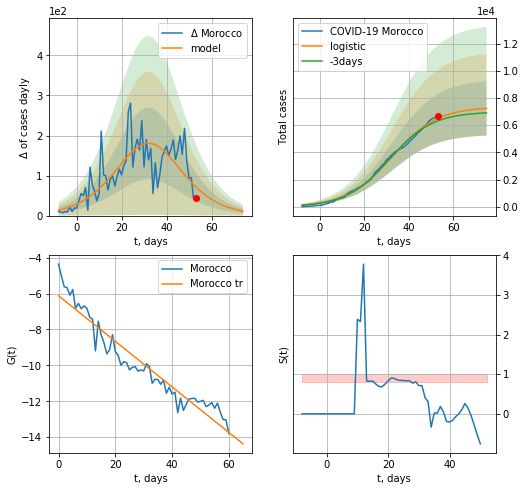

Morocco data at: 2020-05-15
+3 day model MAPE: 0.030035785099822906
model: logistic
coeffs:  [7.34500411e+03 9.83375874e-02 3.24643639e+01]
rational stdev:  0.27573614946088537
forecast at the end of period: +22 days
	 deltaDaycases:  11
	 total cases:  7234 ± 1994
	 total death:  206 ± 170
trend coefficient of determination: 0.919429
 intercept: -6.124866
 slope: -0.126869


In [281]:
x = forecast("Morocco",dfMR[5:],d1,10*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


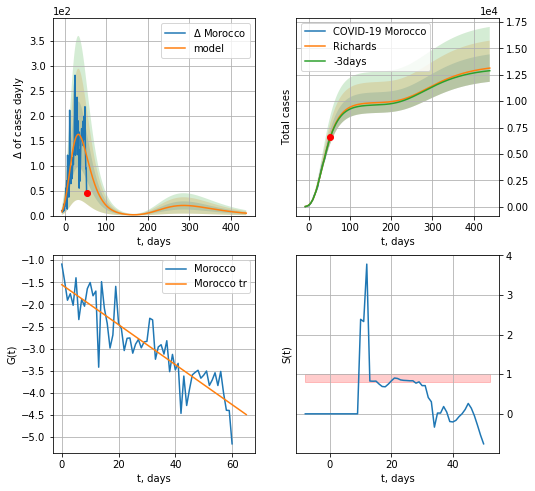

Morocco data at: 2020-05-15
+3 day model MAPE: 0.006646
model: Richards
coeffs: [ 9.88337684e+03  2.55821026e+00 -5.69578742e+01  1.76508112e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.098956
forecast at the end of period: +386 days
	 deltaDaycases: 4
	 total cases: 13136 ± 1299
	 total death: 375 ± 111
trend coefficient of determination: 0.794324
 intercept: -1.554139
 slope: -0.045178


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


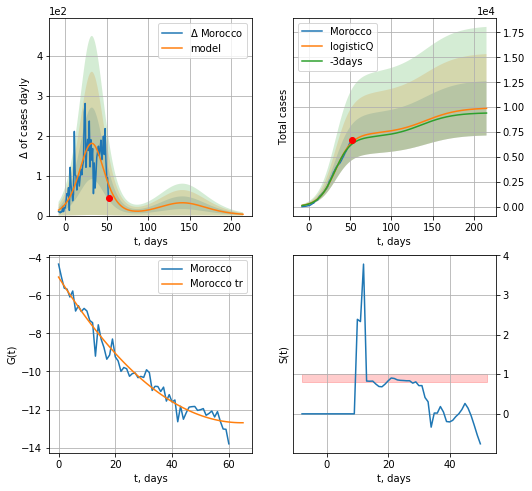

Morocco data at: 2020-05-15
+3 day model MAPE: 0.029755
model: logisticQ
coeffs: [ 7.34271592e+03  1.57810473e-06  3.24579824e+01 -6.22929700e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.275882
forecast at the end of period: +162 days
	 deltaDaycases: 3
	 total cases: 9876 ± 2724
	 total death: 282 ± 233
trend coefficient of determination: 0.967241
 intercept_: -5.042687764914236
 coeffs_: [ 0.         -0.23694704  0.00183484]


In [284]:
x = forecastRR("Morocco",dfMR[5:],d1,62*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

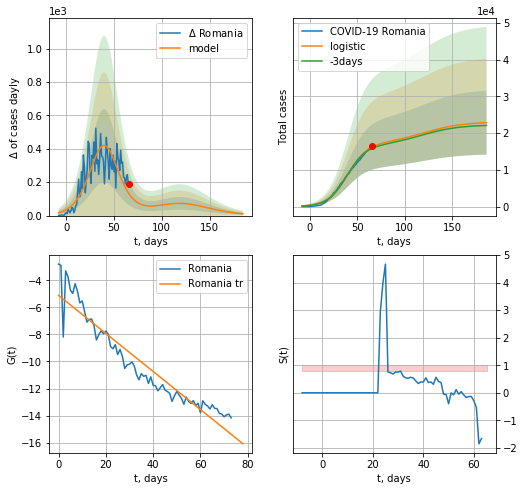

Romania data at: 2020-05-15
+3 day model MAPE: 0.023212190800556975
model: logistic
coeffs:  [1.70854734e+04 9.69999492e-02 3.99571992e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.38044286113903025
forecast at the end of period: +120 days
	 deltaDaycases:  11
	 total cases:  22832 ± 8686
	 total death:  1486 ± 1696
trend coefficient of determination: 0.902257
 intercept: -5.111674
 slope: -0.140694


In [285]:
#dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


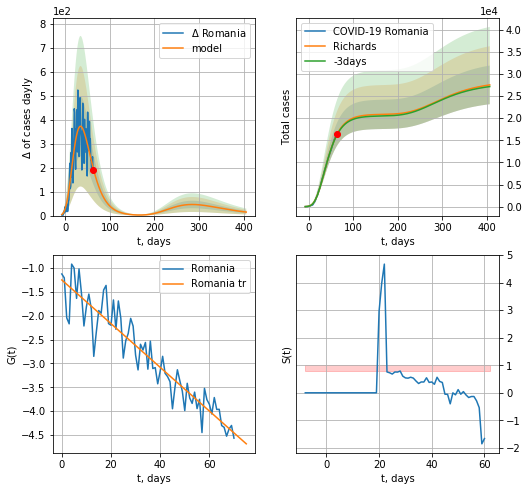

Romania data at: 2020-05-15
+3 day model MAPE: 0.006924
model: Richards
coeffs: [ 2.08996802e+04  4.43934423e+00 -5.81968181e+01  1.09654256e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.158748
forecast at the end of period: +344 days
	 deltaDaycases: 14
	 total cases: 27537 ± 4371
	 total death: 1792 ± 853
trend coefficient of determination: 0.883360
 intercept: -1.251229
 slope: -0.045787


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


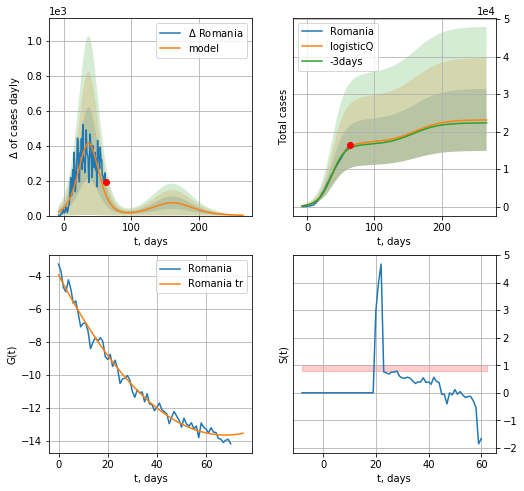

Romania data at: 2020-05-15
+3 day model MAPE: 0.023870
model: logisticQ
coeffs: [ 1.70954835e+04  9.34628820e-07  3.69737700e+01 -1.03596345e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357486
forecast at the end of period: +204 days
	 deltaDaycases: 1
	 total cases: 23115 ± 8263
	 total death: 1504 ± 1612
trend coefficient of determination: 0.985484
 intercept_: -3.954626790986386
 coeffs_: [ 0.         -0.28541699  0.00210323]


In [287]:
x = forecastRR("Romania",dfRM[8:],d1,56*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [308]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
          date    cases  active     death
93 2020-05-11  1106752  408459  116455.0
94 2020-05-12  1113500  404055  117488.0
95 2020-05-13  1119023  395957  118475.0
96 2020-05-14  1126200  353415  119609.0
97 2020-05-15  1132763  346991  120486.0


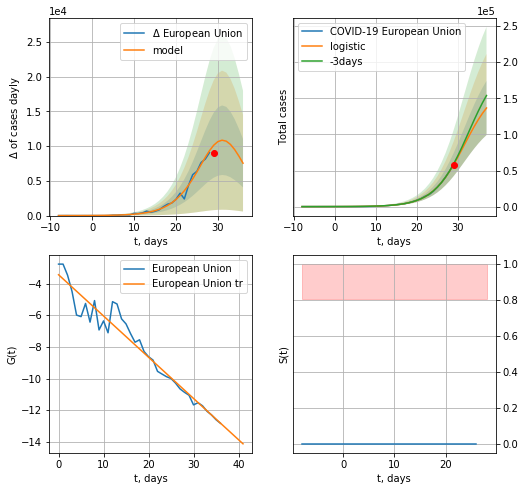

European Union data at: 2020-05-15
+3 day model MAPE: 0.026654473576493115
model: logistic
coeffs:  [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.2741183518342743
forecast at the end of period: +8 days
	 deltaDaycases:  7546
	 total cases:  136586 ± 37440
	 total death:  14527 ± 11946
trend coefficient of determination: 0.946316
 intercept: -3.442935
 slope: -0.260531


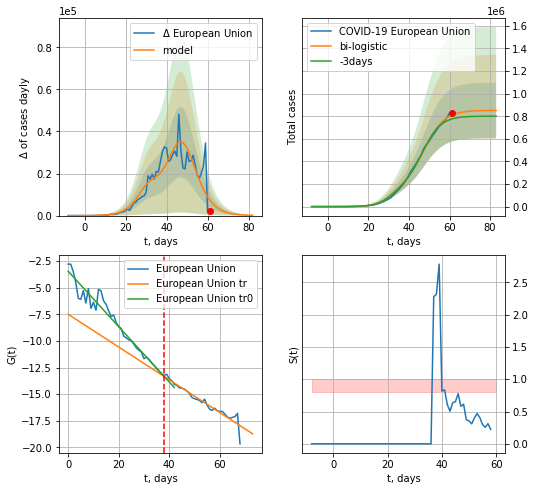

European Union data at: 2020-05-15
+3 day model MAPE: 0.04651829112234155
model: bi-logistic
coeffs:  [6.80547246e+05 2.01837730e-01 4.76694046e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01]
rational stdev:  0.28952183224371997
forecast at the end of period: +22 days
	 deltaDaycases:  121
	 total cases:  851209 ± 246443
	 total death:  90538 ± 78638
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend coefficient of determination: 0.919561
 intercept: -7.491452
 slope: -0.154009


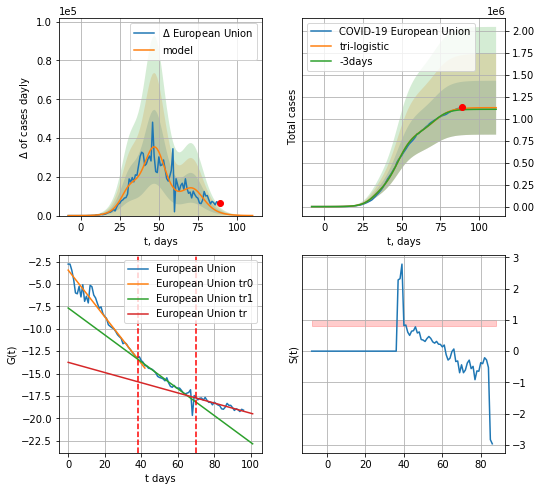

European Union data at: 2020-05-15
+3 day model MAPE: 0.013198844680062376
model: tri-logistic
coeffs:  [2.73561090e+05 1.93557753e-01 7.19012355e+01] [1.71206811e+05 2.54019570e-01 3.15968250e+01 6.80547246e+05
 2.01837730e-01 4.76694046e+01]
forecast rational stdev:  0.2722639805424069
forecast at the end of period: +22 days
	 deltaDaycases:  30
	 total cases:  1125171 ± 306343
	 total death:  119678 ± 97752
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.950267
 intercept: -3.442010
 slope: -0.260608
trend1 coefficient of determination: 0.917498
 intercept: -7.673048
 slope: -0.150226
trend coefficient of determination: 0.841933
 intercept: -13.744562
 slope: -0.056875


In [288]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,8*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,10*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,10*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


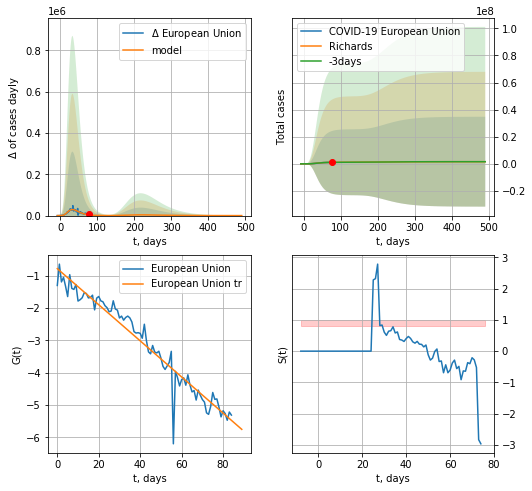

European Union data at: 2020-05-15
+3 day model MAPE: 0.005037
model: Richards
coeffs: [ 1.17099705e+06  5.87473066e+00 -3.16182330e+01  1.16830869e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 20.798969
forecast at the end of period: +414 days
	 deltaDaycases: 16
	 total cases: 1594695 ± 33168030
	 total death: 169619 ± 10583701
trend coefficient of determination: 0.939330
 intercept: -0.777581
 slope: -0.055926


In [291]:
x = forecastRR("European Union",dfEU[12:],d1,66*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


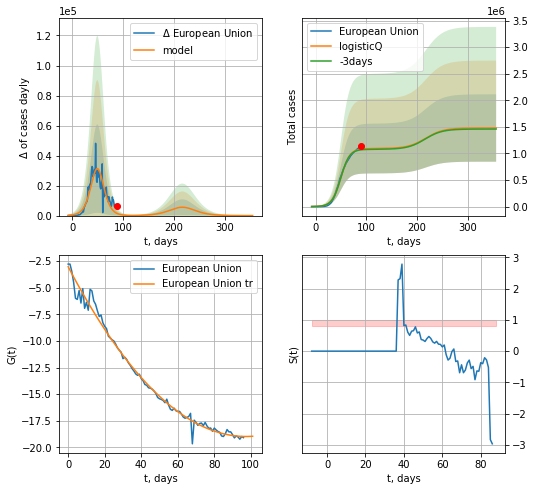

European Union data at: 2020-05-15
+3 day model MAPE: 0.012361
model: logisticQ
coeffs: [ 1.09284001e+06  6.77848514e-07  4.97881511e+01 -1.69090361e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.428561
forecast at the end of period: +267 days
	 deltaDaycases: 7
	 total cases: 1479763 ± 634168
	 total death: 157394 ± 202358
trend coefficient of determination: 0.988651
 intercept_: -3.0188540234193297
 coeffs_: [ 0.         -0.32793299  0.00168393]


In [293]:
x = forecastRRR("European Union",dfEU[:],d1,45*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


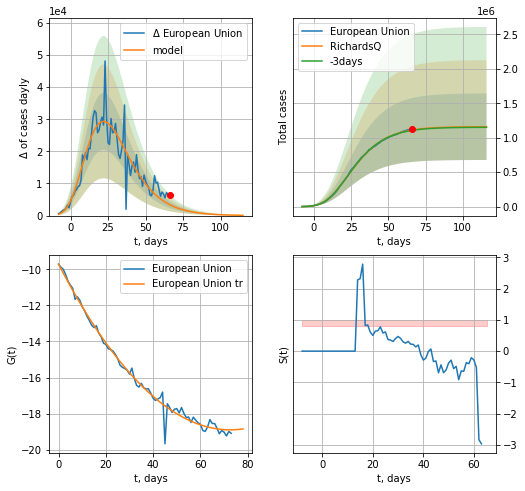

European Union data at: 2020-05-15
+3 day model MAPE: 0.005521
model: RichardsQ
coeffs: [ 1.16109590e+06  2.70148258e-02 -7.42913527e+01 -9.26100658e+02
  2.43775192e-03]
S.Korea scenario coeffs: [ 3.69179628e-01  4.55901153e+01  3.02600169e-01 -6.49668395e+01
  2.33503320e-03]
rational stdev: 0.416187
forecast at the end of period: +50 days
	 deltaDaycases: 85
	 total cases: 1160081 ± 482810
	 total death: 123391 ± 154061
trend coefficient of determination: 0.987638
 intercept_: -9.714188897500152
 coeffs_: [ 0.         -0.25297793  0.00174207]


In [294]:
x = forecastQR("European Union",dfEU[23:],d1,14*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [313]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [314]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [315]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [316]:
#dfIC[:]

IC
          date    cases  active  death
71 2020-05-11  1801.50      18   10.0
72 2020-05-12  1801.55      15   10.0
73 2020-05-13  1802.00      12   10.0
74 2020-05-14  1802.10      12   10.0
75 2020-05-15  1802.20      10   10.0


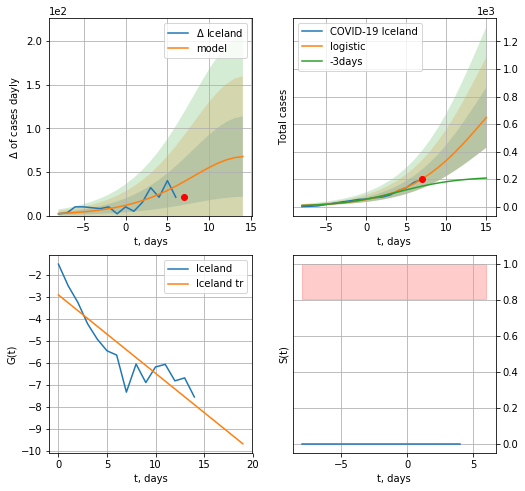

Iceland data at: 2020-05-15
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +8 days
	 deltaDaycases:  67
	 total cases:  648 ± 219
	 total death:  3 ± 3
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


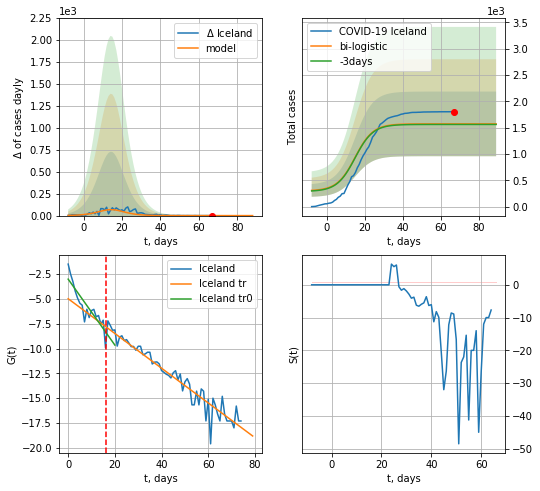

Iceland data at: 2020-05-15
+3 day model MAPE: 0.006950542257468272
model: bi-logistic
coeffs:  [281.77707058  -3.28006233 105.36602627] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.3905080207648268
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  1571 ± 613
	 total death:  8 ± 9
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.917729
 intercept: -4.988826
 slope: -0.174889


In [296]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
x = forecast("Iceland",dfIC[:vL],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
xx = forecast2("Iceland",dfIC[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


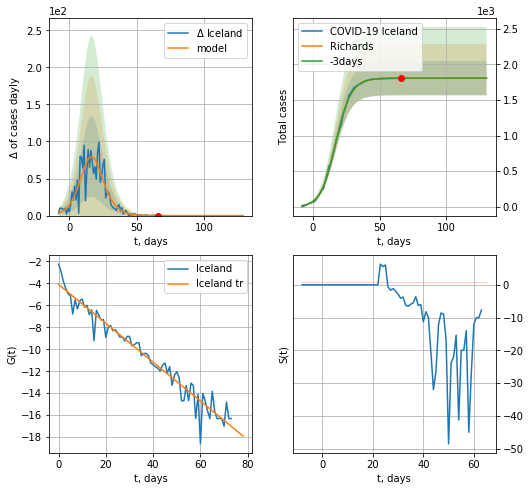

Iceland data at: 2020-05-15
+3 day model MAPE: 0.000182
model: Richards
coeffs: [1.80490799e+03 1.94845270e-01 1.61230983e+01 8.68214196e-01]
rational stdev: 0.132808
forecast at the end of period: +64 days
	 deltaDaycases: 0
	 total cases: 1804 ± 239
	 total death: 10 ± 3
trend coefficient of determination: 0.948198
 intercept: -4.100153
 slope: -0.176845


In [297]:
x = forecastRR("Iceland",dfIC[1:],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


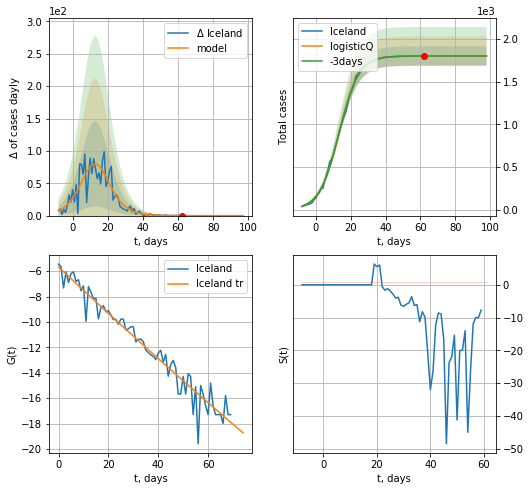

Iceland data at: 2020-05-15
+3 day model MAPE: 0.000028
model: logisticQ
coeffs: [ 1.80203597e+03  9.28725970e-06  1.33200210e+01 -1.90764262e+04]
rational stdev: 0.063118
forecast at the end of period: +36 days
	 deltaDaycases: 0
	 total cases: 1802 ± 113
	 total death: 10 ± 1
trend coefficient of determination: 0.947178
 intercept_: -5.660830531134202
 coeffs_: [ 0.00000000e+00 -1.85092056e-01  1.14730346e-04]


In [298]:
x = forecastRRR("Iceland",dfIC[5:],d1,12*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


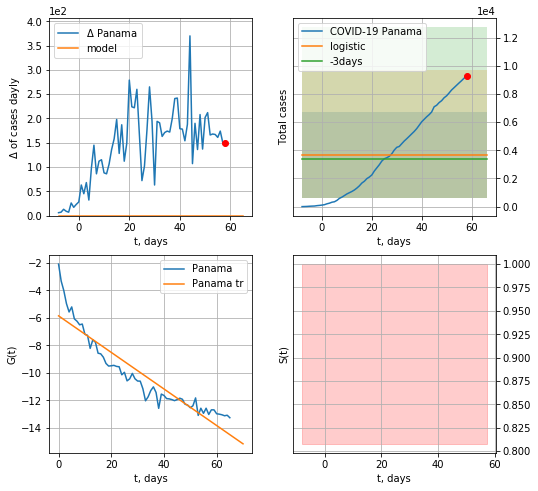

Panama data at: 2020-05-15
+3 day model MAPE: 0.07461539371087465
model: logistic
coeffs:  [ 3.67150746e+03 -2.54161252e+00  9.01769160e+01]
rational stdev:  0.8252072947000555
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  3671 ± 3029
	 total death:  105 ± 259
trend coefficient of determination: 0.864521
 intercept: -5.856968
 slope: -0.132806


In [299]:
#dfPM = read_df(pd.DataFrame(),"PM")
x = forecast("Panama",dfPM[:],d1,8*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


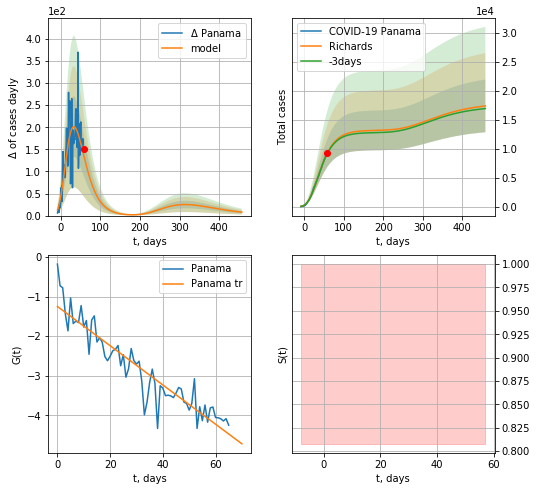

Panama data at: 2020-05-15
+3 day model MAPE: 0.009667
model: Richards
coeffs: [ 1.31702063e+04  3.02176289e+00 -6.83582246e+01  1.38462863e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.261607
forecast at the end of period: +400 days
	 deltaDaycases: 7
	 total cases: 17368 ± 4543
	 total death: 498 ± 390
trend coefficient of determination: 0.864106
 intercept: -1.251290
 slope: -0.049554


In [300]:
x = forecastRR("Panama",dfPM[:],d1,64*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


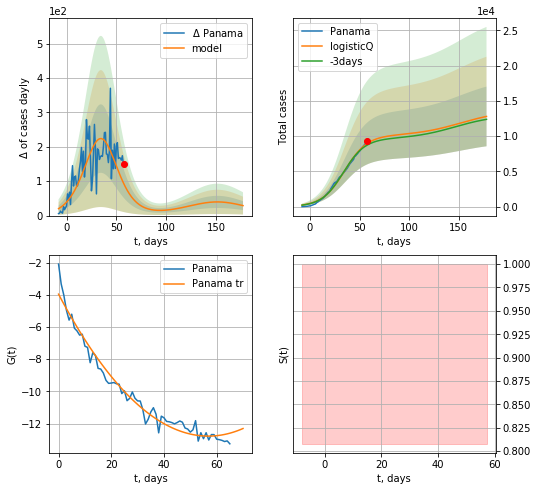

Panama data at: 2020-05-15
+3 day model MAPE: 0.027140
model: logisticQ
coeffs: [ 1.00700028e+04  1.05717510e-06  3.48090720e+01 -8.37625473e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.330932
forecast at the end of period: +120 days
	 deltaDaycases: 29
	 total cases: 12792 ± 4233
	 total death: 367 ± 364
trend coefficient of determination: 0.970501
 intercept_: -3.966685882222169
 coeffs_: [ 0.         -0.31004646  0.00272698]


In [301]:
x = forecastRRR("Panama",dfPM[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

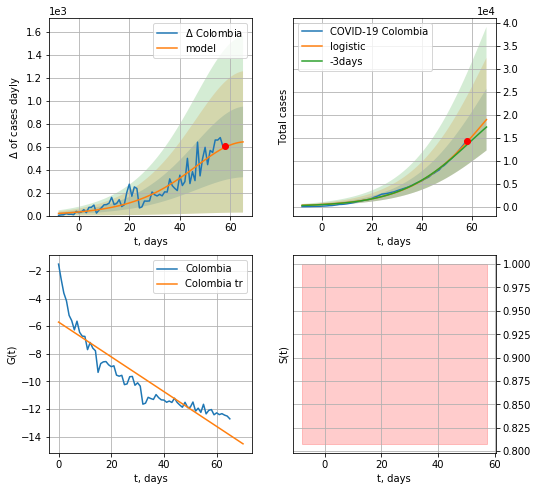

Colombia data at: 2020-05-15
+3 day model MAPE: 0.048443194314643806
model: logistic
coeffs:  [3.90917821e+04 6.58624907e-02 6.69339055e+01]
rational stdev:  0.35487115723096196
forecast at the end of period: +8 days
	 deltaDaycases:  642
	 total cases:  18944 ± 6723
	 total death:  727 ± 773
trend coefficient of determination: 0.826520
 intercept: -5.704278
 slope: -0.126014


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


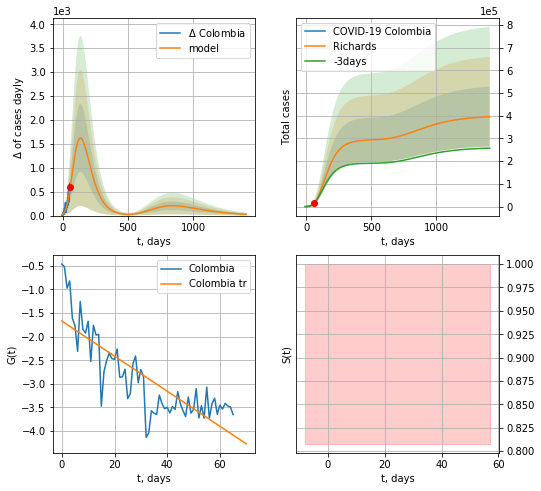

Colombia data at: 2020-05-15
+3 day model MAPE: 0.032412
model: Richards
coeffs: [ 2.94363696e+05  2.96768043e-01 -5.66699593e+01  5.18228003e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.332584
forecast at the end of period: +1352 days
	 deltaDaycases: 27
	 total cases: 395758 ± 131622
	 total death: 15200 ± 15165
trend coefficient of determination: 0.667409
 intercept: -1.668553
 slope: -0.037164


In [302]:
x = forecast("Colombia",dfCB[:],d1,8*7-dT)
x = forecastRR("Colombia",dfCB[:],d1,200*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


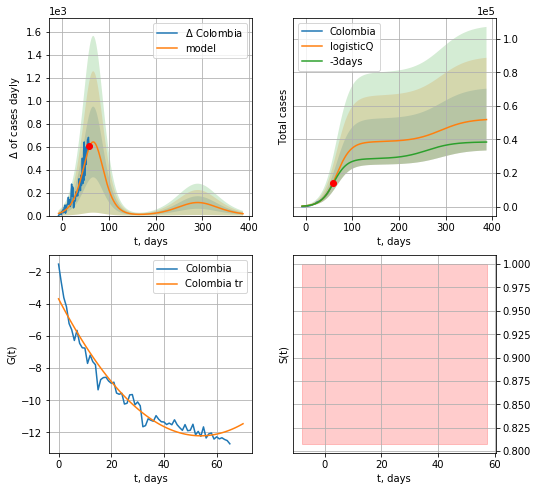

Colombia data at: 2020-05-15
+3 day model MAPE: 0.048499
model: logisticQ
coeffs: [ 3.86410371e+04  4.52289162e-06  6.66145783e+01 -1.45813913e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.354961
forecast at the end of period: +330 days
	 deltaDaycases: 16
	 total cases: 51813 ± 18391
	 total death: 1990 ± 2119
trend coefficient of determination: 0.956732
 intercept_: -3.6708346416477573
 coeffs_: [ 0.         -0.31667665  0.00293347]


In [303]:
x = forecastRRR("Colombia",dfCB[:],d1,54*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
          date   cases  active  death
68 2020-05-11  5891.0  2543.0  507.0
69 2020-05-12  6067.0  2554.0  515.0
70 2020-05-13  6253.0  2673.0  522.0
71 2020-05-14  6442.0  2755.0  529.0
72 2020-05-15  6629.0  2822.0  536.0


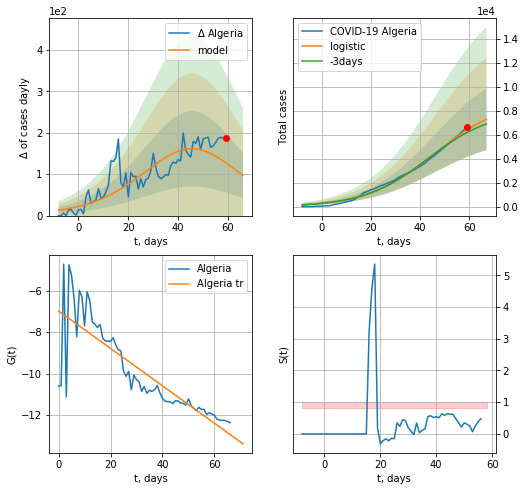

Algeria data at: 2020-05-15
+3 day model MAPE: 0.03835154609706639
model: logistic
coeffs:  [8.89853058e+03 7.25517487e-02 4.59537114e+01]
rational stdev:  0.3513176694162237
forecast at the end of period: +8 days
	 deltaDaycases:  96
	 total cases:  7310 ± 2568
	 total death:  591 ± 622
trend coefficient of determination: 0.706821
 intercept: -6.983718
 slope: -0.090117


In [304]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,8*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


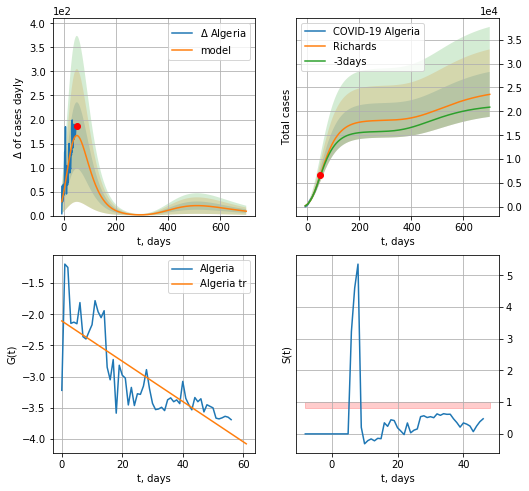

Algeria data at: 2020-05-15
+3 day model MAPE: 0.018565
model: Richards
coeffs: [ 1.81593315e+04  1.80705777e+00 -1.19805060e+02  1.39109667e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.199479
forecast at the end of period: +652 days
	 deltaDaycases: 9
	 total cases: 23566 ± 4701
	 total death: 1905 ± 1140
trend coefficient of determination: 0.660111
 intercept: -2.107893
 slope: -0.032294


In [305]:
x = forecastRR("Algeria",dfAR[15:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


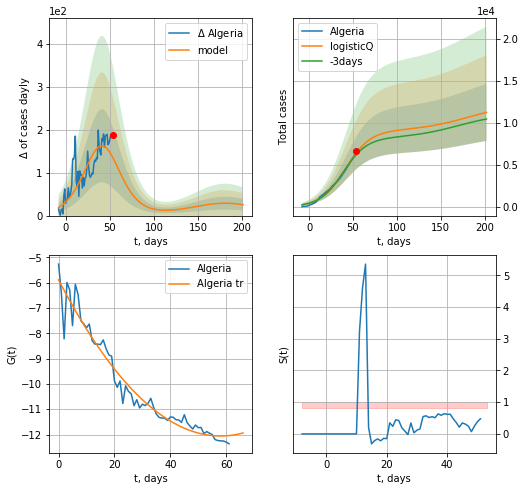

Algeria data at: 2020-05-15
+3 day model MAPE: 0.035257
model: logisticQ
coeffs: [ 9.07964583e+03  1.40348923e-06  4.15751535e+01 -5.07185929e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.301333
forecast at the end of period: +148 days
	 deltaDaycases: 25
	 total cases: 11259 ± 3392
	 total death: 910 ± 822
trend coefficient of determination: 0.950851
 intercept_: -5.891280000546745
 coeffs_: [ 0.         -0.21282145  0.00183612]


In [306]:
x = forecastRRR("Algeria",dfAR[10:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

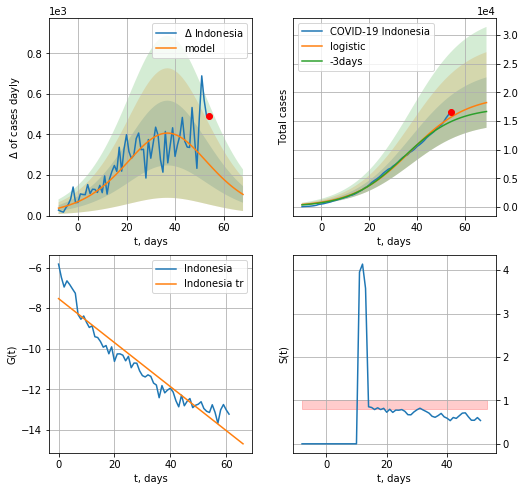

Indonesia data at: 2020-05-15
+3 day model MAPE: 0.05501283983144105
model: logistic
coeffs:  [1.94870315e+04 8.35551547e-02 3.73285258e+01]
rational stdev:  0.24163682958512722
forecast at the end of period: +15 days
	 deltaDaycases:  104
	 total cases:  18196 ± 4396
	 total death:  1186 ± 859
trend coefficient of determination: 0.913481
 intercept: -7.532507
 slope: -0.108437


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


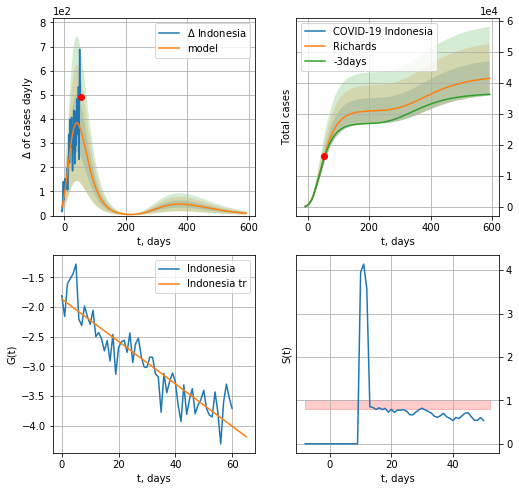

Indonesia data at: 2020-05-15
+3 day model MAPE: 0.029984
model: Richards
coeffs: [ 3.11052243e+04  1.74220082e+00 -7.49351991e+01  1.94565382e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.133472
forecast at the end of period: +540 days
	 deltaDaycases: 9
	 total cases: 41499 ± 5539
	 total death: 2706 ± 1083
trend coefficient of determination: 0.831097
 intercept: -1.866681
 slope: -0.035608


In [307]:
x = forecast("Indonesia",dfIE[5:],d1,9*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,84*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


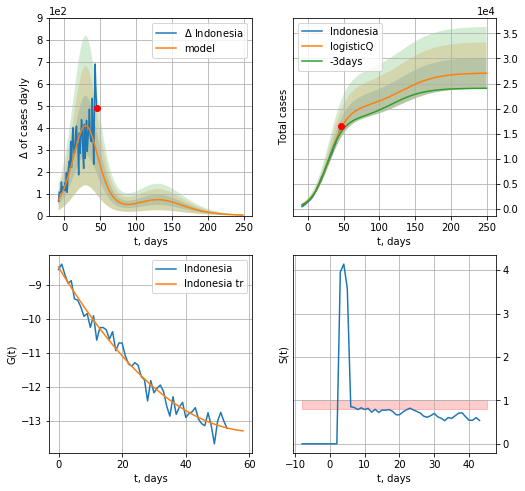

Indonesia data at: 2020-05-15
+3 day model MAPE: 0.049210
model: logisticQ
coeffs: [ 2.00205858e+04  3.50279435e-06  3.00980905e+01 -2.30495868e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.113382
forecast at the end of period: +204 days
	 deltaDaycases: 2
	 total cases: 27055 ± 3067
	 total death: 1764 ± 600
trend coefficient of determination: 0.975091
 intercept_: -8.477936241887711
 coeffs_: [ 0.         -0.1555282   0.00124866]


In [308]:
x = forecastRRR("Indonesia",dfIE[13:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


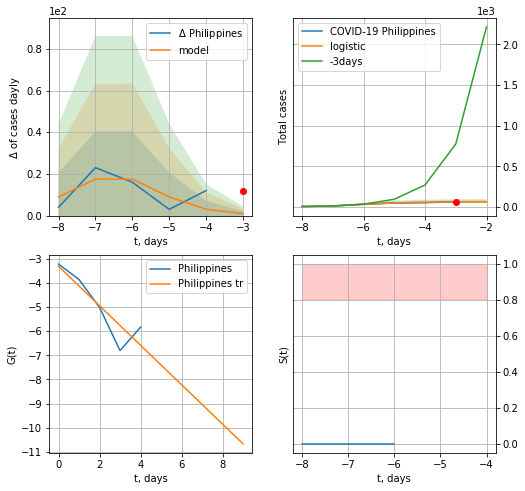

Philippines data at: 2020-05-15
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  4 ± 2
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


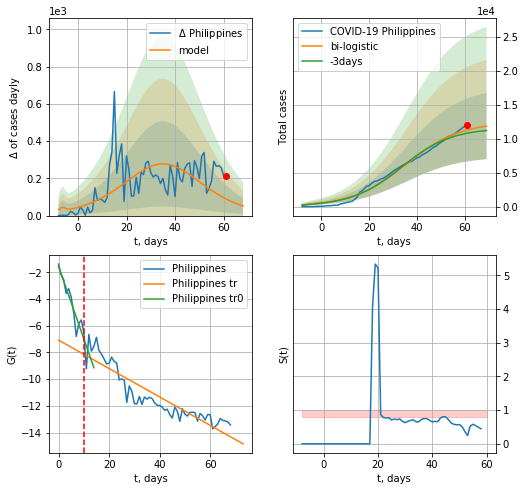

Philippines data at: 2020-05-15
+3 day model MAPE: 0.046719083616661355
model: bi-logistic
coeffs:  [1.23863904e+04 8.96365738e-02 3.54930264e+01] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.4108847030942466
forecast at the end of period: +8 days
	 deltaDaycases:  52
	 total cases:  11862 ± 4874
	 total death:  790 ± 973
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.829666
 intercept: -7.078677
 slope: -0.106382


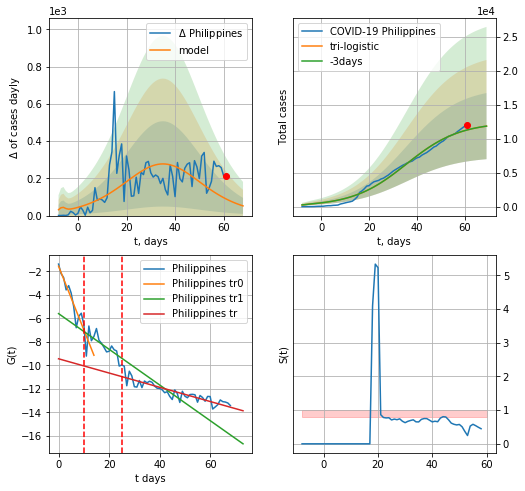

Philippines data at: 2020-05-15
+3 day model MAPE: 3.729078114034094e-10
model: tri-logistic
coeffs:  [47.84083355  1.50162274 74.6297668 ] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  1.23863904e+04
  8.96365738e-02  3.54930264e+01]
forecast rational stdev:  0.4108847030941703
forecast at the end of period: +8 days
	 deltaDaycases:  52
	 total cases:  11862 ± 4874
	 total death:  790 ± 973
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.784385
 intercept: -9.446649
 slope: -0.060626


In [309]:
vL=10
vL1=25
x = forecast("Philippines",dfPH[4:vL],d1,7*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,8*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


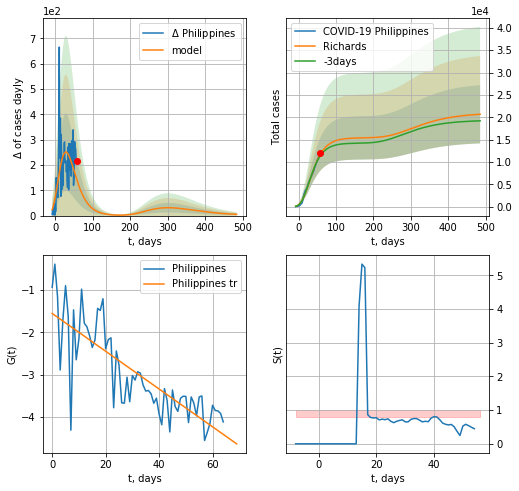

Philippines data at: 2020-05-15
+3 day model MAPE: 0.030245
model: Richards
coeffs: [ 1.54124715e+04  5.12428384e+00 -7.76749823e+01  8.68707342e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.315197
forecast at the end of period: +428 days
	 deltaDaycases: 4
	 total cases: 20666 ± 6513
	 total death: 1377 ± 1302
trend coefficient of determination: 0.654782
 intercept: -1.554276
 slope: -0.044530


In [310]:
x = forecastRR("Philippines",dfPH[4:],d1,68*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


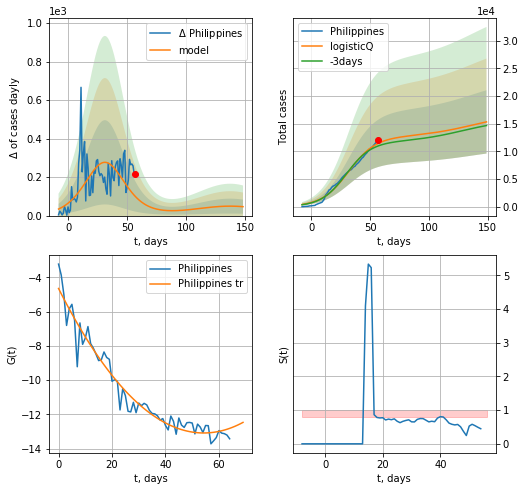

Philippines data at: 2020-05-15
+3 day model MAPE: 0.044220
model: logisticQ
coeffs: [ 1.25591067e+04  7.82557782e-07  3.16021019e+01 -1.11860313e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373535
forecast at the end of period: +92 days
	 deltaDaycases: 46
	 total cases: 15323 ± 5723
	 total death: 1021 ± 1144
trend coefficient of determination: 0.947720
 intercept_: -4.643789588268408
 coeffs_: [ 0.         -0.31109602  0.00286455]


In [311]:
x = forecastRRR("Philippines",dfPH[4:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
          date  cases  active  death
72 2020-05-11   2726    1201  151.0
73 2020-05-12   2744    1218  152.0
74 2020-05-13   2760    1231  155.0
75 2020-05-14   2770    1240  156.0
76 2020-05-15   2810    1276  160.0


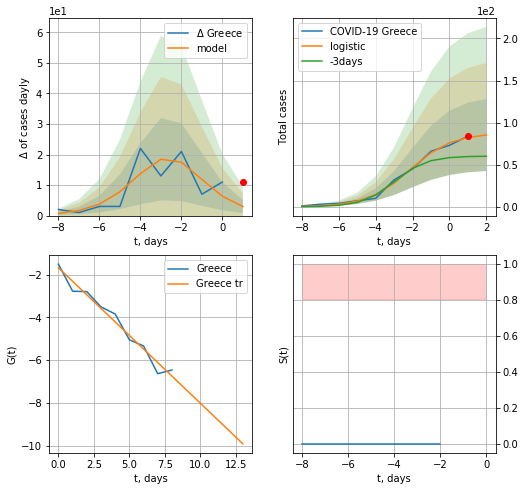

Greece data at: 2020-05-15
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +1 days
	 deltaDaycases:  2
	 total cases:  85 ± 42
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


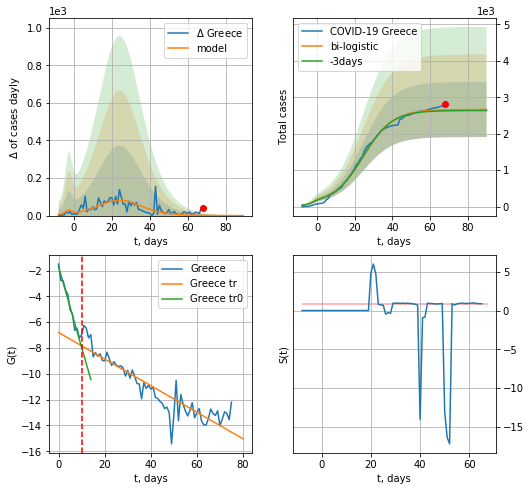

Greece data at: 2020-05-15
+3 day model MAPE: 0.009991652436622443
model: bi-logistic
coeffs:  [2.57877287e+03 1.26693278e-01 2.45399553e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.28356296516163126
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  2665 ± 755
	 total death:  151 ± 128
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.828172
 intercept: -6.798628
 slope: -0.102989


In [313]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,7*7-dT)
xx = forecast2("Greece",dfGC[:],d1,10*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


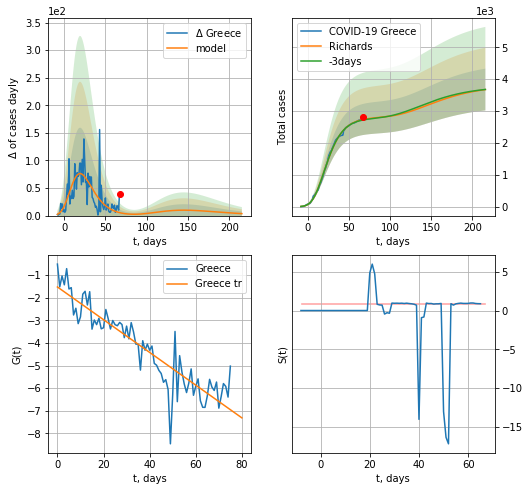

Greece data at: 2020-05-15
+3 day model MAPE: 0.006088
model: Richards
coeffs: [ 2.80359818e+03  7.94904049e-01 -1.02232204e+01  9.74423217e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.178327
forecast at the end of period: +148 days
	 deltaDaycases: 3
	 total cases: 3674 ± 655
	 total death: 209 ± 111
trend coefficient of determination: 0.820982
 intercept: -1.523237
 slope: -0.072416


In [314]:
x = forecastRR("Greece",dfGC[:],d1,28*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


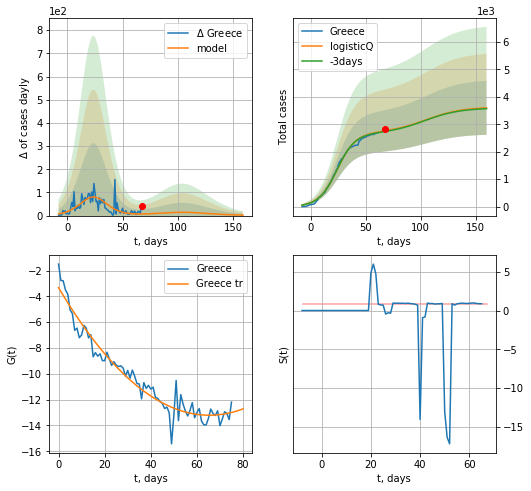

Greece data at: 2020-05-15
+3 day model MAPE: 0.008560
model: logisticQ
coeffs: [ 2.68029820e+03  7.70875143e-07  2.39552774e+01 -1.54980097e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.272956
forecast at the end of period: +92 days
	 deltaDaycases: 1
	 total cases: 3597 ± 981
	 total death: 204 ± 167
trend coefficient of determination: 0.942556
 intercept_: -3.3231352700160066
 coeffs_: [ 0.         -0.30239187  0.00231212]


In [315]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
          date  cases  active  death
66 2020-05-11   3313    1881  425.0
67 2020-05-12   3341    1809  430.0
68 2020-05-13   3380    1775  436.0
69 2020-05-14   3417    1688  442.0
70 2020-05-15   3473    1654  448.0


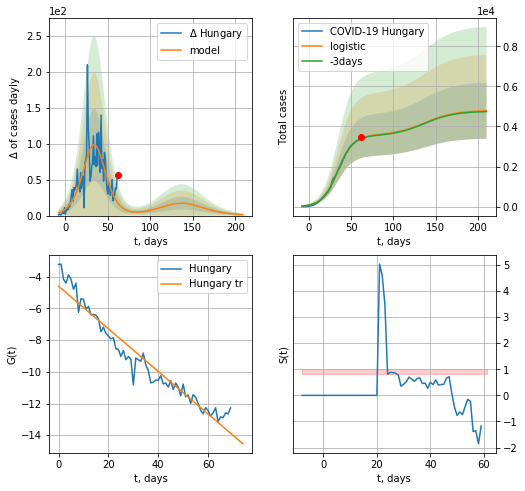

Hungary data at: 2020-05-15
+3 day model MAPE: 0.006847731819790036
model: logistic
coeffs:  [3.55901198e+03 1.10582395e-01 3.42769734e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.2916006250620991
forecast at the end of period: +148 days
	 deltaDaycases:  1
	 total cases:  4782 ± 1394
	 total death:  616 ± 538
trend coefficient of determination: 0.940398
 intercept: -4.596390
 slope: -0.134440


In [316]:
dfHG = read_df(pd.DataFrame(),"HG")
x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


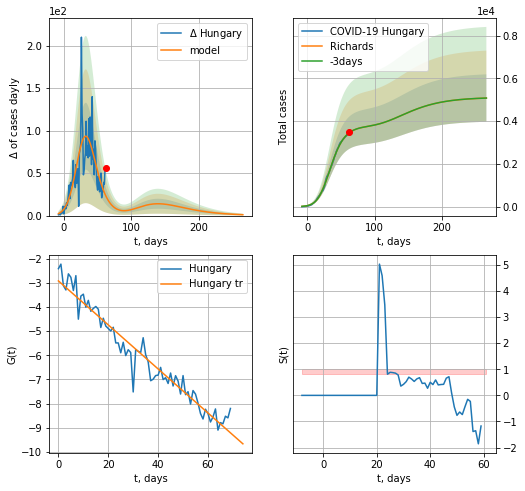

Hungary data at: 2020-05-15
+3 day model MAPE: 0.000192
model: Richards
coeffs: [3.75745381e+03 1.67976886e-01 2.46283350e+01 4.99597985e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.218410
forecast at the end of period: +204 days
	 deltaDaycases: 1
	 total cases: 5082 ± 1110
	 total death: 655 ± 429
trend coefficient of determination: 0.944272
 intercept: -2.920018
 slope: -0.091142


In [317]:
x = forecastRR("Hungary",dfHG[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


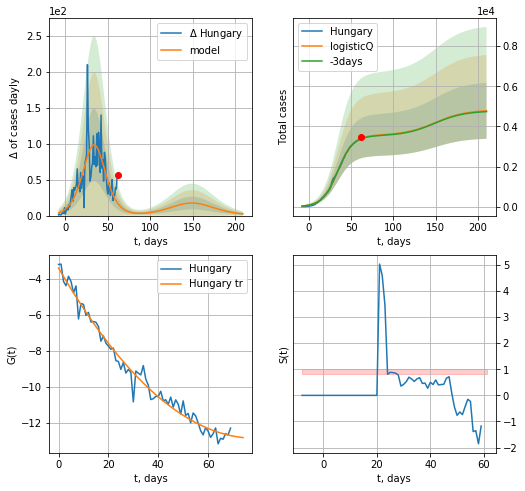

Hungary data at: 2020-05-15
+3 day model MAPE: 0.006901
model: logisticQ
coeffs: [ 3.55831691e+03  2.27258405e-06  3.42741205e+01 -4.86292938e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.291831
forecast at the end of period: +148 days
	 deltaDaycases: 2
	 total cases: 4776 ± 1393
	 total death: 616 ± 539
trend coefficient of determination: 0.979215
 intercept_: -3.415782975974273
 coeffs_: [ 0.         -0.23862819  0.0015101 ]


In [318]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


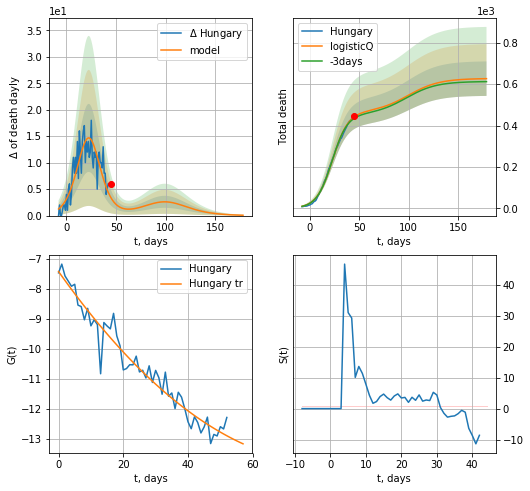

Hungary data at: 2020-05-15
+3 day model MAPE: 0.016378
model: logisticQ
coeffs: [ 4.63551819e+02  1.06315924e-05  2.28371158e+01 -1.18317645e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.133121
forecast at the end of period: +134 days
	 total death: 626 ± 83
trend coefficient of determination: 0.945881
 intercept_: -7.424545147581979
 coeffs_: [ 0.         -0.1519481   0.00090134]


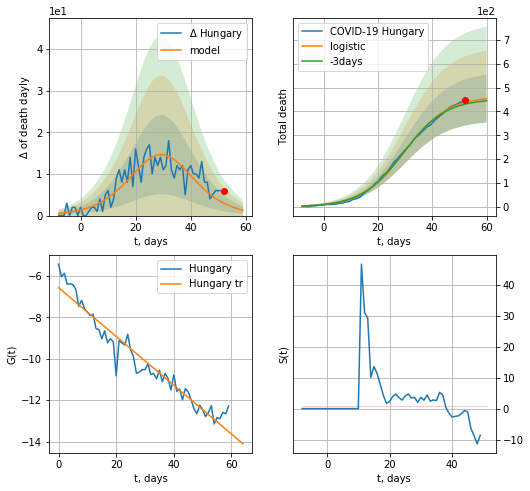

Hungary data at: 2020-05-15
+3 day model MAPE: 0.01679670915911443
model: logistic
coeffs:  [4.63279497e+02 1.26420035e-01 2.98202873e+01]
rational stdev:  0.22111390594800254
forecast at the end of period: +8 days
	 total death:  453 ± 100
trend coefficient of determination: 0.937777
 intercept: -6.565256
 slope: -0.117903


In [319]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,8*7-dT,cases='death')

MT
          date  cases  active  death
64 2020-05-11  503.0      64    5.0
65 2020-05-12  506.0      67    5.0
66 2020-05-13  508.0      66    6.0
67 2020-05-14  522.0      73    6.0
68 2020-05-15  532.0      68    6.0


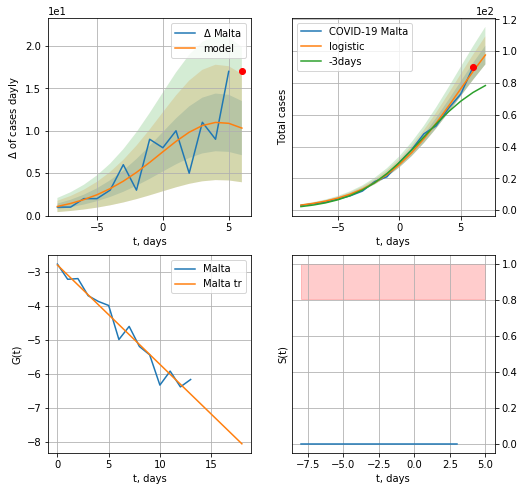

Malta data at: 2020-05-15
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +1 days
	 deltaDaycases:  10
	 total cases:  97 ± 5
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


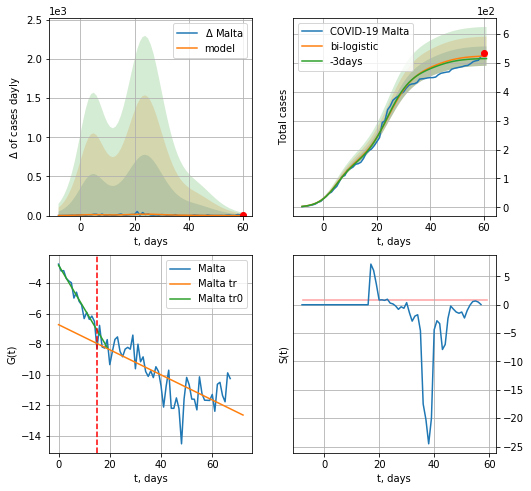

Malta data at: 2020-05-15
+3 day model MAPE: 0.016814867253991297
model: bi-logistic
coeffs:  [3.34109008e+02 2.10196678e-01 2.43237013e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.06414538820819884
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  522 ± 33
	 total death:  5 ± 0
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.580857
 intercept: -6.728529
 slope: -0.082004


In [320]:
dfMT = read_df(pd.DataFrame(),"MT")
x = forecast("Malta",dfMT[:15],d1,7*7-dT,pMAPE=False)
xx = forecast2("Malta",dfMT[:],d1,7*7-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


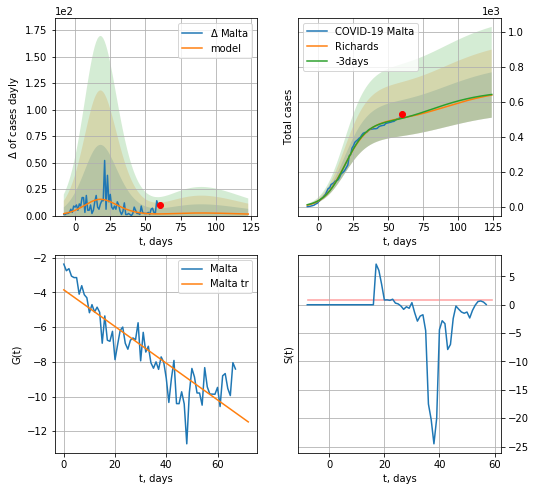

Malta data at: 2020-05-15
+3 day model MAPE: 0.001375
model: Richards
coeffs: [5.02984020e+02 1.56970784e-01 1.54393751e+01 7.07595227e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.202454
forecast at the end of period: +64 days
	 deltaDaycases: 1
	 total cases: 640 ± 129
	 total death: 7 ± 4
trend coefficient of determination: 0.775963
 intercept: -3.850981
 slope: -0.105738


In [321]:
x = forecastRR("Malta",dfMT[:],d1,16*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


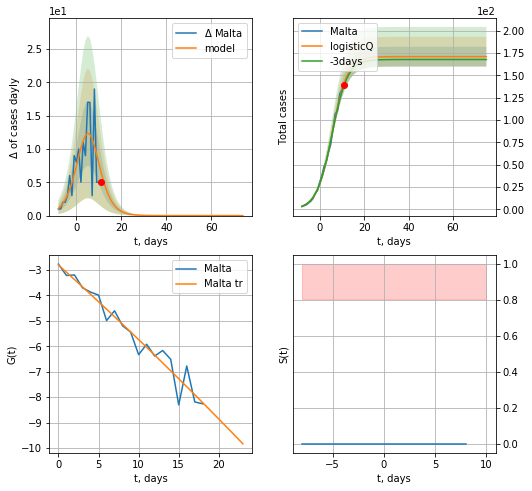

Malta data at: 2020-05-15
+3 day model MAPE: 0.017372
model: logisticQ
coeffs: [ 1.70905491e+02  1.60191203e-04  5.61725093e+00 -1.80321010e+03]
rational stdev: 0.064892
forecast at the end of period: +64 days
	 deltaDaycases: 0
	 total cases: 170 ± 11
	 total death: 1 ± 0
trend coefficient of determination: 0.945272
 intercept_: -2.8075452596601114
 coeffs_: [ 0.         -0.2833994  -0.00095541]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


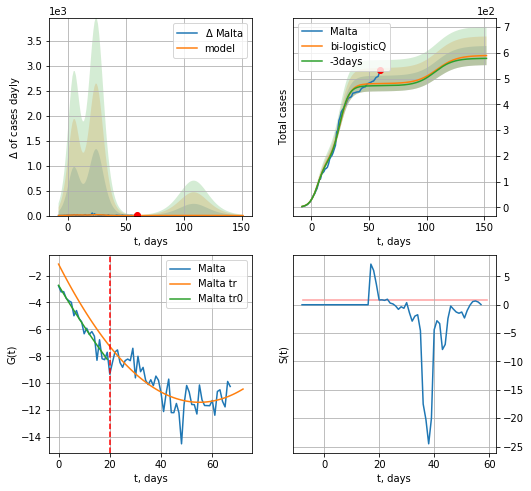

Malta data at: 2020-05-15
+3 day model MAPE: 0.017667
model: bi-logisticQ
coeffs: [ 3.09223076e+02  7.95245750e-07  2.50028211e+01 -2.90305617e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.062982
forecast at the end of period: +92 days
	 deltaDaycases: 0
	 total cases: 588 ± 37
	 total death: 6 ± 1
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.942709
 intercept_: -2.7278514236597555
 coeffs_: [ 0.         -0.32197154  0.00170311]
trend coefficient of determination: 0.637146
 intercept_: -1.1513677621794365
 coeffs_: [ 0.         -0.37370366  0.00339845]


In [322]:
x = forecastRRR("Malta",dfMT[:20],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,20*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=20)

SL
          date  cases  active  death
62 2020-05-11   1465   455.0   27.0
63 2020-05-12   1469   382.0   27.0
64 2020-05-13   1477   338.0   27.0
65 2020-05-14   1480   322.0   27.0
66 2020-05-15   1480   322.0   27.0


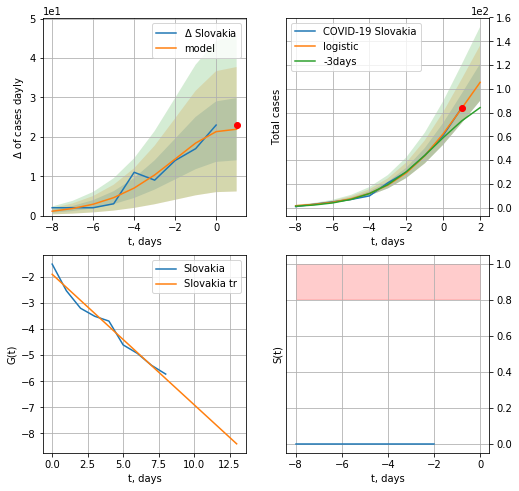

Slovakia data at: 2020-05-15
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +1 days
	 deltaDaycases:  21
	 total cases:  105 ± 15
	 total death:  1 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

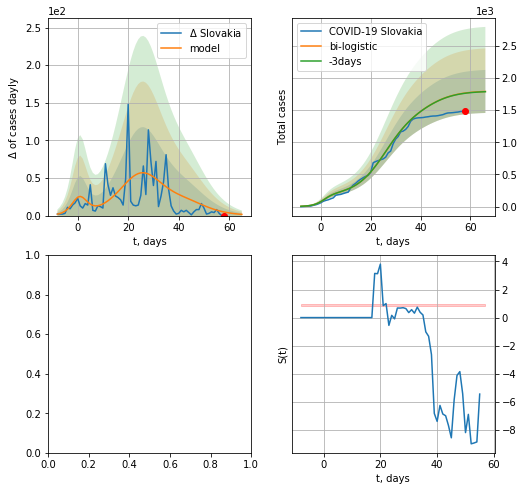

In [323]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
x = forecast("Slovakia",dfSL[:10],d1,7*7-dT,pMAPE=False)
xx = forecast2("Slovakia",dfSL[:],d1,8*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

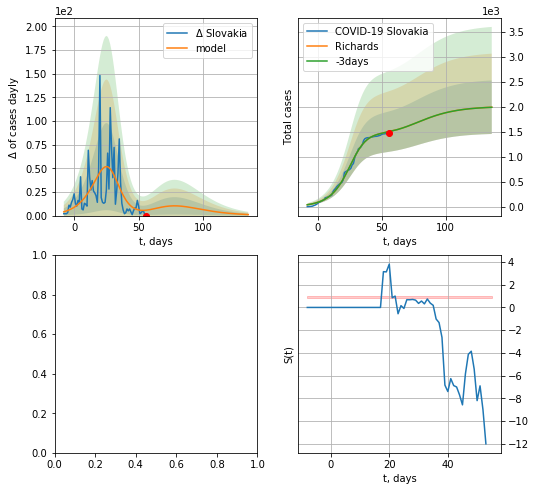

In [299]:
x = forecastRR("Slovakia",dfSL[:],d1,18*7-dT,addpred=True,xcoef=RkoreaCoeffs)

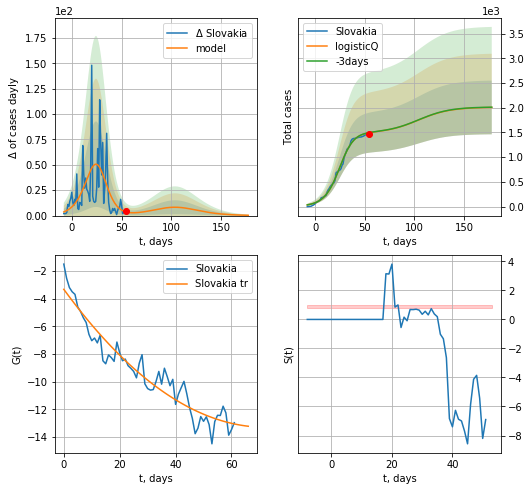

Slovakia data at: 2020-05-11
+3 day model MAPE: 0.002083
model: logisticQ
coeffs: [ 1.48437303e+03  5.83557248e-04  2.37820712e+01 -2.08033096e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.270641
forecast at the end of period: +124 days
	 deltaDaycases: 0
	 total cases: 2005 ± 542
	 total death: 35 ± 28
trend coefficient of determination: 0.915945
 intercept_: -3.3281823495637806
 coeffs_: [ 0.         -0.27619245  0.00191182]


In [352]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
          date   cases  active  death
67 2020-05-11  1460.0  1102.0  102.0
68 2020-05-12  1461.0  1100.0  102.0
69 2020-05-13  1463.0  1100.0  103.0
70 2020-05-14  1464.0  1094.0  103.0
71 2020-05-15  1465.0  1092.0  103.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


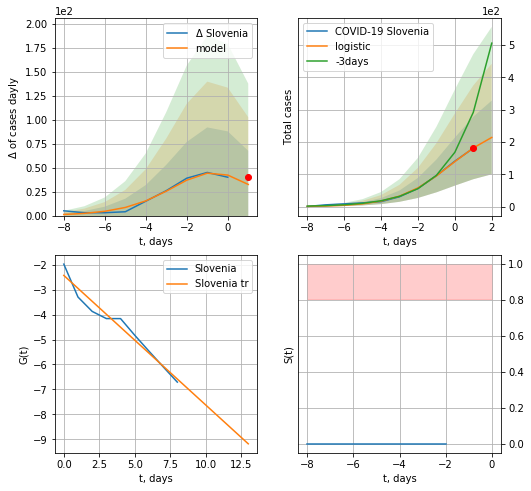

Slovenia data at: 2020-05-15
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +1 days
	 deltaDaycases:  32
	 total cases:  214 ± 113
	 total death:  15 ± 23
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


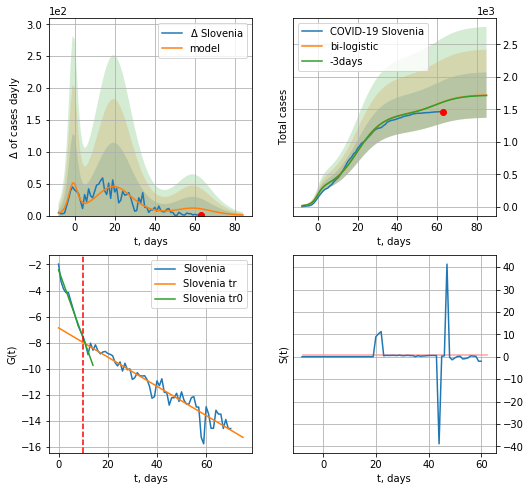

Slovenia data at: 2020-05-15
+3 day model MAPE: 0.001879573378682879
model: bi-logistic
coeffs:  [1.17136669e+03 1.55958071e-01 1.99131506e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.20369783523550664
forecast at the end of period: +22 days
	 deltaDaycases:  0
	 total cases:  1719 ± 350
	 total death:  120 ± 73
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.919457
 intercept: -6.861530
 slope: -0.111926


In [324]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
x = forecast("Slovenia",dfSV[:10],d1,7*7-dT,pMAPE=False)
xx = forecast2("Slovenia",dfSV[:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


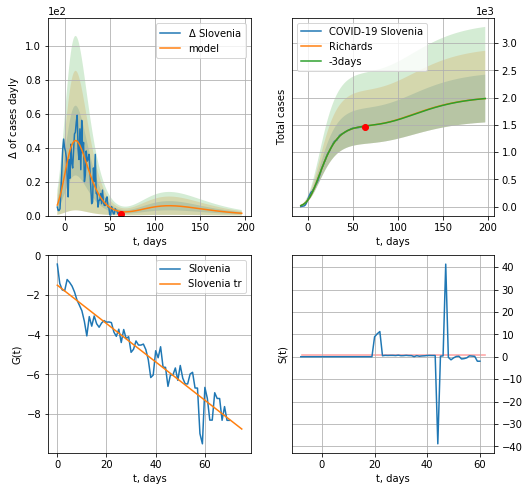

Slovenia data at: 2020-05-15
+3 day model MAPE: 0.000574
model: Richards
coeffs: [ 1.49085378e+03  6.06890927e-01 -9.94852146e+00  1.41940568e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.220851
forecast at the end of period: +134 days
	 deltaDaycases: 1
	 total cases: 1982 ± 437
	 total death: 139 ± 92
trend coefficient of determination: 0.916429
 intercept: -1.500999
 slope: -0.096803


In [325]:
x = forecastRR("Slovenia",dfSV[:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


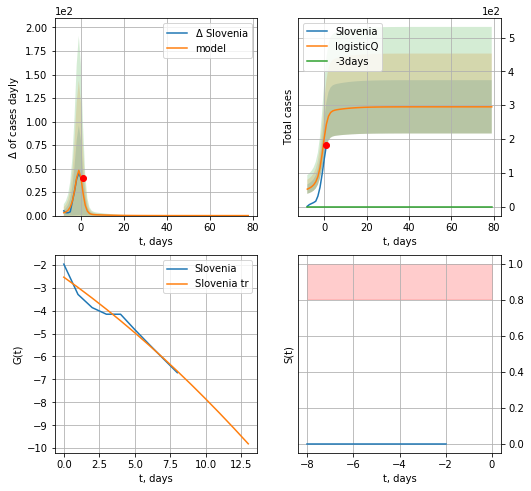

Slovenia data at: 2020-05-15
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +78 days
	 deltaDaycases: 0
	 total cases: 295 ± 78
	 total death: 20 ± 16
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


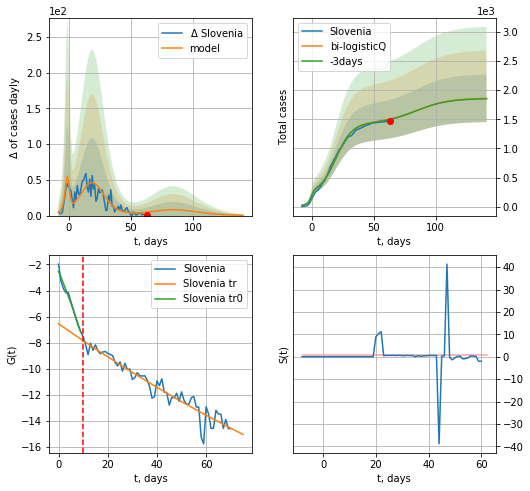

Slovenia data at: 2020-05-15
+3 day model MAPE: 0.003287
model: bi-logisticQ
coeffs: [ 1.21567552e+03  8.55525469e-07  1.93561271e+01 -1.76655879e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.219840
forecast at the end of period: +78 days
	 deltaDaycases: 0
	 total cases: 1858 ± 408
	 total death: 130 ± 85
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.920580
 intercept_: -6.5441693601791435
 coeffs_: [ 0.         -0.13161755  0.00024623]


In [326]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
          date  cases  active  death
62 2020-05-11  10176  6668.0  218.0
63 2020-05-12  10243  6423.0  220.0
64 2020-05-13  10295  6249.0  222.0
65 2020-05-14  10374  6066.0  224.0
66 2020-05-15  10438  5912.0  225.0


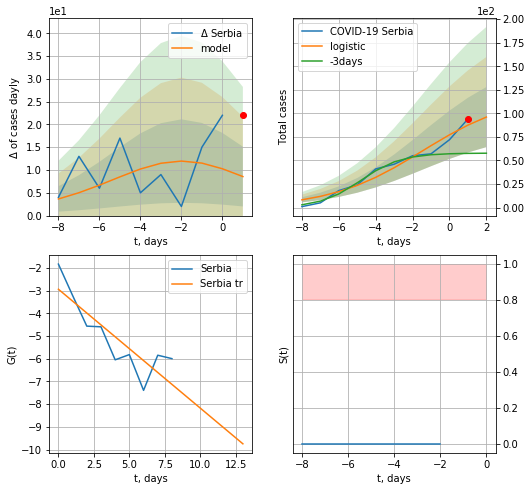

Serbia data at: 2020-05-15
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +1 days
	 deltaDaycases:  8
	 total cases:  96 ± 31
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


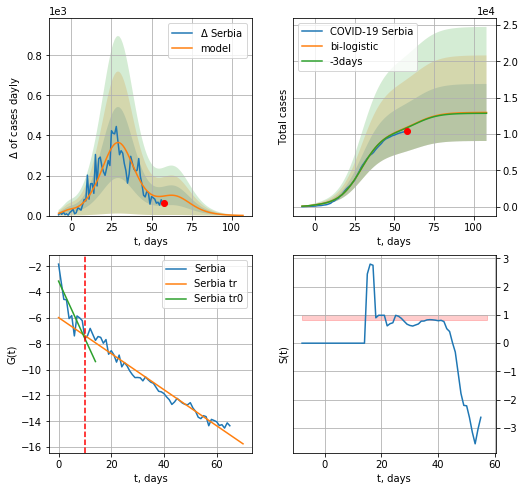

Serbia data at: 2020-05-15
+3 day model MAPE: 0.005541737078222705
model: bi-logistic
coeffs:  [1.02825538e+04 1.41147128e-01 2.94812837e+01] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.3029291072511188
forecast at the end of period: +50 days
	 deltaDaycases:  0
	 total cases:  12967 ± 3928
	 total death:  279 ± 253
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.972144
 intercept: -5.970212
 slope: -0.139656


In [327]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,7*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,14*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


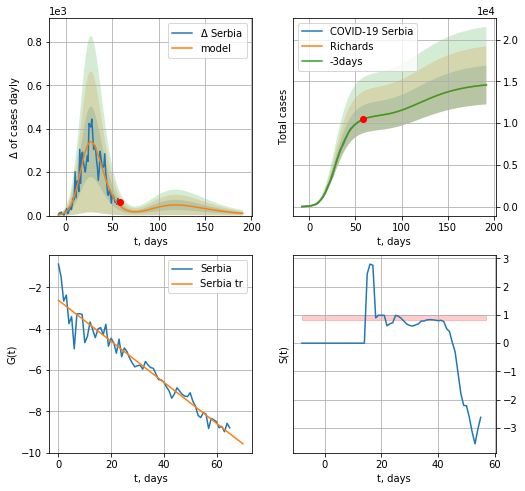

Serbia data at: 2020-05-15
+3 day model MAPE: 0.000586
model: Richards
coeffs: [1.09116808e+04 2.52720428e-01 1.84735492e+01 4.00572547e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.159144
forecast at the end of period: +134 days
	 deltaDaycases: 10
	 total cases: 14562 ± 2317
	 total death: 313 ± 149
trend coefficient of determination: 0.945520
 intercept: -2.618102
 slope: -0.099380


In [328]:
x = forecastRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=RkoreaCoeffs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


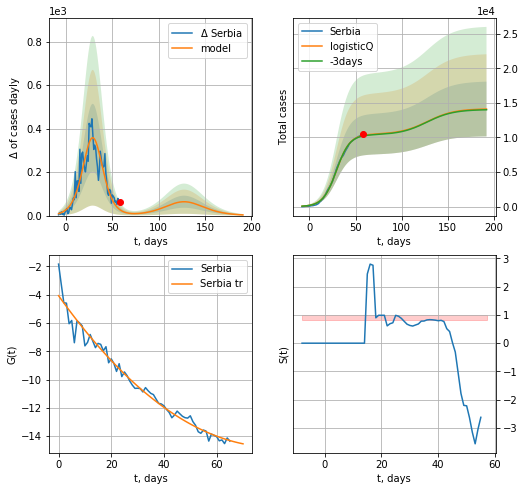

Serbia data at: 2020-05-15
+3 day model MAPE: 0.006781
model: logisticQ
coeffs: [ 1.04493824e+04  1.87641706e-06  2.93424221e+01 -7.29835094e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.280560
forecast at the end of period: +134 days
	 deltaDaycases: 3
	 total cases: 14106 ± 3957
	 total death: 304 ± 255
trend coefficient of determination: 0.974678
 intercept_: -4.0639200934450965
 coeffs_: [ 0.         -0.26104862  0.00159127]


In [329]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
          date  cases  active  death
72 2020-05-11   2196   321.0   91.0
73 2020-05-12   2207   308.0   91.0
74 2020-05-13   2213   285.0   94.0
75 2020-05-14   2221   277.0   94.0
76 2020-05-15   2222   258.0   95.0


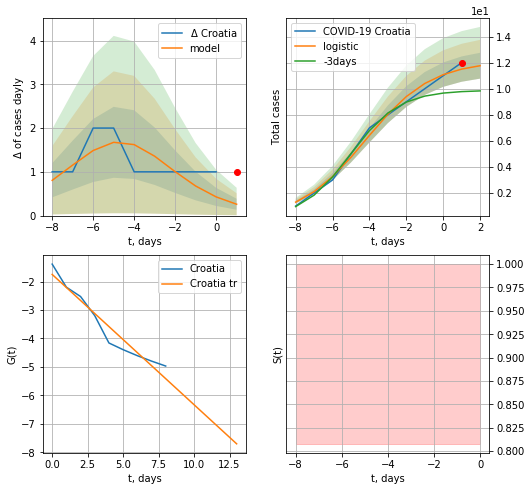

Croatia data at: 2020-05-15
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  11 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


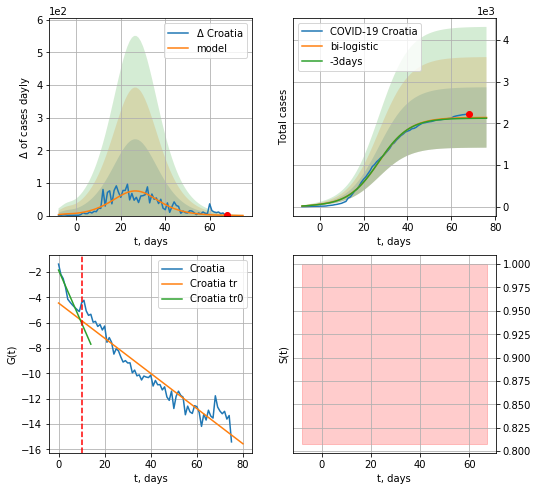

Croatia data at: 2020-05-15
+3 day model MAPE: 0.007988653647763144
model: bi-logistic
coeffs:  [2.13174928e+03 1.41783307e-01 2.70176311e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.3386632967274134
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  2141 ± 725
	 total death:  91 ± 92
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.915192
 intercept: -4.455782
 slope: -0.138863


In [330]:
dfCT = read_df(pd.DataFrame(),"CT")
x = forecast("Croatia",dfCT[:10],d1,7*7-dT,pMAPE=False)
xx = forecast2("Croatia",dfCT[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


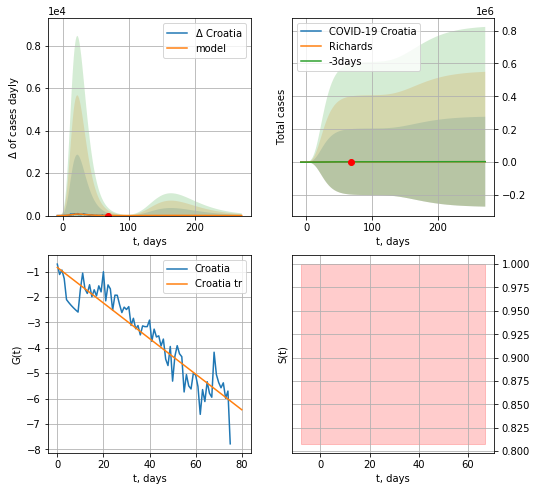

Croatia data at: 2020-05-15
+3 day model MAPE: 0.003601
model: Richards
coeffs: [ 2.23408318e+03  8.64948294e+00 -2.89251250e+01  1.02497457e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 90.587069
forecast at the end of period: +204 days
	 deltaDaycases: 0
	 total cases: 3013 ± 272953
	 total death: 128 ± 34785
trend coefficient of determination: 0.866250
 intercept: -0.830492
 slope: -0.070143


In [331]:
x = forecastRR("Croatia",dfCT[:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


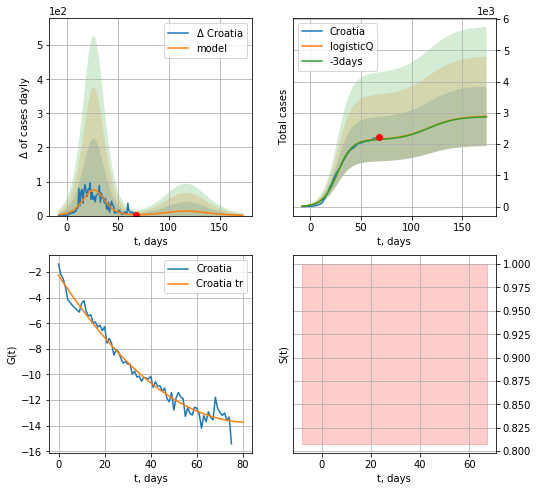

Croatia data at: 2020-05-15
+3 day model MAPE: 0.007880
model: logisticQ
coeffs: [ 2.14606199e+03  9.27354299e-07  2.69290104e+01 -1.51022033e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.329284
forecast at the end of period: +106 days
	 deltaDaycases: 0
	 total cases: 2892 ± 952
	 total death: 123 ± 121
trend coefficient of determination: 0.976647
 intercept_: -2.259806075932028
 coeffs_: [ 0.         -0.27655108  0.00166582]


In [332]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
          date  cases  active  death
66 2020-05-11   9746    7041  533.0
67 2020-05-12  10093    7223  544.0
68 2020-05-13  10431    7389  556.0
69 2020-05-14  10829    7632  571.0
70 2020-05-15  11228    7837  592.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


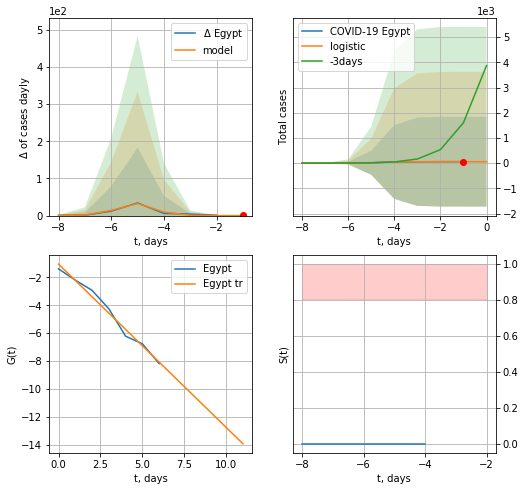

Egypt data at: 2020-05-15
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


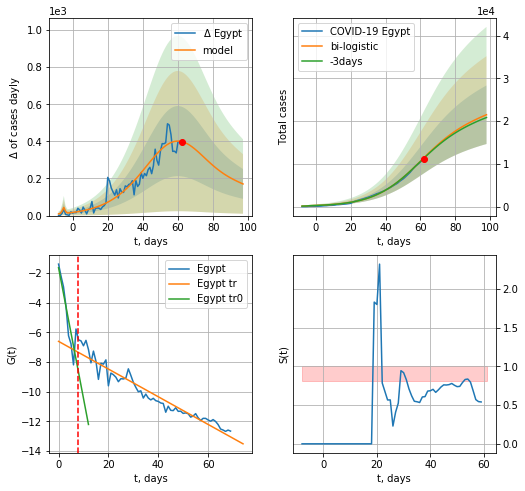

Egypt data at: 2020-05-15
+3 day model MAPE: 0.00898043156130306
model: bi-logistic
coeffs:  [2.02128482e+04 7.64321514e-02 5.93886729e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.3186162676160534
forecast at the end of period: +36 days
	 deltaDaycases:  170
	 total cases:  21509 ± 6853
	 total death:  1134 ± 1083
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.934690
 intercept: -6.603183
 slope: -0.093490


In [333]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*7-dT)
xx = forecast2("Egypt",dfEG[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


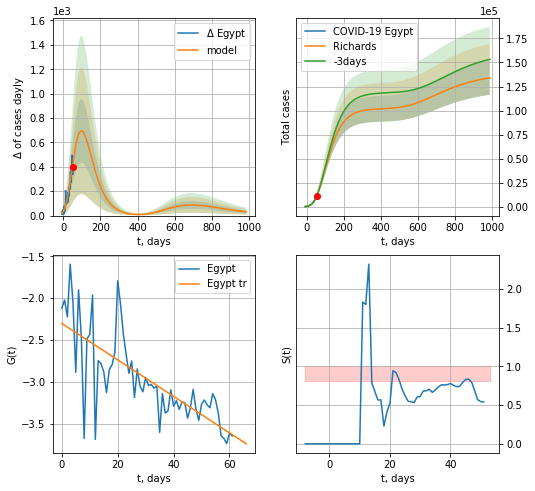

Egypt data at: 2020-05-15
+3 day model MAPE: 0.006998
model: Richards
coeffs: [ 1.02126328e+05  5.64315767e-01 -8.28431067e+01  3.33460886e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.131756
forecast at the end of period: +932 days
	 deltaDaycases: 30
	 total cases: 134012 ± 17656
	 total death: 7065 ± 2792
trend coefficient of determination: 0.560934
 intercept: -2.301994
 slope: -0.021802


In [334]:
x = forecastRR("Egypt",dfEG[8:],d1,140*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


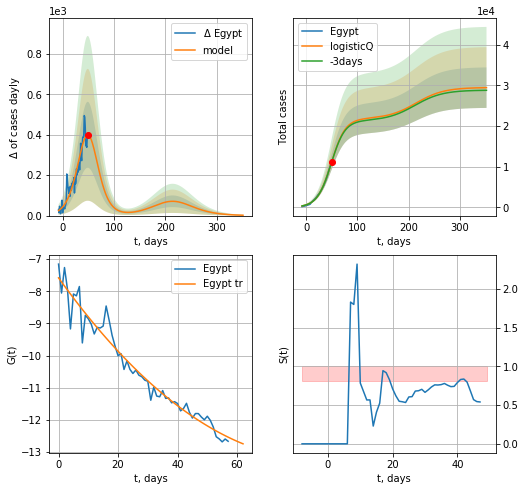

Egypt data at: 2020-05-15
+3 day model MAPE: 0.003291
model: logisticQ
coeffs: [ 2.17797423e+04  9.38721344e-06  4.91810080e+01 -7.76461400e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.169313
forecast at the end of period: +302 days
	 deltaDaycases: 1
	 total cases: 29444 ± 4985
	 total death: 1552 ± 788
trend coefficient of determination: 0.953058
 intercept_: -7.582601755399378
 coeffs_: [ 0.         -0.12869426  0.00073333]


In [335]:
x = forecastRRR("Egypt",dfEG[12:],d1,50*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
          date  cases  active  death
69 2020-05-11   2818   918.0  110.0
70 2020-05-12   2913   898.0  112.0
71 2020-05-13   3032   951.0  115.0
72 2020-05-14   3143  1000.0  115.0
73 2020-05-15   3193   987.0  117.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


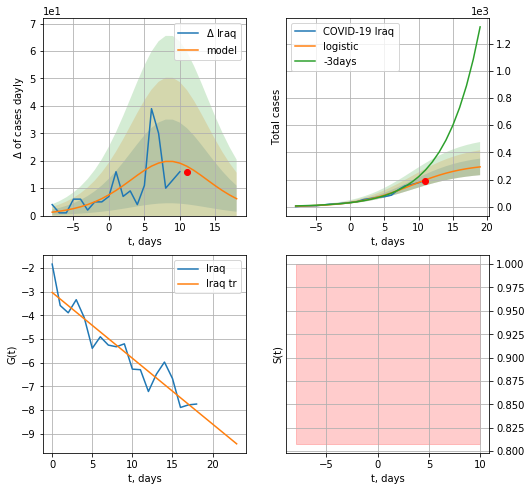

Iraq data at: 2020-05-15
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +8 days
	 deltaDaycases:  6
	 total cases:  293 ± 60
	 total death:  10 ± 6
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


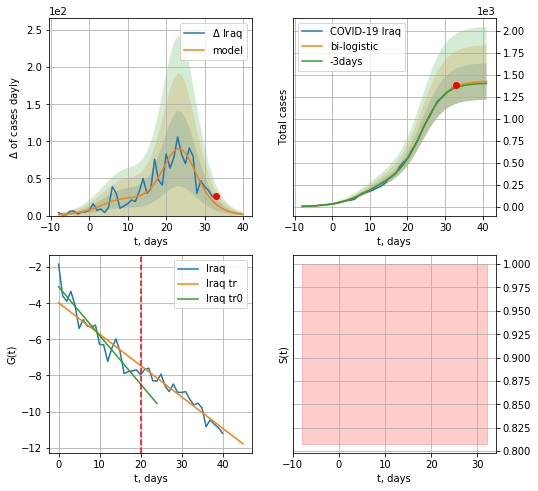

Iraq data at: 2020-05-15
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +8 days
	 deltaDaycases:  1
	 total cases:  1421 ± 206
	 total death:  52 ± 22
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


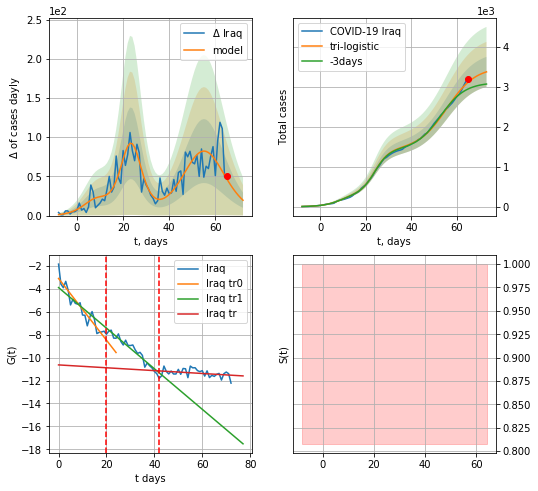

Iraq data at: 2020-05-15
+3 day model MAPE: 0.06465576873895186
model: tri-logistic
coeffs:  [2.07381135e+03 1.58882758e-01 5.55599362e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.11113780697107374
forecast at the end of period: +8 days
	 deltaDaycases:  19
	 total cases:  3377 ± 375
	 total death:  123 ± 41
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.102455
 intercept: -10.631976
 slope: -0.012469


In [336]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
x = forecast("Iraq",dfIQ[:vL],d1,8*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


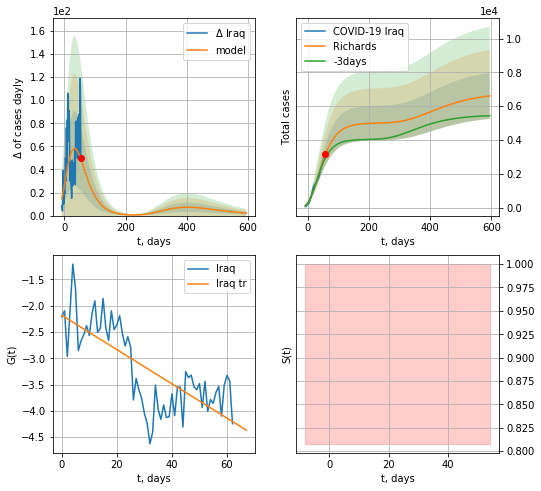

Iraq data at: 2020-05-15
+3 day model MAPE: 0.056919
model: Richards
coeffs: [ 5.00292781e+03  2.88924883e+00 -1.07819484e+02  1.09981356e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.205987
forecast at the end of period: +540 days
	 deltaDaycases: 2
	 total cases: 6605 ± 1360
	 total death: 242 ± 149
trend coefficient of determination: 0.551850
 intercept: -2.183802
 slope: -0.032561


In [337]:
x = forecastRR("Iraq",dfIQ[10:],d1,84*7-dT,addpred=True,xcoef=RkoreaCoeffs)


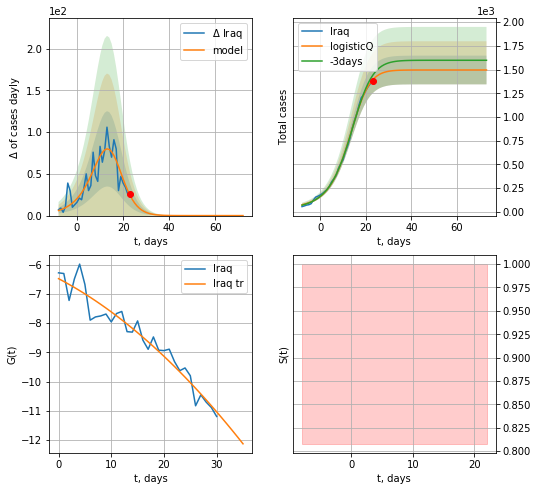

Iraq data at: 2020-05-15
+3 day model MAPE: 0.037622
model: logisticQ
coeffs: [ 1.49506808e+03  3.17947912e-03  1.23994223e+01 -5.37356409e+01]
rational stdev: 0.101331
forecast at the end of period: +50 days
	 deltaDaycases: 0
	 total cases: 1495 ± 151
	 total death: 54 ± 16
trend coefficient of determination: 0.935701
 intercept_: -6.475161114969037
 coeffs_: [ 0.         -0.094783   -0.00191217]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


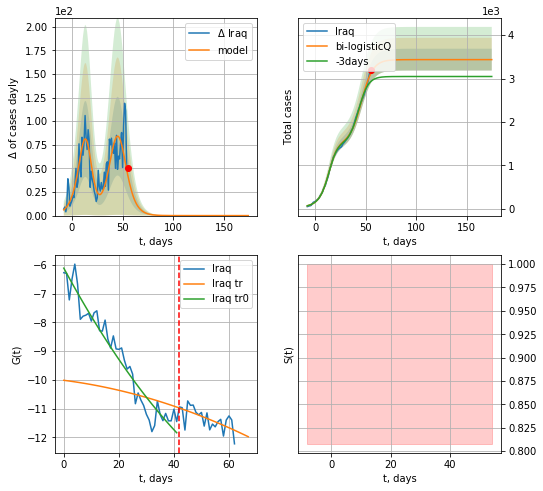

Iraq data at: 2020-05-15
+3 day model MAPE: 0.071213
model: bi-logisticQ
coeffs: [ 1.93956972e+03  6.06941267e-06  4.56189910e+01 -2.85913449e+04]
rational stdev: 0.073025
forecast at the end of period: +120 days
	 deltaDaycases: 0
	 total cases: 3434 ± 250
	 total death: 125 ± 27
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.938502
 intercept_: -6.116864757771229
 coeffs_: [ 0.         -0.176838    0.00090835]
trend coefficient of determination: 0.392969
 intercept_: -10.016988270491183
 coeffs_: [ 0.         -0.01231463 -0.00025319]


In [338]:
x = forecastRRR("Iraq",dfIQ[10:42],d1,14*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[10:],d1,24*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=42)

In [339]:
#len(dfAR)

AR
          date   cases  active  death
68 2020-05-11  5891.0  2543.0  507.0
69 2020-05-12  6067.0  2554.0  515.0
70 2020-05-13  6253.0  2673.0  522.0
71 2020-05-14  6442.0  2755.0  529.0
72 2020-05-15  6629.0  2822.0  536.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


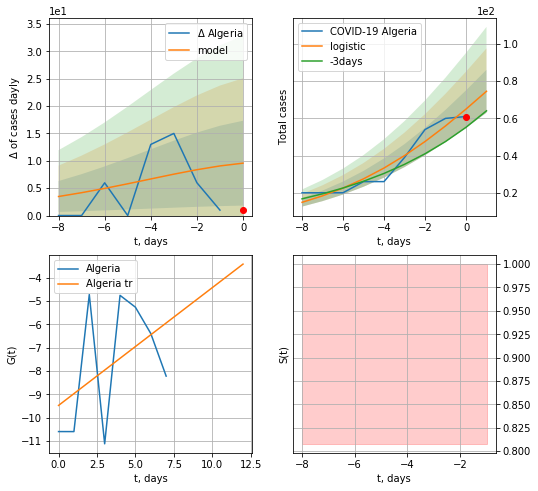

Algeria data at: 2020-05-15
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +1 days
	 deltaDaycases:  9
	 total cases:  74 ± 11
	 total death:  6 ± 2
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


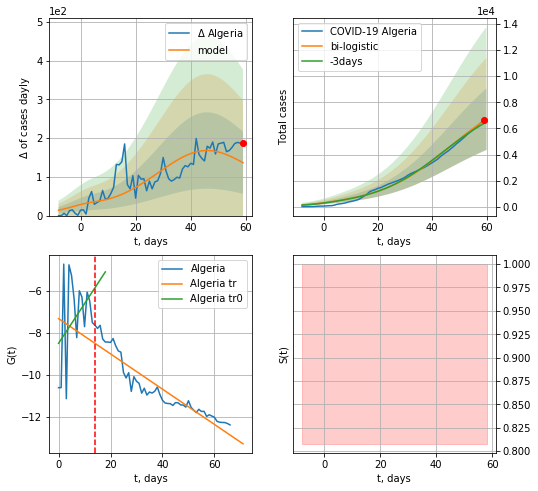

Algeria data at: 2020-05-15
+3 day model MAPE: 0.033378980429741925
model: bi-logistic
coeffs:  [8.47355224e+03 7.71325318e-02 4.56976734e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3507986613804607
forecast at the end of period: +1 days
	 deltaDaycases:  136
	 total cases:  6704 ± 2352
	 total death:  542 ± 570
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.875336
 intercept: -7.316977
 slope: -0.083784


In [340]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*7-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


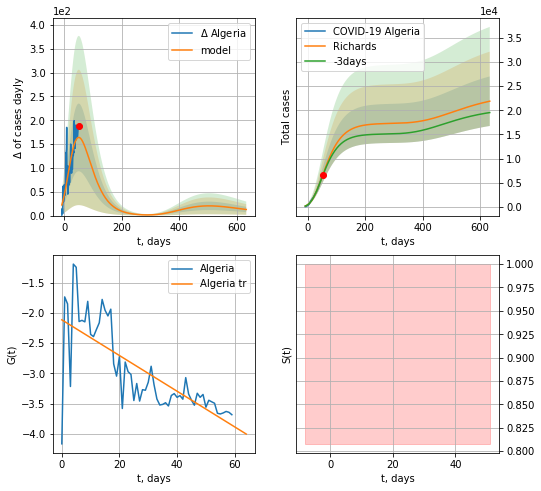

Algeria data at: 2020-05-15
+3 day model MAPE: 0.020014
model: Richards
coeffs: [ 1.73106386e+04  1.98343932e+00 -1.15954415e+02  1.30658659e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.234217
forecast at the end of period: +582 days
	 deltaDaycases: 12
	 total cases: 21887 ± 5126
	 total death: 1769 ± 1242
trend coefficient of determination: 0.548642
 intercept: -2.113787
 slope: -0.029521


In [341]:
x = forecastRR("Algeria",dfAR[12:],d1,90*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


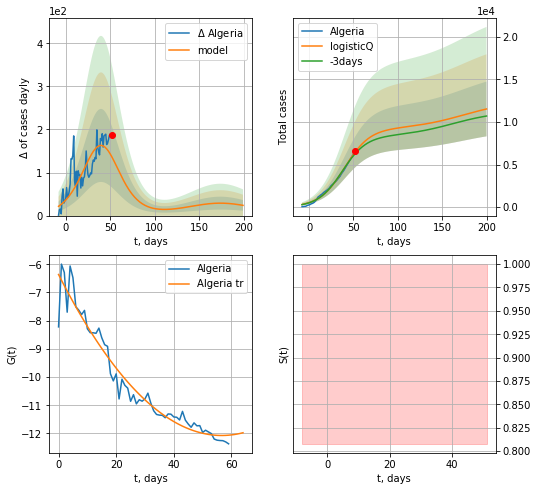

Algeria data at: 2020-05-15
+3 day model MAPE: 0.033612
model: logisticQ
coeffs: [ 9.19603048e+03  1.64882443e-06  3.99697667e+01 -4.26871729e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.278780
forecast at the end of period: +148 days
	 deltaDaycases: 23
	 total cases: 11520 ± 3211
	 total death: 931 ± 778
trend coefficient of determination: 0.943701
 intercept_: -6.3644760449992805
 coeffs_: [ 0.         -0.20156682  0.00177981]


In [342]:
x = forecastRRR("Algeria",dfAR[12:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
          date  cases  active  death
60 2020-05-11  901.0   484.0   16.0
61 2020-05-12  903.0   438.0   16.0
62 2020-05-13  905.0   439.0   17.0
63 2020-05-14  907.0   409.0   17.0
64 2020-05-15  910.0   412.0   17.0


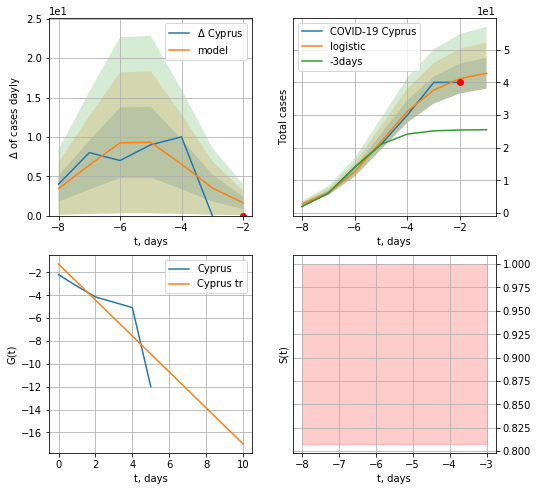

Cyprus data at: 2020-05-15
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +1 days
	 deltaDaycases:  1
	 total cases:  42 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


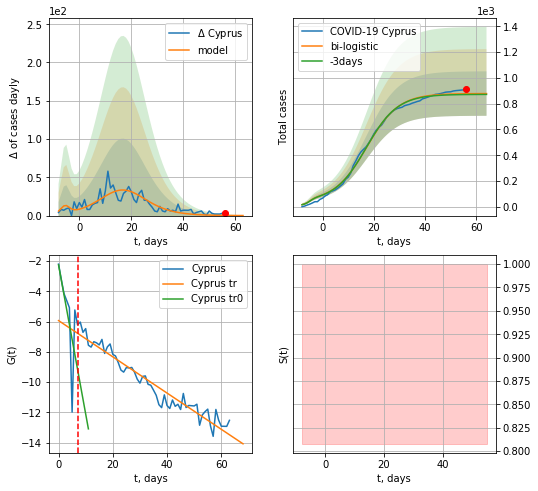

Cyprus data at: 2020-05-15
+3 day model MAPE: 0.007315823790560496
model: bi-logistic
coeffs:  [8.34718645e+02 1.60395533e-01 1.71880351e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.19614673717827777
forecast at the end of period: +8 days
	 deltaDaycases:  0
	 total cases:  878 ± 172
	 total death:  16 ± 9
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.934993
 intercept: -5.931389
 slope: -0.119854


In [343]:
dfCP = read_df(pd.DataFrame(),"CP")
x = forecast("Cyprus",dfCP[:7],d1,7*7-dT)
xx = forecast2("Cyprus",dfCP[:],d1,8*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


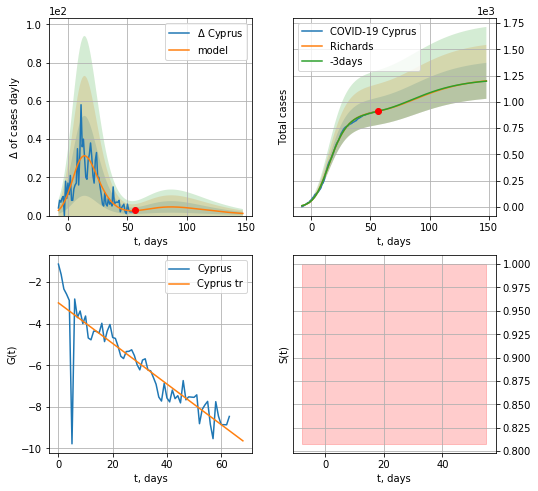

Cyprus data at: 2020-05-15
+3 day model MAPE: 0.001132
model: Richards
coeffs: [9.03605355e+02 2.79030931e-01 6.33545853e+00 4.03671423e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.142754
forecast at the end of period: +92 days
	 deltaDaycases: 1
	 total cases: 1200 ± 171
	 total death: 22 ± 9
trend coefficient of determination: 0.779843
 intercept: -2.995353
 slope: -0.097715


In [344]:
x = forecastRR("Cyprus",dfCP[:],d1,20*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


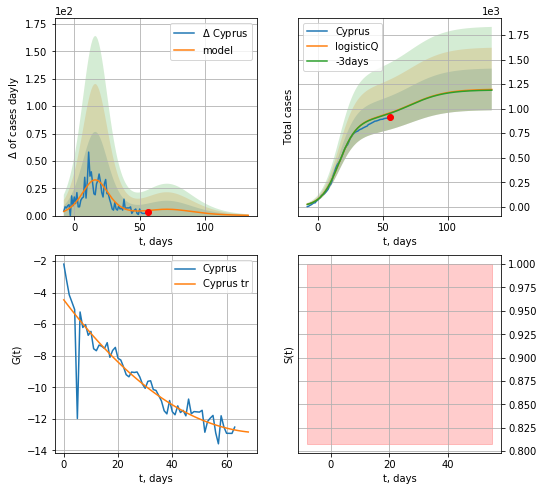

Cyprus data at: 2020-05-15
+3 day model MAPE: 0.004539
model: logisticQ
coeffs: [ 8.85154407e+02  1.46874184e-06  1.64378338e+01 -9.92892312e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.177689
forecast at the end of period: +78 days
	 deltaDaycases: 0
	 total cases: 1195 ± 212
	 total death: 22 ± 11
trend coefficient of determination: 0.865728
 intercept_: -4.462466073850301
 coeffs_: [ 0.         -0.22793672  0.00154066]


In [345]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
          date  cases   active   death
65 2020-05-11  68822  44455.0  1961.0
66 2020-05-12  72059  46678.0  2057.0
67 2020-05-13  76306  49813.0  2169.0
68 2020-05-14  80604  53186.0  2267.0
69 2020-05-15  84495  54956.0  2392.0


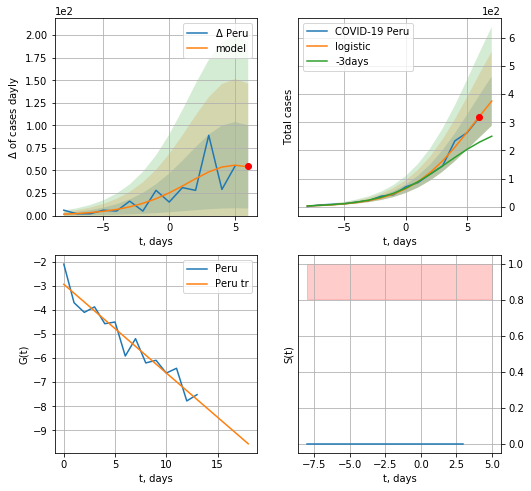

Peru data at: 2020-05-15
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +1 days
	 deltaDaycases:  54
	 total cases:  375 ± 87
	 total death:  10 ± 7
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


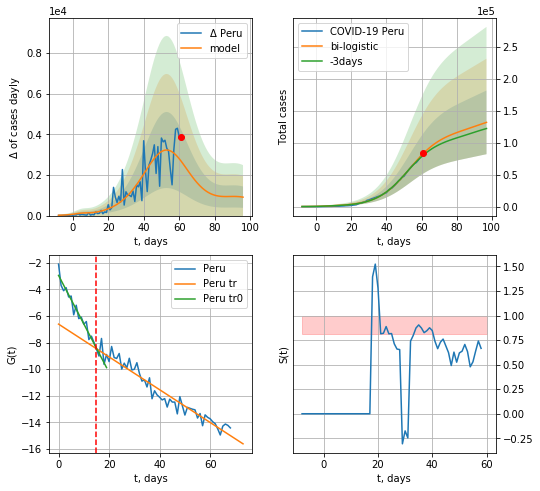

Peru data at: 2020-05-15
+3 day model MAPE: 0.03632421301686108
model: bi-logistic
coeffs:  [1.16528782e+05 1.09834774e-01 5.32206220e+01] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.37780090483186857
forecast at the end of period: +36 days
	 deltaDaycases:  907
	 total cases:  131701 ± 49756
	 total death:  3728 ± 4225
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.937866
 intercept: -6.614201
 slope: -0.123343


In [346]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*7-dT)
xx = forecast2("Peru",dfPU[:],d1,12*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


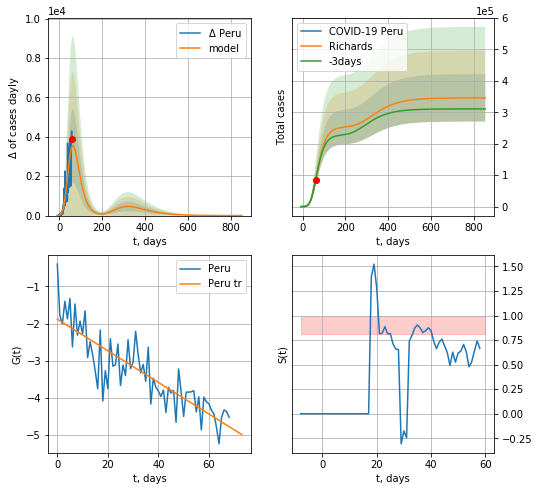

Peru data at: 2020-05-15
+3 day model MAPE: 0.004153
model: Richards
coeffs: [2.53867581e+05 3.16869248e-01 1.42807064e+01 1.27501600e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.217547
forecast at the end of period: +792 days
	 deltaDaycases: 0
	 total cases: 345814 ± 75230
	 total death: 9789 ± 6388
trend coefficient of determination: 0.729622
 intercept: -1.882679
 slope: -0.042523


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app


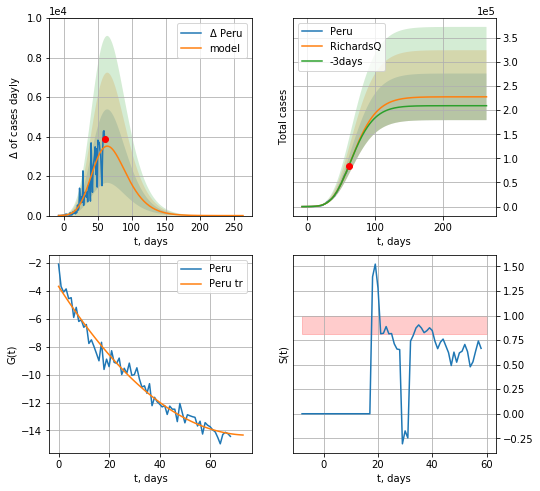

Peru data at: 2020-05-15
+3 day model MAPE: 0.003815
model: RichardsQ
coeffs: [ 2.27561252e+05  5.77255755e-03 -1.25656419e+02 -1.26122617e+02
  1.94964463e-02]
rational stdev: 0.212290
forecast at the end of period: +204 days
	 deltaDaycases: 0
	 total cases: 227560 ± 48308
	 total death: 6442 ± 4102
trend coefficient of determination: 0.971612
 intercept_: -3.6924961087751402
 coeffs_: [ 0.         -0.28184808  0.00186541]


In [347]:
x = forecastRR("Peru",dfPU[:],d1,120*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


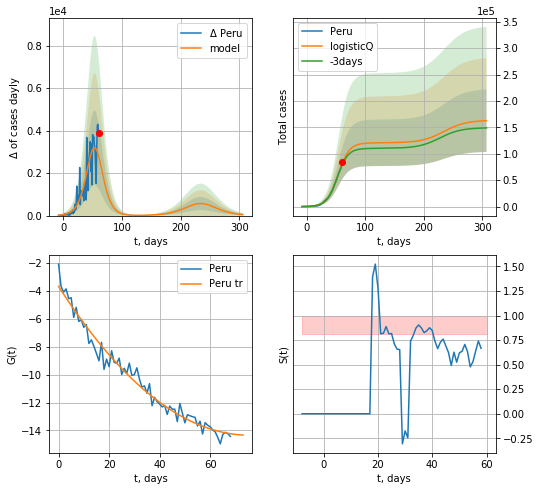

Peru data at: 2020-05-15
+3 day model MAPE: 0.032637
model: logisticQ
coeffs: [ 1.20759496e+05  4.83784667e-06  5.37383844e+01 -2.18583304e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.363833
forecast at the end of period: +246 days
	 deltaDaycases: 46
	 total cases: 162659 ± 59180
	 total death: 4604 ± 5025
trend coefficient of determination: 0.971612
 intercept_: -3.6924961087751402
 coeffs_: [ 0.         -0.28184808  0.00186541]


In [348]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,42*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
          date  cases   active   death
72 2020-05-11  70827  45984.0  2294.0
73 2020-05-12  74292  47457.0  2415.0
74 2020-05-13  78121  49170.0  2551.0
75 2020-05-14  82052  51434.0  2649.0
76 2020-05-15  85940  52929.0  2753.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


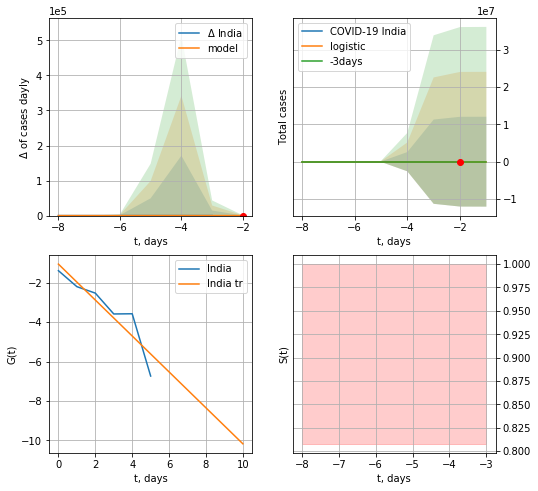

India data at: 2020-05-15
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +1 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035166
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


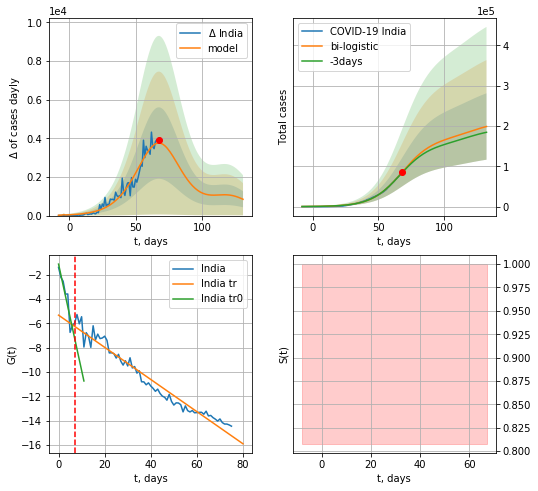

India data at: 2020-05-15
+3 day model MAPE: 0.01947050084213645
model: bi-logistic
coeffs:  [1.69470303e+05 8.79275634e-02 6.78506797e+01] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.41445808578417337
forecast at the end of period: +64 days
	 deltaDaycases:  844
	 total cases:  198738 ± 82368
	 total death:  6366 ± 7915
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.957879
 intercept: -5.317780
 slope: -0.132387


In [349]:
dfID = read_df(pd.DataFrame(),"ID")
x = forecast("India",dfID[:7],d1,7*7-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


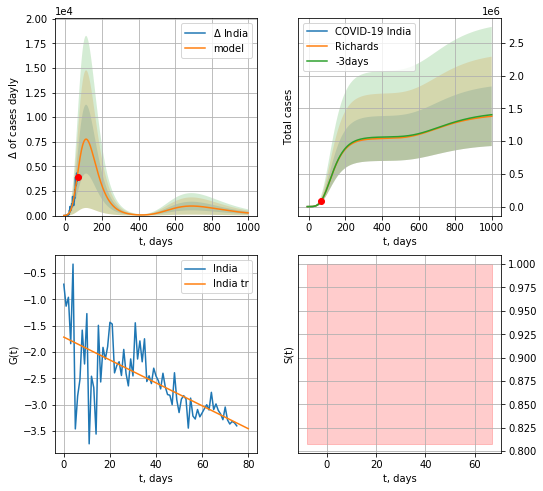

India data at: 2020-05-15
+3 day model MAPE: 0.000457
model: Richards
coeffs: [ 1.04331341e+06  7.69981137e-01 -6.25010289e+01  2.66474021e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.329577
forecast at the end of period: +932 days
	 deltaDaycases: 269
	 total cases: 1380815 ± 455084
	 total death: 44233 ± 43734
trend coefficient of determination: 0.457723
 intercept: -1.714907
 slope: -0.021714


In [350]:
x = forecastRR("India",dfID[:],d1,140*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


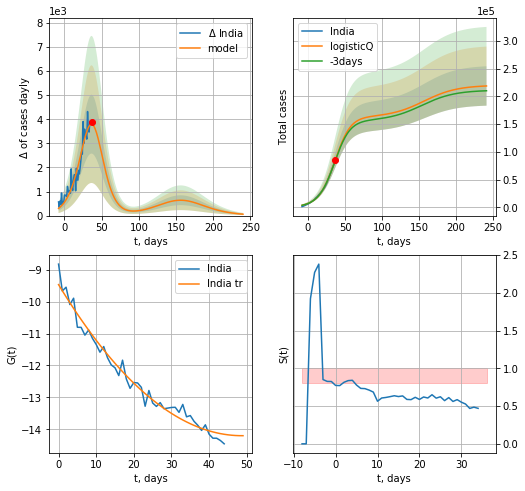

India data at: 2020-05-15
+3 day model MAPE: 0.011537
model: logisticQ
coeffs: [ 1.62632684e+05  1.74915482e-04  3.58772117e+01 -4.95385021e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.162145
forecast at the end of period: +204 days
	 deltaDaycases: 57
	 total cases: 218949 ± 35501
	 total death: 7013 ± 3411
trend coefficient of determination: 0.974594
 intercept_: -9.467586922237796
 coeffs_: [ 0.         -0.19439656  0.0019952 ]


In [351]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
          date   cases  active  death
68 2020-05-11  6278.0  4127.0  314.0
69 2020-05-12  6563.0  4382.0  319.0
70 2020-05-13  6879.0  4284.0  329.0
71 2020-05-14  7134.0  4396.0  353.0
72 2020-05-15  7479.0  4626.0  356.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


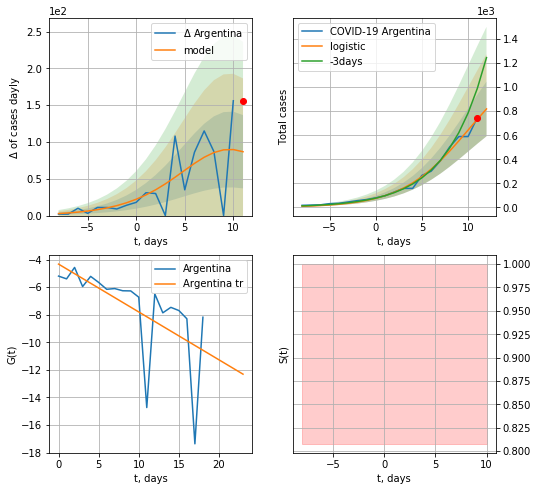

Argentina data at: 2020-05-15
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +1 days
	 deltaDaycases:  86
	 total cases:  819 ± 227
	 total death:  38 ± 31
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


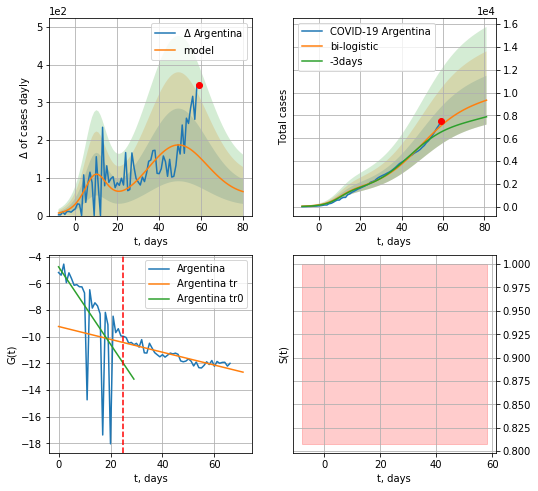

Argentina data at: 2020-05-15
+3 day model MAPE: 0.09224813482424572
model: bi-logistic
coeffs:  [8.12894846e+03 9.11591585e-02 4.94605020e+01] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2291225930302692
forecast at the end of period: +22 days
	 deltaDaycases:  63
	 total cases:  9332 ± 2138
	 total death:  444 ± 305
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.805364
 intercept: -9.237468
 slope: -0.048162


In [352]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*7-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,10*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


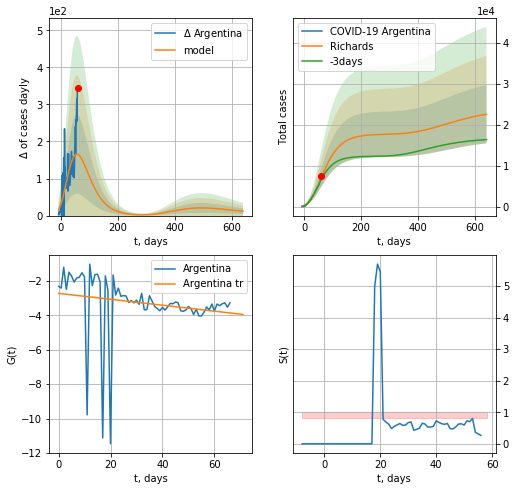

Argentina data at: 2020-05-15
+3 day model MAPE: 0.065388
model: Richards
coeffs: [ 1.76828500e+04  1.16295346e+00 -9.12559362e+01  2.21399833e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.314559
forecast at the end of period: +582 days
	 deltaDaycases: 11
	 total cases: 22553 ± 7094
	 total death: 1073 ± 1012
trend coefficient of determination: 0.033982
 intercept: -2.723661
 slope: -0.017238


In [353]:
x = forecastRR('Argentina',dfAG[5:].fillna(0),d1,90*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


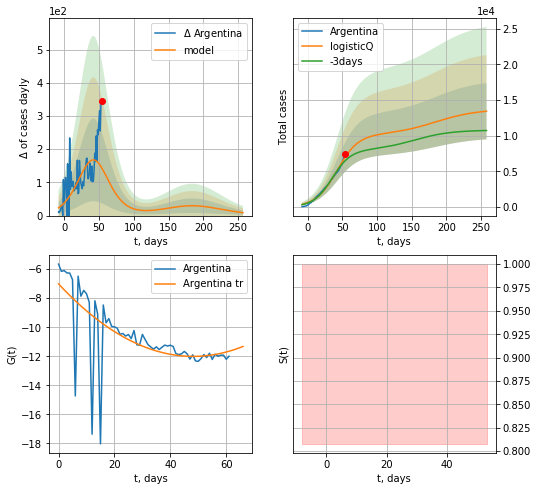

Argentina data at: 2020-05-15
+3 day model MAPE: 0.085511
model: logisticQ
coeffs: [ 1.01208797e+04  1.31830287e-06  4.23210673e+01 -4.99634044e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.293817
forecast at the end of period: +204 days
	 deltaDaycases: 8
	 total cases: 13417 ± 3942
	 total death: 638 ± 562
trend coefficient of determination: 0.401436
 intercept_: -7.010914272825225
 coeffs_: [ 0.         -0.20726169  0.00215073]


In [354]:
x = forecastRRR('Argentina',dfAG[10:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


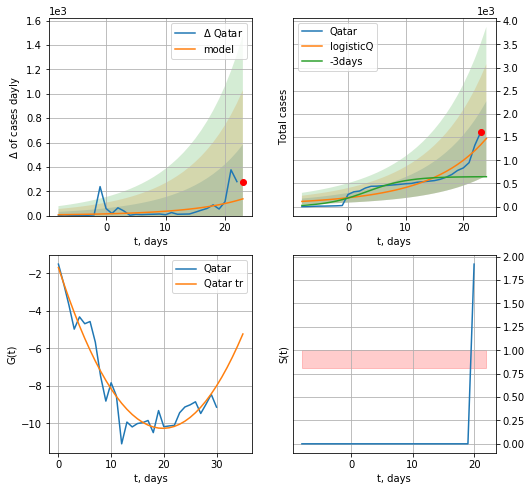

Qatar data at: 2020-05-15
+3 day model MAPE: 1.276947
model: logisticQ
coeffs: [ 3.06298216e+06  5.83123263e-04  8.16720504e+01 -2.03214903e+02]
rational stdev: 0.545415
forecast at the end of period: +1 days
	 deltaDaycases: 137
	 total cases: 1470 ± 801
	 total death: 0 ± 0
trend coefficient of determination: 0.919409
 intercept_: -1.6852707465713292
 coeffs_: [ 0.         -0.86529683  0.02183056]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp


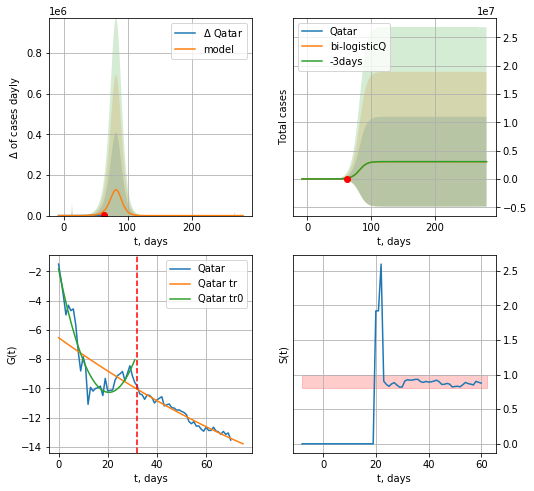

Qatar data at: 2020-05-15
+3 day model MAPE: 0.040882
model: bi-logisticQ
coeffs: [-1.64368795e+04  8.37858795e+01 -9.91472448e+01  1.38734067e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 2.601281
forecast at the end of period: +218 days
	 deltaDaycases: 0
	 total cases: 3040723 ± 7909776
	 total death: 1446 ± 11284
bi-logisticQ approximation splitting point: 32
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]
trend coefficient of determination: 0.958109
 intercept_: -6.531292121308673
 coeffs_: [ 0.         -0.12007394  0.00031163]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [357]:
vL=32
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*7-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


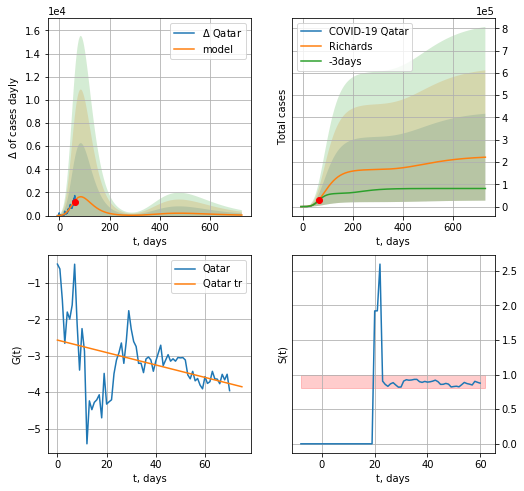

Qatar data at: 2020-05-15
+3 day model MAPE: 0.057084
model: Richards
coeffs: [ 1.66783802e+05  3.93352266e-01 -1.13461862e+01  6.98113776e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.879028
forecast at the end of period: +666 days
	 deltaDaycases: 49
	 total cases: 221756 ± 194929
	 total death: 105 ± 276
trend coefficient of determination: 0.149518
 intercept: -2.569022
 slope: -0.017088


In [360]:
x = forecastRR('Qatar',dfQR[:].fillna(0),d1,102*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)

In [379]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
          date    cases  active  death
86 2020-05-11  18878.0   13296  201.0
87 2020-05-12  19661.0   13446  203.0
88 2020-05-13  20386.0   13657  206.0
89 2020-05-14  21084.0   13946  208.0
90 2020-05-15  21831.0   14293  210.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


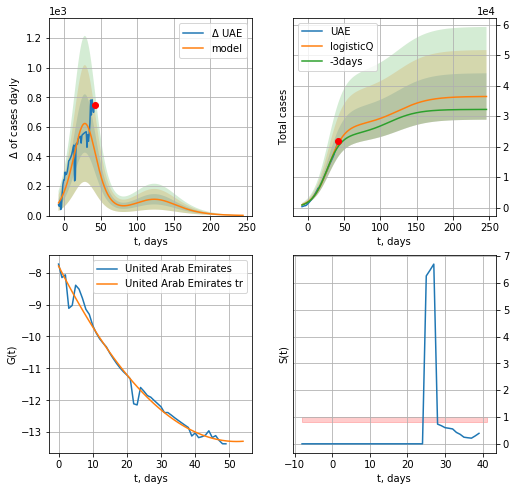

UAE data at: 2020-05-15
+3 day model MAPE: 0.053296
model: logisticQ
coeffs: [ 2.69161399e+04  1.83592416e-06  2.84464110e+01 -4.99823299e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.208784
forecast at the end of period: +204 days
	 deltaDaycases: 1
	 total cases: 36415 ± 7602
	 total death: 350 ± 219
trend coefficient of determination: 0.983373
 intercept_: -7.78957386477663
 coeffs_: [ 0.         -0.21116637  0.00202539]


In [362]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


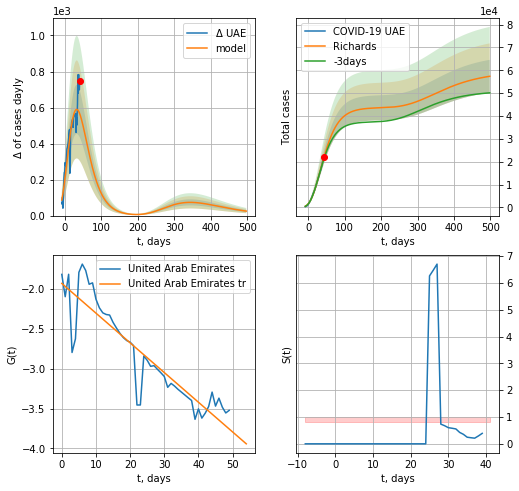

UAE data at: 2020-05-15
+3 day model MAPE: 0.030606
model: Richards
coeffs: [ 4.36692498e+04  2.49220165e+00 -8.06178207e+01  1.48356031e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.125563
forecast at the end of period: +456 days
	 deltaDaycases: 24
	 total cases: 57381 ± 7205
	 total death: 551 ± 207
trend coefficient of determination: 0.822960
 intercept: -1.929960
 slope: -0.037283


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


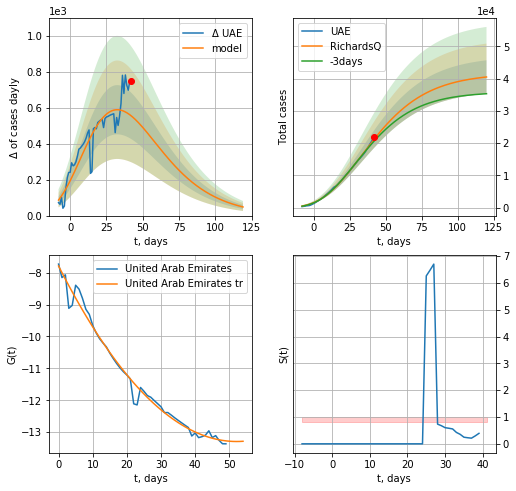

UAE data at: 2020-05-15
+3 day model MAPE: 0.031264
model: RichardsQ
coeffs: [ 4.16114115e+04  6.30105690e-03 -1.26307425e+02 -1.10286110e+03
  4.73417322e-03]
rational stdev: 0.127726
forecast at the end of period: +78 days
	 deltaDaycases: 47
	 total cases: 40524 ± 5176
	 total death: 389 ± 149
trend coefficient of determination: 0.983373
 intercept_: -7.78957386477663
 coeffs_: [ 0.         -0.21116637  0.00202539]


In [363]:
x = forecastRR('UAE',dfUAE[40:],d1,72*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [364]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
          date    cases  active  death
69 2020-05-11  41014.0   28022  255.0
70 2020-05-12  42925.0   27404  264.0
71 2020-05-13  44830.0   26935  273.0
72 2020-05-14  46869.0   27535  283.0
73 2020-05-15  49176.0   27015  292.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


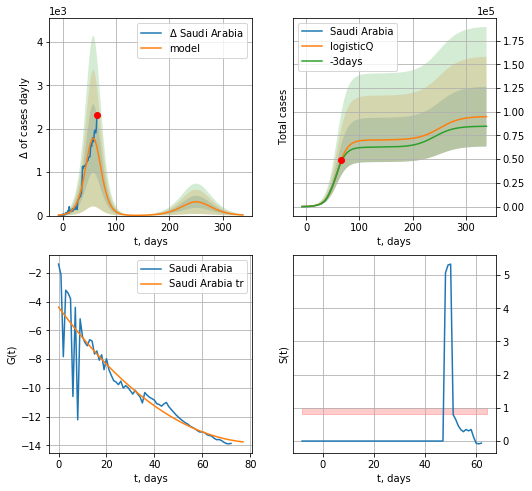

Saudi Arabia data at: 2020-05-15
+3 day model MAPE: 0.041272
model: logisticQ
coeffs: [ 7.02788234e+04  4.75894873e-06  5.74818156e+01 -2.12596896e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.332348
forecast at the end of period: +274 days
	 deltaDaycases: 14
	 total cases: 94897 ± 31539
	 total death: 563 ± 561
trend coefficient of determination: 0.840306
 intercept_: -4.37938513451344
 coeffs_: [ 0.         -0.22542715  0.00134642]


In [365]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,46*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


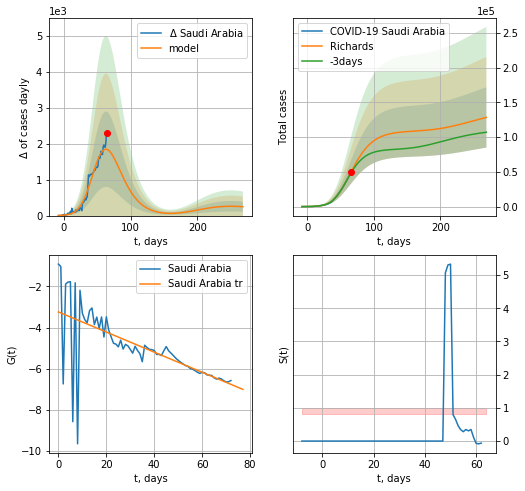

Saudi Arabia data at: 2020-05-15
+3 day model MAPE: 0.029192
model: Richards
coeffs: [1.09000048e+05 1.64133027e-01 4.25405310e+01 3.25522303e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.338092
forecast at the end of period: +204 days
	 deltaDaycases: 247
	 total cases: 128521 ± 43452
	 total death: 763 ± 773
trend coefficient of determination: 0.430419
 intercept: -3.243152
 slope: -0.048872


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in exp
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


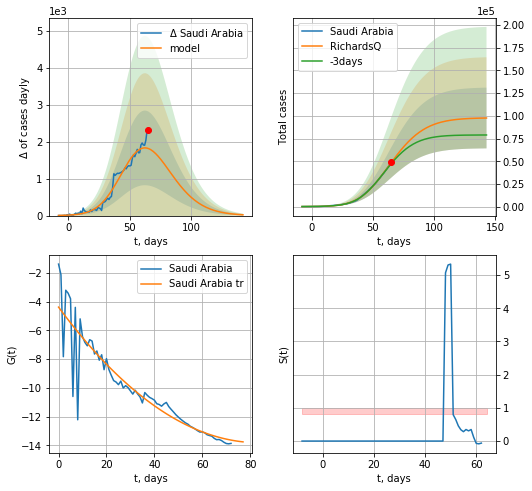

Saudi Arabia data at: 2020-05-15
+3 day model MAPE: 0.028867
model: RichardsQ
coeffs: [ 9.78381879e+04  3.61953398e-03 -4.44182838e+01 -4.44200020e+01
  6.92303865e-02]
rational stdev: 0.342773
forecast at the end of period: +78 days
	 deltaDaycases: 20
	 total cases: 97625 ± 33463
	 total death: 579 ± 595
trend coefficient of determination: 0.840306
 intercept_: -4.37938513451344
 coeffs_: [ 0.         -0.22542715  0.00134642]


In [366]:
x = forecastRR('Saudi Arabia',dfSA[:],d1,36*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Saudi Arabia',dfSA[:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
          date  cases  active  death
49 2020-04-28  619.0       0      0
50 2020-04-29  649.0       0      0
51 2020-04-30  663.0       0      0
52 2020-05-01  690.0       0      0
53 2020-05-02  702.0       0      0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


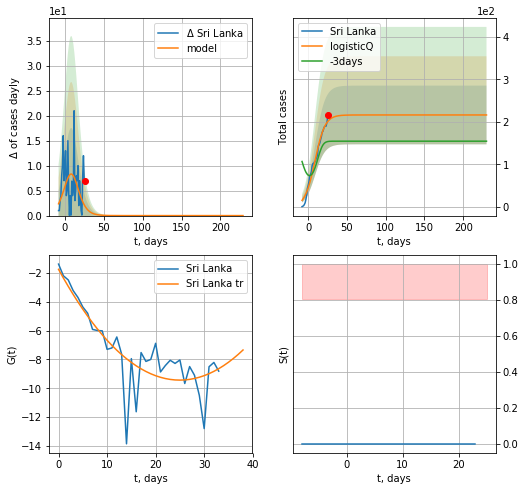

Sri Lanka data at: 2020-05-15
+3 day model MAPE: 0.324795
model: logisticQ
coeffs: [ 2.16378650e+02  6.51099157e-05  8.63891239e+00 -2.35705824e+03]
rational stdev: 0.318765
forecast at the end of period: +204 days
	 deltaDaycases: 0
	 total cases: 216 ± 68
	 total death: 2 ± 1
trend coefficient of determination: 0.700492
 intercept_: -1.7495743977322356
 coeffs_: [ 0.         -0.61543768  0.0123203 ]


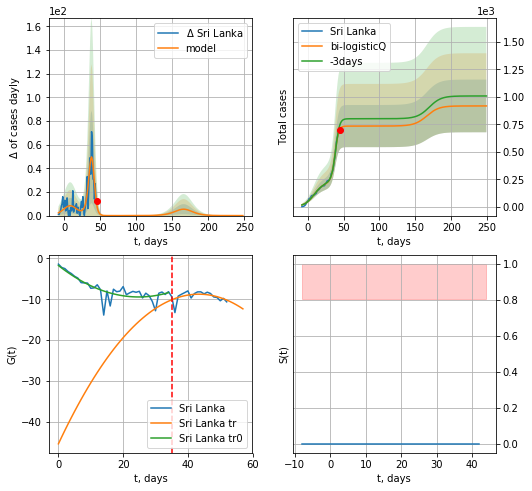

Sri Lanka data at: 2020-05-15
+3 day model MAPE: 0.062838
model: bi-logisticQ
coeffs: [ 5.18033887e+02  4.95277952e-03  3.80543331e+01 -3.87676409e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.261390
forecast at the end of period: +204 days
	 deltaDaycases: 0
	 total cases: 917 ± 239
	 total death: 8 ± 6
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.700900
 intercept_: -1.7291427146735243
 coeffs_: [ 0.         -0.62059696  0.01251448]
trend coefficient of determination: 0.356970
 intercept_: -45.35102800084556
 coeffs_: [ 0.          1.68688112 -0.01943157]


In [367]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 35
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,36*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

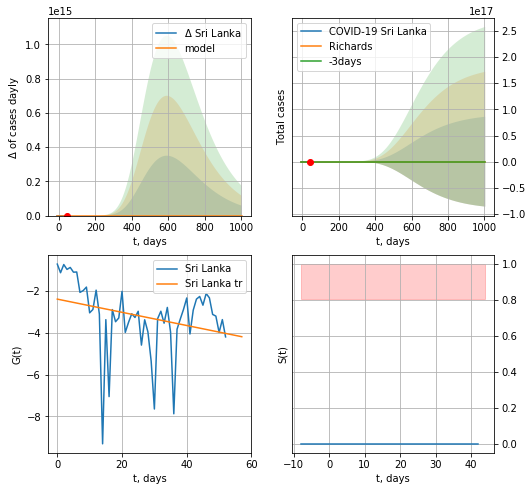

Sri Lanka data at: 2020-05-15
+3 day model MAPE: 1.000000
model: Richards
coeffs: [4.46105073e+02 3.48947501e-01 1.30751802e-01 1.91221241e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 205193802976327.718750
forecast at the end of period: +960 days
	 deltaDaycases: 0
	 total cases: 418 ± 85862760858414960
	 total death: 4 ± 2462325635715932
trend coefficient of determination: 0.080211
 intercept: -2.384018
 slope: -0.031605


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


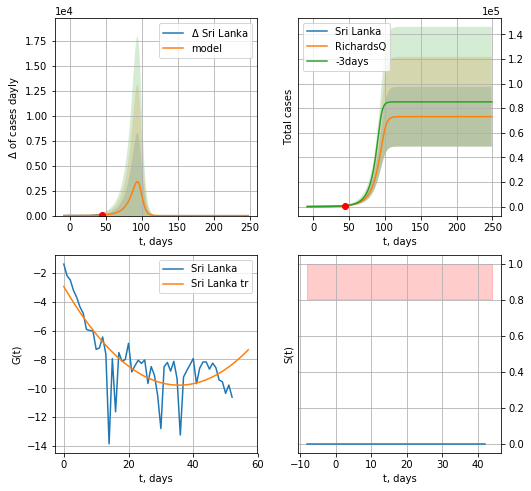

Sri Lanka data at: 2020-05-15
+3 day model MAPE: 0.055182
model: RichardsQ
coeffs: [ 7.31338913e+04  3.14273708e-04  9.79417920e+01 -2.30767672e+02
  2.83954838e+00]
rational stdev: 0.332429
forecast at the end of period: +204 days
	 deltaDaycases: 0
	 total cases: 73133 ± 24311
	 total death: 703 ± 701
trend coefficient of determination: 0.612466
 intercept_: -2.9436925942027994
 coeffs_: [ 0.         -0.38378893  0.00538271]


In [368]:
x = forecastRR('Sri Lanka',dfSri[:],d1,144*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Sri Lanka',dfSri[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
          date    cases  active  death
64 2020-05-01  18092.0   11207  417.0
65 2020-05-02  19022.0   11813  437.0
66 2020-05-03  20084.0   12443  457.0
67 2020-05-04  20941.0   13047  476.0
68 2020-05-05  22049.0   13714  514.0


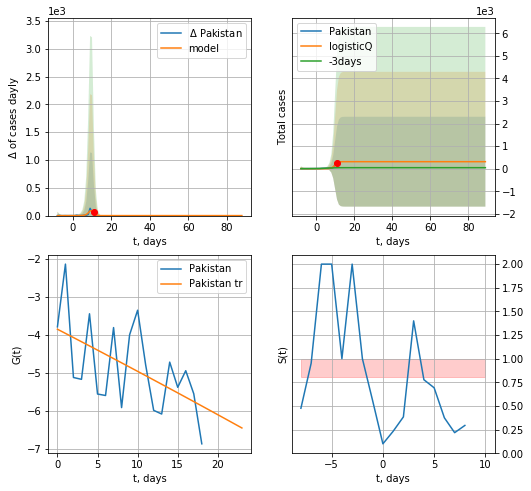

Pakistan data at: 2020-05-15
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +78 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


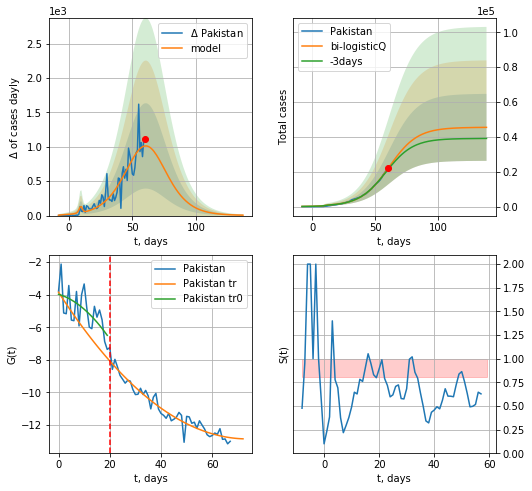

Pakistan data at: 2020-05-15
+3 day model MAPE: 0.033918
model: bi-logisticQ
coeffs: [ 4.51325915e+04  5.22299699e-06  6.10158487e+01 -1.71298715e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.422516
forecast at the end of period: +78 days
	 deltaDaycases: 6
	 total cases: 45449 ± 19203
	 total death: 976 ± 1237
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.936260
 intercept_: -3.856647542116999
 coeffs_: [ 0.         -0.24367244  0.00165147]


In [369]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


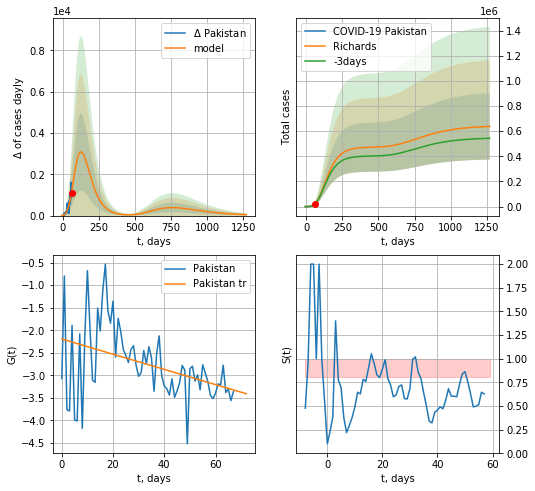

Pakistan data at: 2020-05-15
+3 day model MAPE: 0.010298
model: Richards
coeffs: [ 4.73826893e+05  4.89052373e-01 -5.79454179e+01  3.68149466e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.413337
forecast at the end of period: +1212 days
	 deltaDaycases: 43
	 total cases: 638424 ± 263884
	 total death: 13723 ± 17016
trend coefficient of determination: 0.166507
 intercept: -2.193701
 slope: -0.016865


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


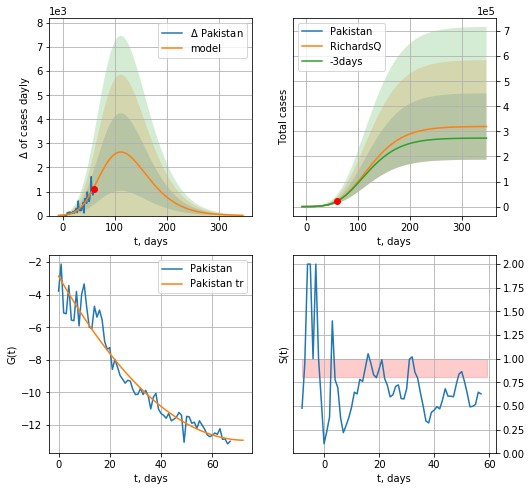

Pakistan data at: 2020-05-15
+3 day model MAPE: 0.009864
model: RichardsQ
coeffs: [ 3.19689653e+05  2.08656275e-03 -2.01471109e+02 -4.07580892e+02
  1.30756770e-02]
rational stdev: 0.414702
forecast at the end of period: +288 days
	 deltaDaycases: 10
	 total cases: 319395 ± 132453
	 total death: 6865 ± 8540
trend coefficient of determination: 0.943285
 intercept_: -2.866456132174452
 coeffs_: [ 0.         -0.27440734  0.00187034]


In [370]:
x = forecastRR('Pakistan',dfPS[:],d1,180*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
          date    cases  active  death
55 2020-05-02   8790.0    8438    175
56 2020-05-03   9455.0    8215    177
57 2020-05-04  10143.0    8752    182
58 2020-05-05  10929.0    9343    183
59 2020-05-06  11719.0   10130    186


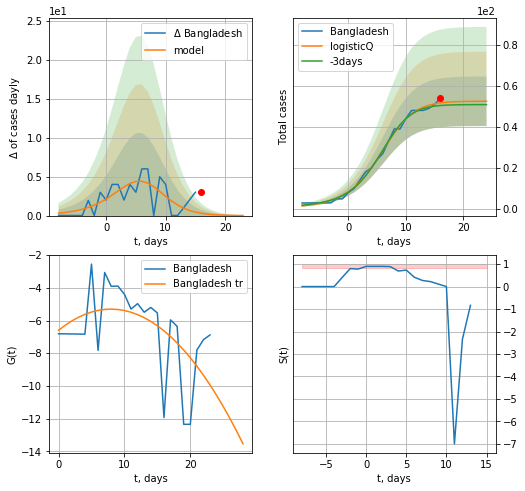

Bangladesh data at: 2020-05-15
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +8 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


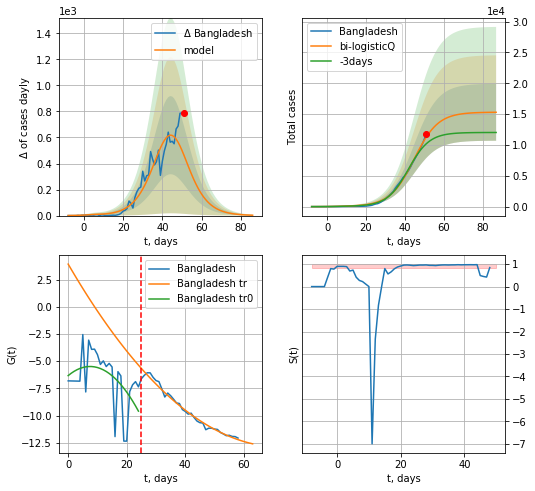

Bangladesh data at: 2020-05-15
+3 day model MAPE: 0.121997
model: bi-logisticQ
coeffs: [ 1.52576917e+04  4.82282721e-06  4.47207282e+01 -3.35831063e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.301595
forecast at the end of period: +36 days
	 deltaDaycases: 2
	 total cases: 15295 ± 4612
	 total death: 227 ± 205
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.980575
 intercept_: 3.92534182185733
 coeffs_: [ 0.         -0.4635868   0.00319602]


In [371]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


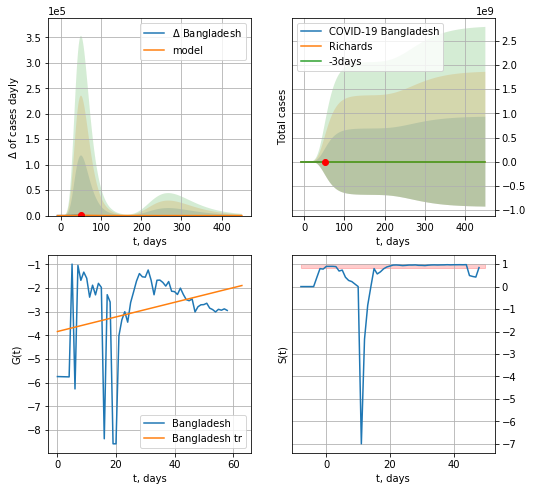

Bangladesh data at: 2020-05-15
+3 day model MAPE: 0.055506
model: Richards
coeffs: [ 3.07100009e+04  2.17207180e+00 -1.32880171e+01  2.61159639e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 22375.959220
forecast at the end of period: +400 days
	 deltaDaycases: 6
	 total cases: 41524 ± 929159316
	 total death: 616 ± 41350772
trend coefficient of determination: 0.086669
 intercept: -3.832533
 slope: 0.030849


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in true_divide
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1200.
  warnings.warn(errors[info][0], RuntimeWarning)


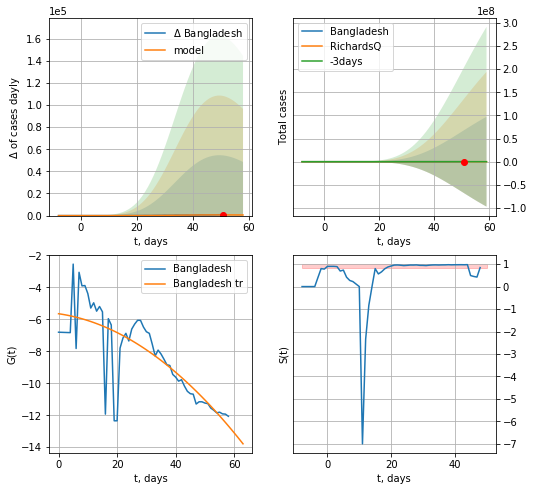

Bangladesh data at: 2020-05-15
+3 day model MAPE: 0.059515
model: RichardsQ
coeffs: [ 2.70091422e+04  3.12884912e-02 -7.41561616e+01 -2.11791577e+02
  5.24797657e-03]
rational stdev: 5991.563261
forecast at the end of period: +8 days
	 deltaDaycases: 555
	 total cases: 16208 ± 97115965
	 total death: 240 ± 4313925
trend coefficient of determination: 0.630447
 intercept_: -5.653904656846626
 coeffs_: [ 0.         -0.02628648 -0.00163203]


In [372]:
x = forecastRR('Bangladesh',dfBN[:],d1,64*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Bangladesh',dfBN[:],d1,8*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [378]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=15:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

/usr/local/lib/python3.5/dist-packages/requests/__init__.py:83: RequestsDependencyWarning: Old version of cryptography ([1, 2, 3]) may cause slowdown.
  warnings.warn(warning, RequestsDependencyWarning)


[15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"ActiveCases"
9:"Serious,Critical"
10:"Tot Cases/1M pop"
11:"Deaths/1M pop"
12:"TotalTests"
13:"Tests/
1M pop
"
14:"Population"
15:"Continent"
[463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463, 463]


In [5]:
df.head(10)

,#,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,"1,126,572",North America,\nNorth America\n,,"+2,893",300,,"17,296",,"1,635,060","99,933","408,555",,
1,,"840,807",Europe,\nEurope\n,,92,9,,"12,195",,"1,741,221","160,491","739,923",,
2,,"242,166",South America,\nSouth America\n,,"+2,273",157,,"10,271",,"403,345","21,460","139,719",,
3,,"303,159",Asia,\nAsia\n,,"+1,980",33,,"4,934",,"759,904","23,996","432,749",,
4,,"47,067",Africa,\nAfrica\n,,151,1,,288,,"79,931","2,640","30,224",,
5,,639,Australia/Oceania,\nOceania\n,,18,,,19,,"8,639",119,"7,881",,
6,,55,,\n\n,,,,,4,,721,15,651,,
7,,"2,560,465",All,World,39.6,"+7,407",500,,"45,007",,"4,628,821","308,654","1,759,702",,594
8,1,"1,068,027",North America,USA,268,,,"330,758,784","16,139","33,532","1,484,285","88,507","327,751","11,090,900","4,488"
9,2,"57,941",Europe,Spain,587,,,"46,752,556","1,320","52,783","274,367","27,459","188,967","2,467,761","5,868"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",df.columns[4]:"Deathsper1Mpop","Serious,Critical":"Serious_Critical",df.columns[9]:"Testsper1Mpop",df.columns[14]:"TotCasesper1Mpop"})
df.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,"1,126,572",North America,\nNorth America\n,,"+2,893",300,,"17,296",,"1,635,060","99,933","408,555",,
1,,"840,807",Europe,\nEurope\n,,92,9,,"12,195",,"1,741,221","160,491","739,923",,
2,,"242,166",South America,\nSouth America\n,,"+2,273",157,,"10,271",,"403,345","21,460","139,719",,
3,,"303,159",Asia,\nAsia\n,,"+1,980",33,,"4,934",,"759,904","23,996","432,749",,
4,,"47,067",Africa,\nAfrica\n,,151,1,,288,,"79,931","2,640","30,224",,


In [7]:
df[df["Country"]=="Lithuania"]

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
92,85,504,Europe,Lithuania,20,,,"2,726,669",17,"79,308","1,523",54,965,"216,247",559
324,85,504,Europe,Lithuania,20,12,,"2,726,669",17,"79,308","1,523",54,965,"216,247",559


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [10]:
df.head(30)

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,"1,126,572",North America,\nNorth America\n,,"+2,893",300,,"17,296",,"1,635,060","99,933","408,555",,
1,,"840,807",Europe,\nEurope\n,,92,9,,"12,195",,"1,741,221","160,491","739,923",,
2,,"242,166",South America,\nSouth America\n,,"+2,273",157,,"10,271",,"403,345","21,460","139,719",,
3,,"303,159",Asia,\nAsia\n,,"+1,980",33,,"4,934",,"759,904","23,996","432,749",,
4,,"47,067",Africa,\nAfrica\n,,151,1,,288,,"79,931","2,640","30,224",,
5,,639,Australia/Oceania,\nOceania\n,,18,,,19,,"8,639",119,"7,881",,
6,,55,,\n\n,,,,,4,,721,15,651,,
7,,"2,560,465",All,World,39.6,"+7,407",500,,"45,007",,"4,628,821","308,654","1,759,702",,594
8,1,"1,068,027",North America,USA,268,,,"330,758,784","16,139","33,532","1,484,285","88,507","327,751","11,090,900","4,488"
9,2,"57,941",Europe,Spain,587,,,"46,752,556","1,320","52,783","274,367","27,459","188,967","2,467,761","5,868"


In [11]:
df.at[11, 'TotalRecovered'] = 0
df.at[24, 'TotalRecovered'] = 0
df.at[11,"ActiveCases"] = 0
df.at[24,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [12]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,1126572,North America,\nNorth America\n,NaN,2893.0,300.0,,17296.0,NaN,1635060,99933.0,408555.0,NaN,NaN
1,,840807,Europe,\nEurope\n,NaN,92.0,9.0,,12195.0,NaN,1741221,160491.0,739923.0,NaN,NaN
2,,242166,South America,\nSouth America\n,NaN,2273.0,157.0,,10271.0,NaN,403345,21460.0,139719.0,NaN,NaN
3,,303159,Asia,\nAsia\n,NaN,1980.0,33.0,,4934.0,NaN,759904,23996.0,432749.0,NaN,NaN
4,,47067,Africa,\nAfrica\n,NaN,151.0,1.0,,288.0,NaN,79931,2640.0,30224.0,NaN,NaN
5,,639,Australia/Oceania,\nOceania\n,NaN,18.0,NaN,,19.0,NaN,8639,119.0,7881.0,NaN,NaN
6,,55,,\n\n,NaN,NaN,NaN,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,2560465,All,World,39.6,7407.0,500.0,,45007.0,NaN,4628821,308654.0,1759702.0,NaN,594.0
8,1,1068027,North America,USA,268.0,NaN,NaN,"330,758,784",16139.0,33532.0,1484285,88507.0,327751.0,11090900.0,4488.0
9,2,57941,Europe,Spain,587.0,NaN,NaN,"46,752,556",1320.0,52783.0,274367,27459.0,188967.0,2467761.0,5868.0


In [13]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,303159,Asia,Total:,NaN,1980.0,33.0,,4934.0,NaN,759904,23996.0,432749.0,NaN,NaN
227,,47067,Africa,Total:,NaN,151.0,1.0,,288.0,NaN,79931,2640.0,30224.0,NaN,NaN
228,,639,Australia/Oceania,Total:,NaN,18.0,NaN,,19.0,NaN,8639,119.0,7881.0,NaN,NaN
229,,55,,Total:,NaN,NaN,NaN,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,346991,Europe,European Union,270.60272,92.0,9.0,NaN,7626.0,33800.34728,1132763,120486.0,627248.0,15049622.0,2544.102622


In [14]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,1126572,North America,North America,NaN,2893.0,300.0,,17296.0,NaN,1635060,99933.0,408555.0,NaN,NaN
1,,840807,Europe,Europe,NaN,92.0,9.0,,12195.0,NaN,1741221,160491.0,739923.0,NaN,NaN
2,,242166,South America,South America,NaN,2273.0,157.0,,10271.0,NaN,403345,21460.0,139719.0,NaN,NaN
3,,303159,Asia,Asia,NaN,1980.0,33.0,,4934.0,NaN,759904,23996.0,432749.0,NaN,NaN
4,,47067,Africa,Africa,NaN,151.0,1.0,,288.0,NaN,79931,2640.0,30224.0,NaN,NaN


In [32]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [33]:
#df

In [15]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,1126572,North America,North America,NaN,2893.0,300.0,,17296.0,NaN,1635060,99933.0,408555.0,NaN,NaN
1,,840807,Europe,Europe,NaN,92.0,9.0,,12195.0,NaN,1741221,160491.0,739923.0,NaN,NaN
2,,242166,South America,South America,NaN,2273.0,157.0,,10271.0,NaN,403345,21460.0,139719.0,NaN,NaN
3,,303159,Asia,Asia,NaN,1980.0,33.0,,4934.0,NaN,759904,23996.0,432749.0,NaN,NaN
4,,47067,Africa,Africa,NaN,151.0,1.0,,288.0,NaN,79931,2640.0,30224.0,NaN,NaN
5,,639,Australia/Oceania,Oceania,NaN,18.0,NaN,,19.0,NaN,8639,119.0,7881.0,NaN,NaN
7,,2560465,All,World,39.6,7407.0,500.0,,45007.0,NaN,4628821,308654.0,1759702.0,NaN,594.0
8,1,1068027,North America,USA,268.0,NaN,NaN,"330,758,784",16139.0,33532.0,1484285,88507.0,327751.0,11090900.0,4488.0
9,2,57941,Europe,Spain,587.0,NaN,NaN,"46,752,556",1320.0,52783.0,274367,27459.0,188967.0,2467761.0,5868.0
10,3,202199,Europe,Russia,17.0,NaN,NaN,"145,926,781",2300.0,43953.0,262843,2418.0,58226.0,6413948.0,1801.0


In [16]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [17]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Saudi Arabia SA
Indonesia IE
Norway NG
Poland PL
Croatia CT
Netherlands NL
Finland FI
Spain SP
Romania RM
Ecuador ED
Serbia SB
Thailand TH
Bulgaria BL
Belgium BG
Japan JP
Sweden SW
Czechia CH
World World
Argentina AG
Slovenia SV
India ID
Turkey TR
Estonia ES
European Union EU
Qatar QR
Egypt EG
UK GB
Germany GR
Chile CL
UAE UAE
Ireland IR
Russia RS
S. Korea KR
Portugal PT
Hungary HG
Slovakia SL
Malta MT
New Zealand ZL
Iran IN
Morocco MR
Denmark DK
Belarus BR
Algeria AR
Ukraine Ukr
Brazil BZ
Latvia LV
Iceland IC
Peru PU
Iraq IQ
Switzerland SZ
Panama PM
China CN
Colombia CB
Pakistan PK
France FR
Israel IS
Austria AT
USA US
Luxembourg LX
Australia AS
Canada CA
Greece GC
Philippines PH
Mexico MX
Lithuania LT
Malaysia ML
Italy IT
Cyprus CP
Singapore SG


In [18]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-05-15,1635060,1126572,99933.0
Europe
Europe 2020-05-15,1741221,840807,160491.0
South America
South America 2020-05-15,403345,242166,21460.0
Asia
Asia 2020-05-15,759904,303159,23996.0
Africa
Africa 2020-05-15,79931,47067,2640.0
Oceania
Oceania 2020-05-15,8639,639,119.0
World
World 2020-05-15,4628821,2560465,308654.0
USA
USA 2020-05-15,1484285,1068027,88507.0
Spain
Spain 2020-05-15,274367,57941,27459.0
Russia
Russia 2020-05-15,262843,202199,2418.0
UK
UK 2020-05-15,236711,0,33998.0
Italy
Italy 2020-05-15,223885,72070,31610.0
Brazil
Brazil 2020-05-15,220291,120359,14962.0
France
France 2020-05-15,179506,91529,27529.0
Germany
Germany 2020-05-15,175699,15998,8001.0
Turkey
Turkey 2020-05-15,146457,36269,4055.0
Iran
Iran 2020-05-15,116635,17897,6902.0
India
India 2020-05-15,85940,52929,2753.0
Peru
Peru 2020-05-15,84495,54956,2392.0
Canada
Canada 2020-05-15,74613,32156,5562.0
Belgium
Belgium 2020-05-15,54644,31384,8959.0
Saudi Arabia
Saudi Arabia 2020-05-15,4917

Saint Kitts and Nevis
Saint Kitts and Nevis 2020-05-15,15,1,nan
Falkland Islands
Falkland Islands 2020-05-15,13,0,nan
Turks and Caicos
Turks and Caicos 2020-05-15,12,1,1.0
Vatican City
Vatican City 2020-05-15,12,10,nan
Comoros
Comoros 2020-05-15,11,7,1.0
Montserrat
Montserrat 2020-05-15,11,0,1.0
Greenland
Greenland 2020-05-15,11,0,nan
Seychelles
Seychelles 2020-05-15,11,1,nan
Suriname
Suriname 2020-05-15,10,0,1.0
MS Zaandam
MS Zaandam 2020-05-15,9,7,2.0
British Virgin Islands
British Virgin Islands 2020-05-15,8,1,1.0
Papua New Guinea
Papua New Guinea 2020-05-15,8,0,nan
Caribbean Netherlands
Caribbean Netherlands 2020-05-15,6,0,nan
St. Barth
St. Barth 2020-05-15,6,0,nan
Western Sahara
Western Sahara 2020-05-15,6,0,nan
Anguilla
Anguilla 2020-05-15,3,0,nan
Lesotho
Lesotho 2020-05-15,1,1,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-05-15,1,0,nan
China
China 2020-05-15,82941,89,4633.0
Total:
Total: 2020-05-15,1635060,1126572,99933.0
Total:
Total: 2020-05-15,1635060,1126572,99933.0
T

In [19]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [20]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaSA.csv 2020-05-15,49176,27015,292.0

append data/coronaIE.csv 2020-05-15,16496,11617,1076.0

append data/coronaNG.csv 2020-05-15,8219,7955,232.0

append data/coronaPL.csv 2020-05-15,18016,10191,907.0

append data/coronaCT.csv 2020-05-15,2222,258,95.0

append data/coronaNL.csv 2020-05-15,43681,0,5643.0

append data/coronaFI.csv 2020-05-15,6228,935,293.0

append data/coronaSP.csv 2020-05-15,274367,57941,27459.0

append data/coronaRM.csv 2020-05-15,16437,5997,1070.0

append data/coronaED.csv 2020-05-15,31467,25440,2594.0

append data/coronaSB.csv 2020-05-15,10438,5912,225.0

append data/coronaTH.csv 2020-05-15,3025,114,56.0

append data/coronaBL.csv 2020-05-15,2174,1496,105.0

append data/coronaBG.csv 2020-05-15,54644,31384,8959.0

append data/coronaJP.csv 2020-05-15,16203,5152,713.0

append data/coronaSW.csv 2020-05-15,29207,20590,3646.0

append data/coronaCH.csv 2020-05-15,8406,2730,295.0

append data/coronaWorld.csv 2020-05-15,4628821,2560465,308654.0

append data/cor

In [283]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [285]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

South Africa 0


In [911]:
#dfRM = read_df(pd.DataFrame(),"RM")

RM
          date  cases  active
29 2020-04-01   2245     NaN
30 2020-04-02   2460     NaN
31 2020-04-03   2738     NaN
32 2020-04-04   3183     NaN
33 2020-04-05   3613     0.0


In [892]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2018
6873,2020-02-27,27,2,2020,1,0,Romania,RO,ROU,19473936.0
6871,2020-02-29,29,2,2020,3,0,Romania,RO,ROU,19473936.0
6868,2020-03-04,4,3,2020,4,0,Romania,RO,ROU,19473936.0
6867,2020-03-06,6,3,2020,6,0,Romania,RO,ROU,19473936.0
6866,2020-03-07,7,3,2020,7,0,Romania,RO,ROU,19473936.0


In [875]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [7]:
len(countriesEU)

27

In [309]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

World 549497


In [328]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


7185.14611304862

In [287]:
#dfD

In [339]:
#dfAll[dfAll['Country'].isin(cLst)]

In [356]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

50943826.0 6550.070201604608


In [358]:
TT/7.7776e3

6550.070201604608

In [357]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

31553.14493359574

In [366]:
sum(dfp.Population)/1e6

16014.157998

In [282]:
dfAll[dfAll.TotalTests>0]

,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
7,456815,North America,USA,57.000000,0.0,0.0,10917.0,7670.000000,502876,18747.0,27314.0,2538888.0,1519.000000
8,86524,Europe,Spain,344.000000,0.0,0.0,7371.0,7593.000000,158273,16081.0,55668.0,355000.0,3385.000000
9,98273,Europe,Italy,312.000000,0.0,0.0,3497.0,14999.000000,147577,18849.0,30455.0,906864.0,2441.000000
10,86740,Europe,France,202.000000,0.0,0.0,7004.0,5114.000000,124869,13197.0,24932.0,333807.0,1913.000000
11,65522,Europe,Germany,33.000000,0.0,0.0,4895.0,15730.000000,122171,2736.0,53913.0,1317887.0,1458.000000
12,64456,Europe,UK,132.000000,0.0,0.0,1559.0,4667.000000,73758,8958.0,344.0,316836.0,1086.000000
13,28495,Asia,Iran,50.000000,0.0,0.0,3969.0,2888.000000,68192,4232.0,35465.0,242568.0,812.000000
14,43600,Asia,Turkey,12.000000,0.0,0.0,1667.0,3643.000000,47029,1006.0,2423.0,307210.0,558.000000
15,18080,Europe,Belgium,260.000000,0.0,0.0,1278.0,7269.000000,26667,3019.0,5568.0,84248.0,2301.000000
16,12449,Europe,Switzerland,116.000000,0.0,0.0,386.0,20625.000000,24551,1002.0,11100.0,178500.0,2837.000000


In [272]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [300]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [301]:
#cDicEU["Ireland"][1]

In [346]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

30944.43816857671

In [347]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [348]:
#dfAll

In [349]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

6678.949832302003

In [393]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh"
]

In [394]:
len(CList)

67

In [398]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

4063285040

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

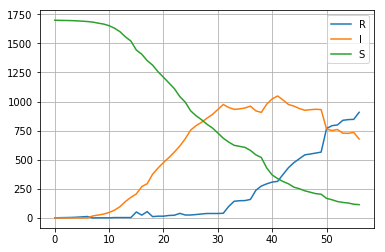

In [798]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

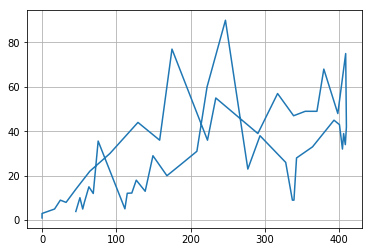

In [799]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

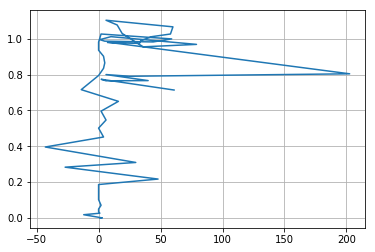

In [800]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

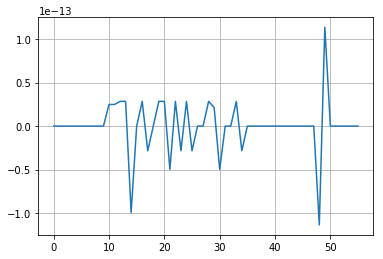

In [801]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [978]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [1044]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

[ 42.58270028 912.65637216]


In [1045]:
55*19

1045

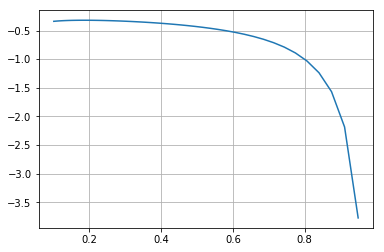

In [1046]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

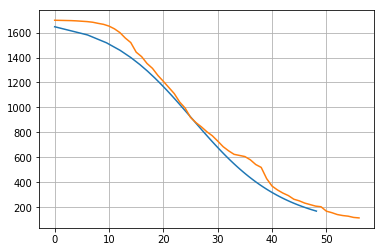

In [1059]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

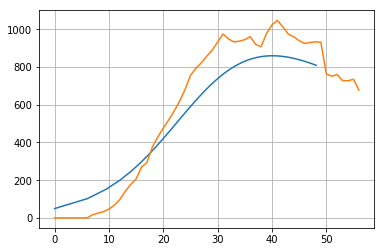

In [1058]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

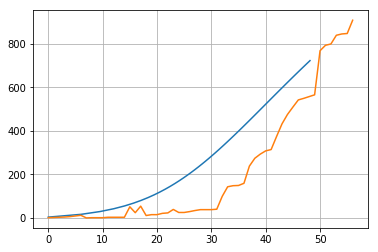

In [1060]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [992]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [824]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [995]:
gamma/(beta*x0)*55*4

45.5529411764706

In [1006]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

array([0.12589254, 0.16378937, 0.2130941 , 0.2772408 , 0.36069727,
       0.46927625, 0.61054023, 0.79432823])

In [1005]:
10**0.1

1.2589254117941673

In [1058]:
np.multiply(I,S)[1:].shape

(54,)

In [1056]:
np.diff(S).shape

(54,)

In [1063]:
50./400

0.125